<a href="https://colab.research.google.com/github/carlitos9087/Analises_de_amostras/blob/main/Analises_de_amostras.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#bibliotecas


In [1]:
import numpy as np
import re
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [2]:
caminho = "/content/drive/MyDrive/Laboratory/Alunos/Cadu/SRR files/normalizados/"
#Aspergilus
GSE55648 = caminho+"Aspergilus/GSE55648(homo sapiens).xlsx-Log2 RPKM-.xlsx"

#candida albicans
GSE120012 = caminho+"Candida albicans/GSE120012(Mus musculus).xlsx-Log2 RPKM-.xlsx"
GSE184104 = caminho+"Candida albicans/GSE184104(Mus musculus).xlsx-Log2 RPKM-.xlsx" #12 mus

#HIV
GSE103666 = caminho+"HIV/GSE103666(homo sapiens).xlsx-Log2 RPKM-.xlsx"
GSE148796 = caminho+"HIV/GSE148796(homo sapiens).xlsx-Log2 RPKM-.xlsx"
GSE156072 = caminho+"HIV/GSE156072(homo sapiens).xlsx-Log2 RPKM-.xlsx"

#Leishmania
GSE162760 = caminho+"Leishmania/GSE162760.xlsx-Log2 RPKM-.xlsx"
GSE185253 = caminho+"Leishmania/GSE185253.xlsx-Log2 RPKM-.xlsx"
GSE189385 = caminho+"Leishmania/GSE189385.xlsx-Log2 RPKM-.xlsx"
PRJEB36928= caminho+"Leishmania/PRJEB36928.xlsx-Log2 RPKM-.xlsx"
PRJNA290995= caminho+"Leishmania/PRJNA290995.xlsx-Log2 RPKM-.xlsx"
PRJNA516707 = caminho+"Leishmania/PRJNA516707.xlsx-Log2 RPKM-.xlsx" #3 homo
PRJNA552352 = caminho+"Leishmania/PRJNA552352.xlsx-Log2 RPKM-.xlsx"
PRJNA601732 = caminho+"Leishmania/PRJNA601732.xlsx-Log2 RPKM-.xlsx"# musmu 30
PRJNA633893 = caminho+"Leishmania/PRJNA633893.xlsx-Log2 RPKM-.xlsx"
PRJNA656921 = caminho+"Leishmania/PRJNA656921.xlsx-Log2 RPKM-.xlsx"
PRJNA838552 = caminho+"Leishmania/PRJNA838552.xlsx-Log2 RPKM-.xlsx"
SRP009251 = caminho+"Leishmania/SRP009251.xlsx-Log2 RPKM-.xlsx"
SRP069976 = caminho+"Leishmania/SRP069976.xlsx-Log2 RPKM-.xlsx"
SRP377060 = caminho+"Leishmania/SRP377060.xlsx-Log2 RPKM-.xlsx"

#M_tuberculosis
GSE100897 = caminho+"M_tuberculosis/GSE100897.xlsx-Log2 RPKM-.xlsx"
GSE141656 = caminho+"M_tuberculosis/GSE141656.xlsx-Log2 RPKM-.xlsx"
PRJNA707548 = caminho+"M_tuberculosis/PRJNA707548.xlsx-Log2 RPKM-.xlsx"
SRP151491 = caminho+"M_tuberculosis/SRP151491.xlsx-Log2 RPKM-.xlsx" # 18 mus
SRP185421 = caminho+"M_tuberculosis/SRP185421.xlsx-Log2 RPKM-.xlsx"

#SARS-CoV-2
GSE163668 = caminho+"SARS-CoV-2/GSE163668(homo sapiens).xlsx-Log2 RPKM-.xlsx"
GSE163959 = caminho+"SARS-CoV-2/GSE163959(homo sapiens).xlsx-Log2 RPKM-.xlsx" #homo 20
GSE166253 = caminho+"SARS-CoV-2/GSE166253(homo sapiens).xlsx-Log2 RPKM-.xlsx"
GSE167749 = caminho+"SARS-CoV-2/GSE167749(mus musculus).xlsx-Log2 RPKM-.xlsx"

#Aspergilus

##GSE55648 ✅⚠️standby

In [ ]:
GSE55648_tab = pd.read_excel(GSE55648 )
GSE55648_tab.head()

,Nome,Fungus _and _Neutrophils _were _cultivated _separably _over _selected _time _points _and _were _united _for _RNA _isolation _SRR1184521,Fungus _and _Neutrophils _were _cultivated _separably _over _selected _time _points _and _were _united _for _RNA _isolation _SRR1184522,Fungus _and _Neutrophils _were _cultivated _separably _over _selected _time _points _and _were _united _for _RNA _isolation _SRR1184523,Fungus _and _Neutrophils _were _cultivated _separably _over _selected _time _points _and _were _united _for _RNA _isolation _SRR1184524,Fungus _and _Neutrophils _were _cultivated _separably _over _selected _time _points _and _were _united _for _RNA _isolation _SRR1184525,Fungus _and _Neutrophils _were _cultivated _separably _over _selected _time _points _and _were _united _for _RNA _isolation _SRR1184526,Fungus _and _Neutrophils _were _cultivated _separably _over _selected _time _points _and _were _united _for _RNA _isolation _SRR1184527,Fungus _and _Neutrophils _were _cultivated _separably _over _selected _time _points _and _were _united _for _RNA _isolation _SRR1184528,Fungus _and _Neutrophils _were _cultivated _separably _over _selected _time _points _and _were _united _for _RNA _isolation _SRR1184529,...,Fungus _and _Neutrophils _were _cultivated _together _over _selected _time _points _and _than _RNA _was _isolated _SRR1184511,Fungus _and _Neutrophils _were _cultivated _together _over _selected _time _points _and _than _RNA _was _isolated _SRR1184512,Fungus _and _Neutrophils _were _cultivated _together _over _selected _time _points _and _than _RNA _was _isolated _SRR1184513,Fungus _and _Neutrophils _were _cultivated _together _over _selected _time _points _and _than _RNA _was _isolated _SRR1184514,Fungus _and _Neutrophils _were _cultivated _together _over _selected _time _points _and _than _RNA _was _isolated _SRR1184515,Fungus _and _Neutrophils _were _cultivated _together _over _selected _time _points _and _than _RNA _was _isolated _SRR1184516,Fungus _and _Neutrophils _were _cultivated _together _over _selected _time _points _and _than _RNA _was _isolated _SRR1184517,Fungus _and _Neutrophils _were _cultivated _together _over _selected _time _points _and _than _RNA _was _isolated _SRR1184518,Fungus _and _Neutrophils _were _cultivated _together _over _selected _time _points _and _than _RNA _was _isolated _SRR1184519,Fungus _and _Neutrophils _were _cultivated _together _over _selected _time _points _and _than _RNA _was _isolated _SRR1184520
0,YTHDF 1,2.880477,5.334035,4.445297,5.809671,5.574809,5.414217,4.442549,5.381298,4.393777,...,4.589609,4.447666,5.513143,5.920254,6.046410,4.239013,4.526980,5.353434,6.313513,5.698159
1,YTHDF 2,2.829851,0.000000,1.224746,5.022080,5.983615,5.363591,5.561848,5.330672,5.343151,...,3.538983,3.812077,5.269872,4.869628,3.825859,0.000000,6.476354,3.717846,0.000000,4.647533
2,YTHDF 3,5.399966,4.946633,3.209898,6.670197,4.509335,6.085708,4.377075,5.578859,3.743341,...,6.026636,5.797230,7.148109,6.077173,6.395974,4.173539,5.876544,6.287960,7.569968,8.092116
3,YTHDC 1,0.000000,0.000000,0.000000,0.000000,2.196298,0.000000,2.064038,0.000000,0.000000,...,0.000000,2.484192,2.134631,0.000000,3.819901,2.860501,0.000000,0.000000,0.000000,3.319647
4,FTO,2.026767,0.000000,0.000000,0.000000,3.721099,0.000000,0.000000,4.205659,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE55648_df_filtrado = GSE55648_tab[GSE55648_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE55648_df_filtrado.index = GSE55648_df_filtrado["Nome"]


In [ ]:
GSE55648_df_filtrado = GSE55648_df_filtrado.T

In [ ]:
GSE55648_df_filtrado = GSE55648_df_filtrado.iloc[1:]

In [ ]:
GSE55648_df_filtrado.index.to_list()
GSE55648_df_filtrado.shape

(28, 29)

In [ ]:
GSE55648_df_filtrado["Patient"] = ['D1',
'D4',
'D5',
'D6',
'D1',
'D4',
'D5',
'D6',
'D1',
'D4',
'D5',
'D6',
'D1',
'D2',
'D4',
'D6',
'D1',
'D4',
'D5',
'D6',
'D1',
'D4',
'D5',
'D6',
'D1',
'D4',
'D5',
'D6']

In [ ]:
GSE55648_df_filtrado["Status"] = ['treatment_0',
'treatment_0',
'treatment_0',
'treatment_0',
'treatment_30',
'treatment_30',
'treatment_30',
'treatment_30',
'treatment_90',
'treatment_90',
'treatment_90',
'treatment_90',
'treatment_180',
'treatment_180',
'treatment_180',
'treatment_180',
'control_30',
'control_30',
'control_30',
'control_30',
'control_90',
'control_90',
'control_90',
'control_90',
'control_180',
'control_180',
'control_180',
'control_180']

In [ ]:
# GSE55648_df_filtrado["tret"] = ['treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'treatment',
# 'control',
# 'control',
# 'control',
# 'control',
# 'control',
# 'control',
# 'control',
# 'control',
# 'control',
# 'control',
# 'control',
# 'control']

In [ ]:
set(GSE55648_df_filtrado["Status"])

{'control_180',
 'control_30',
 'control_90',
 'treatment_0',
 'treatment_180',
 'treatment_30',
 'treatment_90'}

In [ ]:
# Filtrando as linhas para Uninfected_Mouse e Infected_Mouse_Linfantum
# subset_PRJNA601732_df_Linfantum = PRJNA601732_df_filtrado[(PRJNA601732_df_filtrado['Status'] == 'Uninfected_Mouse') | (PRJNA601732_df_filtrado['Status'] == 'Mouse_Linfantum')]
# subset_PRJNA601732_df_Linfantum.iloc[[1,-1],:]

In [ ]:
# Filtrando as linhas para Infected_Mouse_Ldonovani e Infected_Mouse_Linfantum
# subset_PRJNA601732_df_Ldonovani = PRJNA601732_df_filtrado[(PRJNA601732_df_filtrado['Status'] == 'Mouse_Ldonovani') | (PRJNA601732_df_filtrado['Status'] == 'Infected_Mouse_Linfantum')]
# subset_PRJNA601732_df_Ldonovani.iloc[[1,-1],:]

In [ ]:
infected_data = GSE55648_df_filtrado[GSE55648_df_filtrado['Status'] == 'treatment_180']
uninfected_data = GSE55648_df_filtrado[GSE55648_df_filtrado['Status'] == 'control_30']

UNF = uninfected_data.iloc[:, 0:-2].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-2].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

# INF_df
# UNF_df


In [ ]:
# Calcular a mediana para cada grupo
# median_infected = infected_data.iloc[:, 0:-1].median()
# median_uninfected = uninfected_data.iloc[:, 0:-1].median()
# median_uninfected-median_infected
# [u-i for u,i  in zip (median_uninfected,median_infected)]
# median_uninfected
# # median_infected
# for I,U in zip (median_infected, median_uninfected):
#     pass
# #   print(f" inf:{I}      un: {U}    dif:  {I-U}")
INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,3.355113,1.902373,-0.107394,0.228056,-0.436285,-1.286188,-0.591156,0.168709,-0.090636,-0.385212,...,0.0,-0.873736,1.706807,0.044113,-0.562667,-0.592834,-1.371297,0.216751,0.240713,0.304214


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

regulated_genes.to_excel("Aspergilus_GSE55648.xlsx")
regulated_genes


Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,UP,Normal,Normal,Normal,Down,Normal,Normal,Normal,Normal,...,Normal,Down,UP,Normal,Normal,Normal,Down,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, caminho="aqui"):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, edgecolor='black',linewidth=0.51,  hue="Patient", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        # ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        # plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE55648/{especie}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,UP,Normal,Normal,Normal,Down,Normal,Normal,Normal,Normal,...,Normal,Down,UP,Normal,Normal,Normal,Down,Normal,Normal,Normal


<Figure size 800x800 with 0 Axes>

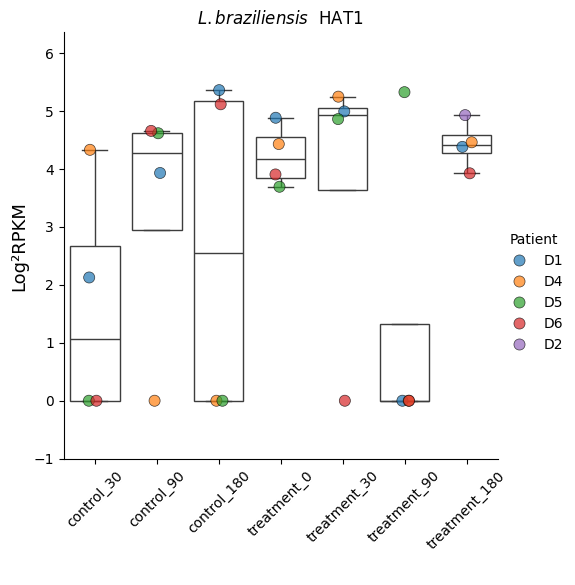

carregando


<Figure size 800x800 with 0 Axes>

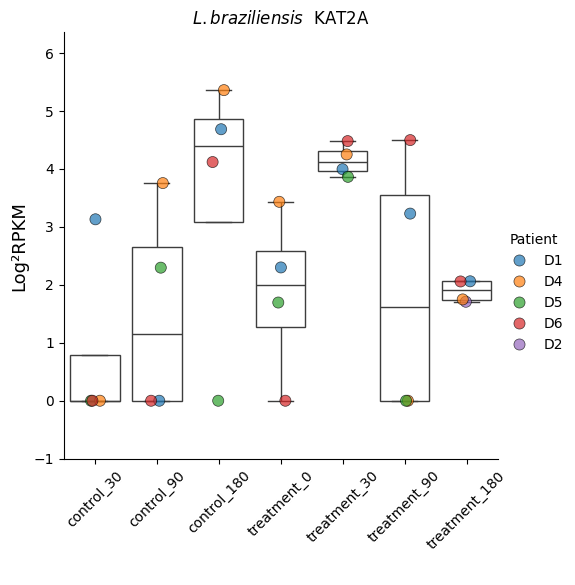

carregando


<Figure size 800x800 with 0 Axes>

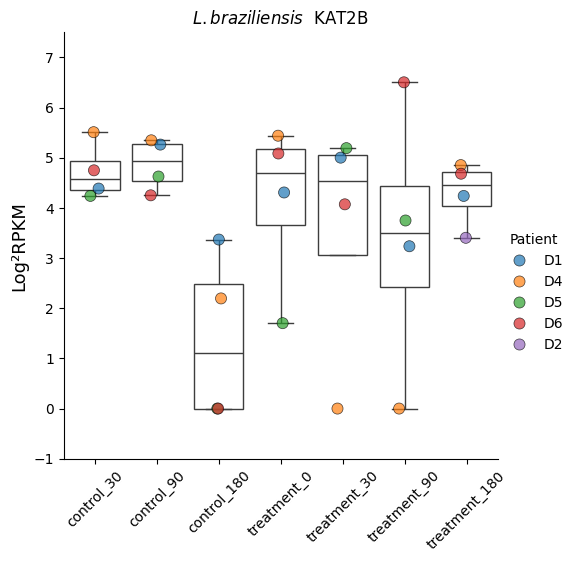

carregando


<Figure size 800x800 with 0 Axes>

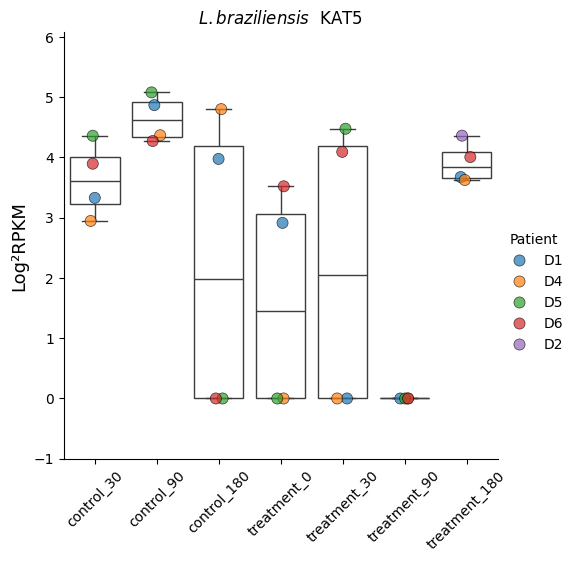

carregando


<Figure size 800x800 with 0 Axes>

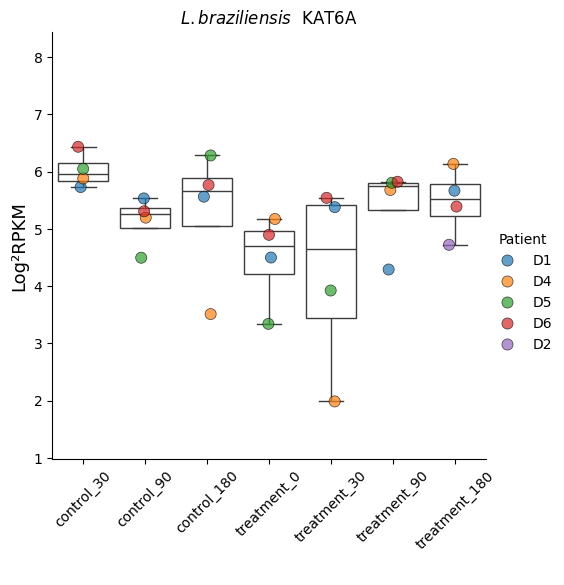

carregando


<Figure size 800x800 with 0 Axes>

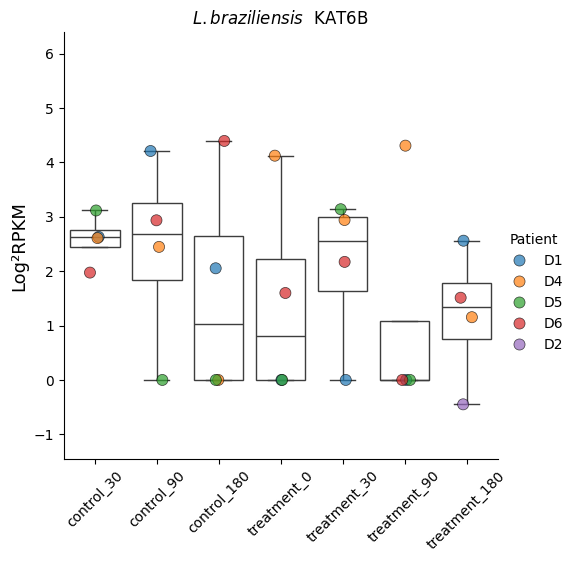

carregando


<Figure size 800x800 with 0 Axes>

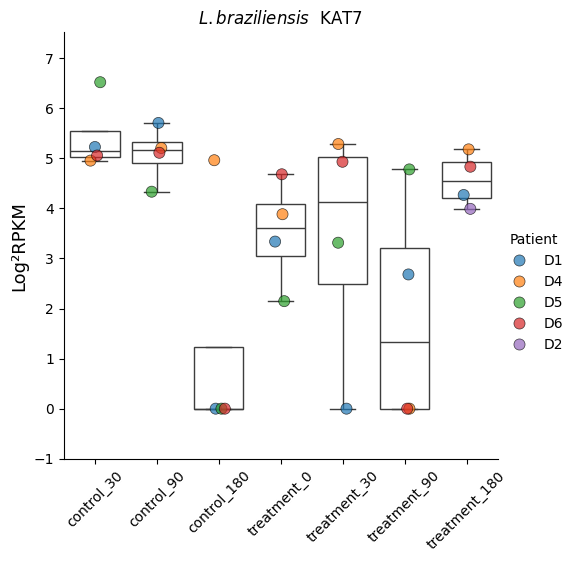

carregando


<Figure size 800x800 with 0 Axes>

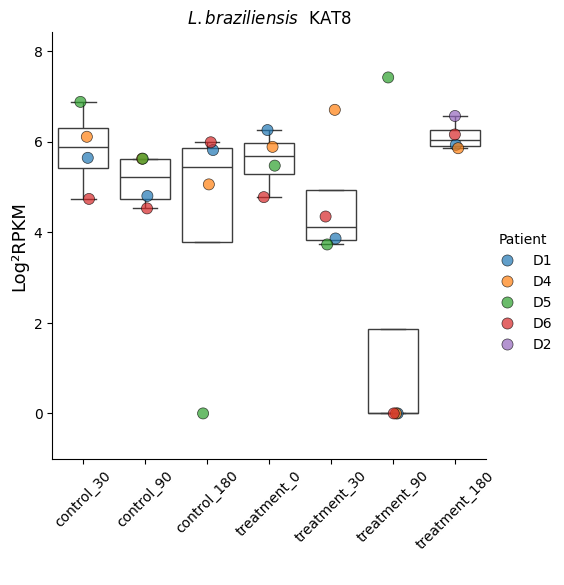

carregando


<Figure size 800x800 with 0 Axes>

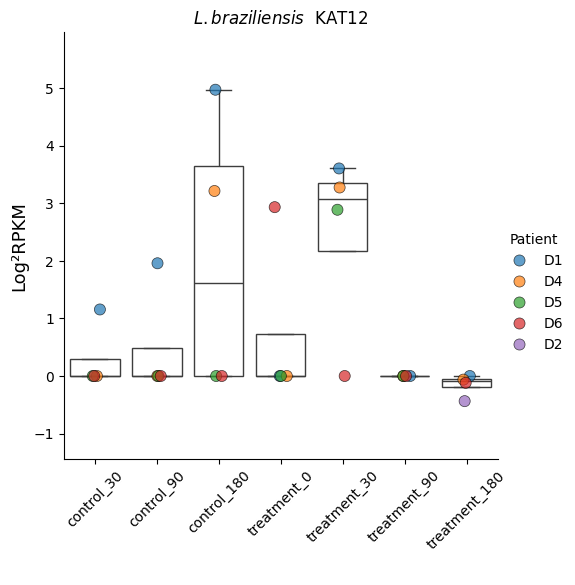

carregando


<Figure size 800x800 with 0 Axes>

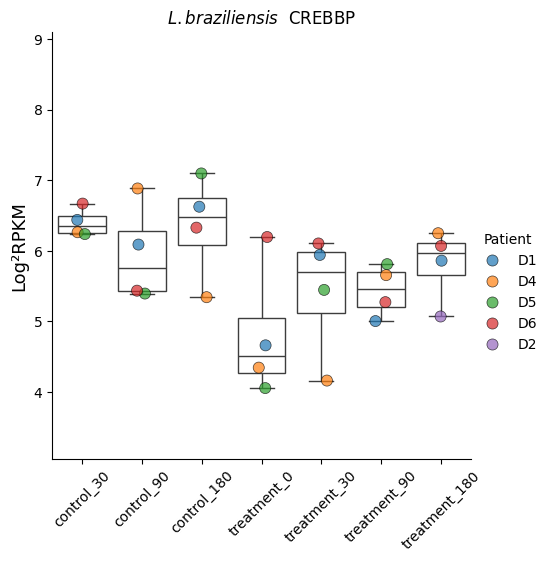

carregando


<Figure size 800x800 with 0 Axes>

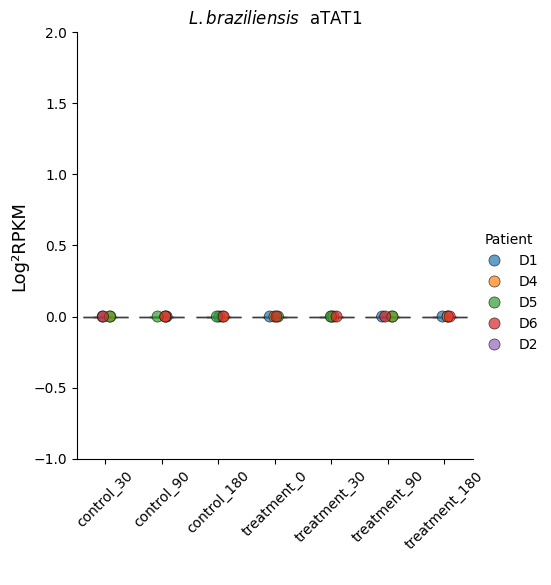

carregando


<Figure size 800x800 with 0 Axes>

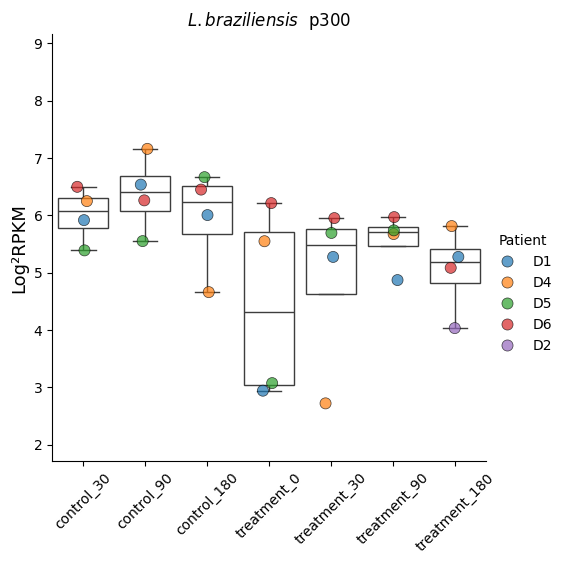

carregando


<Figure size 800x800 with 0 Axes>

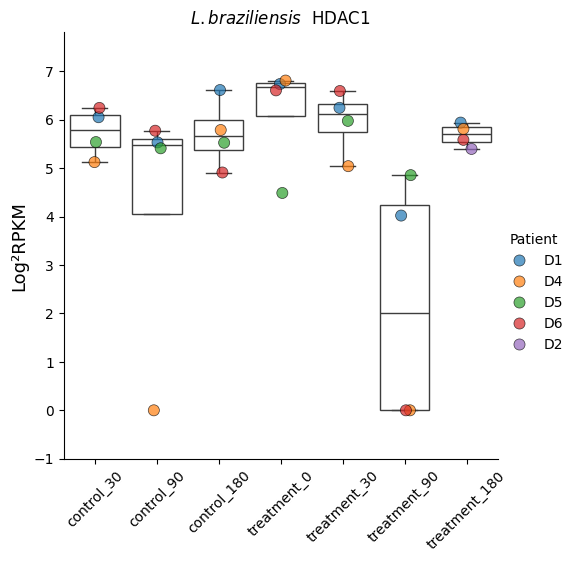

carregando


<Figure size 800x800 with 0 Axes>

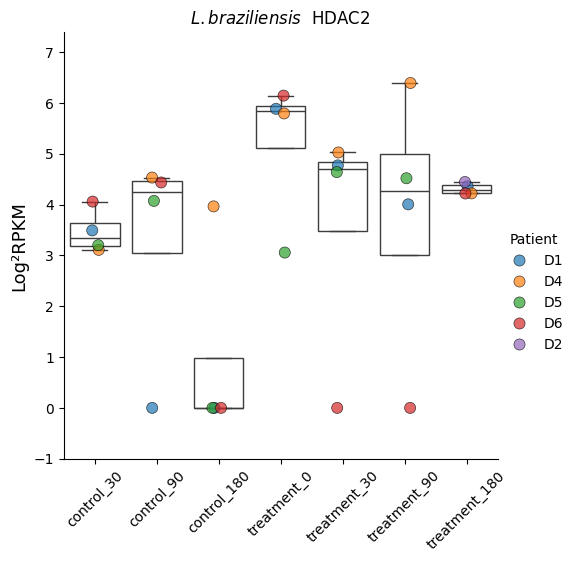

carregando


<Figure size 800x800 with 0 Axes>

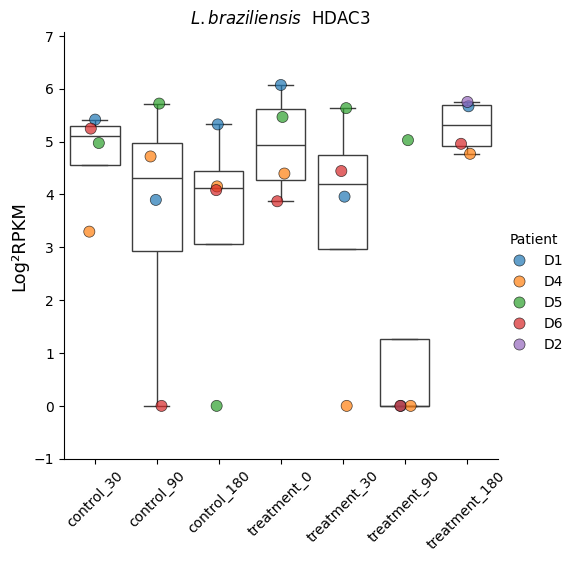

carregando


<Figure size 800x800 with 0 Axes>

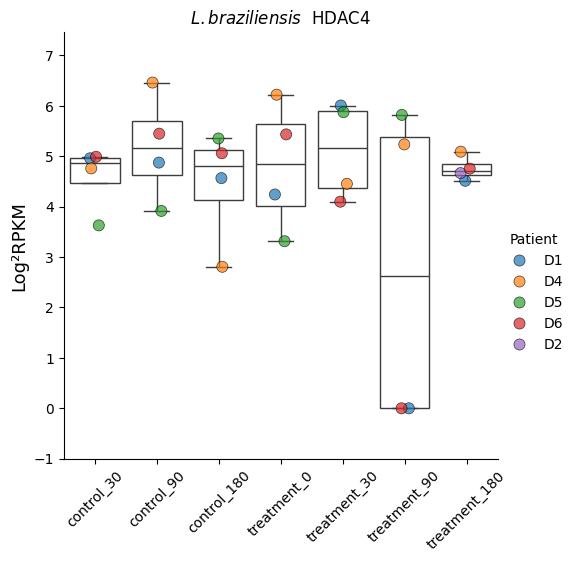

carregando


<Figure size 800x800 with 0 Axes>

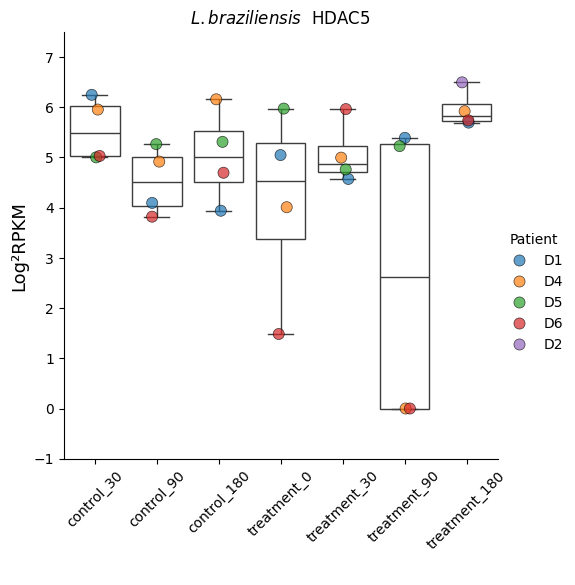

carregando


<Figure size 800x800 with 0 Axes>

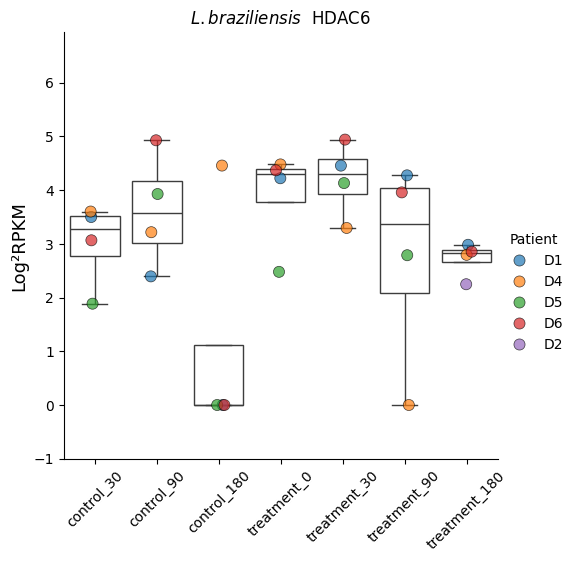

carregando


<Figure size 800x800 with 0 Axes>

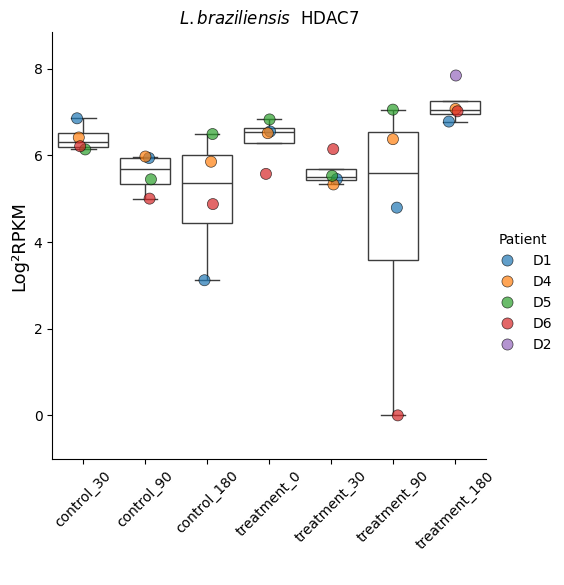

carregando


<Figure size 800x800 with 0 Axes>

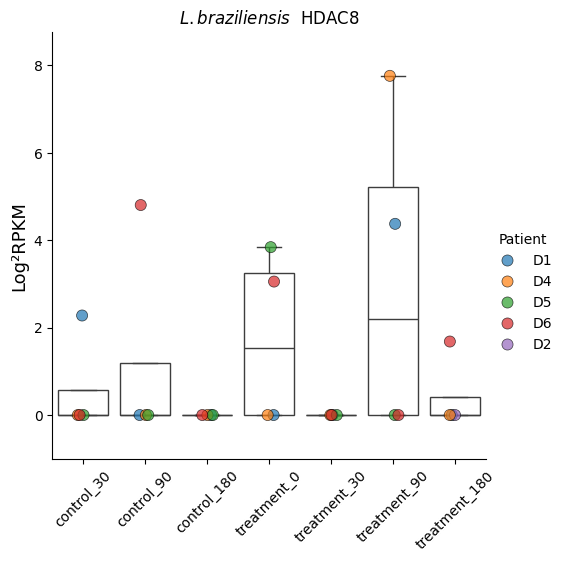

carregando


<Figure size 800x800 with 0 Axes>

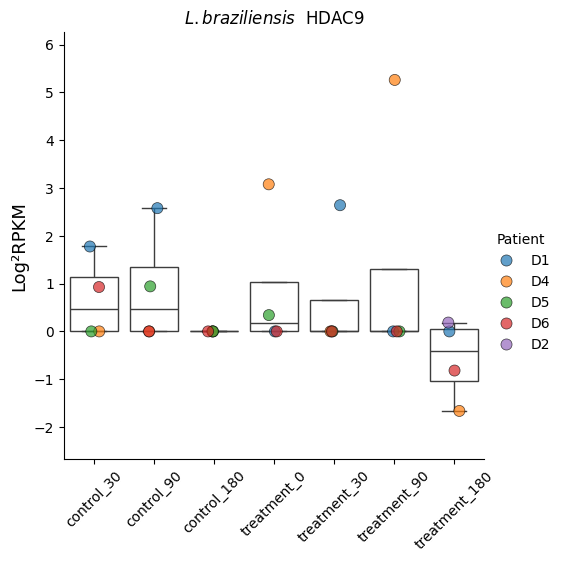

carregando


<Figure size 800x800 with 0 Axes>

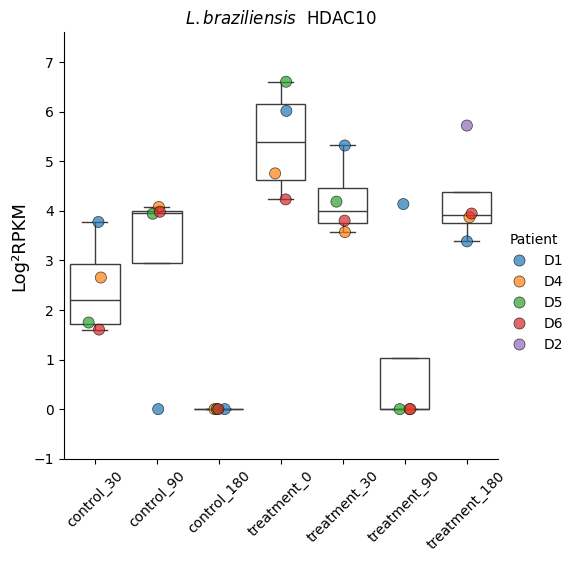

carregando


<Figure size 800x800 with 0 Axes>

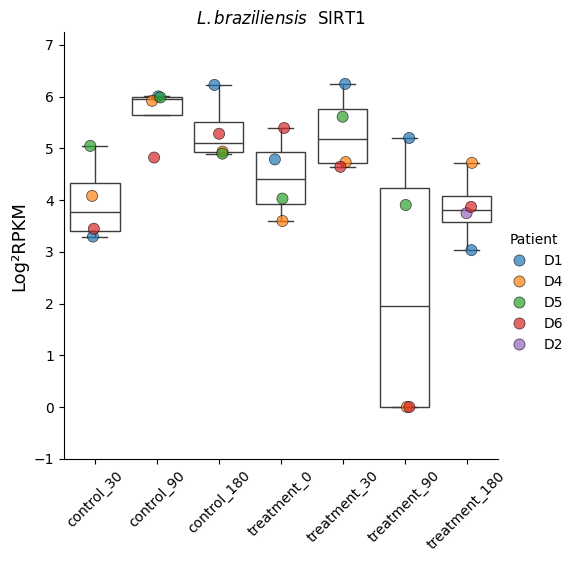

carregando


<Figure size 800x800 with 0 Axes>

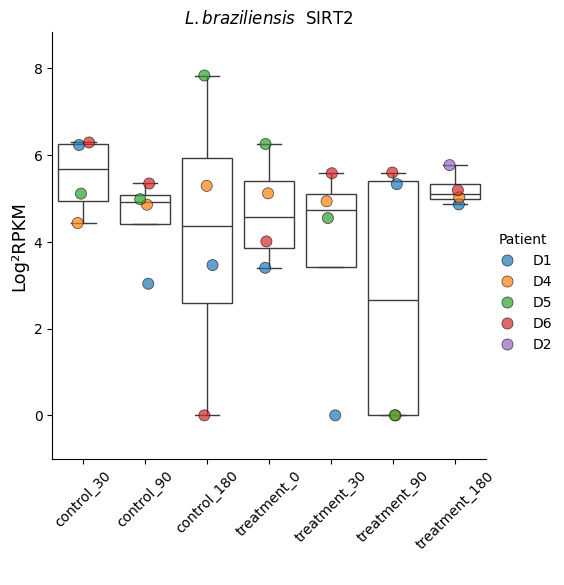

carregando


<Figure size 800x800 with 0 Axes>

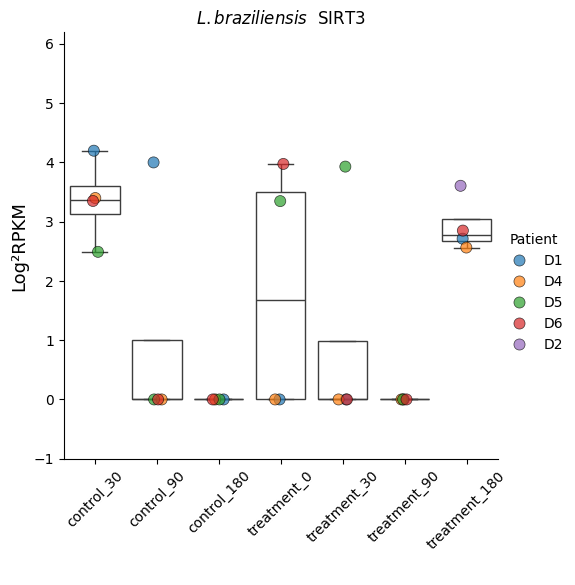

carregando


<Figure size 800x800 with 0 Axes>

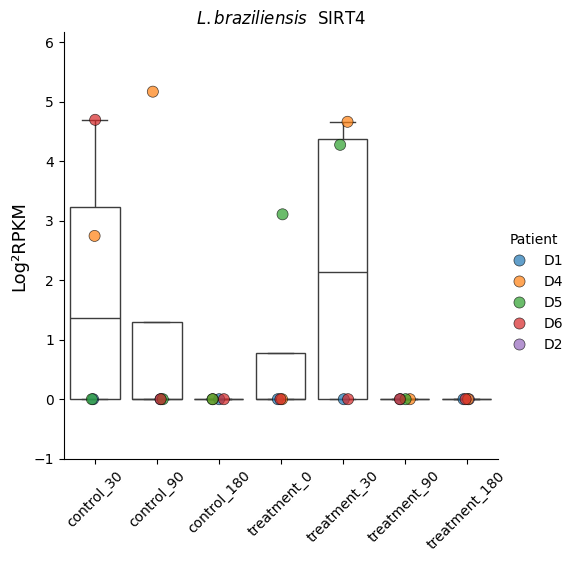

carregando


<Figure size 800x800 with 0 Axes>

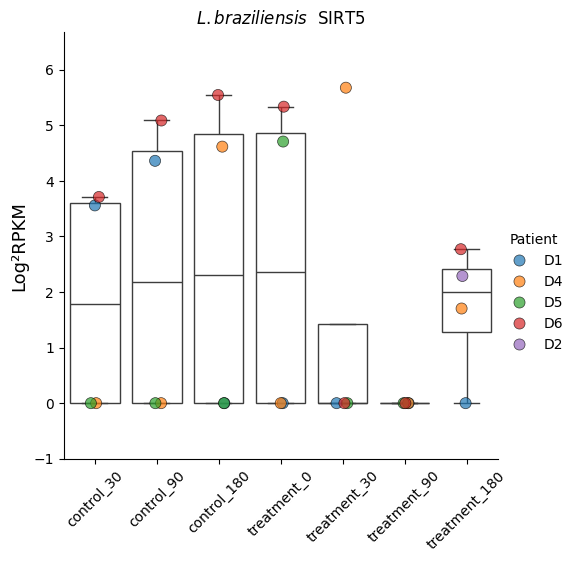

carregando


<Figure size 800x800 with 0 Axes>

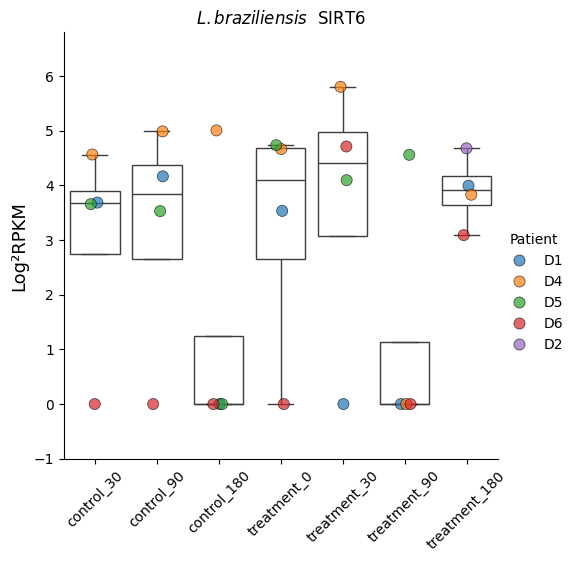

carregando


<Figure size 800x800 with 0 Axes>

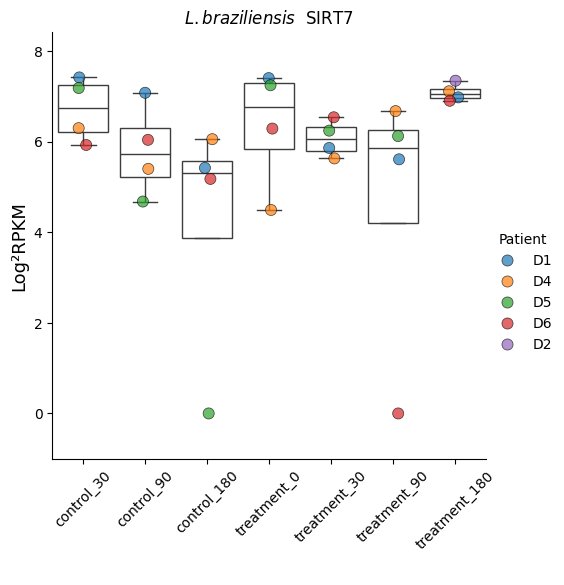

carregando


In [ ]:
graficos_boxplot(GSE55648_df_filtrado, "Blues", "L. braziliensis", [
'control_30',
'control_90',
'control_180',
 'treatment_0',
'treatment_30',
'treatment_90',
'treatment_180'])


#Candida albicans

##GSE120012 ✅


In [ ]:
GSE120012_tab = pd.read_excel(GSE120012 )
GSE120012_tab.head()

,Nome,CAWS_challenged_SRR7849970,CAWS_challenged_SRR7849971,CAWS_challenged_SRR7849972,CAWS_challenged_SRR7849973,CAWS_challenged_SRR7849974,CAWS_challenged_SRR7849975,CAWS_challenged_SRR7849976,CAWS_challenged_SRR7849977,CAWS_challenged_SRR7849978,naive_(cardiac_macrophage)_SRR7849961,naive_SRR7849962,naive_SRR7849963,naive_SRR7849964,naive_SRR7849965,naive_SRR7849966,naive_SRR7849967,naive_SRR7849968,naive_SRR7849969
0,YTHDF 1,5.320189,5.157881,5.028402,5.027714,4.938926,4.984990,5.178550,5.043575,4.997637,5.426470,5.666445,5.467124,5.407170,5.335257,5.362798,5.301640,5.220929,5.043838
1,YTHDF 2,4.668264,4.575093,4.579899,4.367230,4.492940,4.608777,4.538574,4.742141,4.629916,4.810673,4.707459,4.627663,4.860755,4.991754,4.579765,5.024302,4.761305,4.612333
2,YTHDF 3,5.936983,6.103474,6.122296,5.760152,5.783119,6.001832,5.725676,5.870864,6.043726,6.106809,6.040247,6.287846,6.181833,6.141471,6.110704,6.101407,6.026720,5.874396
3,YTHDC 1,4.809095,4.631174,4.643464,4.536792,4.521670,4.616086,4.490076,4.389711,4.715165,5.036447,4.816898,4.779766,4.704899,4.918386,4.782616,4.948540,4.733766,4.776773
4,FTO,5.251832,5.032307,5.303179,4.994852,5.055467,5.007590,4.718952,4.718532,4.910616,5.443610,5.475686,5.345926,5.149814,5.129987,5.207796,5.045553,5.075700,5.365191


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE120012_df_filtrado = GSE120012_tab[GSE120012_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE120012_df_filtrado.index = GSE120012_df_filtrado["Nome"]


In [ ]:
GSE120012_df_filtrado = GSE120012_df_filtrado.T

In [ ]:
GSE120012_df_filtrado = GSE120012_df_filtrado.iloc[1:]
GSE120012_df_filtrado

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
CAWS_challenged_SRR7849970,4.37826,3.859063,4.802907,4.798624,4.434135,1.82046,6.179843,3.459209,4.27322,2.529376,...,3.29914,4.35191,2.675129,3.536355,6.897608,3.282001,1.368449,1.90254,2.488316,5.029052
CAWS_challenged_SRR7849971,4.562061,4.05465,4.659007,4.627085,4.491277,1.187598,5.977509,3.836277,4.430942,2.239923,...,2.747349,3.773693,2.744761,3.18605,6.726988,3.292212,1.003566,1.933663,2.552852,5.031104
CAWS_challenged_SRR7849972,4.598664,4.177117,4.4888,4.774352,4.622799,1.16489,6.251716,3.548467,4.479155,2.623835,...,2.846093,3.492785,2.675576,3.423134,6.862781,3.416871,1.368284,0.970023,2.862777,4.94883
CAWS_challenged_SRR7849973,4.538966,3.796599,4.535748,4.941746,4.179923,1.363955,5.983629,3.411012,4.044084,2.179472,...,2.867998,3.851548,2.233301,3.344346,6.740856,3.148561,1.40499,1.754838,2.726447,5.297557
CAWS_challenged_SRR7849974,4.896067,3.847487,4.131186,4.65219,4.225138,0.816403,6.117403,3.484513,4.104347,2.132425,...,2.63227,3.569777,2.515578,3.228768,6.475471,3.664665,1.935395,1.963782,2.455997,4.794636
CAWS_challenged_SRR7849975,4.582013,3.859596,4.45396,4.357351,4.73914,1.235496,6.206243,3.617387,4.470409,2.283607,...,2.633919,3.393775,2.478527,3.42833,6.604585,2.685139,1.105504,1.330428,2.827509,5.078026
CAWS_challenged_SRR7849976,4.869881,4.117825,4.115447,4.40657,3.745415,0.704114,6.014204,3.670245,3.498195,1.451393,...,2.621651,3.598604,1.868772,2.925267,6.579743,3.504743,1.478262,1.779134,2.956341,5.465272
CAWS_challenged_SRR7849977,4.834024,4.029826,4.059302,4.494441,3.906362,0.674937,6.030106,3.669928,3.88012,1.520926,...,2.497865,3.533983,2.250787,2.973037,6.565528,3.84481,1.456958,1.839999,2.75799,5.179571
CAWS_challenged_SRR7849978,4.918093,4.060032,4.220719,4.436247,4.635356,1.32475,6.314573,3.653366,4.16295,2.369522,...,2.608543,3.192263,2.039762,3.245199,6.521041,3.568949,0.930039,1.474977,3.128543,5.208474
naive_(cardiac_macrophage)_SRR7849961,4.423653,4.318319,4.623384,4.759075,4.985112,1.650579,6.232689,3.478607,4.71317,2.716662,...,2.420845,4.403268,2.910325,3.930068,6.279081,2.917412,1.83318,1.232831,2.274811,5.056372


In [ ]:
GSE120012_df_filtrado.index.to_list()

['CAWS_challenged_SRR7849970',
 'CAWS_challenged_SRR7849971',
 'CAWS_challenged_SRR7849972',
 'CAWS_challenged_SRR7849973',
 'CAWS_challenged_SRR7849974',
 'CAWS_challenged_SRR7849975',
 'CAWS_challenged_SRR7849976',
 'CAWS_challenged_SRR7849977',
 'CAWS_challenged_SRR7849978',
 'naive_(cardiac_macrophage)_SRR7849961',
 'naive_SRR7849962',
 'naive_SRR7849963',
 'naive_SRR7849964',
 'naive_SRR7849965',
 'naive_SRR7849966',
 'naive_SRR7849967',
 'naive_SRR7849968',
 'naive_SRR7849969']

In [ ]:
GSE120012_df_filtrado["Status"] = [
'CAWS_challenged',
'CAWS_challenged',
'CAWS_challenged',
'CAWS_challenged',
'CAWS_challenged',
'CAWS_challenged',
'CAWS_challenged',
'CAWS_challenged',
'CAWS_challenged',
'naive',
'naive',
'naive',
'naive',
'naive',
'naive',
'naive',
'naive',
'naive']

In [ ]:
set(GSE120012_df_filtrado["Status"])


{'CAWS_challenged', 'naive'}

In [ ]:
infected_data = GSE120012_df_filtrado[GSE120012_df_filtrado['Status'] == 'CAWS_challenged']
uninfected_data = GSE120012_df_filtrado[GSE120012_df_filtrado['Status'] == 'naive']

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

# INF_df
# UNF_df


In [ ]:
# Calcular a mediana para cada grupo
# median_infected = infected_data.iloc[:, 0:-1].median()
# median_uninfected = uninfected_data.iloc[:, 0:-1].median()
# median_uninfected-median_infected
# [u-i for u,i  in zip (median_uninfected,median_infected)]
# median_uninfected
# # median_infected
# for I,U in zip (median_infected, median_uninfected):
#     pass
# #   print(f" inf:{I}      un: {U}    dif:  {I-U}")
INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.088866,-0.288492,0.189547,-0.057116,-0.284671,0.085971,-0.067059,0.13878,-0.354663,-0.306052,...,0.213074,-0.471274,0.259292,-0.399485,0.369047,0.363805,0.335289,0.393394,-0.004217,-0.021105


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

nome="Candida_albicans_GSE120012"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE120012/"+ nome+".xlsx")
regulated_genes


Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, caminho="aqui"):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, edgecolor='black',linewidth=0.51,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE120012/{especie}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
"sadsa sdasd sadf".split()

['sadsa', 'sdasd', 'sadf']

<Figure size 800x800 with 0 Axes>

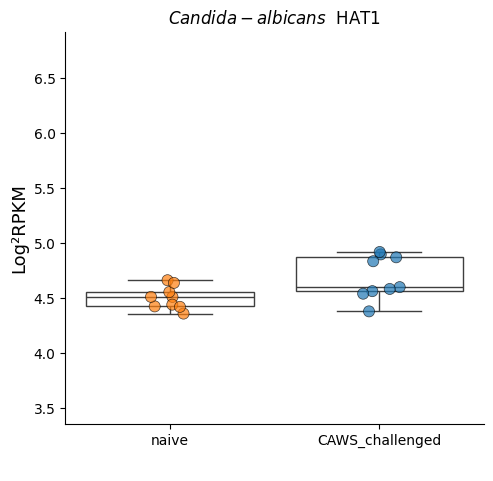

carregando


<Figure size 800x800 with 0 Axes>

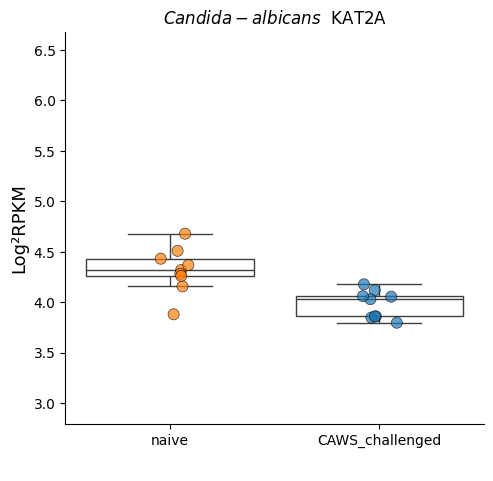

carregando


<Figure size 800x800 with 0 Axes>

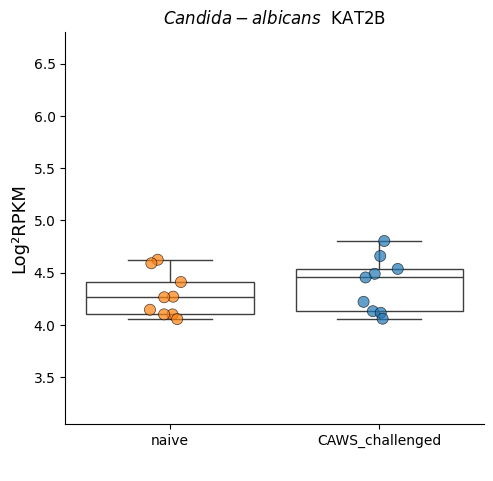

carregando


<Figure size 800x800 with 0 Axes>

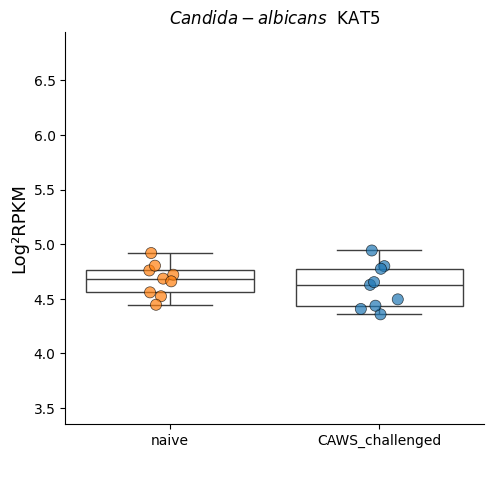

carregando


<Figure size 800x800 with 0 Axes>

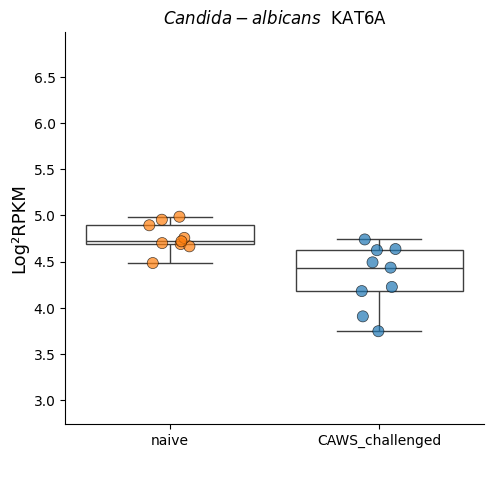

carregando


<Figure size 800x800 with 0 Axes>

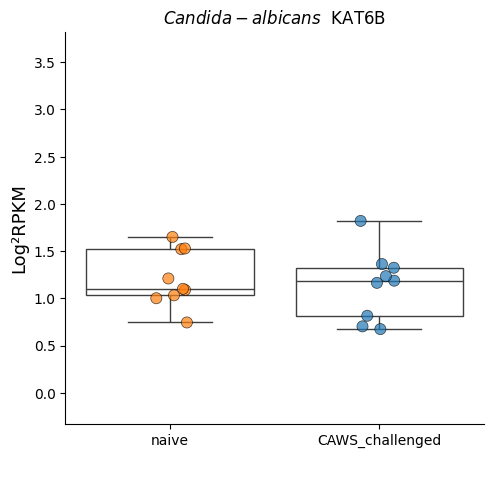

carregando


<Figure size 800x800 with 0 Axes>

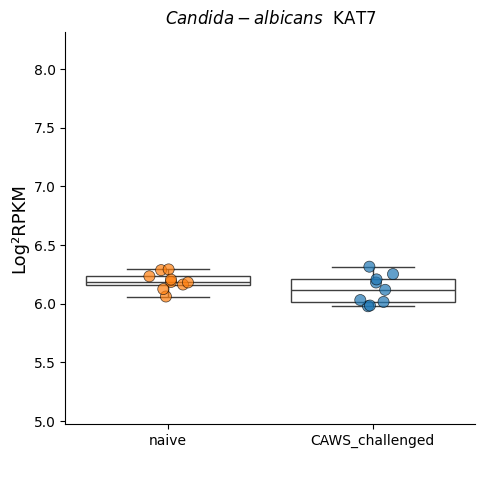

carregando


<Figure size 800x800 with 0 Axes>

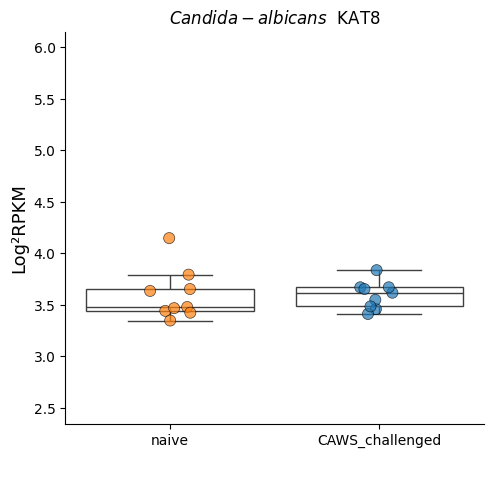

carregando


<Figure size 800x800 with 0 Axes>

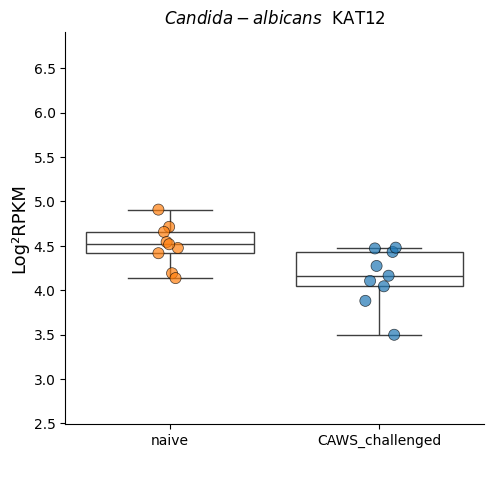

carregando


<Figure size 800x800 with 0 Axes>

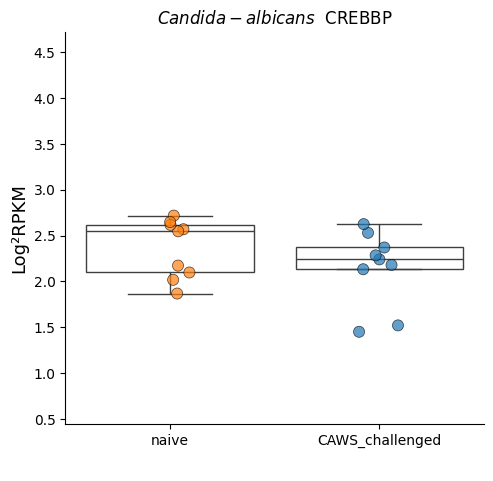

carregando


<Figure size 800x800 with 0 Axes>

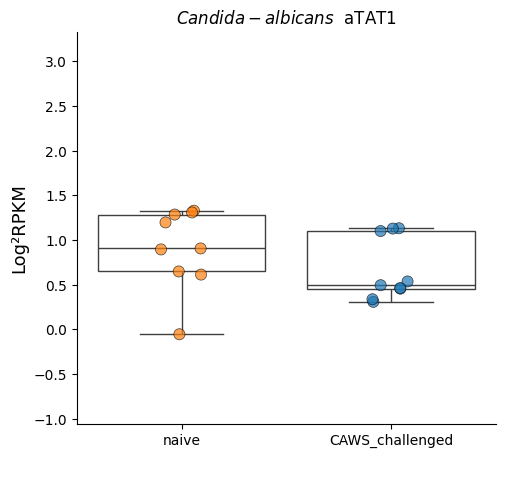

carregando


<Figure size 800x800 with 0 Axes>

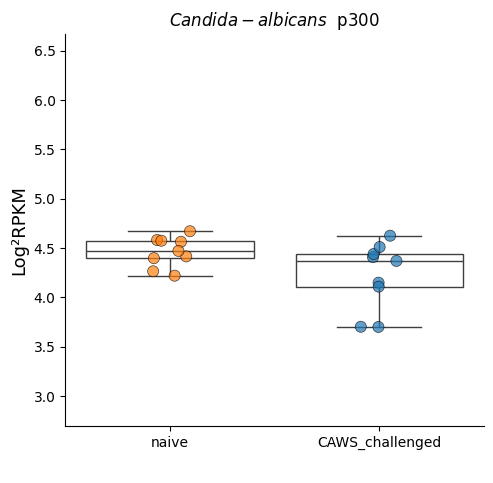

carregando


<Figure size 800x800 with 0 Axes>

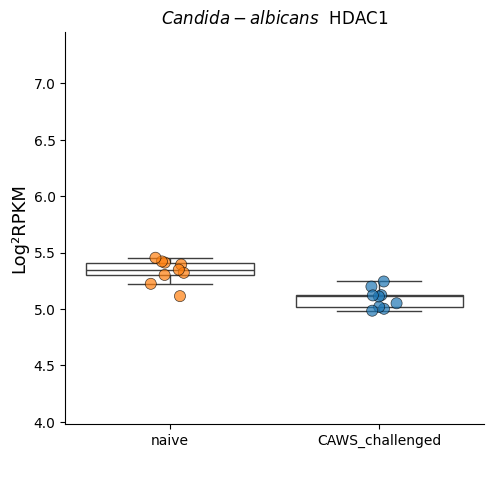

carregando


<Figure size 800x800 with 0 Axes>

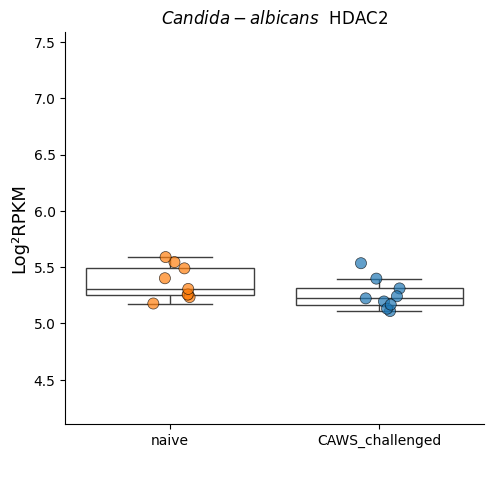

carregando


<Figure size 800x800 with 0 Axes>

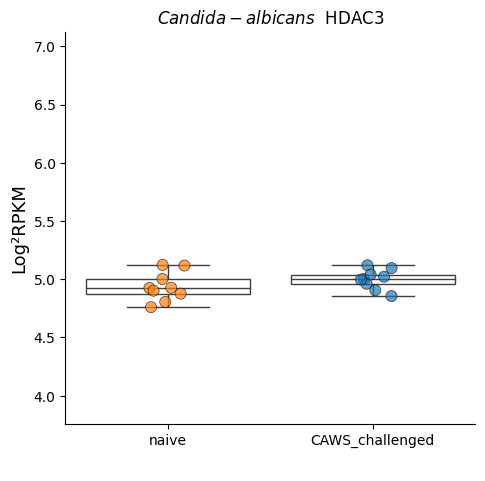

carregando


<Figure size 800x800 with 0 Axes>

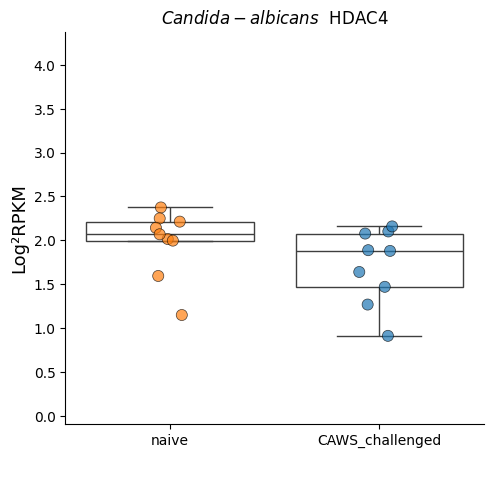

carregando


<Figure size 800x800 with 0 Axes>

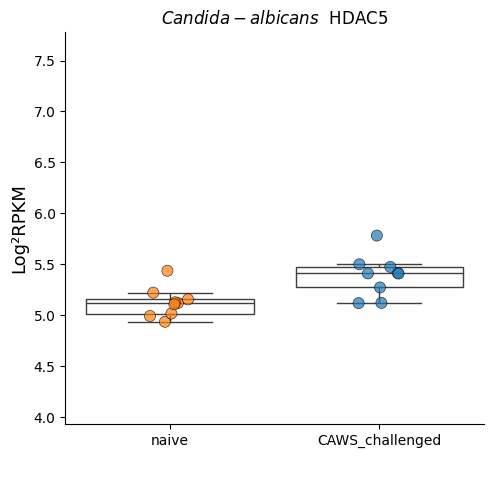

carregando


<Figure size 800x800 with 0 Axes>

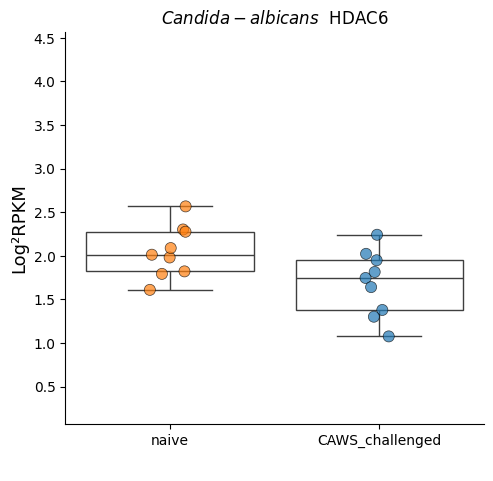

carregando


<Figure size 800x800 with 0 Axes>

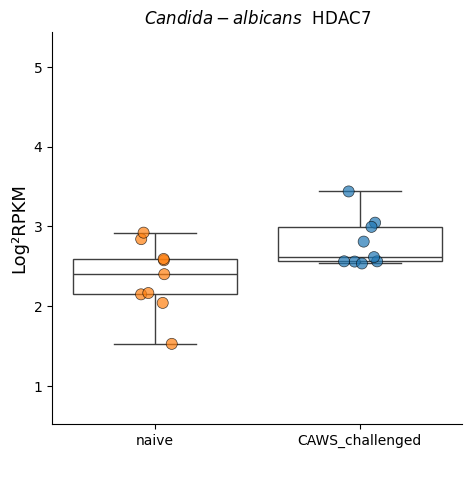

carregando


<Figure size 800x800 with 0 Axes>

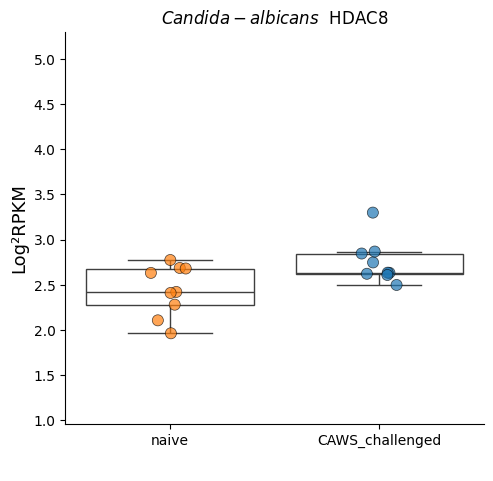

carregando


<Figure size 800x800 with 0 Axes>

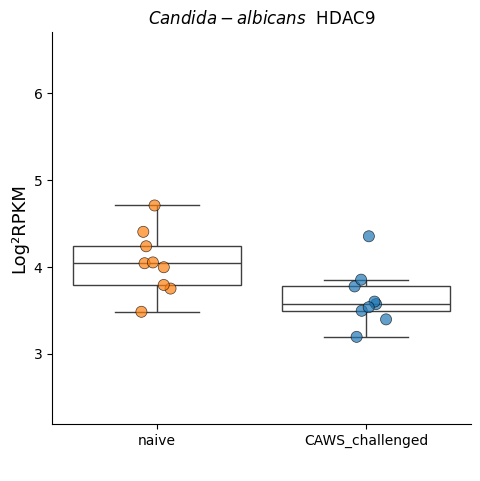

carregando


<Figure size 800x800 with 0 Axes>

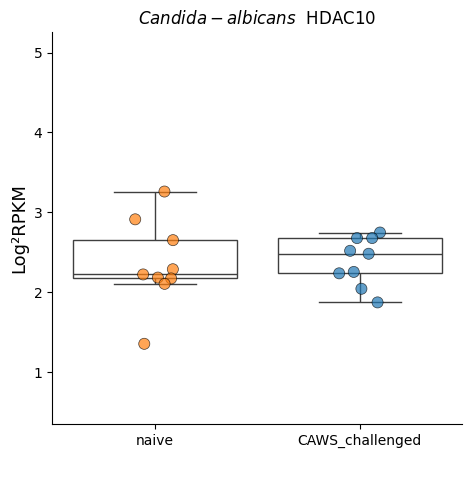

carregando


<Figure size 800x800 with 0 Axes>

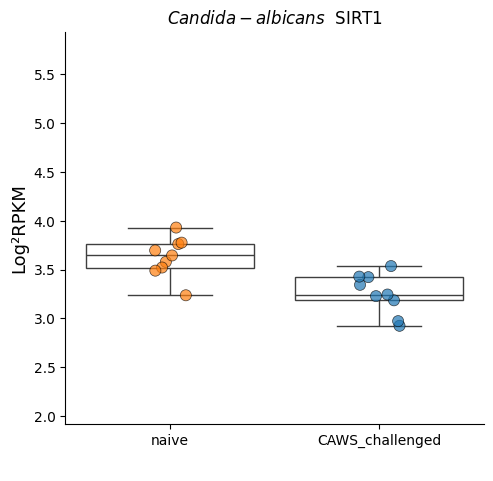

carregando


<Figure size 800x800 with 0 Axes>

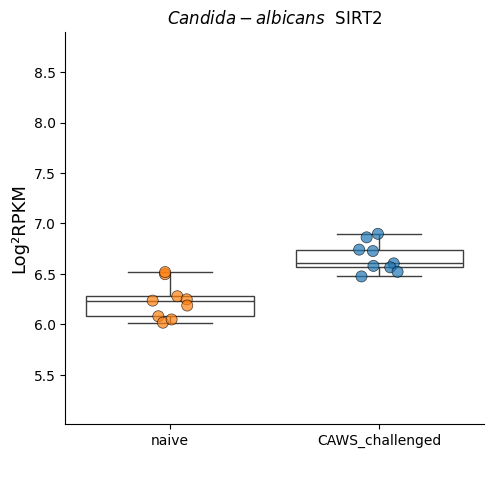

carregando


<Figure size 800x800 with 0 Axes>

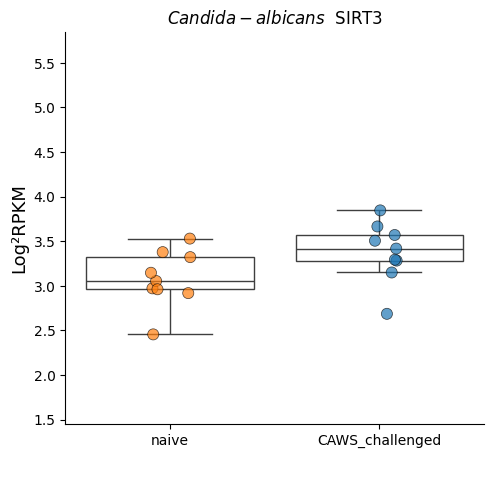

carregando


<Figure size 800x800 with 0 Axes>

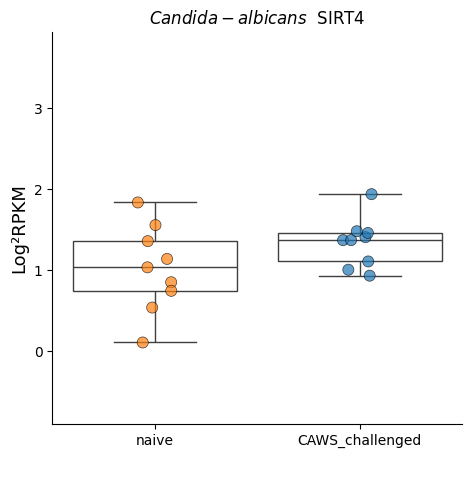

carregando


<Figure size 800x800 with 0 Axes>

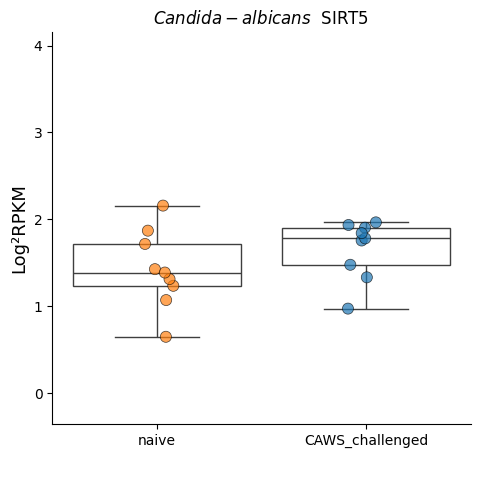

carregando


<Figure size 800x800 with 0 Axes>

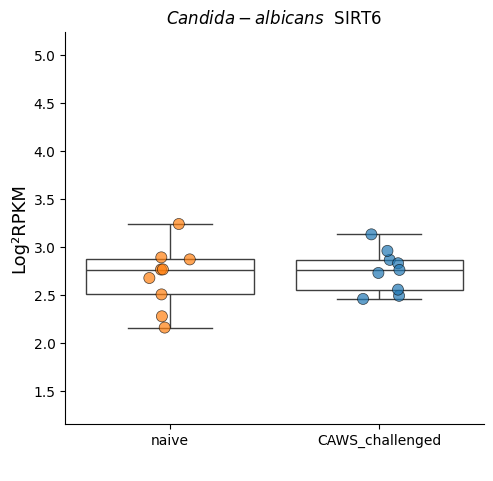

carregando


<Figure size 800x800 with 0 Axes>

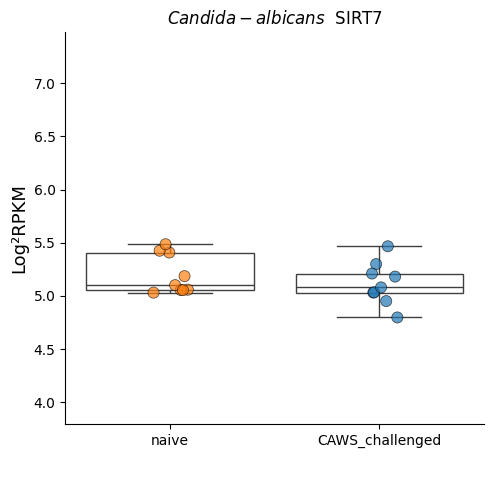

carregando


In [ ]:
graficos_boxplot(GSE120012_df_filtrado, "Blues", "Candida-albicans", ["naive", 'CAWS_challenged'])


##GSE184104 ✅




In [3]:
GSE184104_tab = pd.read_excel(GSE184104 )
GSE184104_tab.head()

,Nome,PCA2-infected_24h_SRR15896662,PCA2-infected_24h_SRR15896663,PCA2-infected_24h_SRR15896664,PCA2-infected_24h_SRR15896665,PCA2-infected_7h_SRR15896666,PCA2-infected_7h_SRR15896667,PCA2-infected_7h_SRR15896668,PCA2-infected_7h_SRR15896669,non-infected_SRR15896658,non-infected_SRR15896659,non-infected_SRR15896660,non-infected_SRR15896661
0,YTHDF 1,5.327391,5.301112,5.283092,5.298153,5.144242,5.165718,5.108098,5.130962,5.565095,5.560795,5.529529,5.508015
1,YTHDF 2,6.265573,6.259638,6.214965,6.257871,6.246499,6.263343,6.268628,6.221027,6.264837,6.264754,6.280702,6.281824
2,YTHDF 3,4.110850,4.132147,4.088801,3.965096,3.984934,3.969883,3.971526,4.026916,4.055935,4.008001,4.048756,4.061899
3,YTHDC 1,6.281083,6.333979,6.322648,6.311703,6.334242,6.292970,6.318975,6.293331,6.229065,6.245765,6.255145,6.176270
4,FTO,3.515963,3.643413,3.568217,3.524766,3.744987,3.468837,3.647975,3.666770,3.801000,3.755916,3.760015,3.651802


In [4]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE184104_df_filtrado = GSE184104_tab[GSE184104_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE184104_df_filtrado.index = GSE184104_df_filtrado["Nome"]

GSE184104_df_filtrado = GSE184104_df_filtrado.T
df_filtrado = GSE184104_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
PCA2-infected_24h_SRR15896662,7.243807,4.204277,2.23909,0.63092,3.036668,0.802371,5.354385,3.848658,3.043131,2.675078,...,3.221596,-1.606119,2.201898,2.375913,5.115653,5.026908,2.420893,3.762613,3.838813,5.266706
PCA2-infected_24h_SRR15896663,7.252526,4.159137,2.501289,1.07635,2.980946,0.769454,5.325195,3.930273,3.082035,2.754351,...,3.14115,-1.906933,2.208983,2.563145,5.146828,5.105175,2.487811,3.731523,3.89221,5.16548
PCA2-infected_24h_SRR15896664,7.307798,4.151939,2.39505,0.701224,2.91343,0.768338,5.358288,3.938892,3.045818,2.76043,...,3.156069,-1.417171,2.209009,2.450275,5.183775,5.16735,2.547781,3.731634,3.862221,5.135376
PCA2-infected_24h_SRR15896665,7.288584,4.120071,2.438401,0.754024,2.945551,0.821138,5.361373,3.866589,3.160201,2.733016,...,3.250261,-1.551728,2.229655,2.461679,5.124847,5.194805,2.696671,3.666922,3.788671,5.174129
PCA2-infected_7h_SRR15896666,7.248582,4.144478,2.346341,0.904974,3.032714,1.058638,5.517749,3.852972,2.858947,2.730246,...,3.299178,-1.917027,2.341935,2.444373,5.242321,5.177881,2.746749,3.56615,3.879396,5.199553


In [5]:
df_filtrado.index.to_list()

['PCA2-infected_24h_SRR15896662',
 'PCA2-infected_24h_SRR15896663',
 'PCA2-infected_24h_SRR15896664',
 'PCA2-infected_24h_SRR15896665',
 'PCA2-infected_7h_SRR15896666',
 'PCA2-infected_7h_SRR15896667',
 'PCA2-infected_7h_SRR15896668',
 'PCA2-infected_7h_SRR15896669',
 'non-infected_SRR15896658',
 'non-infected_SRR15896659',
 'non-infected_SRR15896660',
 'non-infected_SRR15896661']

In [6]:
df_filtrado["Status"] =['PCA2-infected_24h',
'PCA2-infected_24h',
'PCA2-infected_24h',
'PCA2-infected_24h',
'PCA2-infected_7h',
'PCA2-infected_7h',
'PCA2-infected_7h',
'PCA2-infected_7h',
'non-infected',
'non-infected',
'non-infected',
'non-infected']

<ipython-input-6-8b2a51e7fde8>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =['PCA2-infected_24h',


In [9]:
set(df_filtrado["Status"])


{'PCA2-infected_24h', 'PCA2-infected_7h', 'non-infected'}

In [12]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'PCA2-infected_24h']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'non-infected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,-0.056177,-0.275521,-0.162342,-0.279779,-0.100969,-0.361572,-0.1422,-0.302103,0.006347,-0.088045,...,-0.334731,-0.449893,-0.676804,-0.294787,-0.377885,-0.03382,-0.467578,0.011301,-0.04245,-0.284026


In [13]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Candida_albicans_GSE184104_PCA2-infected_24h"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE184104/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [14]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'infected_7h']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'non-infected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [15]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Candida_albicans_GSE184104_infected_7h"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE184104/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.51,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE184104/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



<Figure size 800x800 with 0 Axes>

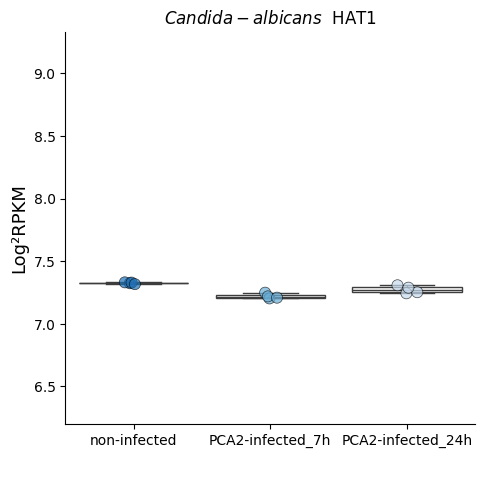

carregando


<Figure size 800x800 with 0 Axes>

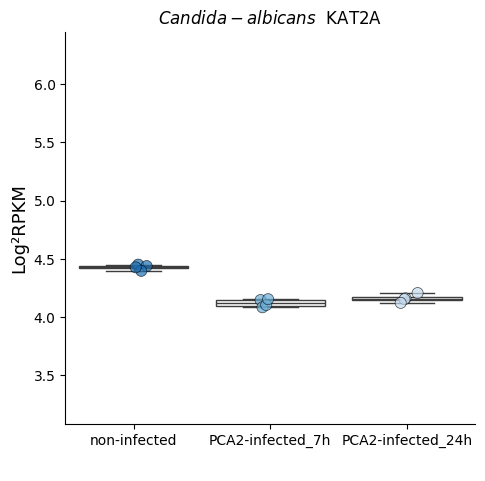

carregando


<Figure size 800x800 with 0 Axes>

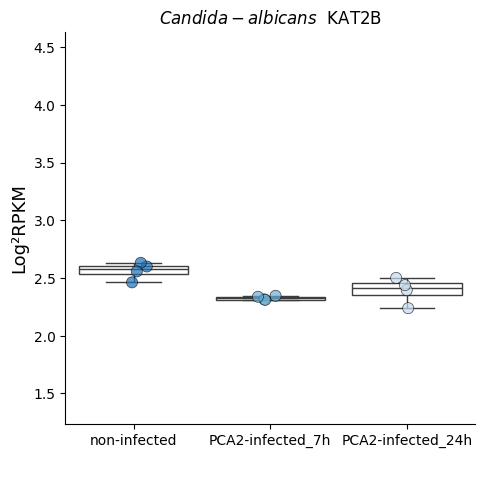

carregando


<Figure size 800x800 with 0 Axes>

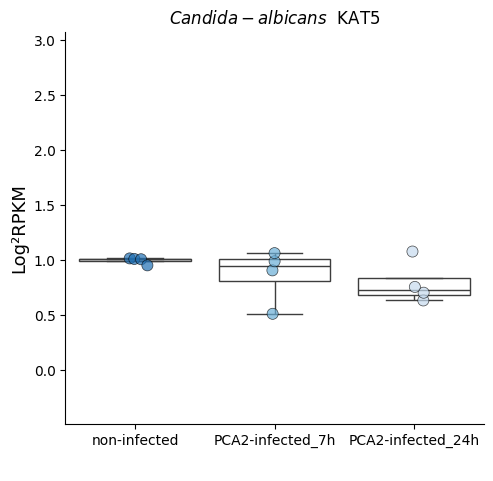

carregando


<Figure size 800x800 with 0 Axes>

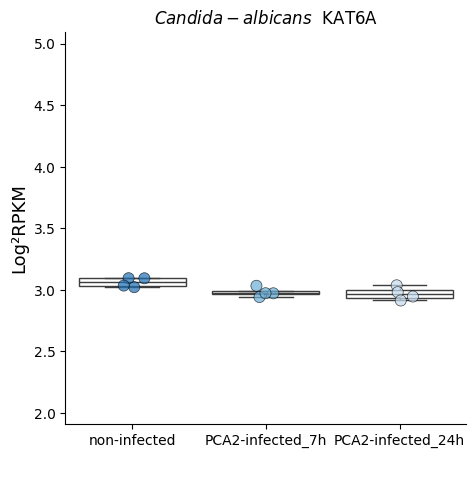

carregando


<Figure size 800x800 with 0 Axes>

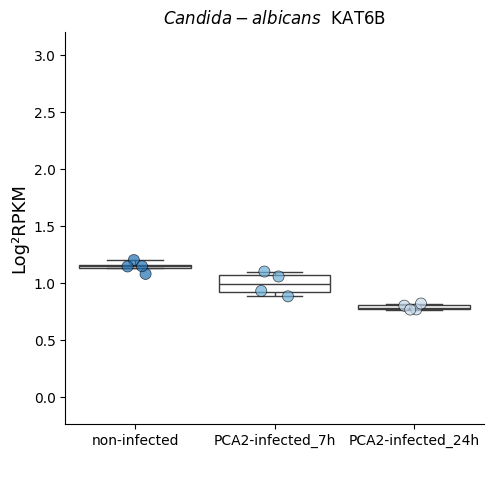

carregando


<Figure size 800x800 with 0 Axes>

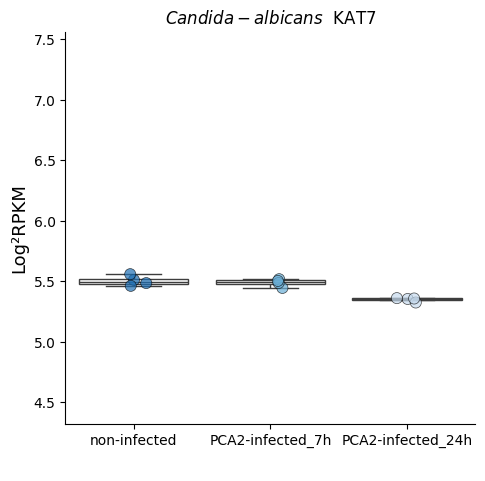

carregando


<Figure size 800x800 with 0 Axes>

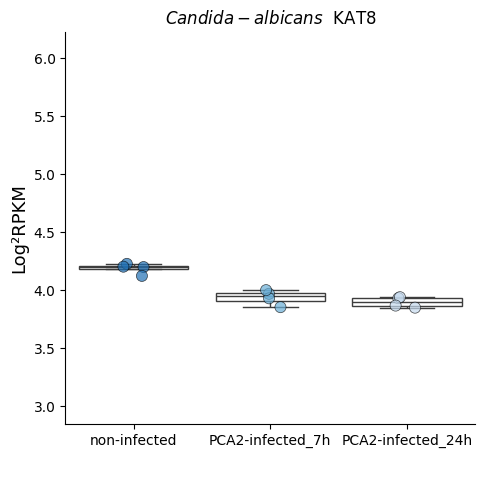

carregando


<Figure size 800x800 with 0 Axes>

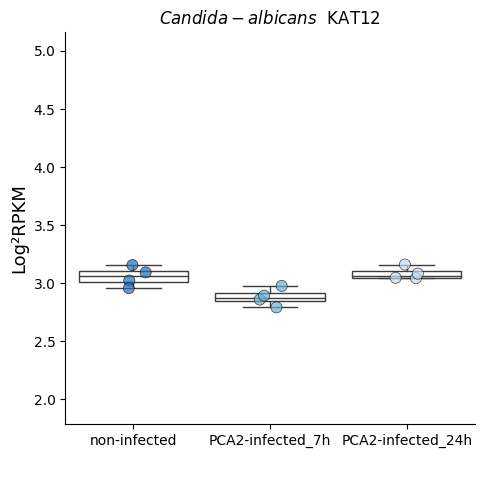

carregando


<Figure size 800x800 with 0 Axes>

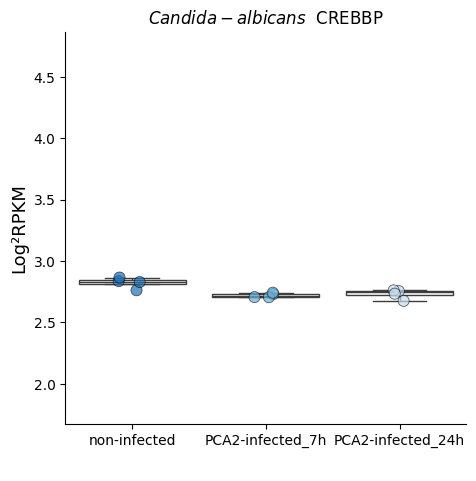

carregando


<Figure size 800x800 with 0 Axes>

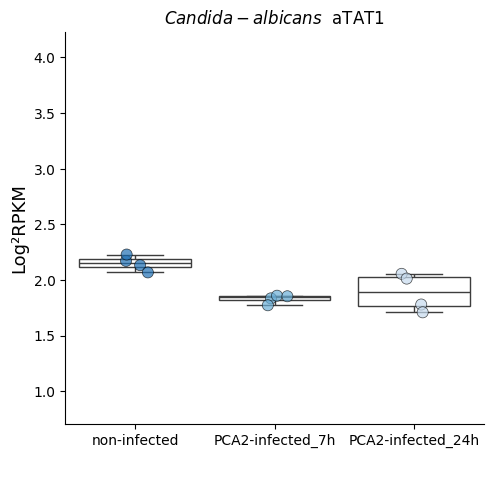

carregando


<Figure size 800x800 with 0 Axes>

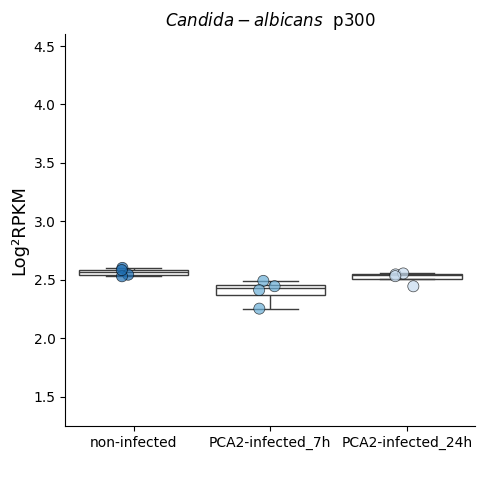

carregando


<Figure size 800x800 with 0 Axes>

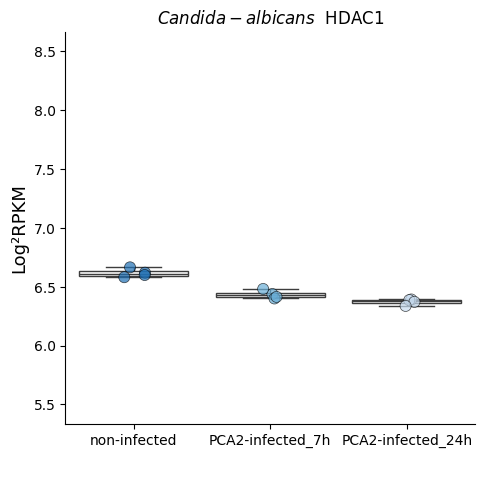

carregando


<Figure size 800x800 with 0 Axes>

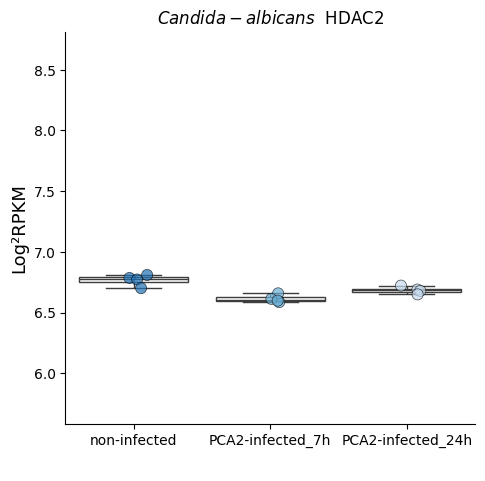

carregando


<Figure size 800x800 with 0 Axes>

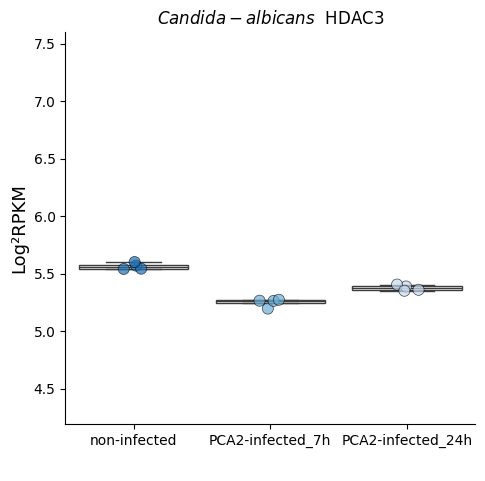

carregando


<Figure size 800x800 with 0 Axes>

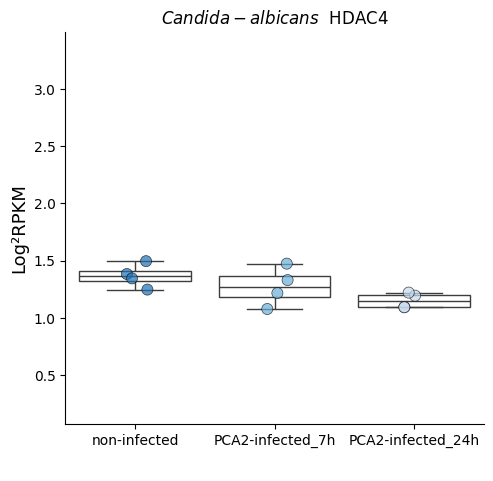

carregando


<Figure size 800x800 with 0 Axes>

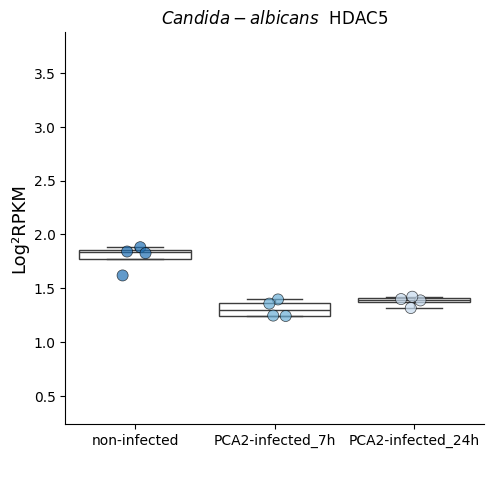

carregando


<Figure size 800x800 with 0 Axes>

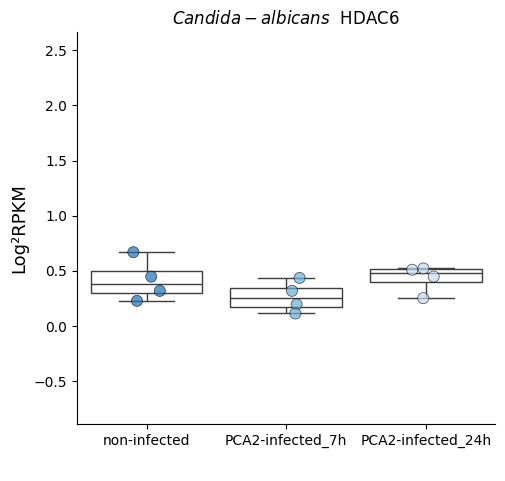

carregando


<Figure size 800x800 with 0 Axes>

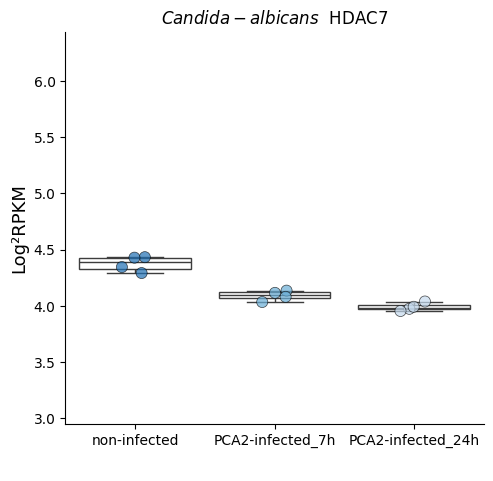

carregando


<Figure size 800x800 with 0 Axes>

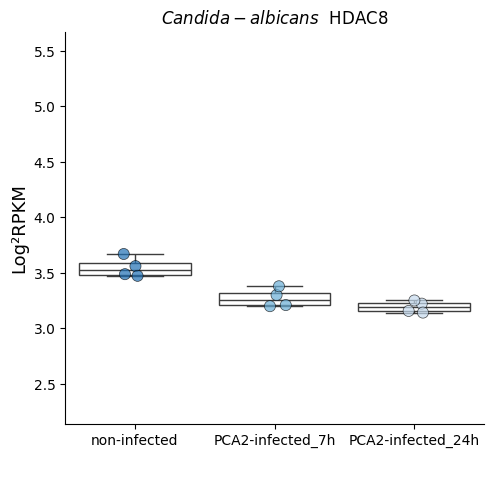

carregando


<Figure size 800x800 with 0 Axes>

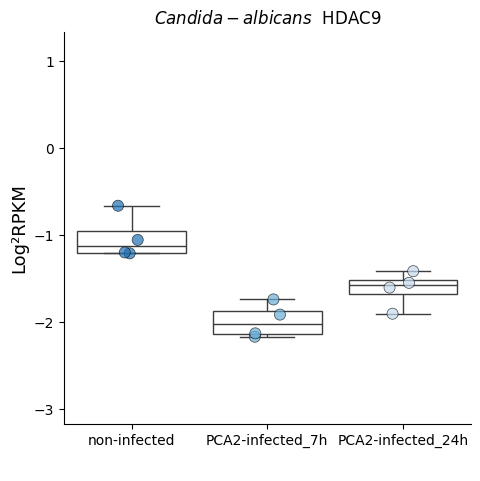

carregando


<Figure size 800x800 with 0 Axes>

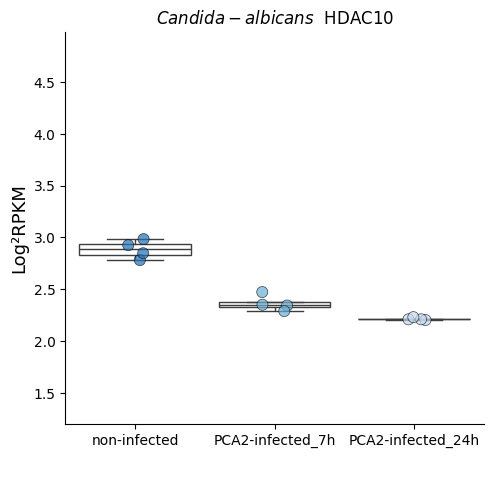

carregando


<Figure size 800x800 with 0 Axes>

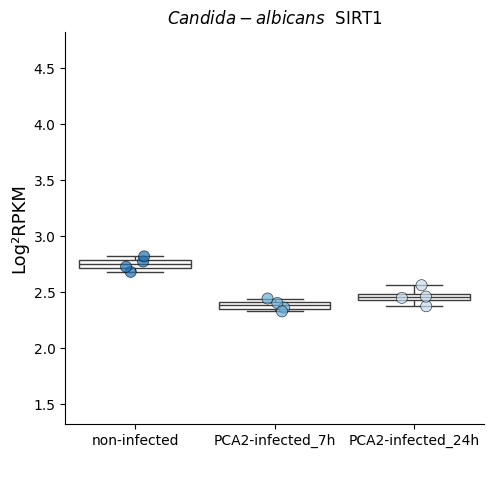

carregando


<Figure size 800x800 with 0 Axes>

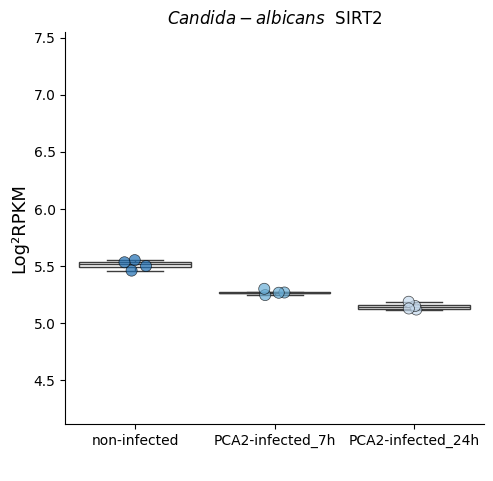

carregando


<Figure size 800x800 with 0 Axes>

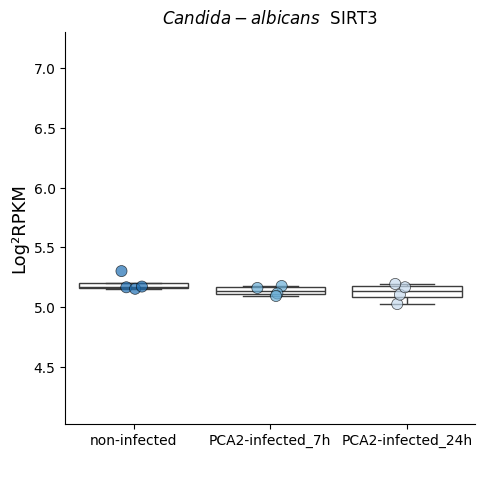

carregando


<Figure size 800x800 with 0 Axes>

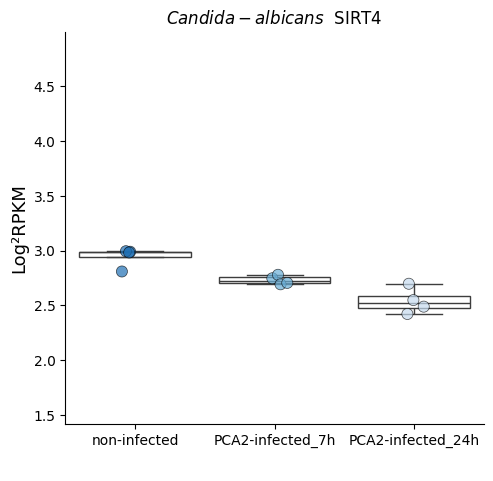

carregando


<Figure size 800x800 with 0 Axes>

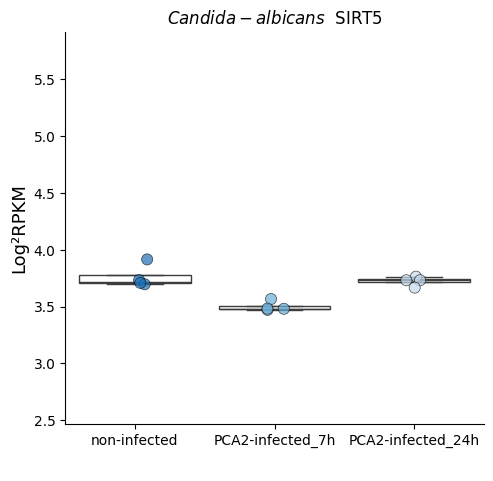

carregando


<Figure size 800x800 with 0 Axes>

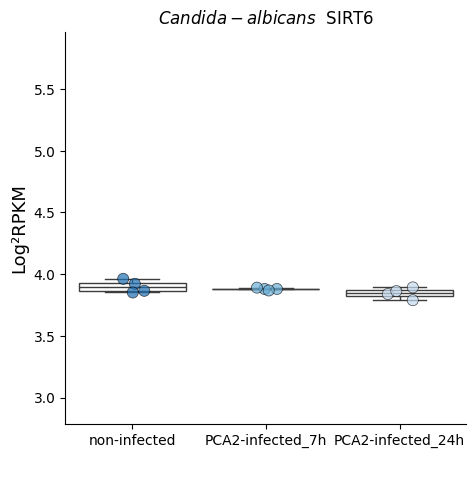

carregando


<Figure size 800x800 with 0 Axes>

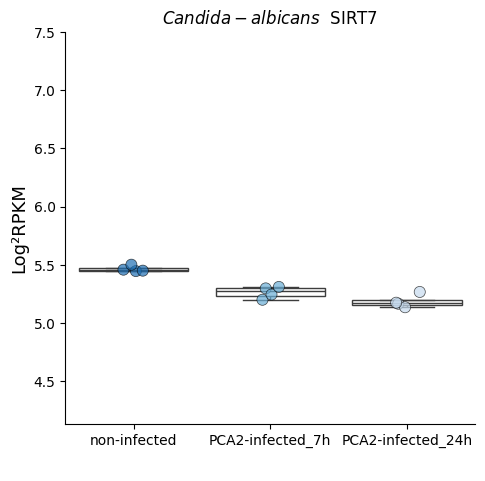

carregando


In [ ]:
graficos_boxplot(df_filtrado, "Blues", "Candida-albicans",[ 'non-infected', 'PCA2-infected_7h','PCA2-infected_24h'], nome)


#HIV

##GSE103666 ✅

In [ ]:
GSE103666_tab = pd.read_excel(GSE103666 )
GSE103666_tab.head()

,Nome,Infected_SRR6023101,Infected_SRR6023103,Infected_SRR6023105,Infected_SRR6023107,Infected_SRR6023109,Infected_SRR6023111,Uninfected_SRR6023100,Uninfected_SRR6023102,Uninfected_SRR6023104,Uninfected_SRR6023106,Uninfected_SRR6023108,Uninfected_SRR6023110
0,YTHDF 1,3.695129,3.966894,3.472888,3.718967,3.846155,3.937863,3.651955,3.659652,3.518258,3.591928,3.916249,3.726612
1,YTHDF 2,5.657375,5.770106,5.612852,5.693605,5.610646,5.502138,5.430852,5.845867,5.402962,5.665837,5.679895,5.642603
2,YTHDF 3,5.311126,4.931824,5.350437,4.949864,5.357725,5.314937,4.960913,5.225388,5.563083,4.822003,5.570431,5.203008
3,YTHDC 1,-5.733231,0.000000,-3.683700,-5.526824,0.000000,0.000000,-5.886428,-2.500219,-5.372006,-5.951491,0.000000,-5.934988
4,FTO,4.633920,4.771366,4.481346,4.909369,4.661009,4.274448,4.002508,4.940461,4.765663,4.616338,4.874299,4.854255


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE103666_df_filtrado = GSE103666_tab[GSE103666_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE103666_df_filtrado.index = GSE103666_df_filtrado["Nome"]

GSE103666_df_filtrado = GSE103666_df_filtrado.T
df_filtrado = GSE103666_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
Infected_SRR6023101,5.840858,0.5067,1.13848,4.596538,1.583254,0.651181,4.015027,2.845102,1.055599,1.384311,...,4.799161,1.694162,-0.328052,1.88588,6.769468,1.061445,-2.202717,1.969526,1.407354,1.947284
Infected_SRR6023103,6.067665,1.506016,2.840878,4.711761,3.264826,1.403996,3.986102,3.23912,1.396722,2.719662,...,4.565771,1.976081,-1.330394,2.474203,6.670752,1.828805,0.851525,2.715452,2.289709,3.203714
Infected_SRR6023105,5.769845,0.283213,1.133149,4.503484,1.652369,0.88271,3.91322,3.141615,1.172769,1.399379,...,4.628174,1.920571,-0.43464,1.625928,6.568255,1.572556,-4.475114,2.035177,1.933323,2.627847
Infected_SRR6023107,5.997196,1.696429,2.662503,4.507626,3.083047,1.342149,4.081135,3.46505,0.996662,2.204291,...,4.593654,2.170241,-0.121644,2.27328,6.447782,2.337115,0.726157,3.092518,2.233158,2.682241
Infected_SRR6023109,5.658352,0.26226,1.33585,4.259099,1.638396,0.655306,3.576276,2.677205,1.259559,1.473516,...,4.842377,2.449647,0.037562,1.435633,6.725139,0.635872,-2.252141,1.967931,2.21519,3.201802


In [ ]:
df_filtrado.index.to_list()

['Infected_SRR6023101',
 'Infected_SRR6023103',
 'Infected_SRR6023105',
 'Infected_SRR6023107',
 'Infected_SRR6023109',
 'Infected_SRR6023111',
 'Uninfected_SRR6023100',
 'Uninfected_SRR6023102',
 'Uninfected_SRR6023104',
 'Uninfected_SRR6023106',
 'Uninfected_SRR6023108',
 'Uninfected_SRR6023110']

In [ ]:
df_filtrado["Status"] =['Infected',
 'Infected',
 'Infected',
 'Infected',
 'Infected',
 'Infected',
 'Uninfected',
 'Uninfected',
 'Uninfected',
 'Uninfected',
 'Uninfected',
 'Uninfected']

<ipython-input-161-09ca2238b714>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =['Infected',


In [ ]:
list(set(df_filtrado["Status"]))


['Uninfected', 'Infected']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'Infected']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Uninfected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,-0.006751,-0.11029,-0.289,0.065401,-0.086058,-0.431182,-0.119164,-0.085888,-0.214128,-0.131557,...,-0.053905,0.085109,-0.599151,-0.015689,-0.273387,-0.241101,-0.483311,-0.483576,0.01187,-0.273966


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="HIV_GSE103666"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE103666/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE103666/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



<Figure size 800x800 with 0 Axes>

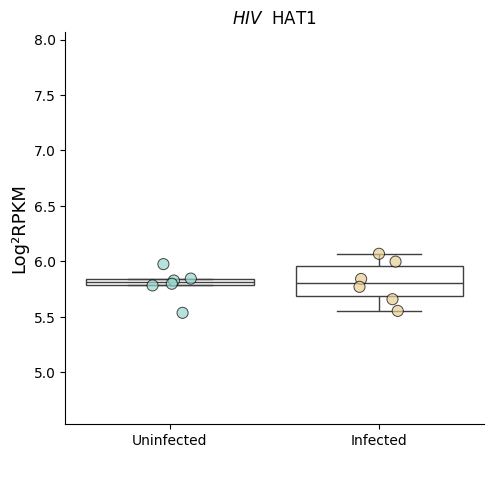

carregando


<Figure size 800x800 with 0 Axes>

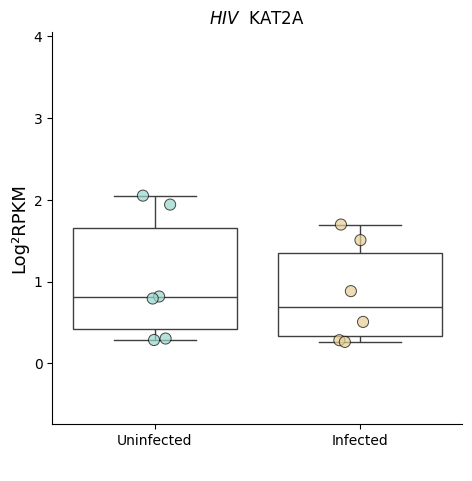

carregando


<Figure size 800x800 with 0 Axes>

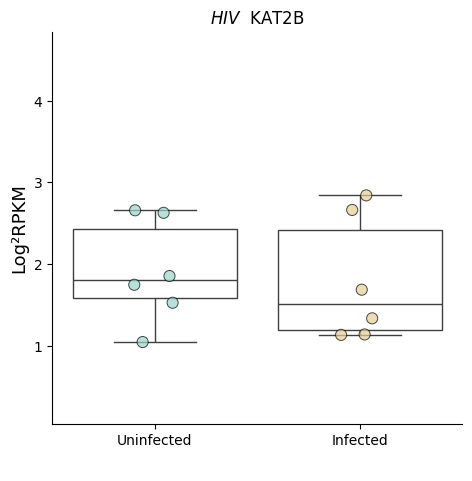

carregando


<Figure size 800x800 with 0 Axes>

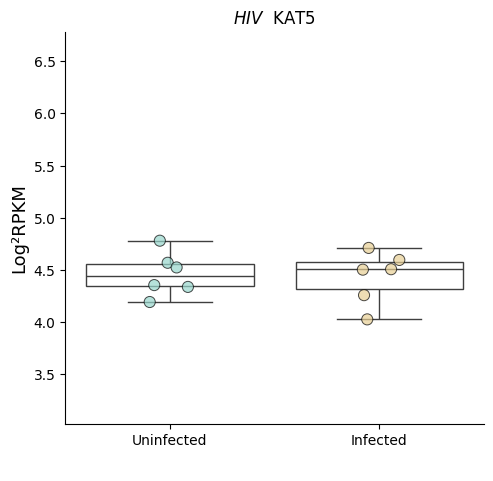

carregando


<Figure size 800x800 with 0 Axes>

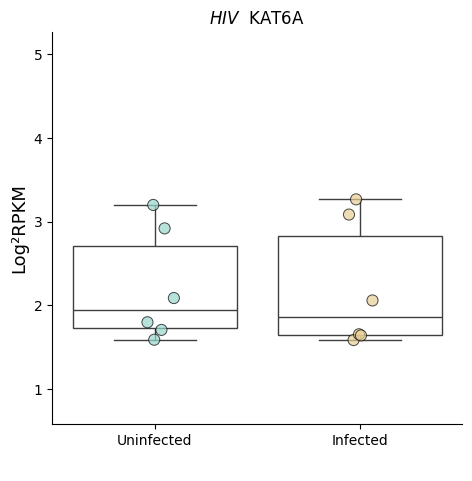

carregando


<Figure size 800x800 with 0 Axes>

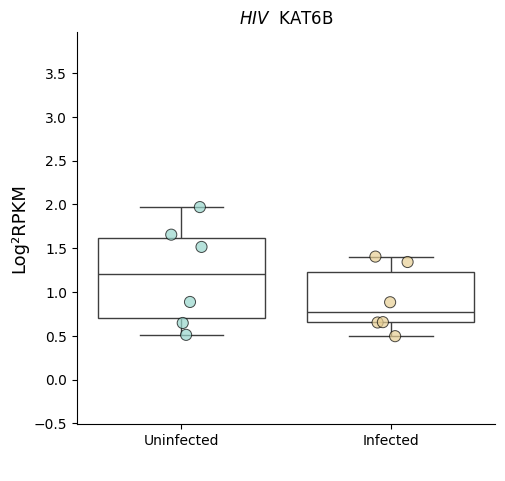

carregando


<Figure size 800x800 with 0 Axes>

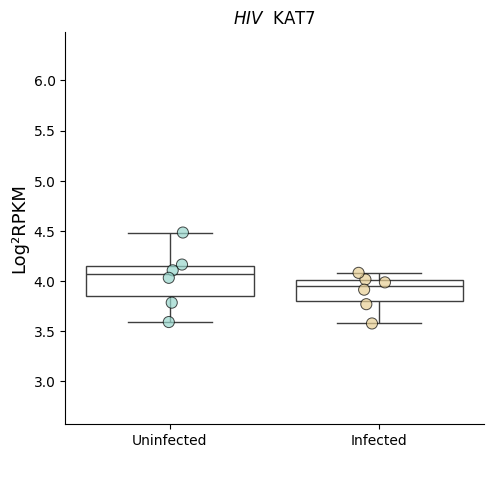

carregando


<Figure size 800x800 with 0 Axes>

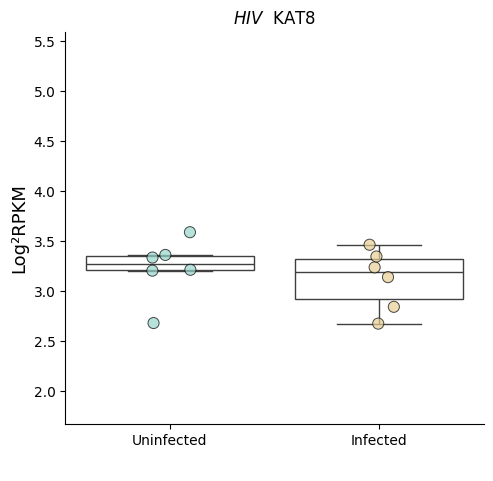

carregando


<Figure size 800x800 with 0 Axes>

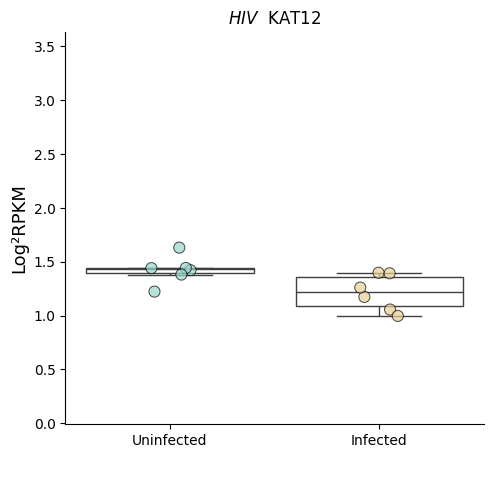

carregando


<Figure size 800x800 with 0 Axes>

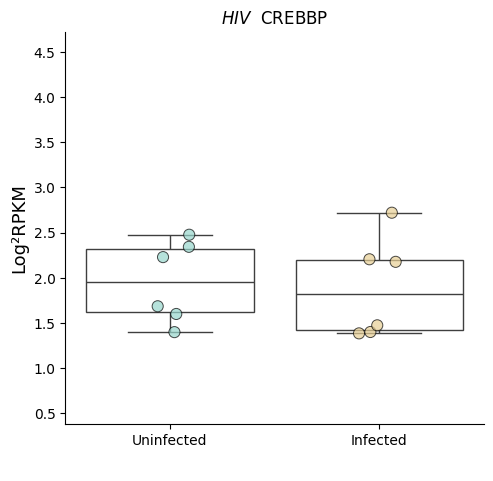

carregando


<Figure size 800x800 with 0 Axes>

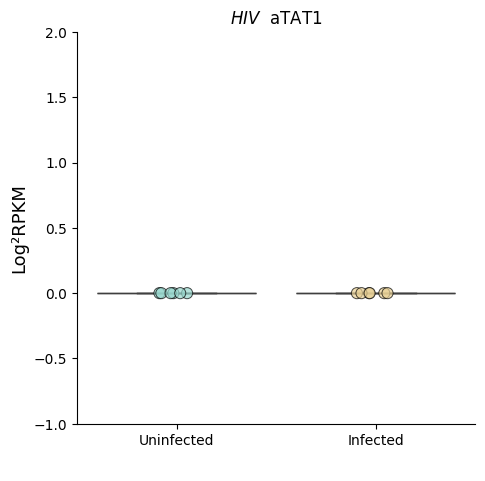

carregando


<Figure size 800x800 with 0 Axes>

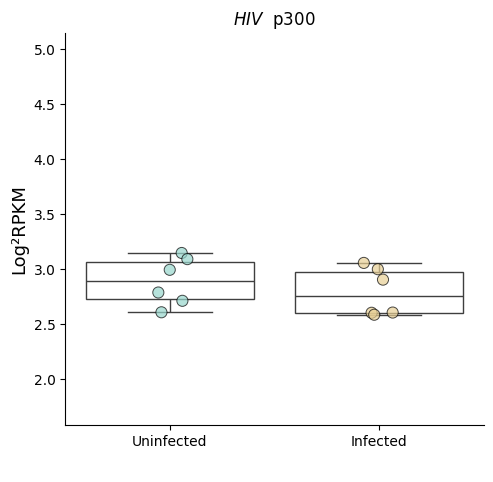

carregando


<Figure size 800x800 with 0 Axes>

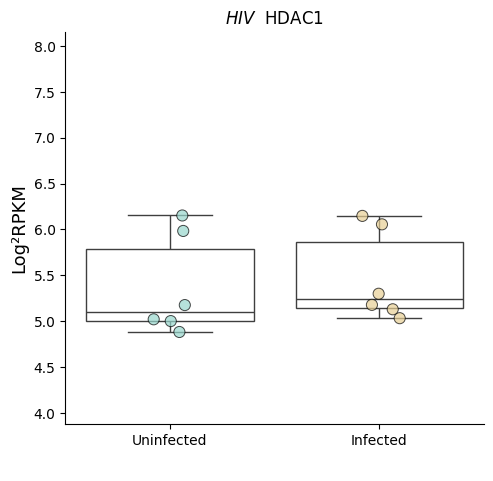

carregando


<Figure size 800x800 with 0 Axes>

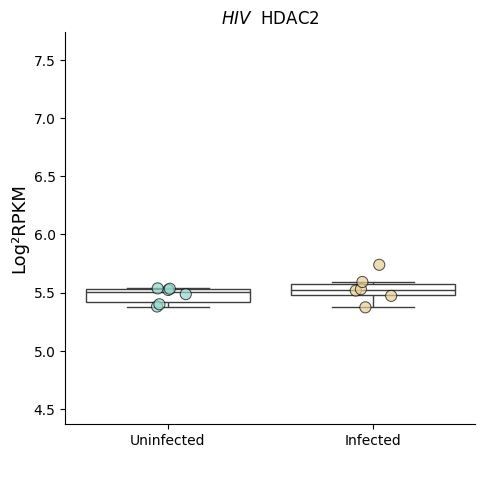

carregando


<Figure size 800x800 with 0 Axes>

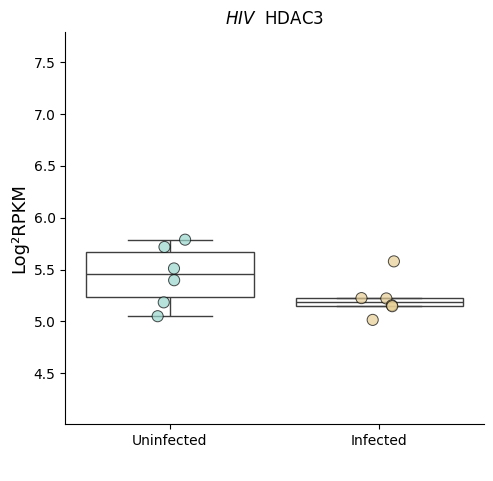

carregando


<Figure size 800x800 with 0 Axes>

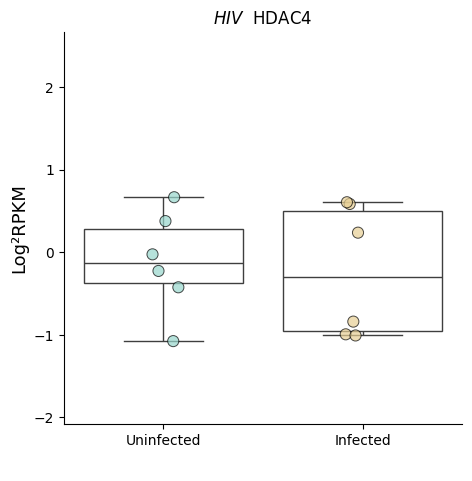

carregando


<Figure size 800x800 with 0 Axes>

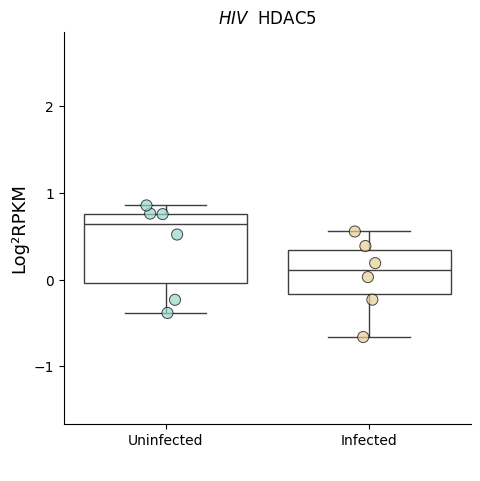

carregando


<Figure size 800x800 with 0 Axes>

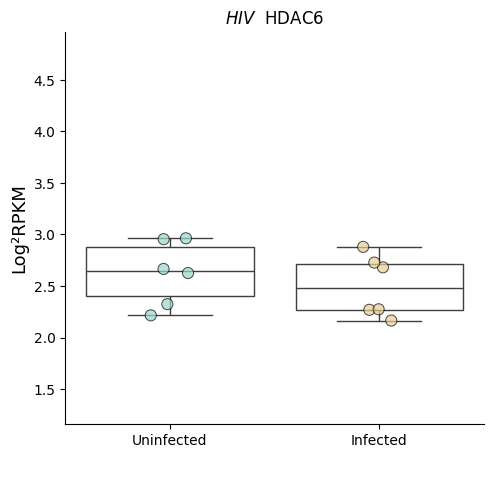

carregando


<Figure size 800x800 with 0 Axes>

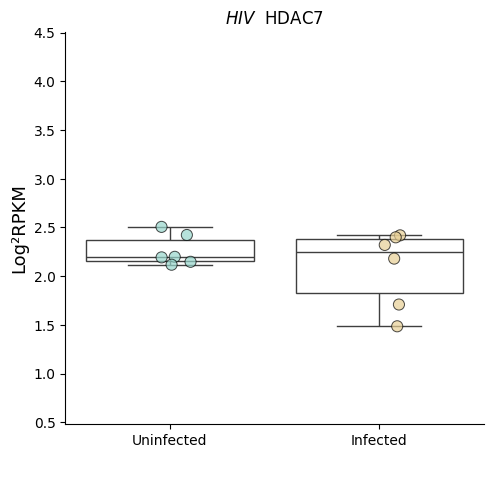

carregando


<Figure size 800x800 with 0 Axes>

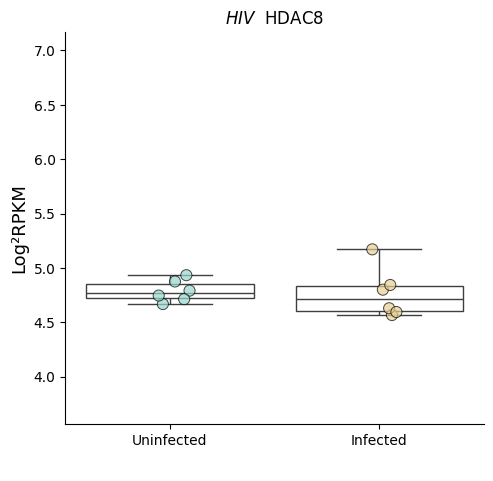

carregando


<Figure size 800x800 with 0 Axes>

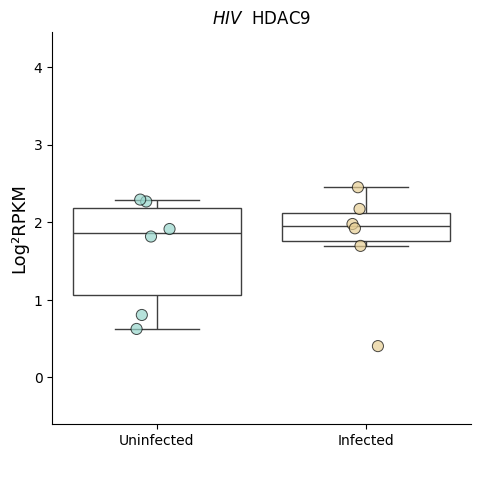

carregando


<Figure size 800x800 with 0 Axes>

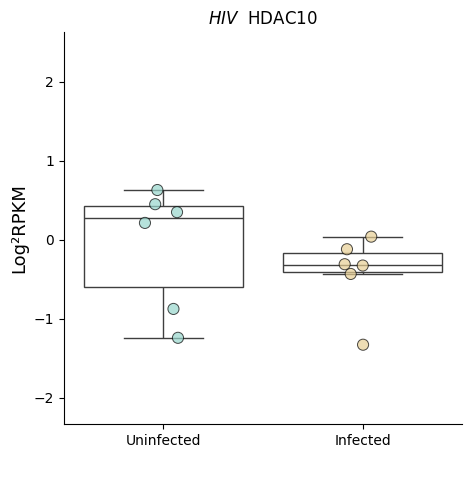

carregando


<Figure size 800x800 with 0 Axes>

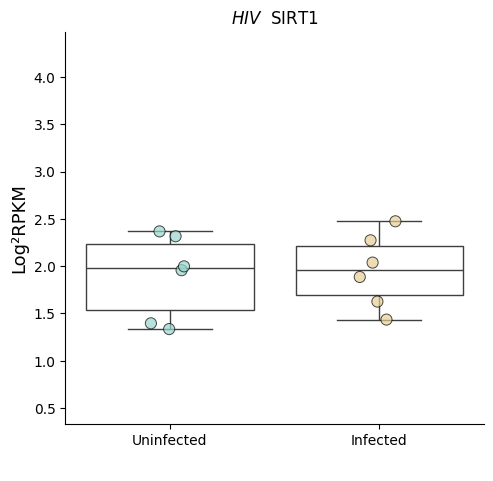

carregando


<Figure size 800x800 with 0 Axes>

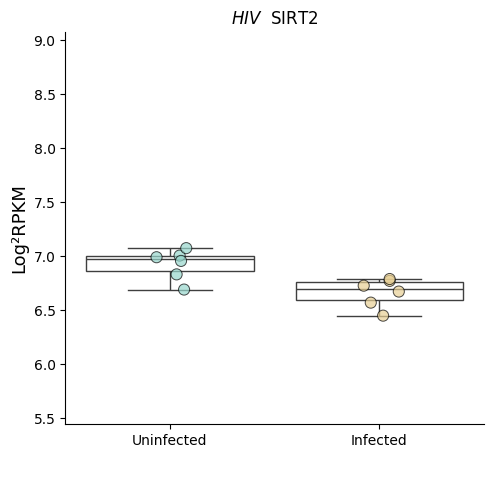

carregando


<Figure size 800x800 with 0 Axes>

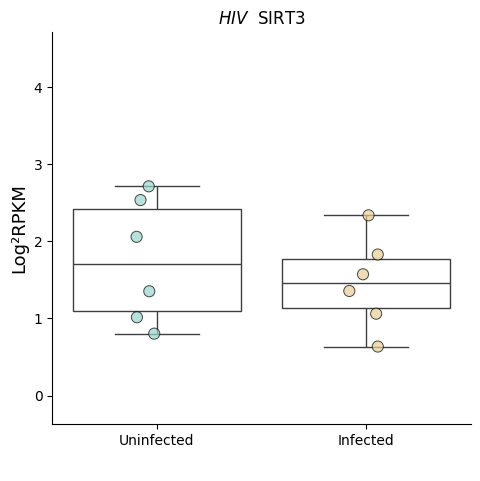

carregando


<Figure size 800x800 with 0 Axes>

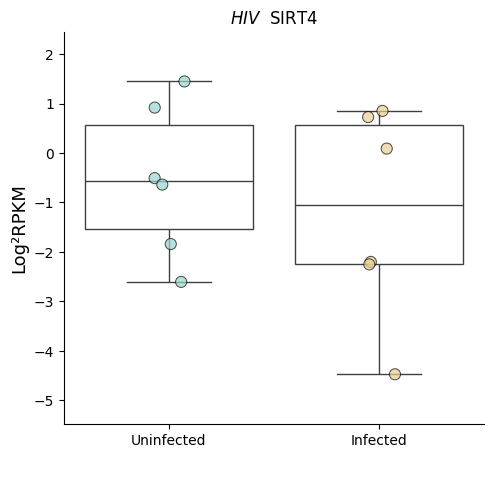

carregando


<Figure size 800x800 with 0 Axes>

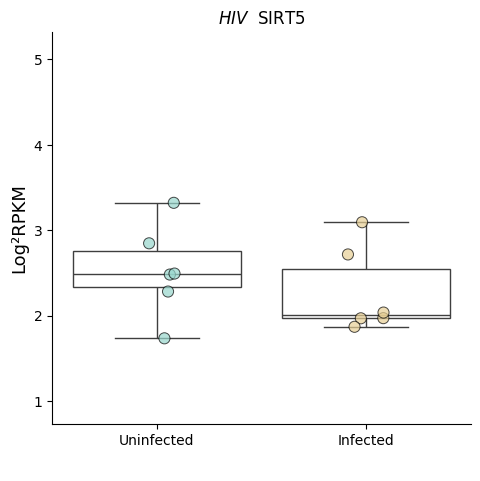

carregando


<Figure size 800x800 with 0 Axes>

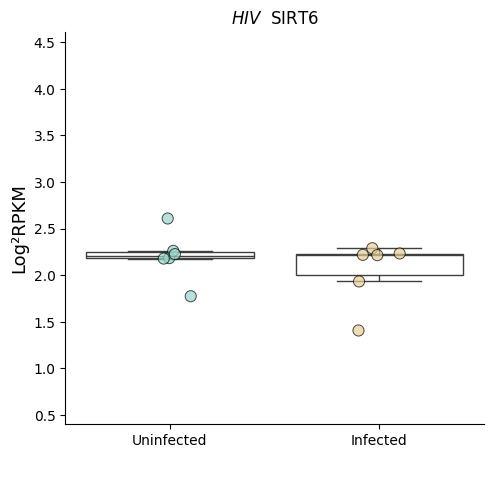

carregando


<Figure size 800x800 with 0 Axes>

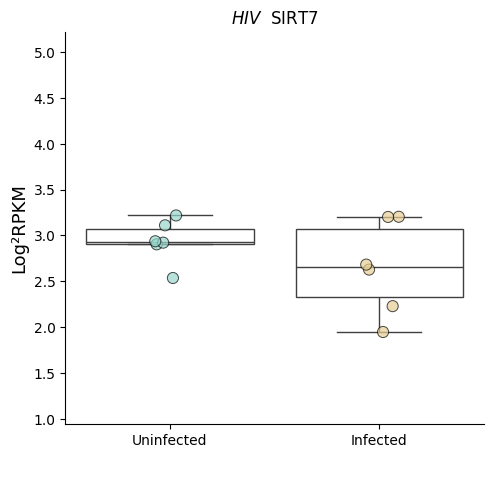

carregando


In [ ]:
graficos_boxplot(df_filtrado, "BrBG", "HIV",['Uninfected', 'Infected'], nome)


##GSE148796 ✅

In [ ]:
id_gene_pasta="GSE148796"
GSE148796_tab = pd.read_excel(GSE148796 )
GSE148796_tab.head()

,Nome,HIV-1_infected_SRR11557449,HIV-1_infected_SRR11557450,HIV-1_infected_SRR11557451,HIV-1_infected_SRR11557452,HIV-1_infected_SRR11557453,HIV-1_infected_SRR11557454,HIV-1_infected_SRR11557455,HIV-1_infected_SRR11557456,HIV-1_infected_SRR11557457,Mock_SRR11557458,Mock_SRR11557459,Mock_SRR11557460,Mock_SRR11557461,Mock_SRR11557462,Mock_SRR11557463,Mock_SRR11557464
0,YTHDF 1,2.108421,2.145282,2.431829,2.004607,2.761693,2.559987,2.459907,2.522696,2.537747,2.864697,2.321323,2.708613,2.944636,3.021112,3.204209,3.075196
1,YTHDF 2,5.664453,5.758737,5.817498,5.591855,5.708524,5.709983,5.692038,5.633534,5.525899,5.475485,5.574759,5.502116,5.649526,5.768652,5.663778,5.772153
2,YTHDF 3,2.613263,2.162270,2.329830,2.666115,2.736296,2.648842,2.631472,2.814157,2.069514,2.413332,2.383229,2.376624,1.791699,1.955638,2.575468,2.009722
3,YTHDC 1,0.000000,0.000000,-2.268610,-3.231885,-1.766566,-2.772721,-2.140997,0.000000,-3.126167,-1.806597,-1.494594,-4.044938,0.000000,0.000000,-3.803659,0.000000
4,FTO,0.910756,0.904548,1.163081,0.292916,1.343197,1.922005,1.046769,1.084023,1.443028,1.888129,1.532708,1.180303,2.381974,2.558192,1.969069,2.154372


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE148796_df_filtrado = GSE148796_tab[GSE148796_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE148796_df_filtrado.index = GSE148796_df_filtrado["Nome"]

GSE148796_df_filtrado = GSE148796_df_filtrado.T
df_filtrado = GSE148796_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
HIV-1_infected_SRR11557449,5.633883,2.315394,1.535532,0.0,0.545852,0.982465,2.395354,3.725999,-2.491438,0.96124,...,3.653436,0.714878,1.505733,0.453771,5.117361,1.871382,2.353534,4.102364,4.955982,5.720777
HIV-1_infected_SRR11557450,5.612408,2.257655,0.877246,0.0,0.890141,0.378355,2.57357,3.974108,-1.912684,1.102589,...,3.910262,0.647269,1.606439,0.099639,5.142014,2.3506,2.588333,4.44549,4.968756,5.434461
HIV-1_infected_SRR11557451,5.744107,2.335733,1.394993,0.0,0.761651,0.921424,2.069259,4.069259,-1.860602,1.050835,...,3.785466,0.760752,1.310599,-0.722748,5.006893,2.402683,2.109901,4.528269,4.818733,5.771635
HIV-1_infected_SRR11557452,5.561664,2.609497,1.431717,-2.819488,0.765954,0.930134,1.542083,3.84295,-0.823877,1.497204,...,3.822191,0.460442,1.472854,-0.10106,5.375938,1.801978,2.436133,4.184963,4.822544,5.645259
HIV-1_infected_SRR11557453,5.530809,2.659779,1.624018,-1.769206,0.941767,0.149293,2.09855,3.706233,-1.94352,1.357155,...,3.686781,0.807116,2.134571,0.779296,5.040789,2.523637,1.348911,4.717845,4.331584,5.383789


In [ ]:
df_filtrado.index.to_list()

['HIV-1_infected_SRR11557449',
 'HIV-1_infected_SRR11557450',
 'HIV-1_infected_SRR11557451',
 'HIV-1_infected_SRR11557452',
 'HIV-1_infected_SRR11557453',
 'HIV-1_infected_SRR11557454',
 'HIV-1_infected_SRR11557455',
 'HIV-1_infected_SRR11557456',
 'HIV-1_infected_SRR11557457',
 'Mock_SRR11557458',
 'Mock_SRR11557459',
 'Mock_SRR11557460',
 'Mock_SRR11557461',
 'Mock_SRR11557462',
 'Mock_SRR11557463',
 'Mock_SRR11557464']

In [ ]:
df_filtrado["Status"] =  ['infected',
 'infected',
 'infected',
 'infected',
 'infected',
 'infected',
 'infected',
 'infected',
 'infected',
 'Mock',
 'Mock',
 'Mock',
 'Mock',
 'Mock',
 'Mock',
 'Mock']

<ipython-input-201-6949e674b62e>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =  ['infected',


In [ ]:
list(set(df_filtrado["Status"]))


['infected', 'Mock']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'infected']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Mock']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.381574,0.320036,0.680364,0.070546,-0.276838,-0.221505,0.130659,-0.171296,-0.322508,-0.123925,...,0.102243,-0.181184,-0.221098,-1.068597,-0.524182,0.102595,0.058137,0.478072,0.150578,-0.089717


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="HIV_GSE148796"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE148796/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,UP,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Down,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,UP,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Down,Normal,Normal,Normal,Normal,Normal,Normal


<Figure size 800x800 with 0 Axes>

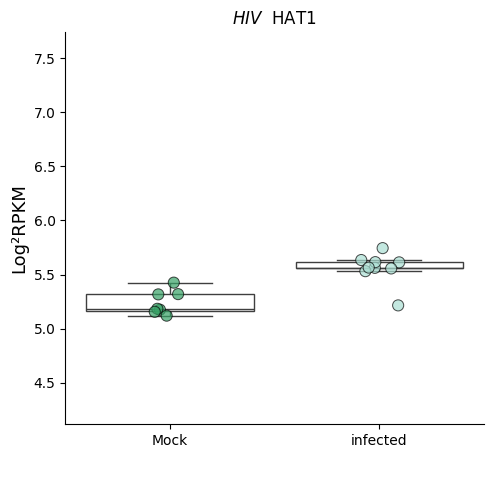

carregando


<Figure size 800x800 with 0 Axes>

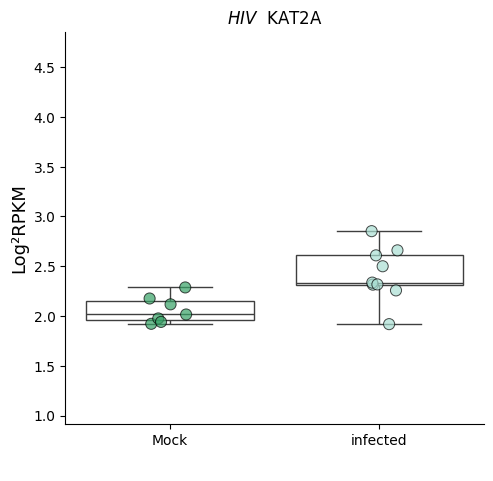

carregando


<Figure size 800x800 with 0 Axes>

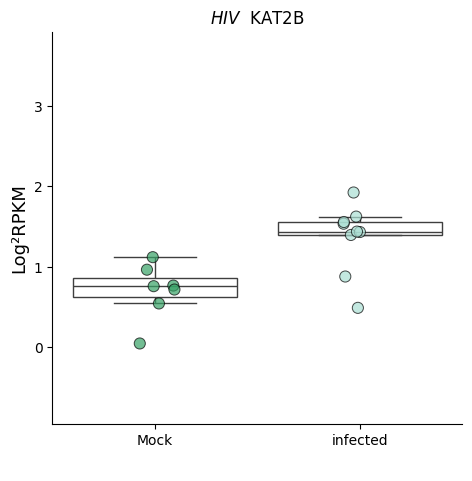

carregando


<Figure size 800x800 with 0 Axes>

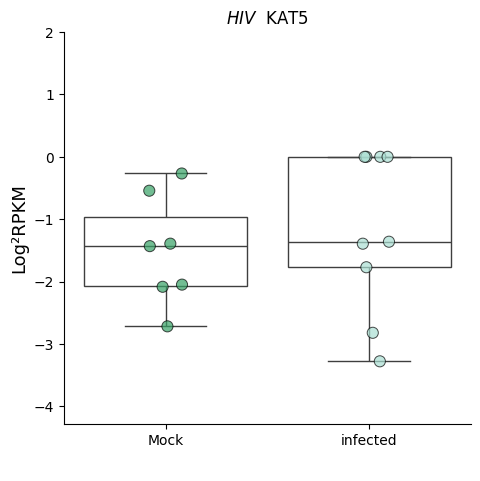

carregando


<Figure size 800x800 with 0 Axes>

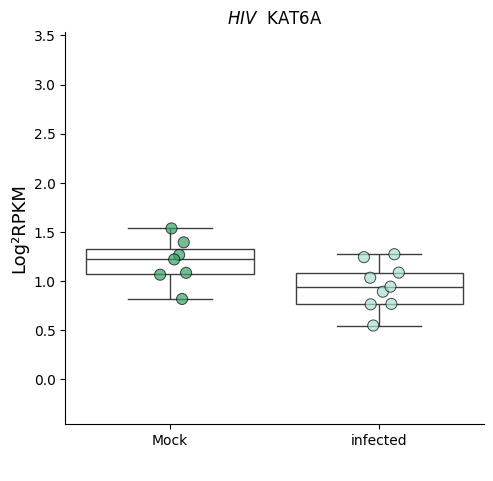

carregando


<Figure size 800x800 with 0 Axes>

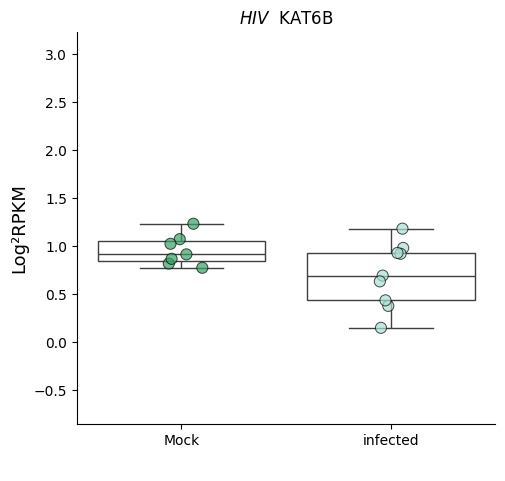

carregando


<Figure size 800x800 with 0 Axes>

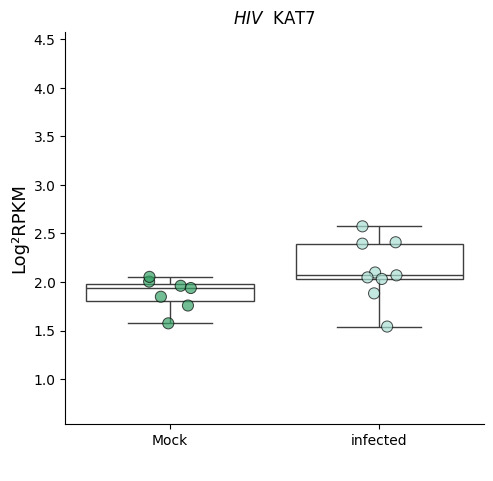

carregando


<Figure size 800x800 with 0 Axes>

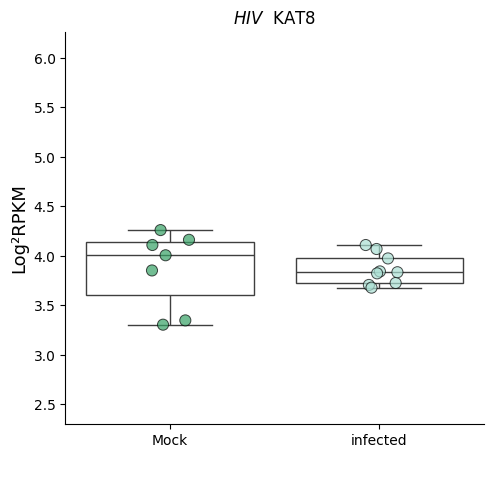

carregando


<Figure size 800x800 with 0 Axes>

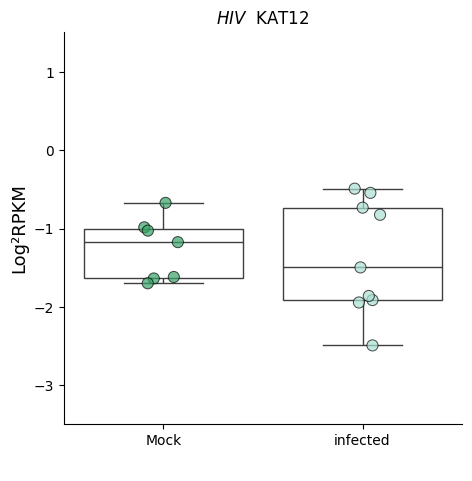

carregando


<Figure size 800x800 with 0 Axes>

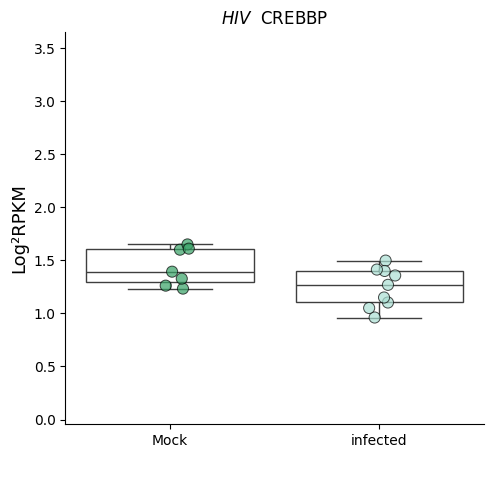

carregando


<Figure size 800x800 with 0 Axes>

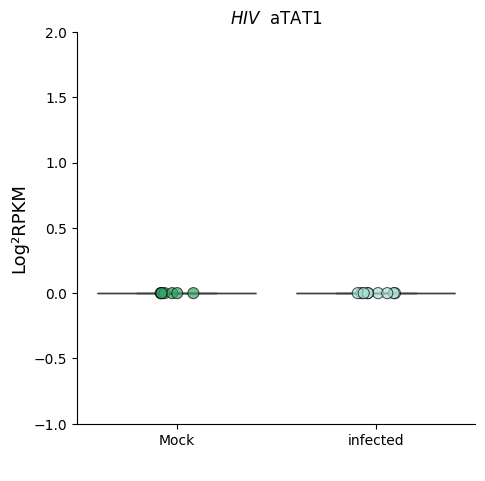

carregando


<Figure size 800x800 with 0 Axes>

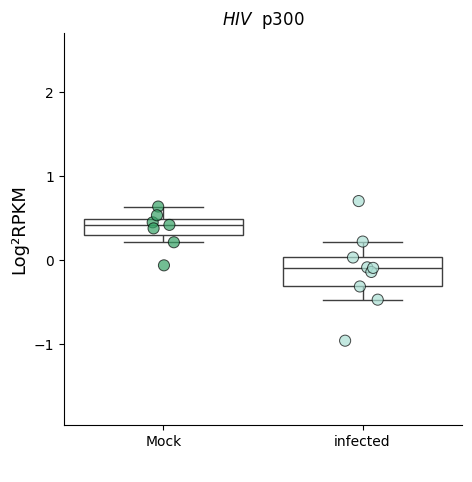

carregando


<Figure size 800x800 with 0 Axes>

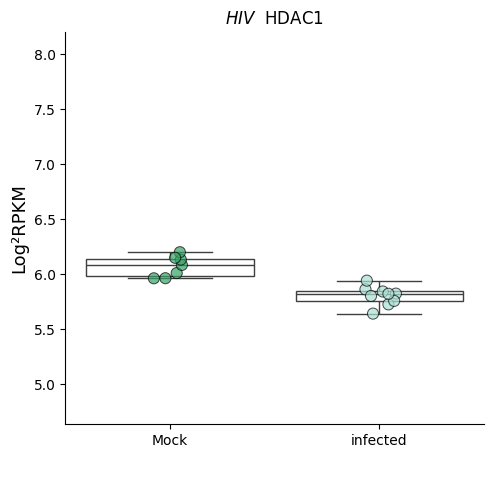

carregando


<Figure size 800x800 with 0 Axes>

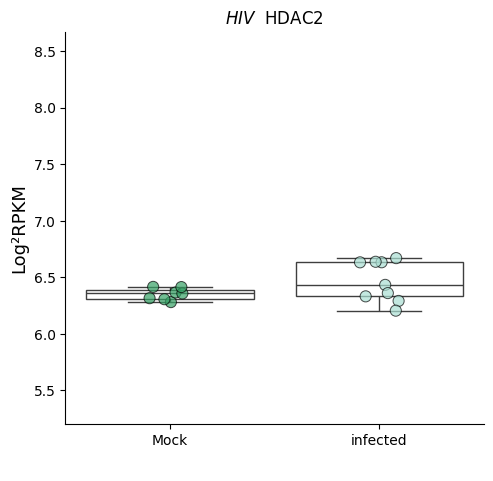

carregando


<Figure size 800x800 with 0 Axes>

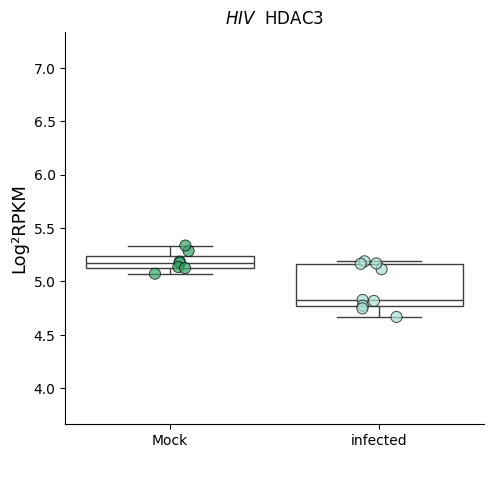

carregando


<Figure size 800x800 with 0 Axes>

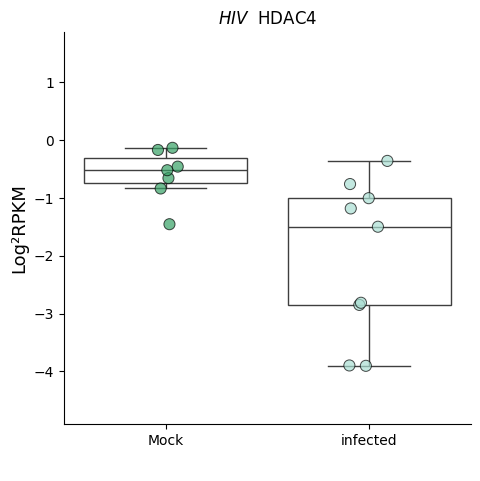

carregando


<Figure size 800x800 with 0 Axes>

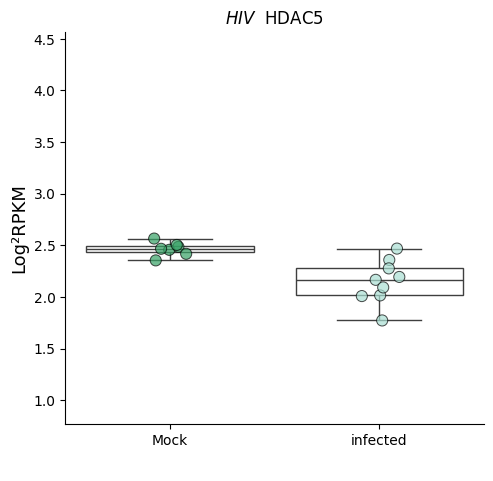

carregando


<Figure size 800x800 with 0 Axes>

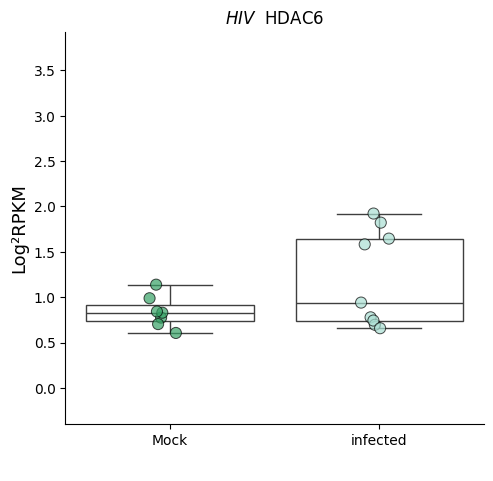

carregando


<Figure size 800x800 with 0 Axes>

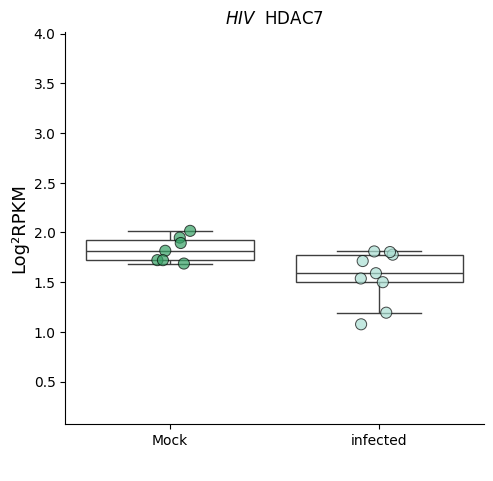

carregando


<Figure size 800x800 with 0 Axes>

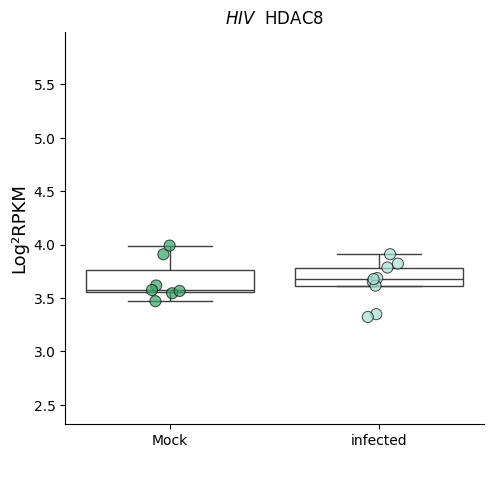

carregando


<Figure size 800x800 with 0 Axes>

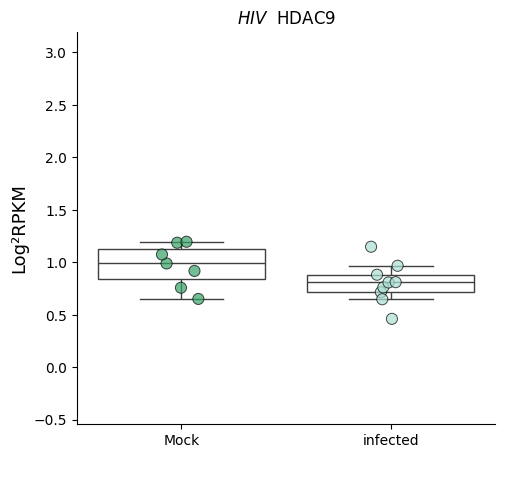

carregando


<Figure size 800x800 with 0 Axes>

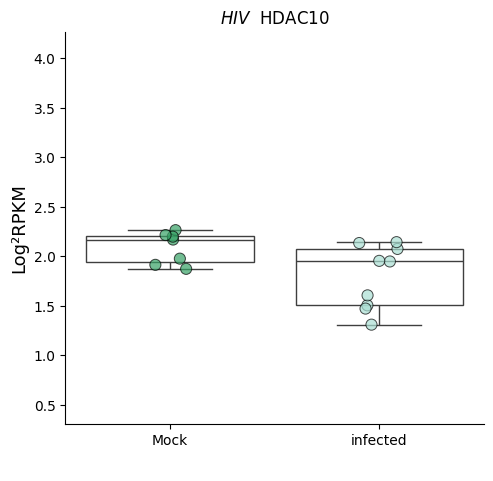

carregando


<Figure size 800x800 with 0 Axes>

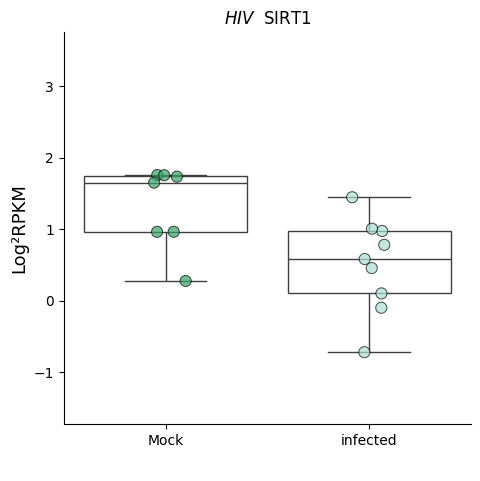

carregando


<Figure size 800x800 with 0 Axes>

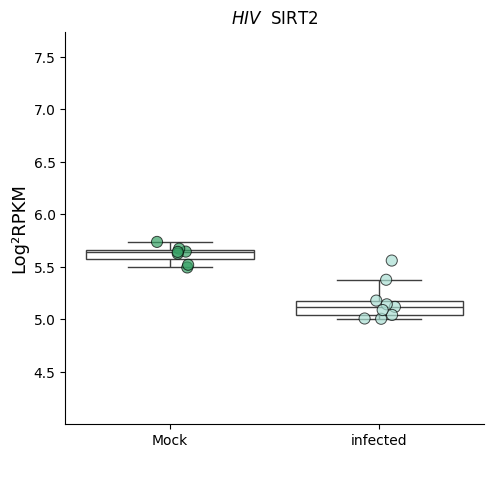

carregando


<Figure size 800x800 with 0 Axes>

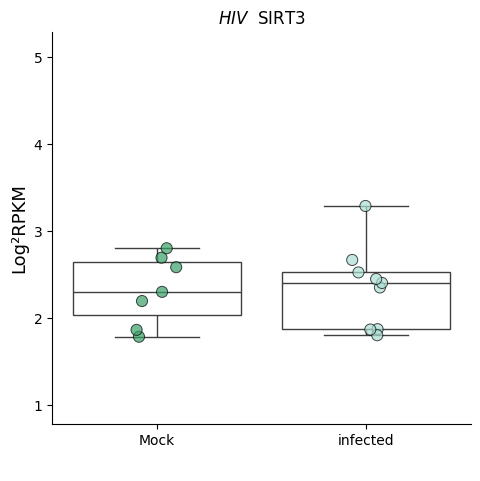

carregando


<Figure size 800x800 with 0 Axes>

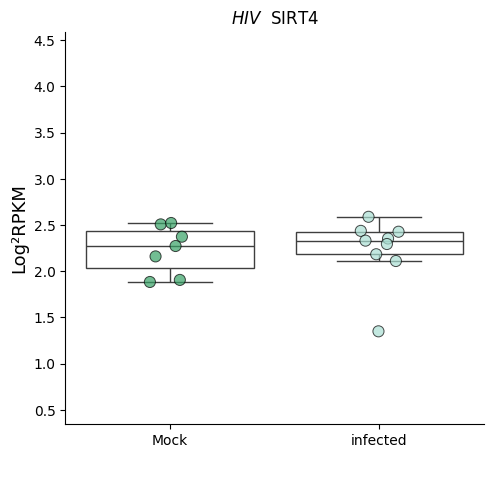

carregando


<Figure size 800x800 with 0 Axes>

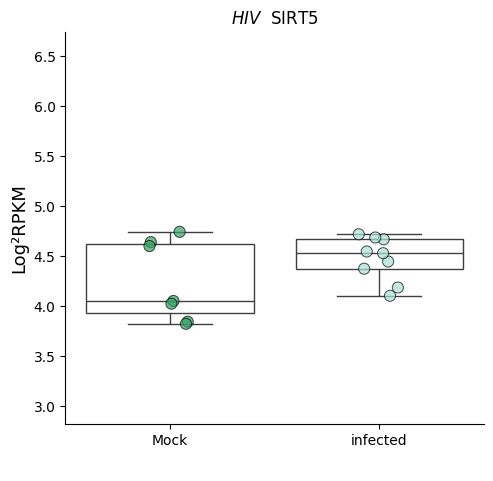

carregando


<Figure size 800x800 with 0 Axes>

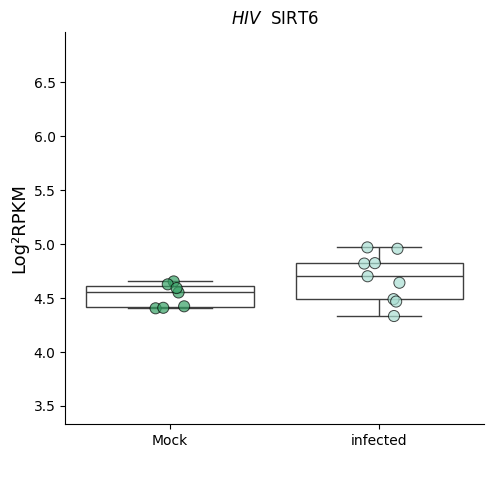

carregando


<Figure size 800x800 with 0 Axes>

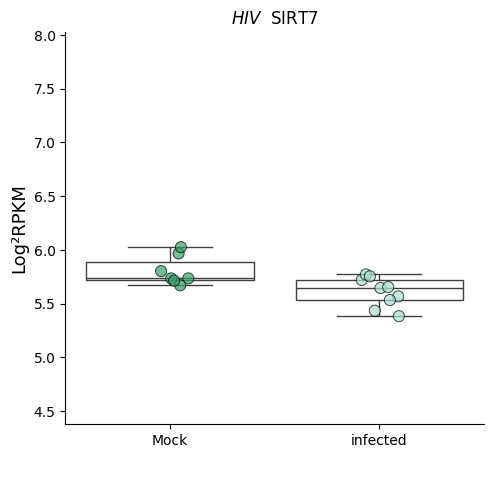

carregando


In [ ]:
graficos_boxplot(df_filtrado, "BuGn", "HIV",[ 'Mock','infected'], nome)


##GSE156072 ✅

In [ ]:
id_gene_pasta="GSE156072"
GSE156072_tab = pd.read_excel(GSE156072 )
GSE156072_tab.head()

,Nome,Uninfected_SRR12432181,Uninfected_SRR12432182,Uninfected_SRR12432183,Uninfected_SRR12432187,Uninfected_SRR12432188,Uninfected_SRR12432189,YU2_HIV_infected_SRR12432184,YU2_HIV_infected_SRR12432185,YU2_HIV_infected_SRR12432186,YU2_HIV_infected_SRR12432190,YU2_HIV_infected_SRR12432191,YU2_HIV_infected_SRR12432192
0,YTHDF 1,4.988901,5.134262,5.124695,4.622411,4.646494,4.048273,5.128298,5.058647,5.232886,4.920189,4.297484,4.444655
1,YTHDF 2,5.540300,5.610773,5.469190,4.997207,4.786839,4.239769,5.382143,5.471046,5.558172,5.076339,4.346765,4.515454
2,YTHDF 3,6.258842,6.031189,6.099478,6.796254,6.765036,6.388026,6.006588,5.982900,6.100085,6.125858,5.861513,6.543767
3,YTHDC 1,-6.030760,-4.721333,-4.996968,-6.392725,-6.732722,0.000000,-4.435089,-6.365624,0.280293,-6.473738,-4.421990,-6.129844
4,FTO,5.621391,5.487632,5.472545,4.931358,4.788552,4.468180,5.476653,5.493450,5.485842,4.810951,4.341216,4.648805


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE156072_df_filtrado = GSE156072_tab[GSE156072_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE156072_df_filtrado.index = GSE156072_df_filtrado["Nome"]

GSE156072_df_filtrado = GSE156072_df_filtrado.T
df_filtrado = GSE156072_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
Uninfected_SRR12432181,4.662146,2.395585,5.780136,3.318276,6.353237,4.775965,6.261991,4.278541,3.709658,6.395727,...,3.17218,2.127885,3.054802,5.190472,5.846985,3.784464,1.535379,4.77558,1.908192,3.890273
Uninfected_SRR12432182,5.683241,2.939841,5.785018,3.445952,6.140036,4.350717,6.189961,4.166504,4.099833,6.109216,...,2.778808,0.78196,2.940186,5.013256,5.753409,3.271888,1.311682,4.430503,2.620583,3.205092
Uninfected_SRR12432183,4.739096,2.411045,5.108435,3.435021,6.326995,4.64015,6.227136,4.363705,3.956649,6.390655,...,3.030734,2.009674,3.412828,5.056029,5.411291,3.821167,1.603936,4.733882,2.435973,3.448331
Uninfected_SRR12432187,4.204955,1.623432,3.473593,2.962187,4.453169,2.803366,5.170565,3.494307,3.200159,5.07252,...,3.218163,2.290079,3.147013,4.246775,5.753886,2.521062,-1.599176,3.39272,1.605121,2.495517
Uninfected_SRR12432188,4.540607,3.00678,3.704986,2.948802,4.426593,2.841016,5.157929,4.097629,3.035768,4.973905,...,2.786477,2.788493,3.036311,4.340617,5.943764,3.010799,-1.064704,4.150726,1.943195,2.727527


In [ ]:
df_filtrado.index.to_list()

['Uninfected_SRR12432181',
 'Uninfected_SRR12432182',
 'Uninfected_SRR12432183',
 'Uninfected_SRR12432187',
 'Uninfected_SRR12432188',
 'Uninfected_SRR12432189',
 'YU2_HIV_infected_SRR12432184',
 'YU2_HIV_infected_SRR12432185',
 'YU2_HIV_infected_SRR12432186',
 'YU2_HIV_infected_SRR12432190',
 'YU2_HIV_infected_SRR12432191',
 'YU2_HIV_infected_SRR12432192']

In [ ]:
df_filtrado["Status"] = ['Uninfected',
 'Uninfected',
 'Uninfected',
 'Uninfected',
 'Uninfected',
 'Uninfected',
 'YU2_infected',
 'YU2_infected',
 'YU2_infected',
 'YU2_infected',
 'YU2_infected',
 'YU2_infected']

<ipython-input-222-b64947574d66>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] = ['Uninfected',


In [ ]:
list(set(df_filtrado["Status"]))


['Uninfected', 'YU2_infected']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'YU2_infected']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Uninfected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.127141,0.261173,-0.18149,0.203392,-0.03107,-0.091001,-0.064882,-0.371746,-0.017164,0.231895,...,-0.151058,-0.367175,0.019078,-0.441052,-0.270162,-0.057753,0.434732,0.034141,0.41606,-0.034047


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="HIV_GSE156072"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE156072/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


<Figure size 800x800 with 0 Axes>

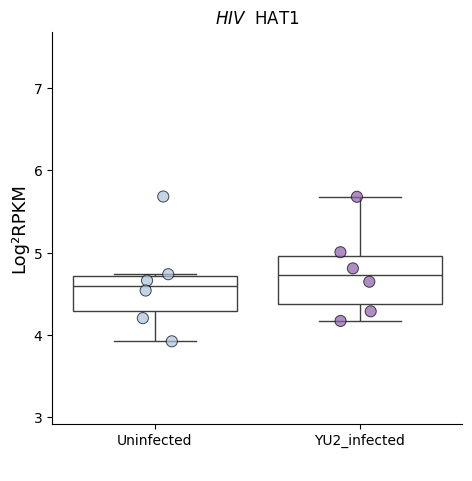

carregando


<Figure size 800x800 with 0 Axes>

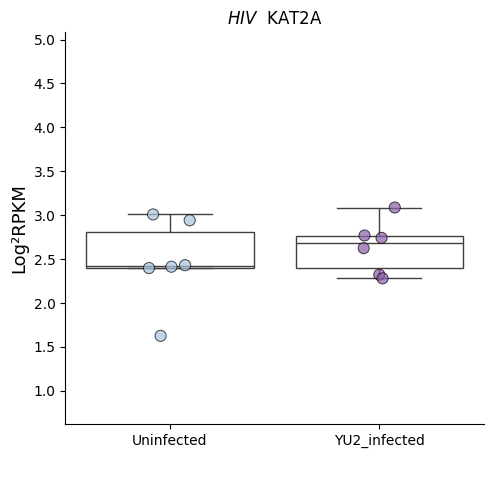

carregando


<Figure size 800x800 with 0 Axes>

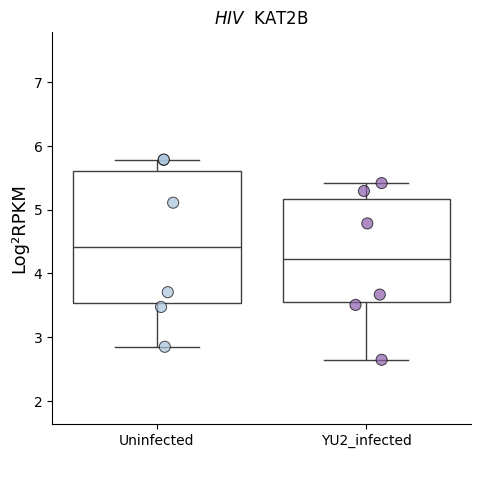

carregando


<Figure size 800x800 with 0 Axes>

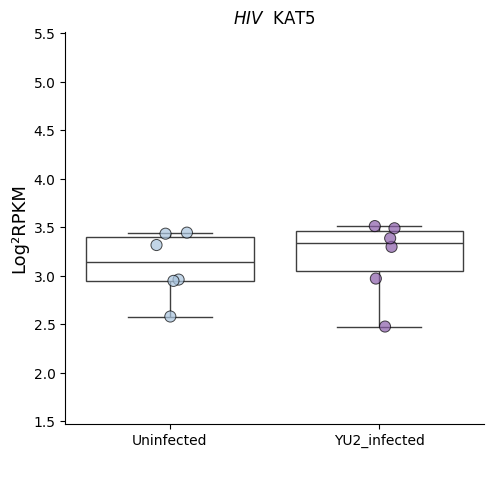

carregando


<Figure size 800x800 with 0 Axes>

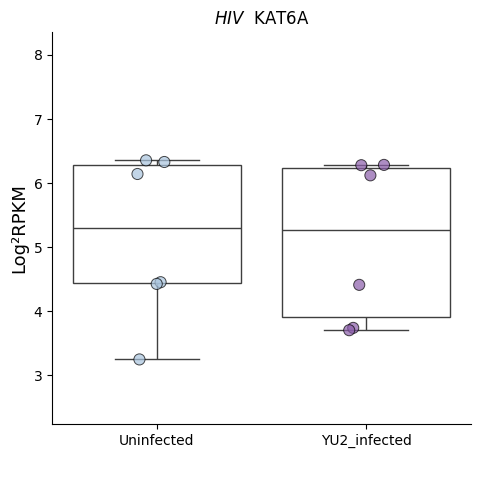

carregando


<Figure size 800x800 with 0 Axes>

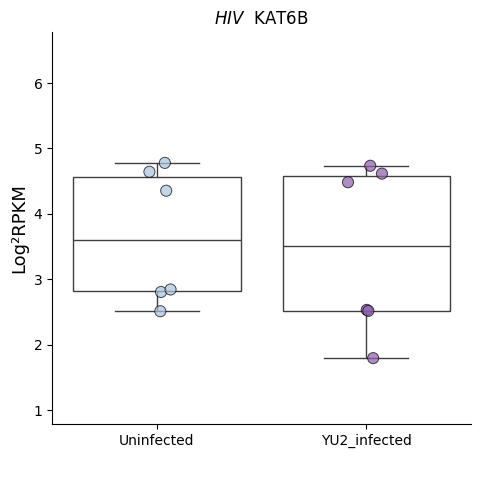

carregando


<Figure size 800x800 with 0 Axes>

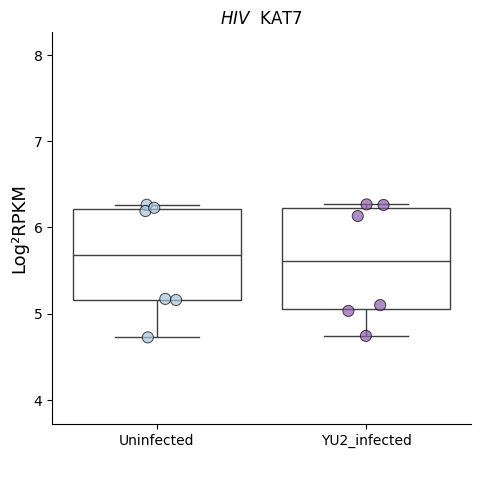

carregando


<Figure size 800x800 with 0 Axes>

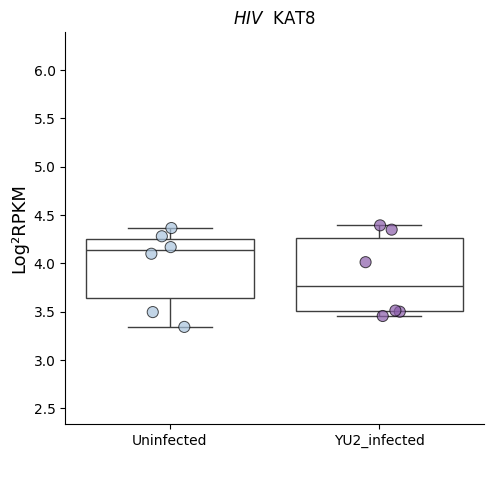

carregando


<Figure size 800x800 with 0 Axes>

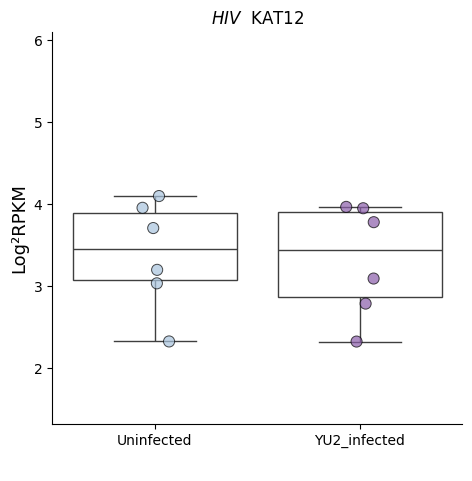

carregando


<Figure size 800x800 with 0 Axes>

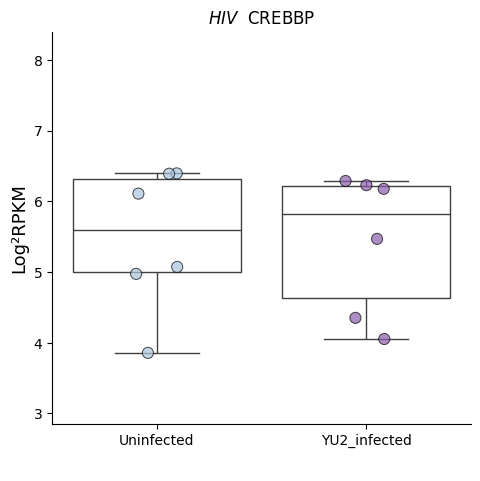

carregando


<Figure size 800x800 with 0 Axes>

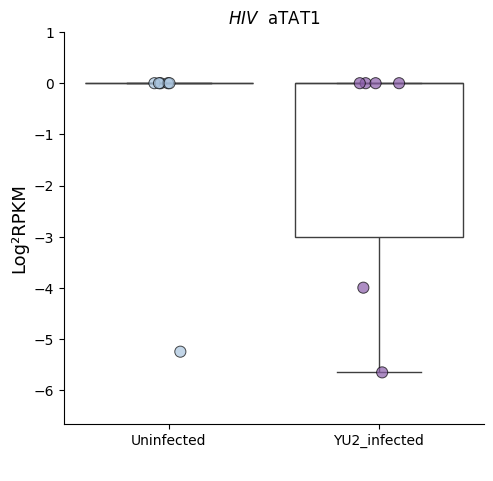

carregando


<Figure size 800x800 with 0 Axes>

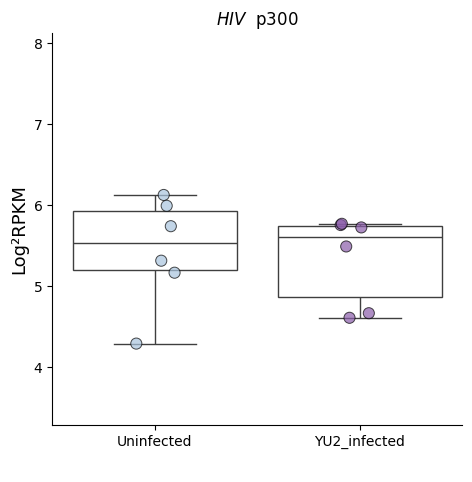

carregando


<Figure size 800x800 with 0 Axes>

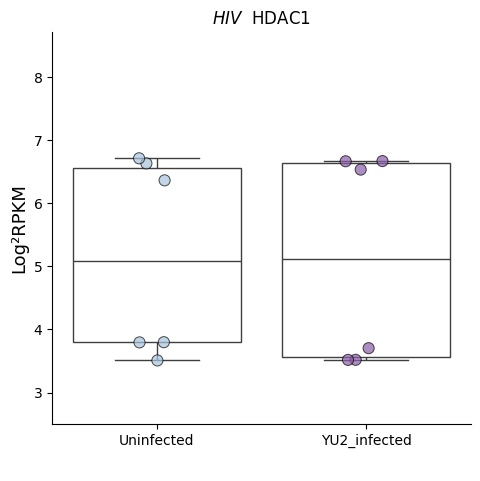

carregando


<Figure size 800x800 with 0 Axes>

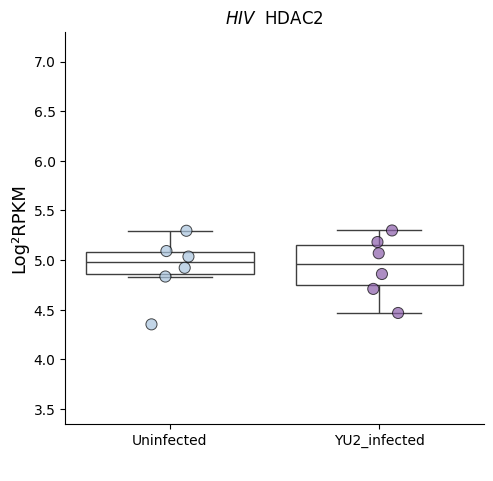

carregando


<Figure size 800x800 with 0 Axes>

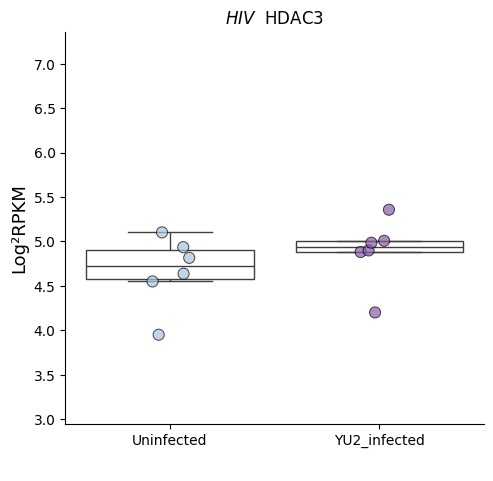

carregando


<Figure size 800x800 with 0 Axes>

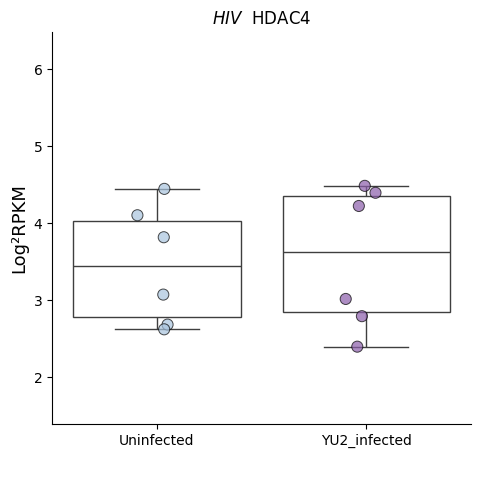

carregando


<Figure size 800x800 with 0 Axes>

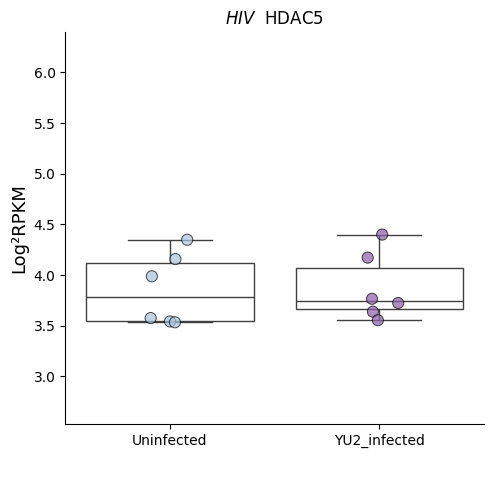

carregando


<Figure size 800x800 with 0 Axes>

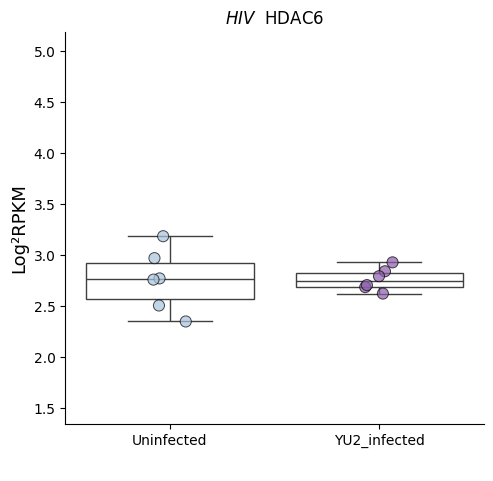

carregando


<Figure size 800x800 with 0 Axes>

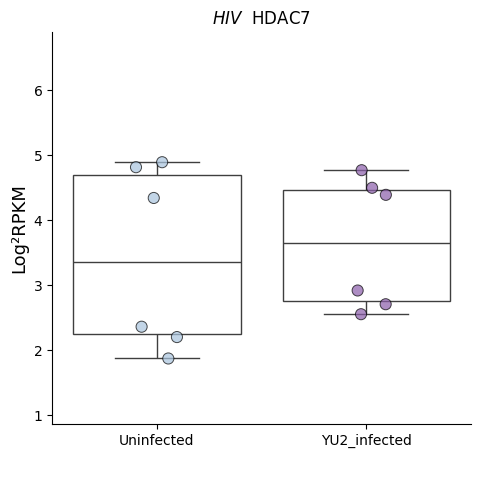

carregando


<Figure size 800x800 with 0 Axes>

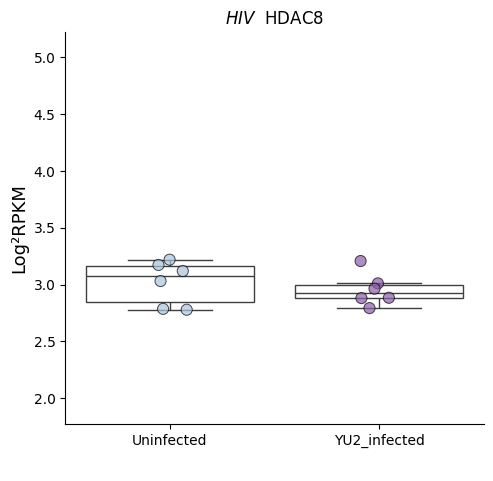

carregando


<Figure size 800x800 with 0 Axes>

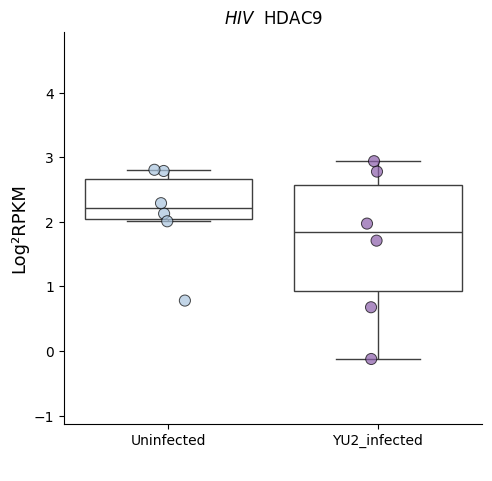

carregando


<Figure size 800x800 with 0 Axes>

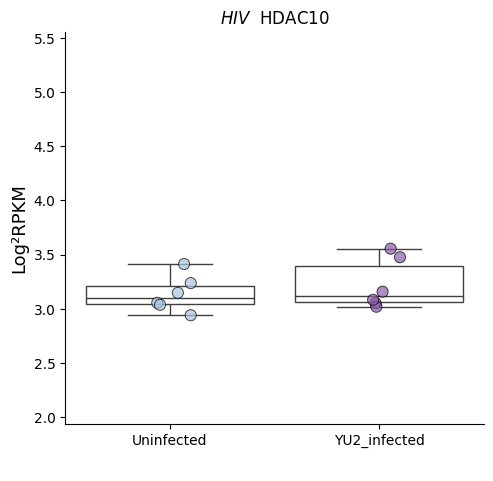

carregando


<Figure size 800x800 with 0 Axes>

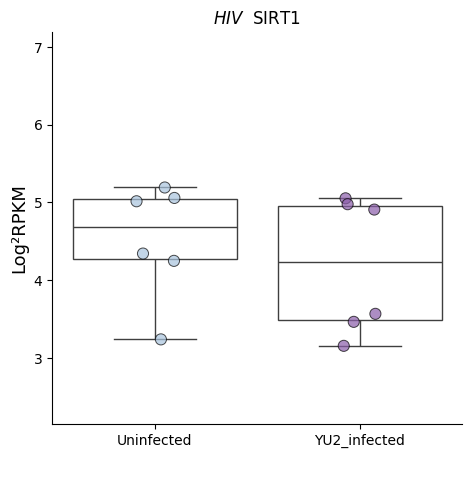

carregando


<Figure size 800x800 with 0 Axes>

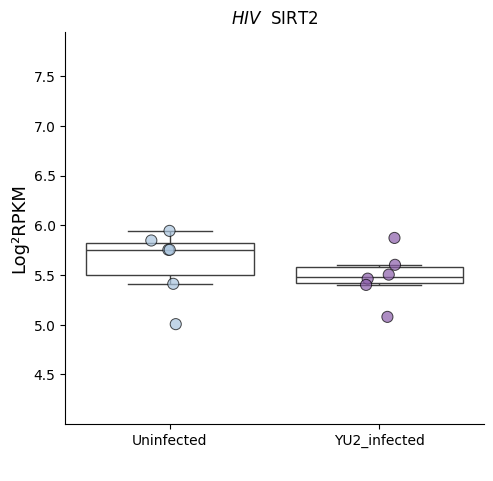

carregando


<Figure size 800x800 with 0 Axes>

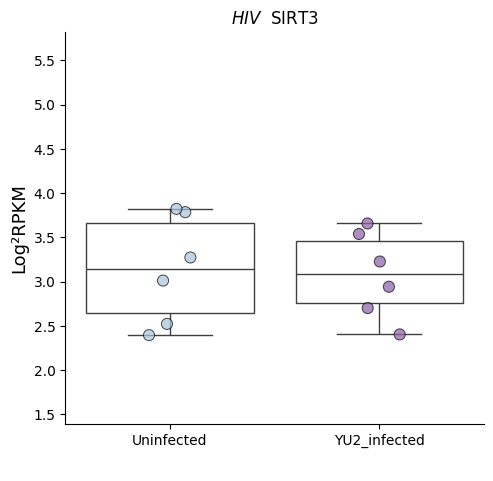

carregando


<Figure size 800x800 with 0 Axes>

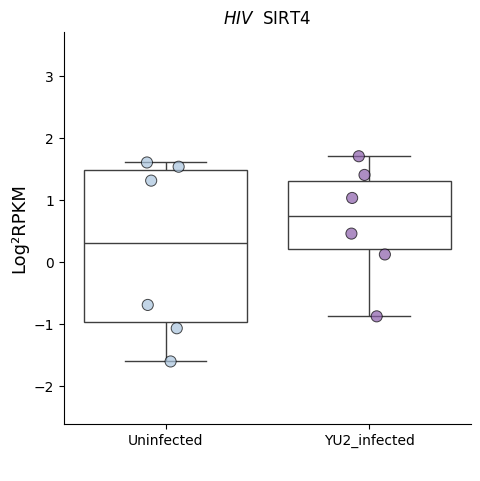

carregando


<Figure size 800x800 with 0 Axes>

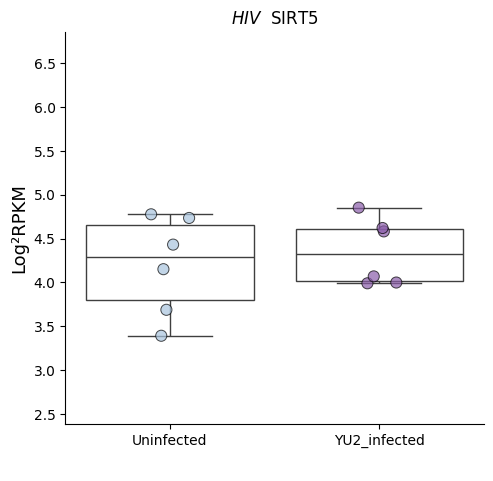

carregando


<Figure size 800x800 with 0 Axes>

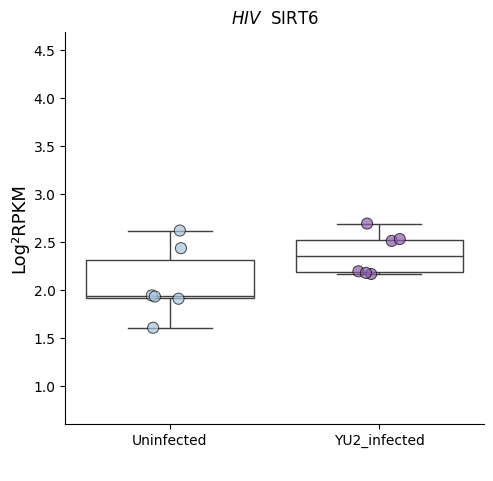

carregando


<Figure size 800x800 with 0 Axes>

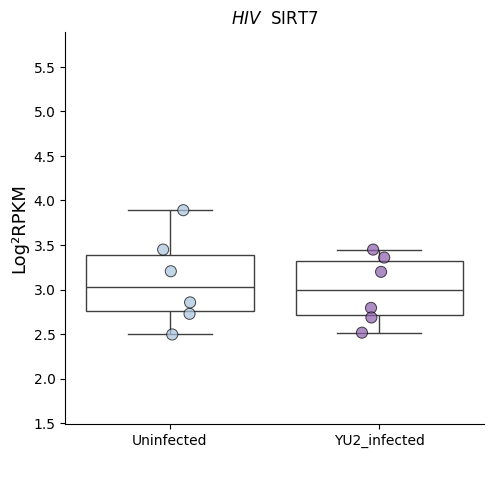

carregando


In [ ]:
graficos_boxplot(df_filtrado, "BuPu", "HIV",       ['Uninfected', 'YU2_infected']       , nome)


#Leishmania

##GSE185253  ✅

In [ ]:
id_gene_pasta="GSE185253"
GSE185253_tab = pd.read_excel(GSE185253 )
GSE185253_tab.head()

,Nome,Mouse_Infected_1_SRR16192400,Mouse_Infected_2_SRR16192401,Mouse_Infected_3_SRR16192402,Mouse_Infected_4_SRR16192403,Mouse_Infected_5_SRR16192404,Mouse_Infected_6_SRR16192405,Mouse_Non_infected_1_SRR16192406,Mouse_Non_infected_2_SRR16192407,Mouse_Non_infected_3_SRR16192408,Mouse_Non_infected_4_SRR16192409
0,YTHDF1,4.888423,3.739309,4.261387,-0.784727,-4.395135,-4.395135,-2.766794,4.805743,-1.475499,2.805365
1,YTHDF2,3.373918,5.928262,4.920591,7.485071,-1.358298,-1.358298,-3.817420,-0.654274,5.721802,5.636634
2,YTHDF3,4.286777,5.016620,4.580076,0.850300,0.000000,0.000000,6.344372,6.248610,0.000000,4.766598
3,YTHDC1,6.111661,6.420754,5.590268,6.641424,5.704705,5.704705,-2.074222,6.536006,6.495522,6.655559
4,FTO,4.972507,4.573447,5.327719,1.739375,0.000000,0.000000,2.537822,6.094252,5.696177,5.319475


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE185253_df_filtrado = GSE185253_tab[GSE185253_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE185253_df_filtrado.index = GSE185253_df_filtrado["Nome"]

GSE185253_df_filtrado = GSE185253_df_filtrado.T
df_filtrado = GSE185253_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
Mouse_Infected_1_SRR16192400,-2.199925,4.272577,-0.521051,-0.888339,2.881825,-5.280657,1.651979,-3.338372,3.300638,4.698763,...,0.0,0.0,0.0,3.136979,5.260783,0.0,0.0,0.0,-1.884039,3.731985
Mouse_Infected_2_SRR16192401,0.0,3.36427,2.811577,2.783223,3.997223,2.032732,6.244371,3.059409,1.739755,4.593317,...,0.0,0.0,1.342886,3.235672,5.97089,3.437526,0.0,0.0,1.604507,5.058487
Mouse_Infected_3_SRR16192402,2.074668,2.077031,0.935189,4.098775,4.027234,2.927366,4.57326,-3.36756,4.463022,4.055809,...,-2.765524,0.925161,-5.80598,4.242388,6.456643,0.0,0.0,0.0,2.906952,5.377618
Mouse_Infected_4_SRR16192403,0.0,0.0,2.885124,0.0,-2.401719,3.699472,1.433663,1.16517,0.0,3.882956,...,0.0,0.0,0.0,-3.689555,6.498777,0.0,0.0,0.0,0.0,5.937847
Mouse_Infected_5_SRR16192404,0.0,4.015891,4.405113,0.0,5.116697,3.630752,0.282687,0.0,5.153707,4.047782,...,-3.828094,0.0,0.0,4.680534,5.698571,0.0,0.0,0.0,0.0,3.484654


In [ ]:
df_filtrado.index.to_list()

['Mouse_Infected_1_SRR16192400',
 'Mouse_Infected_2_SRR16192401',
 'Mouse_Infected_3_SRR16192402',
 'Mouse_Infected_4_SRR16192403',
 'Mouse_Infected_5_SRR16192404',
 'Mouse_Infected_6_SRR16192405',
 'Mouse_Non_infected_1_SRR16192406',
 'Mouse_Non_infected_2_SRR16192407',
 'Mouse_Non_infected_3_SRR16192408',
 'Mouse_Non_infected_4_SRR16192409']

In [ ]:
df_filtrado["Status"] =   ['Mouse_Infected',
 'Mouse_Infected',
 'Mouse_Infected',
 'Mouse_Infected',
 'Mouse_Infected',
 'Mouse_Infected',
 'Mouse_Non_infected',
 'Mouse_Non_infected',
 'Mouse_Non_infected',
 'Mouse_Non_infected']

<ipython-input-41-3f7a5b942ebb>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =   ['Mouse_Infected',


In [ ]:
list(set(df_filtrado["Status"]))


['Mouse_Non_infected', 'Mouse_Infected']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'Mouse_Infected']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Mouse_Non_infected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.0,3.69008,0.993527,-1.506868,0.397995,-0.083908,-3.942941,-0.976767,5.902092,-0.726774,...,-1.382762,0.0,0.0,0.217398,0.565616,0.0,0.0,0.0,0.0,-1.077442


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania_GSE185253"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE185253/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,UP,UP,Down,Normal,Normal,Down,Down,UP,Down,...,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Down


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,UP,UP,Down,Normal,Normal,Down,Down,UP,Down,...,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Down


<Figure size 800x800 with 0 Axes>

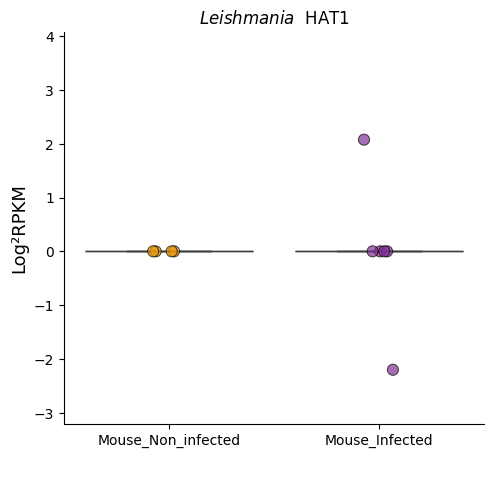

carregando


<Figure size 800x800 with 0 Axes>

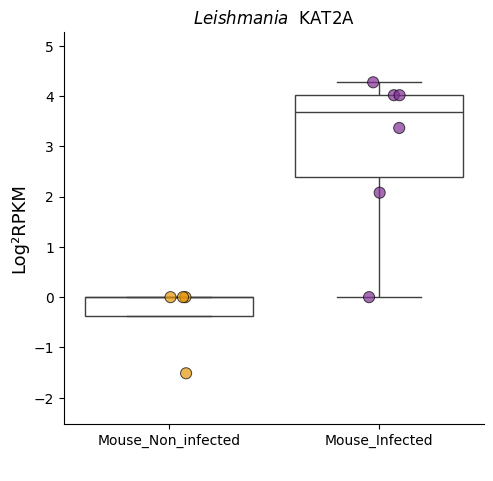

carregando


<Figure size 800x800 with 0 Axes>

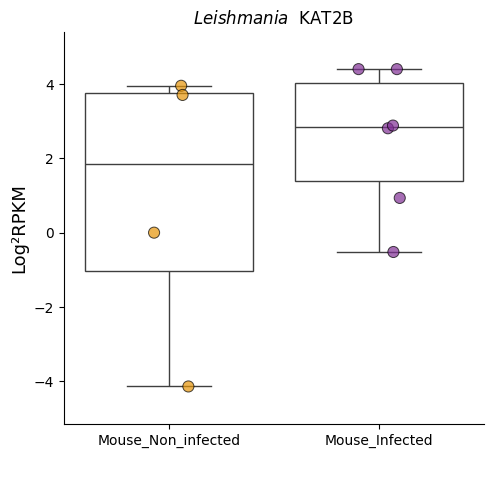

carregando


<Figure size 800x800 with 0 Axes>

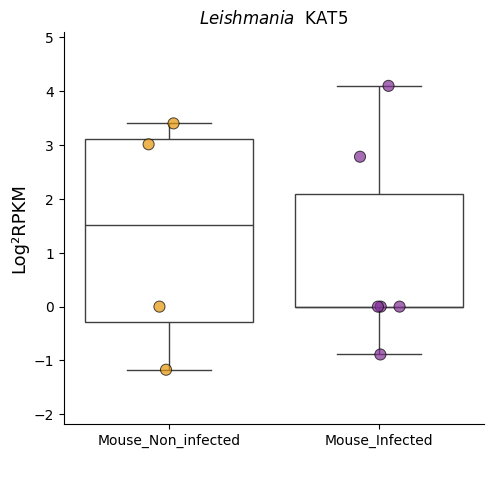

carregando


<Figure size 800x800 with 0 Axes>

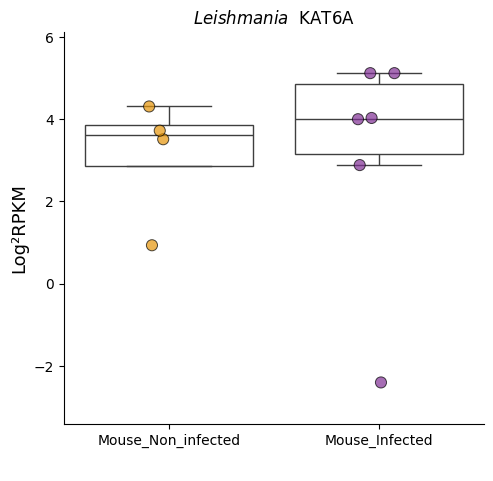

carregando


<Figure size 800x800 with 0 Axes>

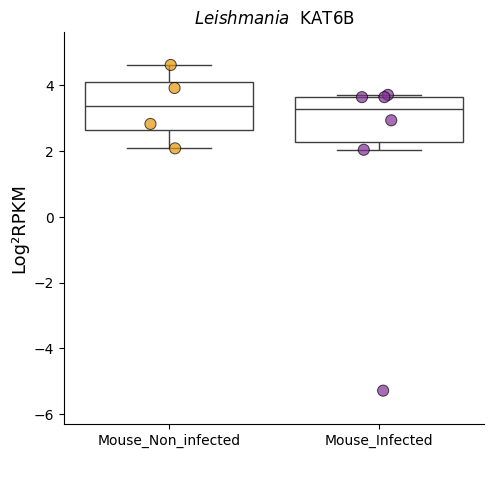

carregando


<Figure size 800x800 with 0 Axes>

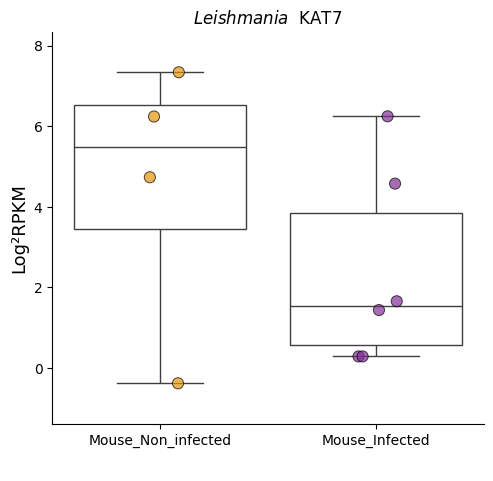

carregando


<Figure size 800x800 with 0 Axes>

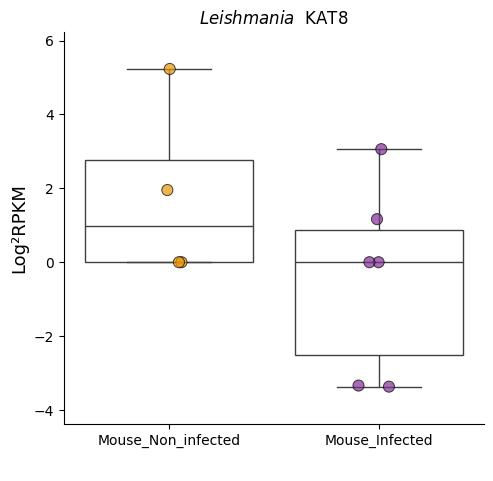

carregando


<Figure size 800x800 with 0 Axes>

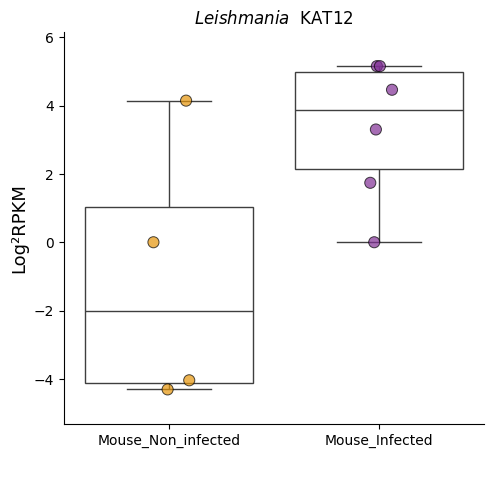

carregando


<Figure size 800x800 with 0 Axes>

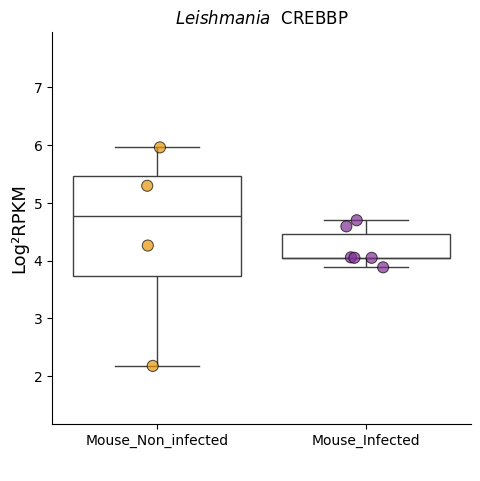

carregando


<Figure size 800x800 with 0 Axes>

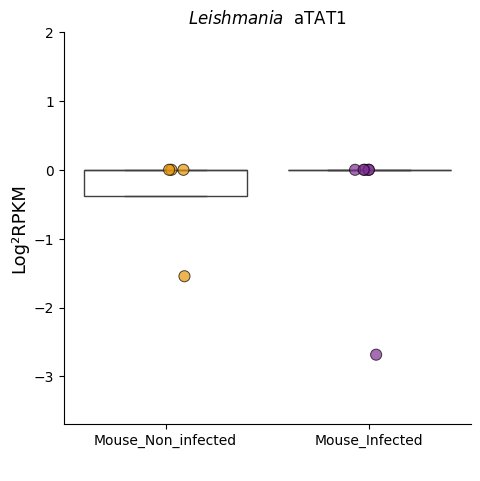

carregando


<Figure size 800x800 with 0 Axes>

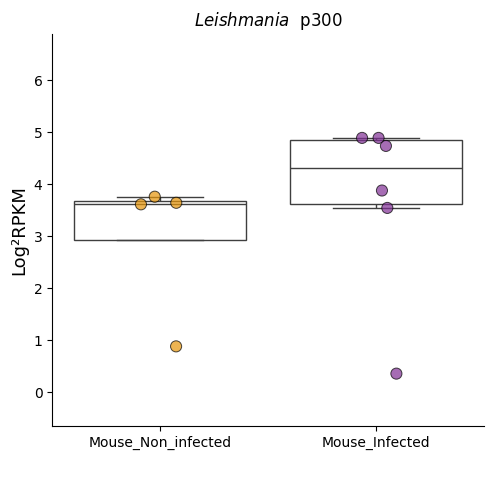

carregando


<Figure size 800x800 with 0 Axes>

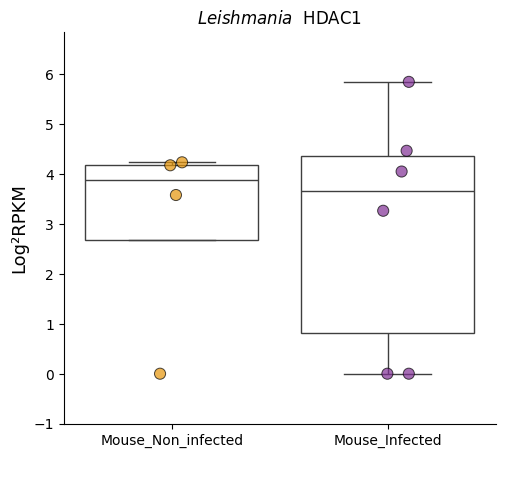

carregando


<Figure size 800x800 with 0 Axes>

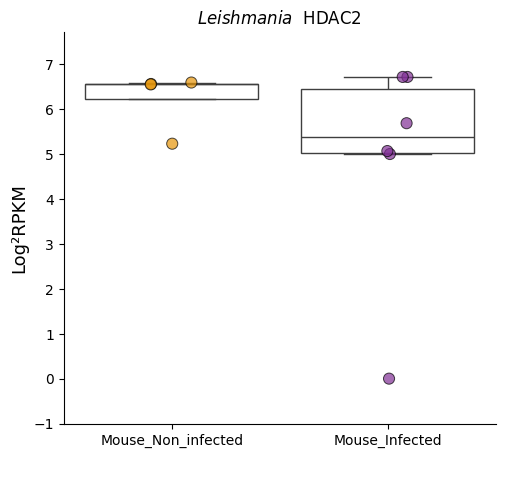

carregando


<Figure size 800x800 with 0 Axes>

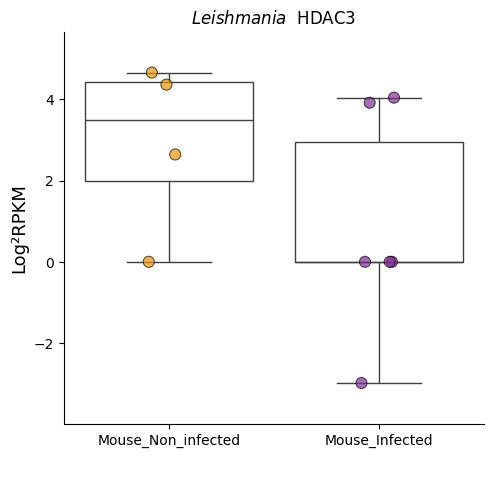

carregando


<Figure size 800x800 with 0 Axes>

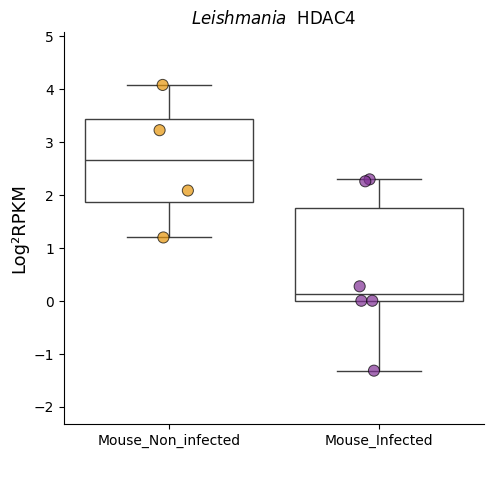

carregando


<Figure size 800x800 with 0 Axes>

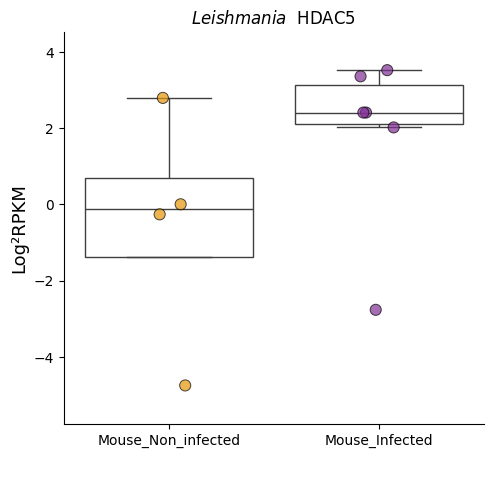

carregando


<Figure size 800x800 with 0 Axes>

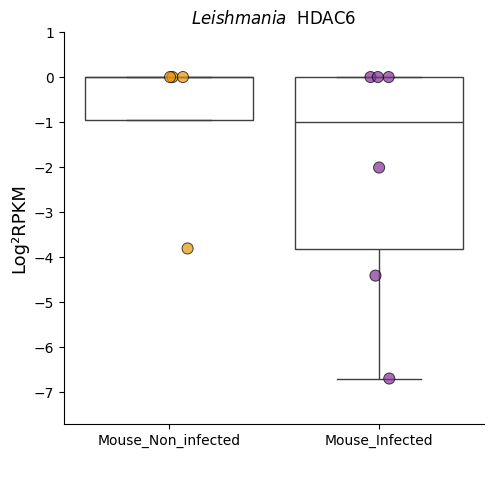

carregando


<Figure size 800x800 with 0 Axes>

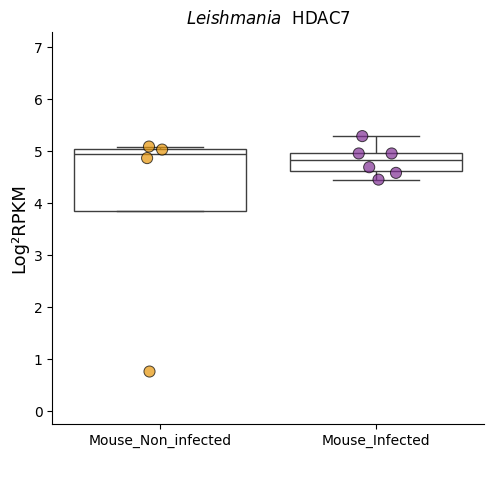

carregando


<Figure size 800x800 with 0 Axes>

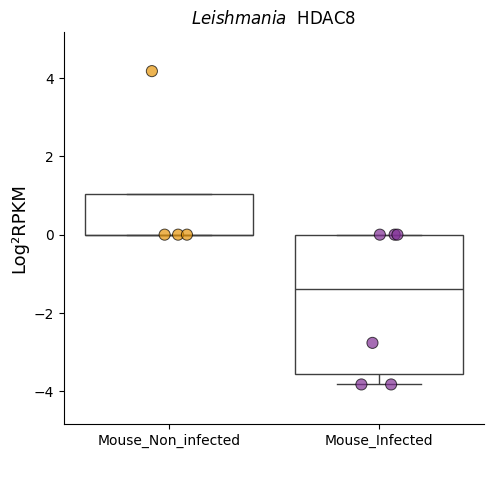

carregando


<Figure size 800x800 with 0 Axes>

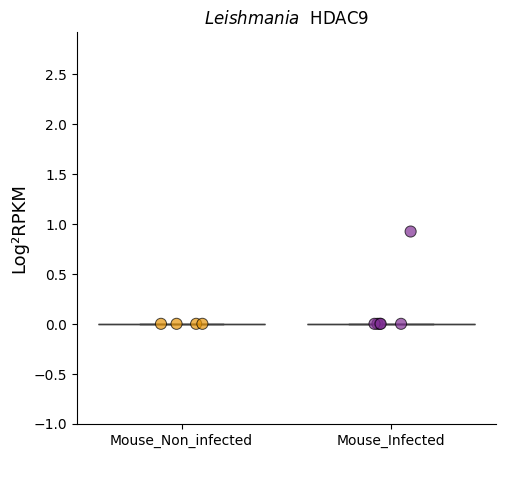

carregando


<Figure size 800x800 with 0 Axes>

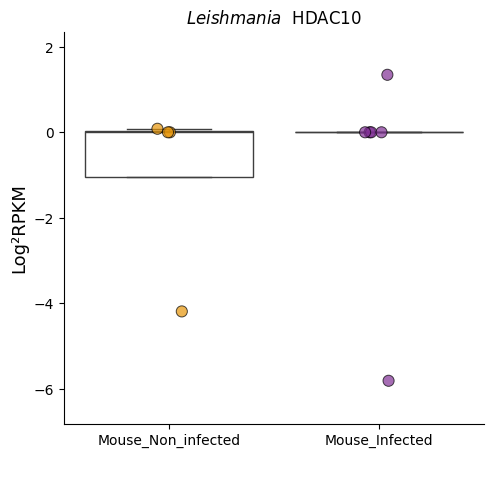

carregando


<Figure size 800x800 with 0 Axes>

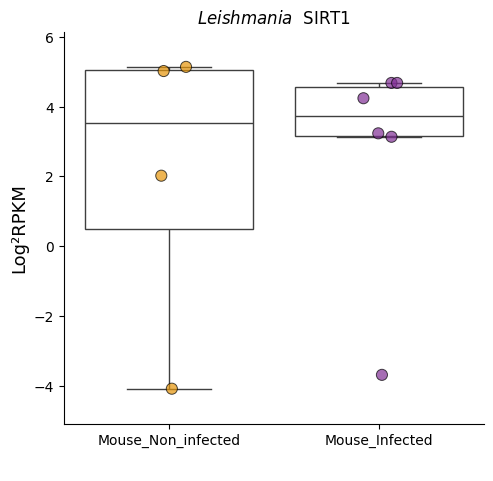

carregando


<Figure size 800x800 with 0 Axes>

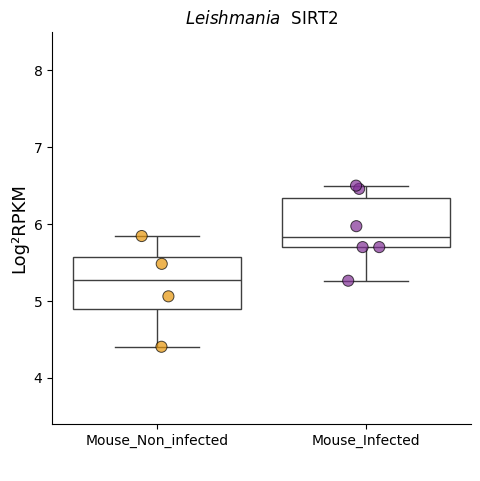

carregando


<Figure size 800x800 with 0 Axes>

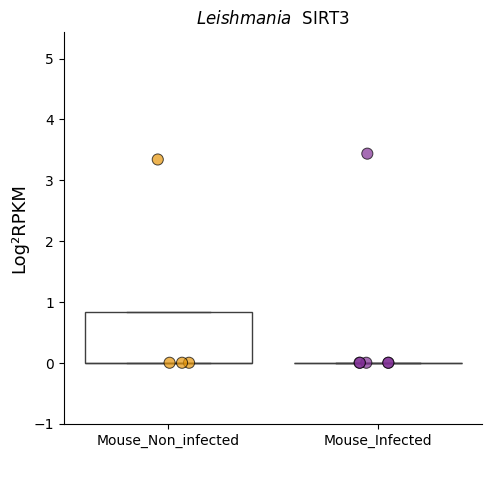

carregando


<Figure size 800x800 with 0 Axes>

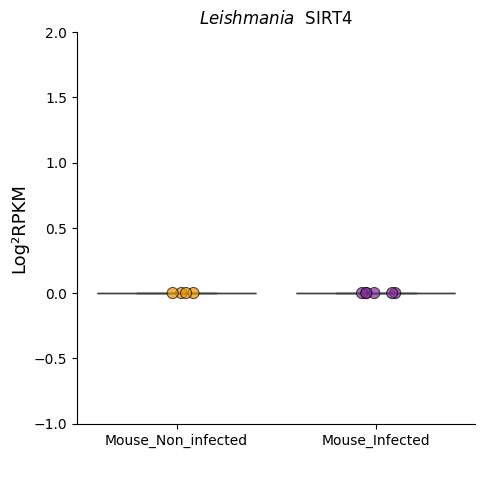

carregando


<Figure size 800x800 with 0 Axes>

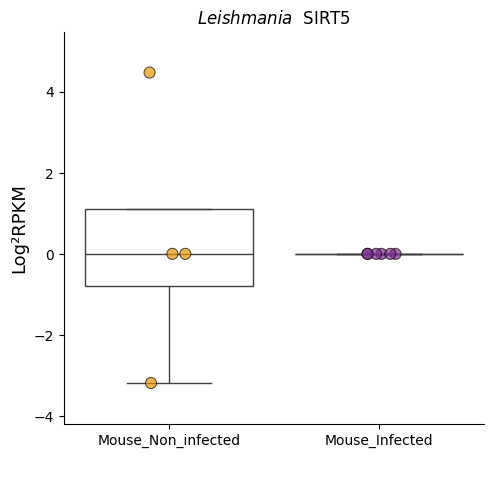

carregando


<Figure size 800x800 with 0 Axes>

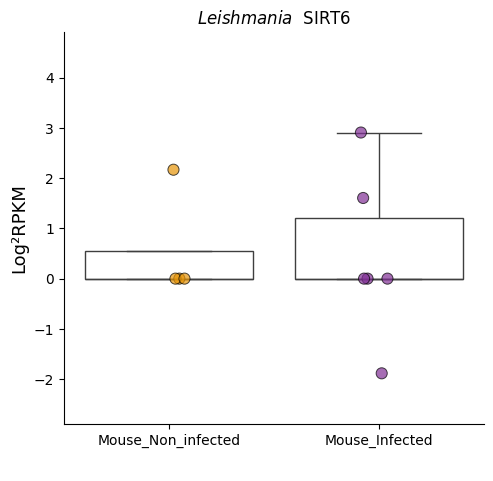

carregando


<Figure size 800x800 with 0 Axes>

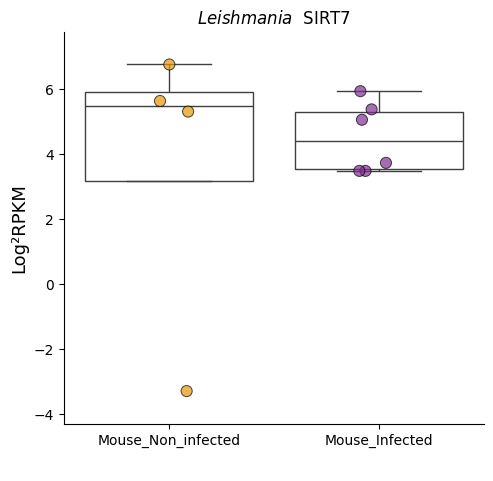

carregando


In [ ]:
graficos_boxplot(df_filtrado, "CMRmap", "Leishmania",      ['Mouse_Non_infected', 'Mouse_Infected']         , nome)


##GSE162760 ✅

In [ ]:
id_gene_pasta="GSE162760"
GSE162760_tab = pd.read_excel(GSE162760 )
GSE162760_tab.head()

,Nome,Control_Non-infected_10_SRR13207491,Control_Non-infected_11_SRR13207492,Control_Non-infected_12_SRR13207493,Control_Non-infected_13_SRR13207494,Control_Non-infected_14_SRR13207495,Control_Non-infected_15_SRR13207496,Control_Non-infected_16_SRR13207497,Control_Non-infected_17_SRR13207498,Control_Non-infected_18_SRR13207499,...,Infected_Lbr_21_SRR13207530,Infected_Lbr_22_SRR13207531,Infected_Lbr_2_SRR13207511,Infected_Lbr_3_SRR13207512,Infected_Lbr_4_SRR13207513,Infected_Lbr_5_SRR13207514,Infected_Lbr_6_SRR13207515,Infected_Lbr_7_SRR13207516,Infected_Lbr_8_SRR13207517,Infected_Lbr_9_SRR13207518
0,YTHDF1,4.172961,4.060678,4.029716,4.211683,4.343067,4.249430,4.073955,4.458236,4.528578,...,4.498387,4.287095,4.114070,3.994269,3.862646,3.977582,3.880347,3.995589,3.934744,3.772102
1,YTHDF2,4.890095,4.773675,4.598486,4.666392,4.554770,4.679931,4.666068,4.804429,4.640008,...,5.125277,5.053201,4.982016,4.911558,5.072584,5.088762,5.066328,4.852746,4.642918,4.693863
2,YTHDF3,6.456912,6.175913,6.133393,5.981482,5.991960,6.111311,6.104134,6.115734,6.107364,...,6.508691,6.524265,6.573076,6.709924,6.685612,6.486711,6.451283,6.566268,6.615514,6.018952
3,YTHDC1,-4.627615,-3.598604,0.000000,-2.206844,0.000000,-2.521399,0.000000,0.000000,0.634051,...,-5.222200,-2.419343,-3.943922,-4.797871,-2.929494,-5.030286,-3.156376,0.000000,0.390532,-3.327509
4,FTO,4.205525,3.752745,3.669046,4.165954,4.210155,4.127524,3.993969,4.653806,4.463363,...,4.106732,4.210493,4.088674,4.153195,4.017372,3.699086,3.667633,4.025656,3.827277,3.631920


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE162760_df_filtrado = GSE162760_tab[GSE162760_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE162760_df_filtrado.index = GSE162760_df_filtrado["Nome"]


In [ ]:
GSE162760_df_filtrado = GSE162760_df_filtrado.T

In [ ]:
GSE162760_df_filtrado = GSE162760_df_filtrado.iloc[1:]

In [ ]:
GSE162760_df_filtrado.index.to_list()

['Control_Non-infected_10_SRR13207491',
 'Control_Non-infected_11_SRR13207492',
 'Control_Non-infected_12_SRR13207493',
 'Control_Non-infected_13_SRR13207494',
 'Control_Non-infected_14_SRR13207495',
 'Control_Non-infected_15_SRR13207496',
 'Control_Non-infected_16_SRR13207497',
 'Control_Non-infected_17_SRR13207498',
 'Control_Non-infected_18_SRR13207499',
 'Control_Non-infected_19_SRR13207500',
 'Control_Non-infected_1_SRR13207482',
 'Control_Non-infected_20_SRR13207501',
 'Control_Non-infected_21_SRR13207502',
 'Control_Non-infected_22_SRR13207503',
 'Control_Non-infected_23_SRR13207504',
 'Control_Non-infected_24_SRR13207505',
 'Control_Non-infected_25_SRR13207506',
 'Control_Non-infected_26_SRR13207507',
 'Control_Non-infected_27_SRR13207508',
 'Control_Non-infected_28_SRR13207509',
 'Control_Non-infected_2_SRR13207483',
 'Control_Non-infected_3_SRR13207484',
 'Control_Non-infected_4_SRR13207485',
 'Control_Non-infected_5_SRR13207486',
 'Control_Non-infected_6_SRR13207487',
 'Cont

In [ ]:
GSE162760_df_filtrado["Status"] =['Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Control_Non-infected',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr',
 'Infected_Lbr']

In [ ]:
GSE162760_df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7,Status
Control_Non-infected_10_SRR13207491,5.072824,2.339298,7.978502,3.71552,5.963361,2.847821,4.926572,4.513562,2.703225,4.196546,...,4.371373,1.136018,4.885954,3.17974,2.593875,0.165934,5.025673,1.104886,5.336009,Control_Non-infected
Control_Non-infected_11_SRR13207492,4.956496,1.752973,8.499627,3.836161,5.596676,2.490903,4.930252,4.851475,1.839152,3.699146,...,3.573716,2.5324,4.455053,4.420801,2.147977,-1.390018,4.376612,2.603382,5.351844,Control_Non-infected
Control_Non-infected_12_SRR13207493,5.114671,1.937928,8.487285,3.960078,5.621539,2.529461,4.908564,4.970414,1.727183,3.623291,...,3.622898,2.435047,4.315223,4.341998,2.236693,-0.331195,4.497624,2.822669,5.400509,Control_Non-infected
Control_Non-infected_13_SRR13207494,4.760632,2.768062,8.761547,3.476082,5.623425,3.189641,4.918851,4.812629,2.213137,4.601101,...,3.660461,3.175968,4.323912,4.185473,2.710206,-0.150261,4.686936,2.457485,5.073031,Control_Non-infected
Control_Non-infected_14_SRR13207495,4.856229,2.651697,8.750476,3.192144,5.657767,3.122671,5.049262,4.679896,2.472006,4.581539,...,3.44241,3.130137,4.424717,4.102444,2.345603,-0.240486,4.726319,2.732736,5.073042,Control_Non-infected


In [ ]:
infected_data = GSE162760_df_filtrado[GSE162760_df_filtrado['Status'] == 'Infected_Lbr']
uninfected_data = GSE162760_df_filtrado[GSE162760_df_filtrado['Status'] == 'Control_Non-infected']

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df
UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,5.109493,2.534467,8.001172,3.77362,5.85074,2.994704,5.046679,4.799119,2.402359,4.11201,...,3.505013,4.20245,2.628467,4.805343,4.219307,2.492561,-0.12875,5.11036,2.647171,5.242719


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania_GSE162760"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE162760/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Down,Normal,Down,Normal,Normal,Normal,Down,Normal


In [ ]:
median_infected = infected_data.iloc[:, 0:-1].median()
median_uninfected = uninfected_data.iloc[:, 0:-1].median()

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.180765,-0.918303,-0.040705,0.1692,-0.237252,-0.306303,-0.091804,-0.026208,-0.179361,-0.478528,...,0.032482,-0.445606,-2.076915,0.058283,-0.926476,-0.071995,0.288892,0.076291,-1.679196,-0.021444


gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

regulated_genes.to_excel("L. braziliensis_GSE162760.xlsx")
regulated_genes


In [ ]:
infected_data = GSE162760_df_filtrado[GSE162760_df_filtrado['Status'] == 'Infected_Lbr']
uninfected_data = GSE162760_df_filtrado[GSE162760_df_filtrado['Status'] == 'Control_Non-infected']

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df
UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,5.109493,2.534467,8.001172,3.77362,5.85074,2.994704,5.046679,4.799119,2.402359,4.11201,...,3.505013,4.20245,2.628467,4.805343,4.219307,2.492561,-0.12875,5.11036,2.647171,5.242719


In [ ]:
# Calcular a mediana para cada grupo
median_infected = infected_data.iloc[:, 0:-1].median()
median_uninfected = uninfected_data.iloc[:, 0:-1].median()

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.180765,-0.918303,-0.040705,0.1692,-0.237252,-0.306303,-0.091804,-0.026208,-0.179361,-0.478528,...,0.032482,-0.445606,-2.076915,0.058283,-0.926476,-0.071995,0.288892,0.076291,-1.679196,-0.021444


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

regulated_genes.to_excel("L. braziliensis_GSE162760.xlsx")
regulated_genes


Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Down,Normal,Down,Normal,Normal,Normal,Down,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, caminho="aqui"):
  sns.set_theme(style="ticks", font_scale=0.8)
  sns.set_style("whitegrid")
  for i in tabela:
    if "Status" in i: continue

    plt.figure(figsize=(4,8));
    graficos=sns.catplot(data=tabela,x="Status",y=i,kind="strip",palette=paleta, size=5 ,edgecolor='black',linewidth=1,hue="Status",order=ordem);
    graficos=sns.boxplot(data = tabela,x="Status", y = i, showcaps=True,boxprops={'facecolor':'None'},showfliers=True,whiskerprops={'linewidth':1},hue="Status", order=ordem)
    plt.xticks(rotation=0)
    # graficos.set_axis_labels("Time", "Log²RPKM")

    plt.ylim(min(tabela[i])-1,max(tabela[i])+1)
    if max(tabela[i])-min(tabela[i])<5:
        plt.ylim(min(tabela[i])-2,max(tabela[i])+2)
    titulo = plt.gcf().suptitle(f'${especie}$  '+i, fontsize=14)
    titulo.set_y(1.05)
    graficos = plt.xlabel(' ', fontdict={'size': 13});
    graficos = plt.ylabel('Log²RPKM', fontdict={'size': 13});
    # plt.savefig(f"{caminho}/{i}.png",dpi=200, format='png')
    plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{especie}{i}.png",dpi=200, format='png')

    plt.show(graficos)
    print("carregando")
    # break


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, caminho="aqui"):
    for i in tabela:
        if "Status" in i:
            continue

        plt.figure(figsize=(10, 8))  # Aumentando o tamanho da figura

        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=5, edgecolor='black',
                         linewidth=1, hue="Status", order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", order=ordem)

        plt.xticks(rotation=0)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE162760/{especie}_{i}.png",
                    dpi=200, format='png')

        plt.show()

        print("carregando")


In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Down,Normal,Down,Normal,Normal,Normal,Down,Normal


<Figure size 1000x800 with 0 Axes>

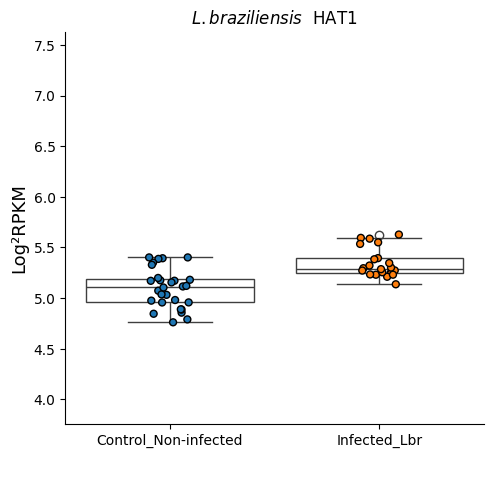

carregando


<Figure size 1000x800 with 0 Axes>

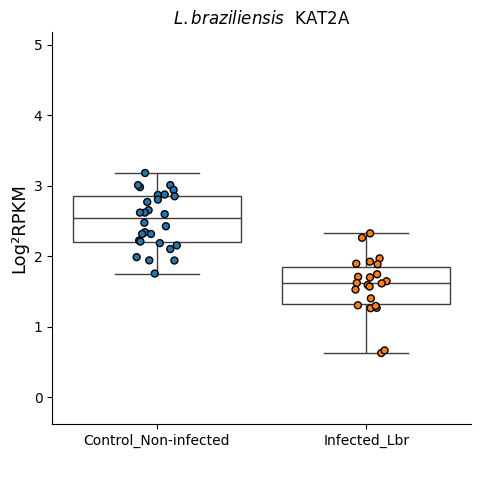

carregando


<Figure size 1000x800 with 0 Axes>

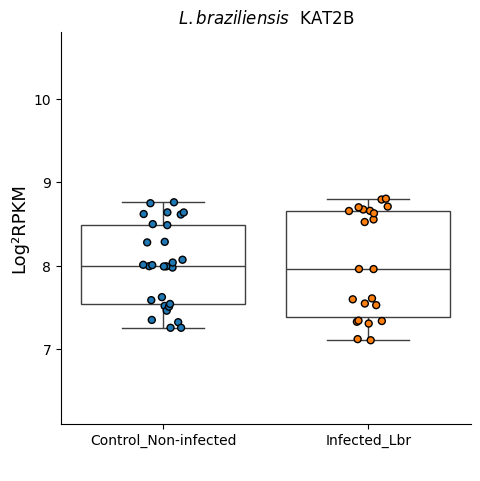

carregando


<Figure size 1000x800 with 0 Axes>

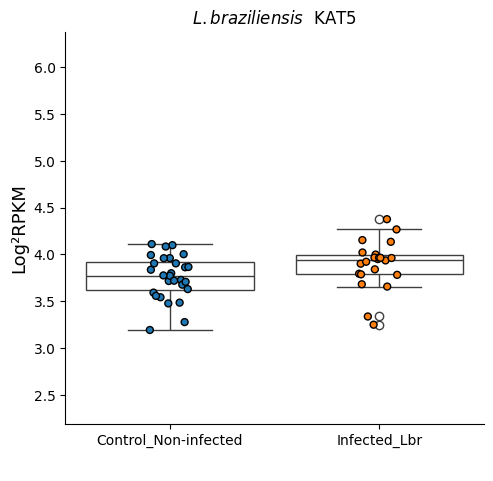

carregando


<Figure size 1000x800 with 0 Axes>

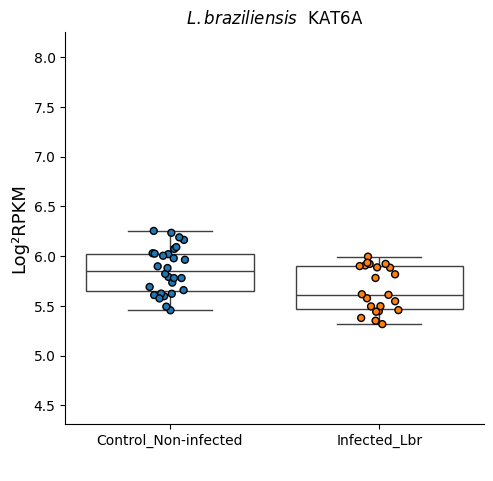

carregando


<Figure size 1000x800 with 0 Axes>

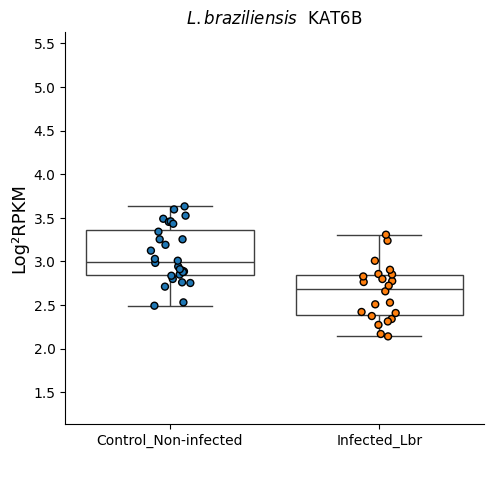

carregando


<Figure size 1000x800 with 0 Axes>

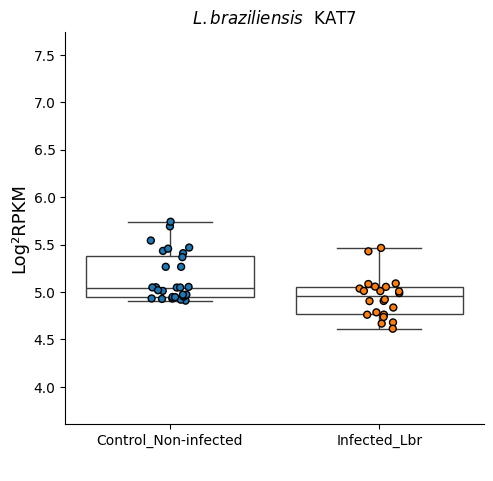

carregando


<Figure size 1000x800 with 0 Axes>

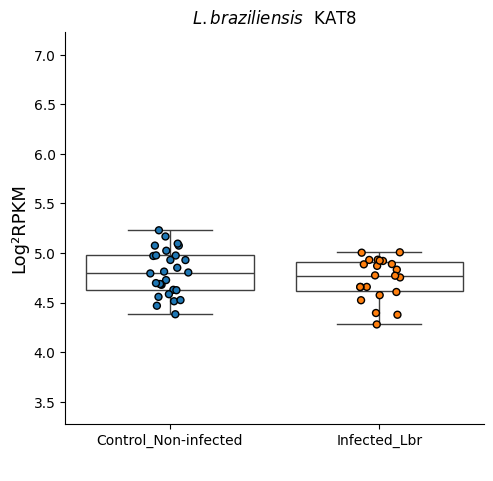

carregando


<Figure size 1000x800 with 0 Axes>

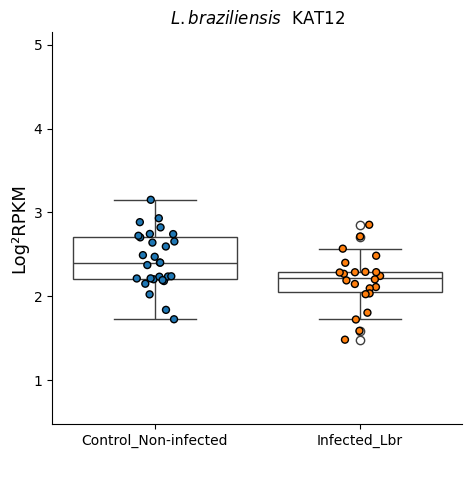

carregando


<Figure size 1000x800 with 0 Axes>

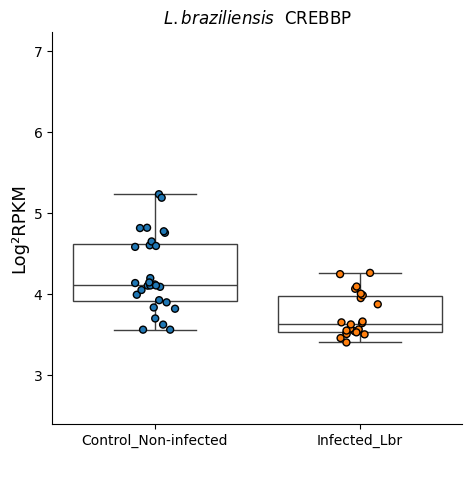

carregando


<Figure size 1000x800 with 0 Axes>

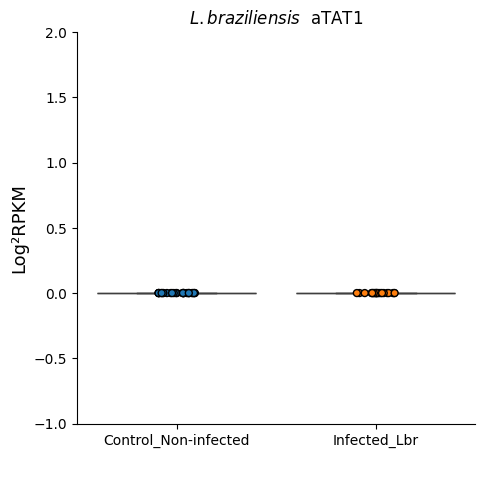

carregando


<Figure size 1000x800 with 0 Axes>

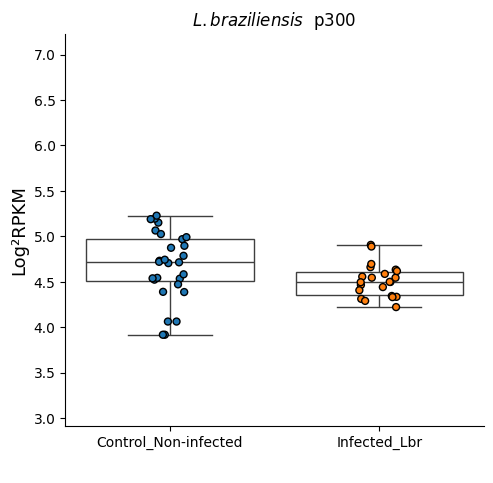

carregando


<Figure size 1000x800 with 0 Axes>

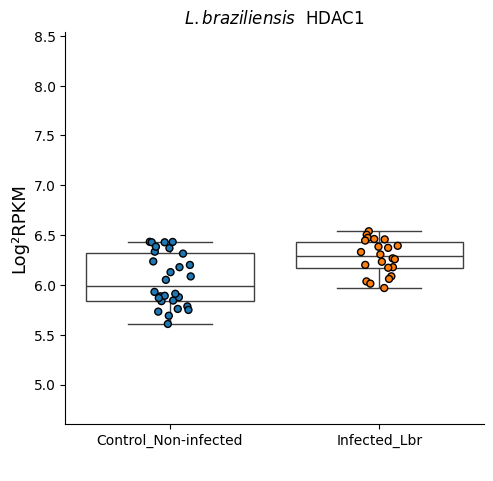

carregando


<Figure size 1000x800 with 0 Axes>

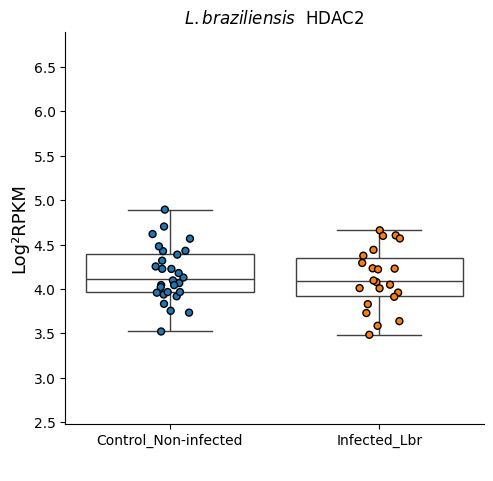

carregando


<Figure size 1000x800 with 0 Axes>

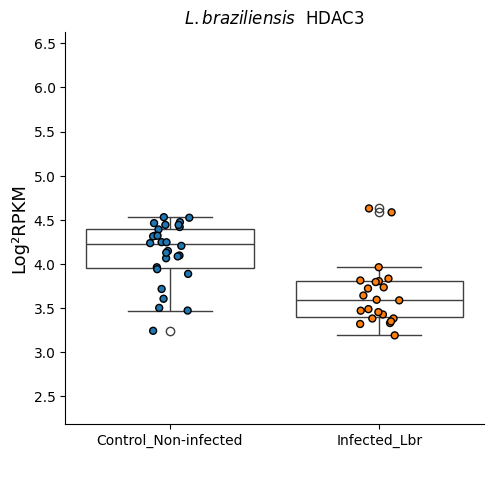

carregando


<Figure size 1000x800 with 0 Axes>

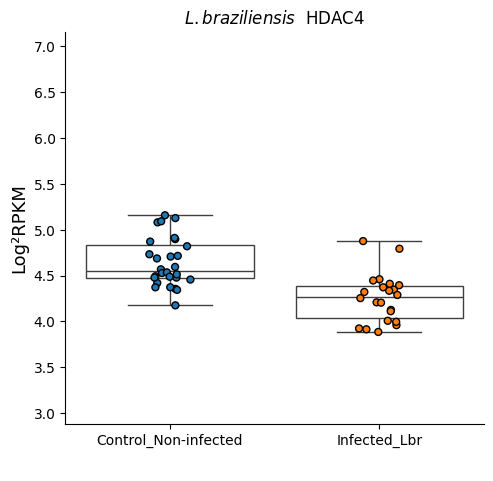

carregando


<Figure size 1000x800 with 0 Axes>

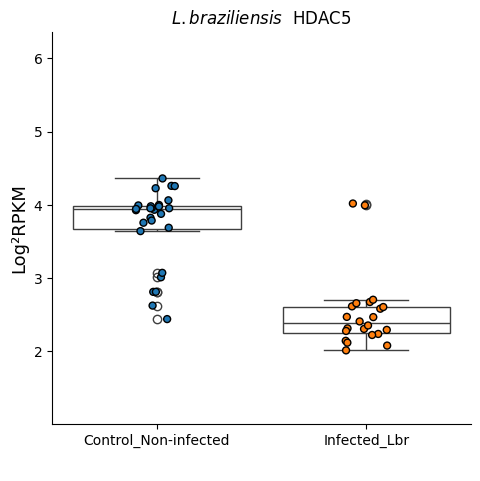

carregando


<Figure size 1000x800 with 0 Axes>

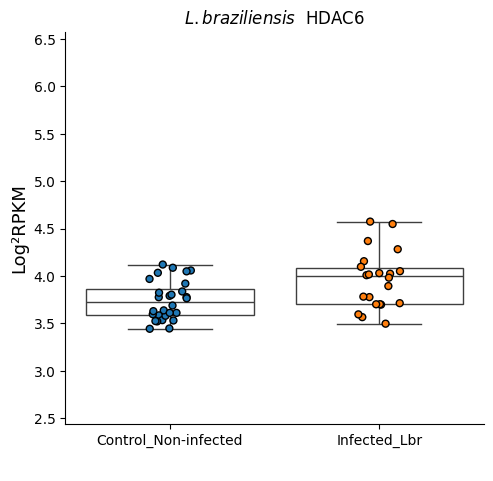

carregando


<Figure size 1000x800 with 0 Axes>

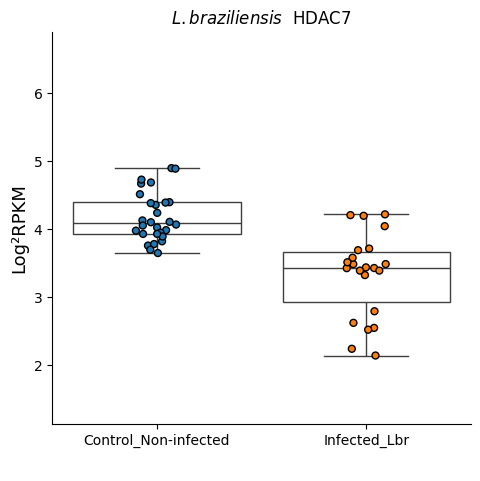

carregando


<Figure size 1000x800 with 0 Axes>

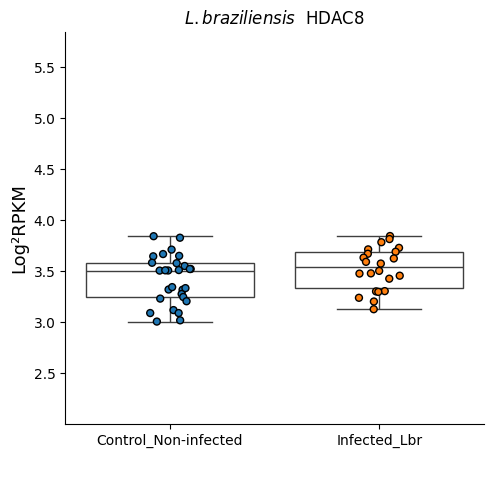

carregando


<Figure size 1000x800 with 0 Axes>

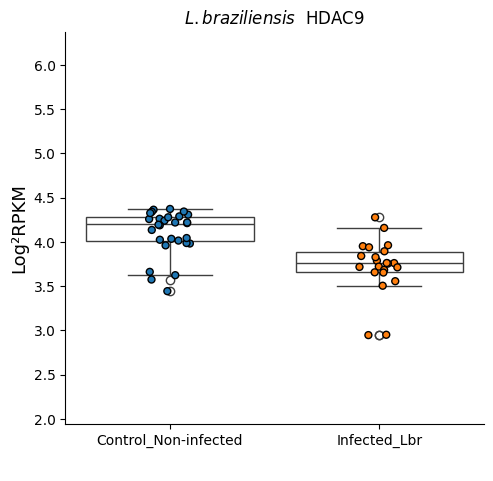

carregando


<Figure size 1000x800 with 0 Axes>

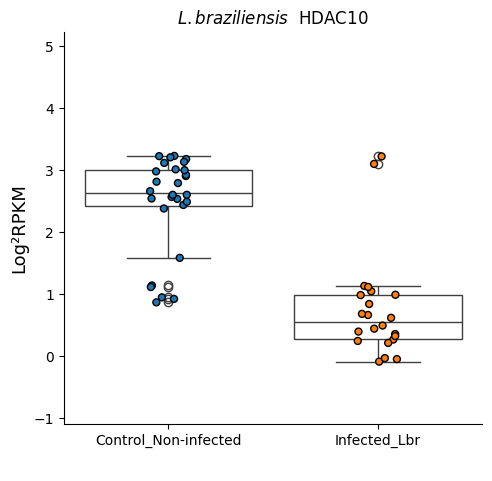

carregando


<Figure size 1000x800 with 0 Axes>

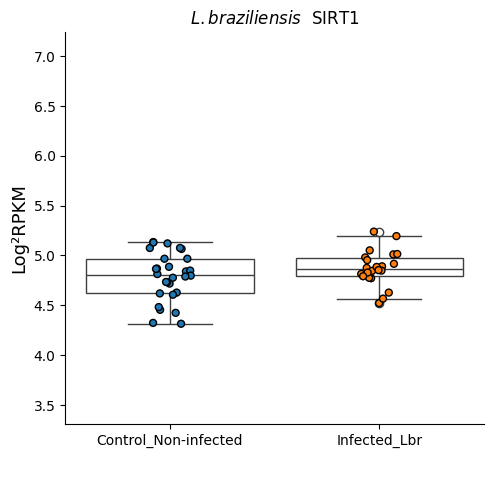

carregando


<Figure size 1000x800 with 0 Axes>

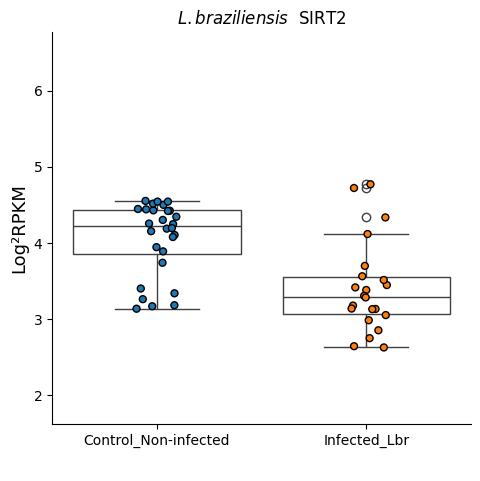

carregando


<Figure size 1000x800 with 0 Axes>

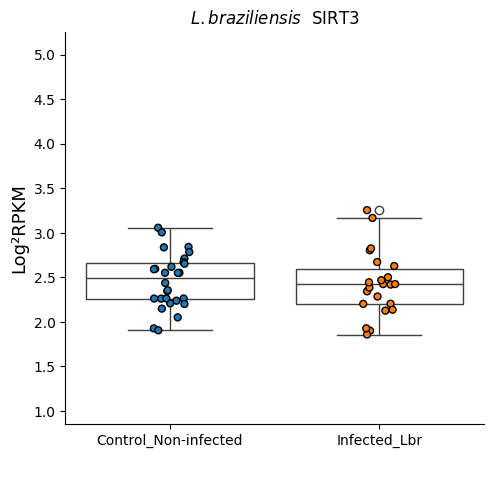

carregando


<Figure size 1000x800 with 0 Axes>

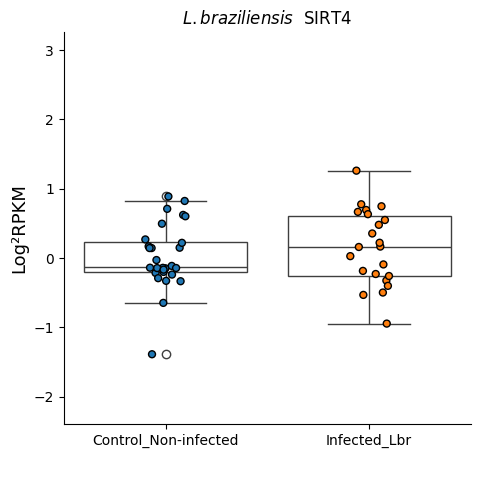

carregando


<Figure size 1000x800 with 0 Axes>

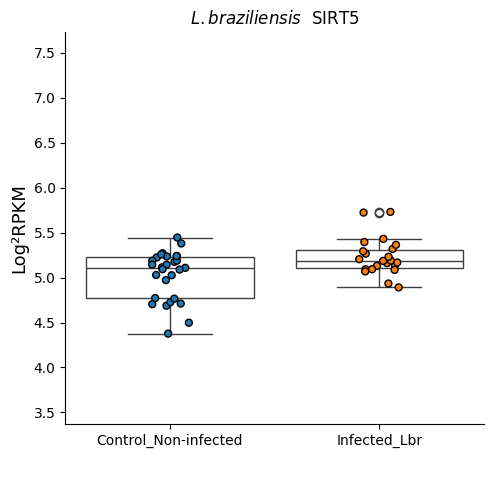

carregando


<Figure size 1000x800 with 0 Axes>

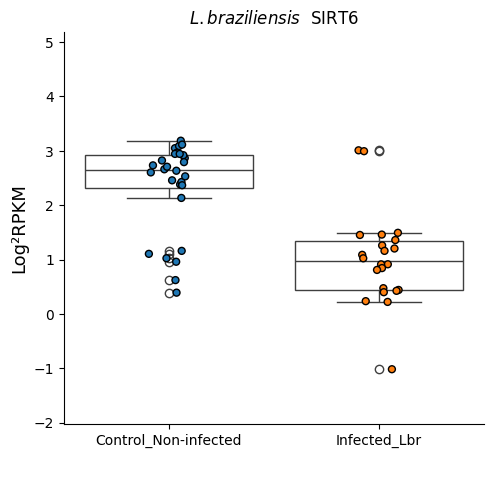

carregando


<Figure size 1000x800 with 0 Axes>

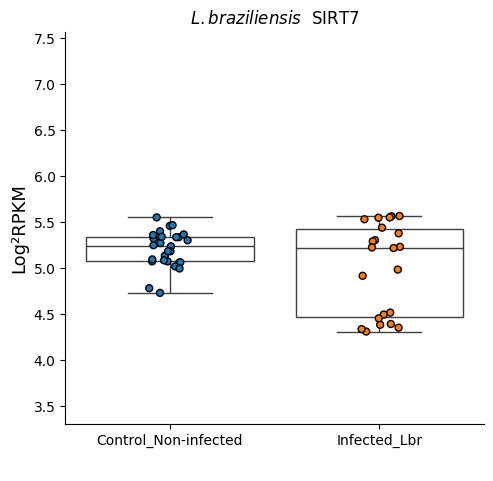

carregando


In [ ]:
graficos_boxplot(GSE162760_df_filtrado, "Blues", "L. braziliensis", ["Control_Non-infected", "Infected_Lbr" ])


##GSE189385 ✅


In [ ]:
id_gene_pasta="GSE189385"
GSE189385_tab = pd.read_excel(GSE189385 )
GSE189385_tab.head()

,Nome,Mouse_Infected_3_SRR17015115,Mouse_Infected_5_SRR17015117,Mouse_Infected_6_SRR17015118,Mouse_Uninf_1_SRR17015119,Mouse_Uninf_2_SRR17015120,Mouse_Uninf_3_SRR17015122,Mouse_Uninf_4_SRR17015122,Mouse_Uninf_5_SRR17015123,Mouse_Uninf_6_SRR17015124,Mouse_infected_1_SRR17015113,Mouse_infected_2_SRR17015114,Mouse_infected_4_SRR17015116
0,YTHDF1,4.841907,5.299812,5.290297,5.234473,5.326390,5.326796,5.326796,5.277545,5.325012,5.158825,5.125580,5.058944
1,YTHDF2,4.926796,5.410077,5.321857,5.582668,5.584385,5.547677,5.547677,5.529846,5.556039,5.054377,5.012546,4.893632
2,YTHDF3,7.150079,6.901054,6.871604,6.210990,6.231603,6.452136,6.452136,6.700405,6.698611,7.039511,6.993313,7.150185
3,YTHDC1,6.089253,5.875082,5.926219,5.514156,5.572867,5.465339,5.465339,5.333685,5.383800,5.886525,5.897041,6.112077
4,FTO,2.759736,3.384940,3.280207,4.947540,5.003186,5.002279,5.002279,4.979428,4.936655,3.569939,3.687037,2.835680


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE189385_df_filtrado = GSE189385_tab[GSE189385_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE189385_df_filtrado.index = GSE189385_df_filtrado["Nome"]

GSE189385_df_filtrado = GSE189385_df_filtrado.T
df_filtrado = GSE189385_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
Mouse_Infected_3_SRR17015115,2.615209,2.7088,4.313193,4.835267,5.841688,1.678214,5.908294,2.79594,3.801768,5.597761,...,1.686481,-0.024489,0.750361,5.600734,6.558825,2.500531,0.865019,-0.353975,2.574402,5.285622
Mouse_Infected_5_SRR17015117,2.938757,3.322483,4.055306,4.991573,5.768021,1.519224,6.042469,2.928635,4.380707,5.409976,...,1.797112,1.284112,1.905252,5.536534,6.427115,2.205169,-0.167308,-0.479412,2.929917,5.312188
Mouse_Infected_6_SRR17015118,3.038268,3.367132,4.016491,4.967867,5.775492,1.746591,5.951644,2.27179,4.386123,5.395568,...,1.221749,0.755745,1.602757,5.488648,6.49962,1.813406,-0.728996,0.373938,2.967131,5.317485
Mouse_Uninf_1_SRR17015119,3.422814,4.745583,4.687687,5.124653,5.65896,2.703338,6.424151,3.422791,4.820084,4.850525,...,3.021139,4.48657,4.257601,4.18265,5.492962,3.203946,2.154668,2.559065,3.447691,5.675036
Mouse_Uninf_2_SRR17015120,2.987463,4.735302,4.620528,5.184555,5.68956,2.689356,6.444659,3.484125,5.007584,4.82674,...,2.962095,4.438151,4.073805,4.205811,5.473036,3.006699,2.114354,2.329497,3.626205,5.749606


In [ ]:
df_filtrado.index.to_list()

['Mouse_Infected_3_SRR17015115',
 'Mouse_Infected_5_SRR17015117',
 'Mouse_Infected_6_SRR17015118',
 'Mouse_Uninf_1_SRR17015119',
 'Mouse_Uninf_2_SRR17015120',
 'Mouse_Uninf_3_SRR17015122',
 'Mouse_Uninf_4_SRR17015122',
 'Mouse_Uninf_5_SRR17015123',
 'Mouse_Uninf_6_SRR17015124',
 'Mouse_infected_1_SRR17015113',
 'Mouse_infected_2_SRR17015114',
 'Mouse_infected_4_SRR17015116']

In [ ]:
df_filtrado["Status"] =   ['Mouse_Infected',
'Mouse_Infected',
'Mouse_Infected',
'Mouse_Uninf',
'Mouse_Uninf',
'Mouse_Uninf',
'Mouse_Uninf',
'Mouse_Uninf',
'Mouse_Uninf',
'Mouse_Infected',
'Mouse_Infected',
'Mouse_Infected']

<ipython-input-303-7131e934d535>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =   ['Mouse_Infected',


In [ ]:
list(set(df_filtrado["Status"]))


['Mouse_Infected', 'Mouse_Uninf']

In [ ]:
#############################################################
infected_data = df_filtrado[(df_filtrado['Status'] == 'Mouse_Infected')]
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Mouse_Uninf']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,-0.289982,-1.08326,-0.512091,-0.060233,0.238606,-1.078873,-0.461728,-0.817261,-1.009009,0.831132,...,-1.419067,-3.905448,-2.542735,1.311124,1.046224,-0.880367,-2.053937,-2.847766,-0.54018,-0.385417


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania_GSE189385"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE189385/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Down,Normal,Normal,Normal,Down,Normal,Down,Down,UP,...,Down,Down,Down,UP,UP,Down,Down,Down,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Down,Normal,Normal,Normal,Down,Normal,Down,Down,UP,...,Down,Down,Down,UP,UP,Down,Down,Down,Normal,Normal


<Figure size 800x800 with 0 Axes>

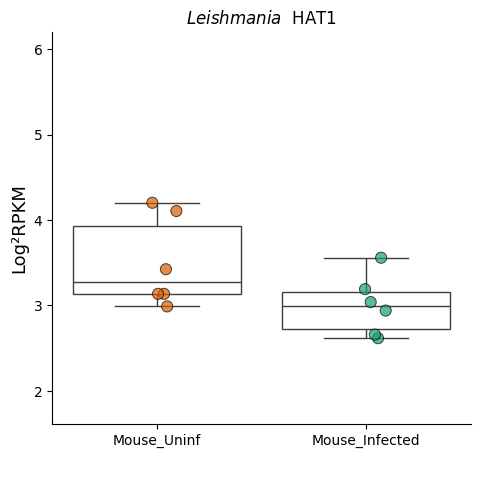

carregando


<Figure size 800x800 with 0 Axes>

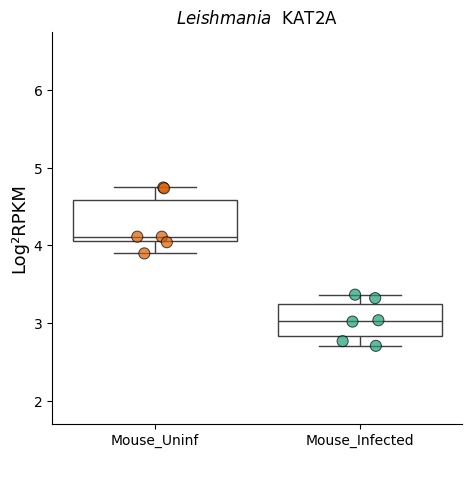

carregando


<Figure size 800x800 with 0 Axes>

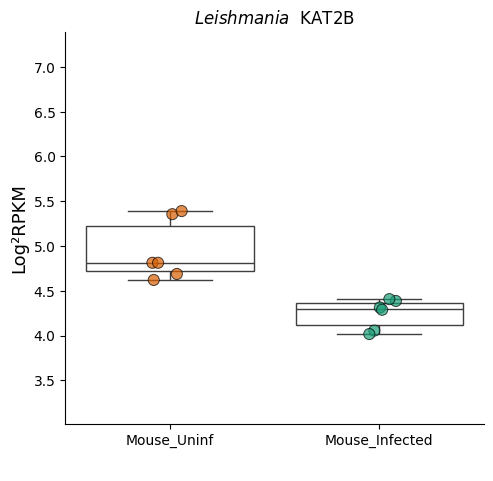

carregando


<Figure size 800x800 with 0 Axes>

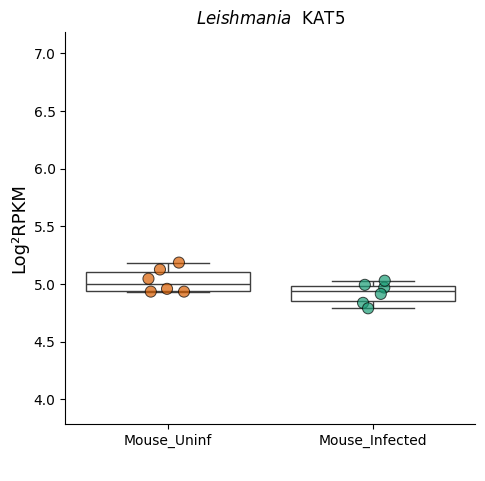

carregando


<Figure size 800x800 with 0 Axes>

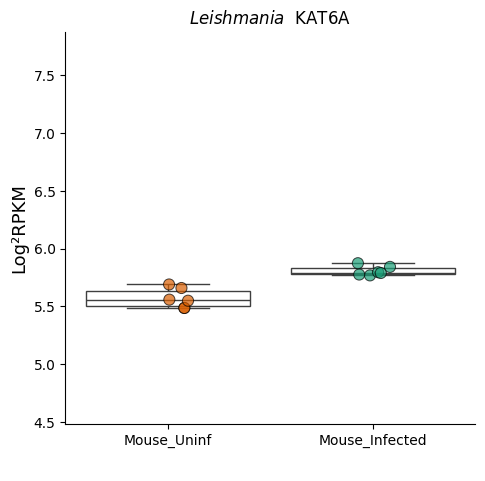

carregando


<Figure size 800x800 with 0 Axes>

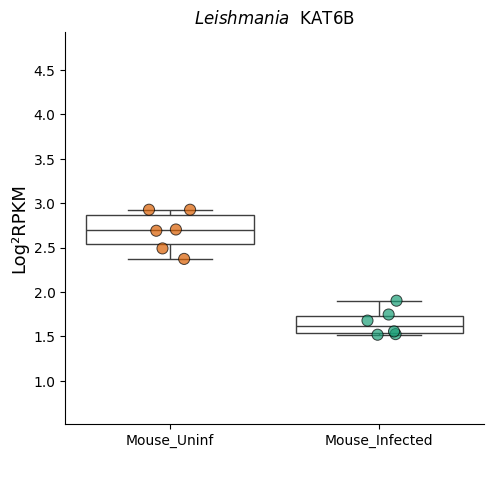

carregando


<Figure size 800x800 with 0 Axes>

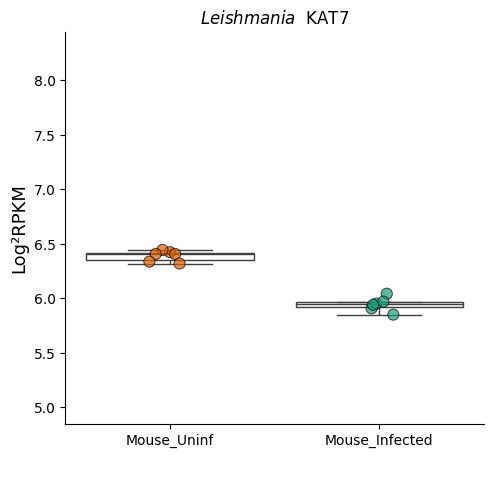

carregando


<Figure size 800x800 with 0 Axes>

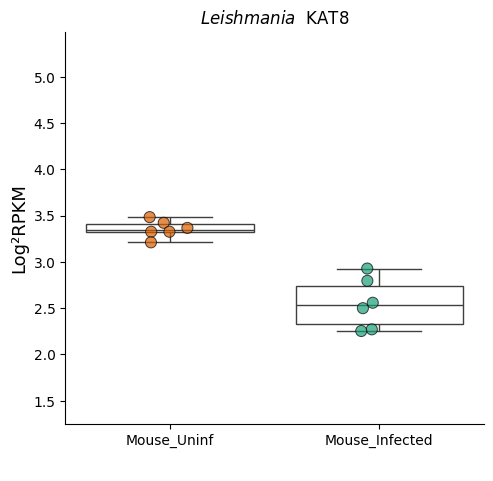

carregando


<Figure size 800x800 with 0 Axes>

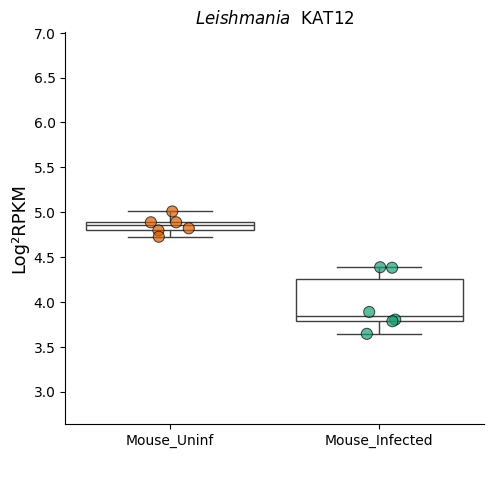

carregando


<Figure size 800x800 with 0 Axes>

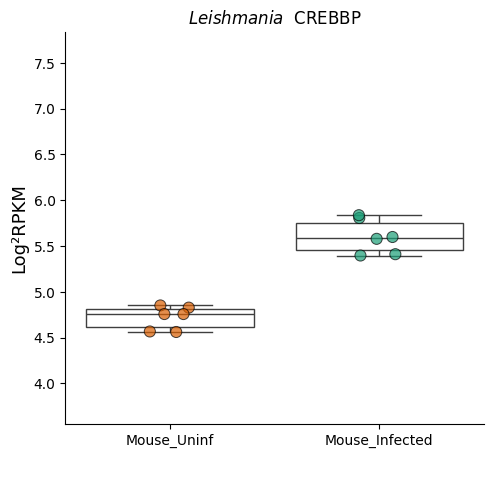

carregando


<Figure size 800x800 with 0 Axes>

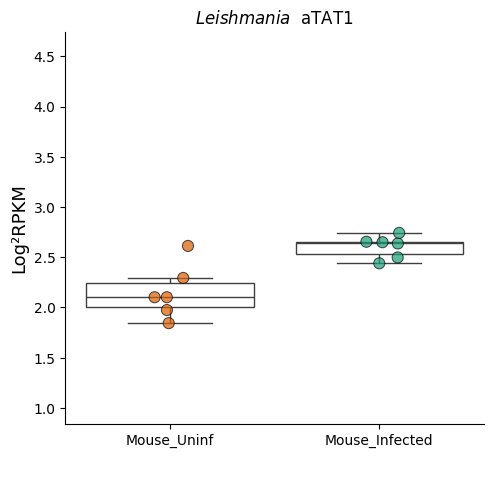

carregando


<Figure size 800x800 with 0 Axes>

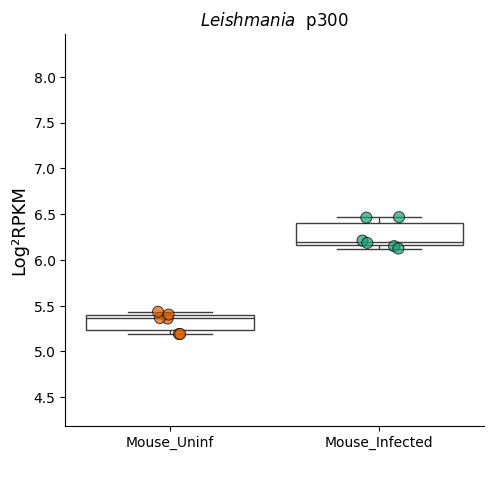

carregando


<Figure size 800x800 with 0 Axes>

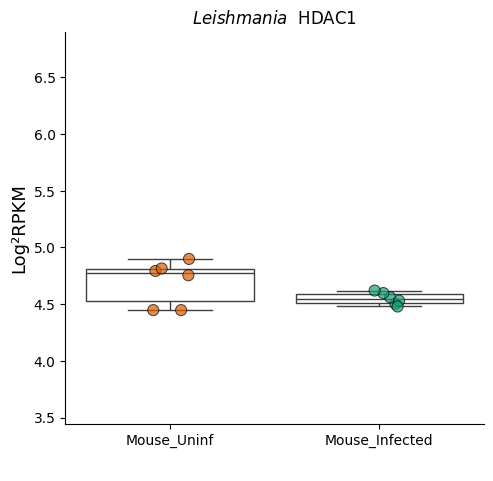

carregando


<Figure size 800x800 with 0 Axes>

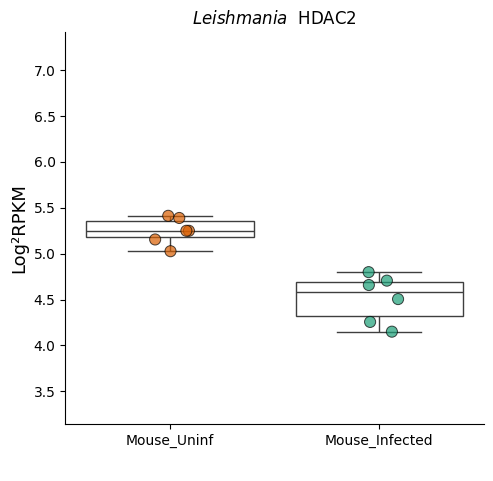

carregando


<Figure size 800x800 with 0 Axes>

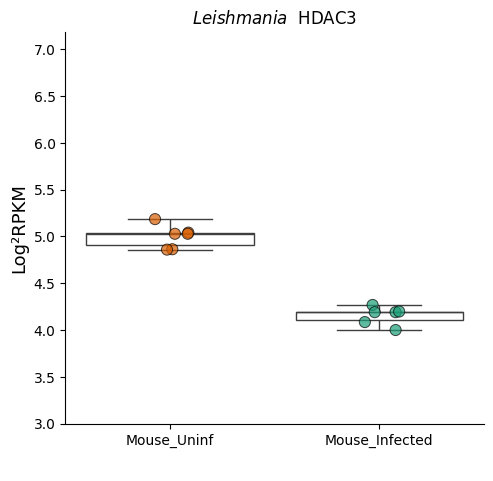

carregando


<Figure size 800x800 with 0 Axes>

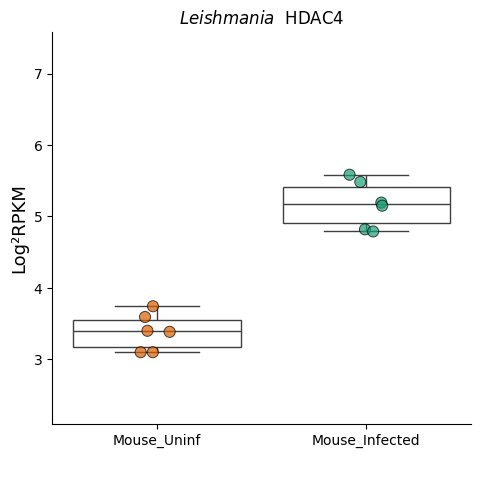

carregando


<Figure size 800x800 with 0 Axes>

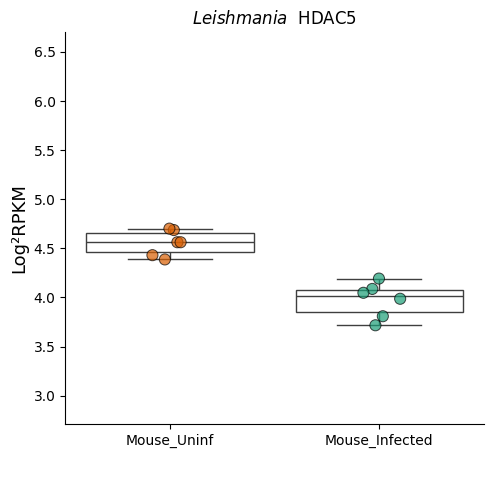

carregando


<Figure size 800x800 with 0 Axes>

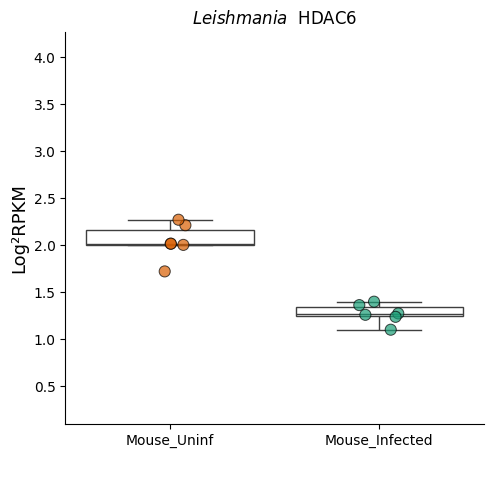

carregando


<Figure size 800x800 with 0 Axes>

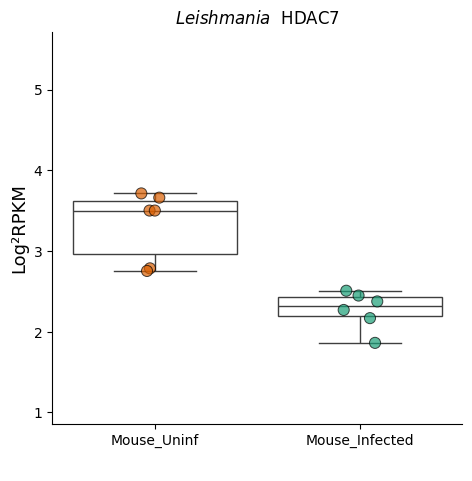

carregando


<Figure size 800x800 with 0 Axes>

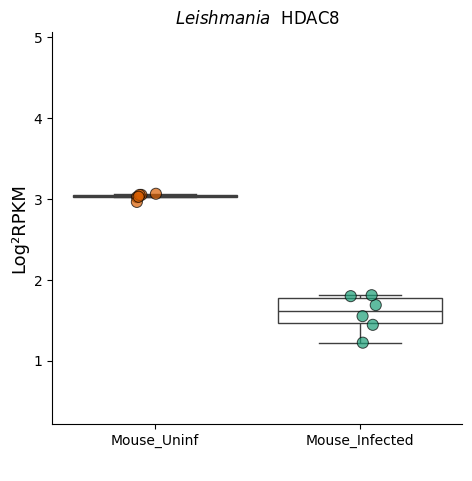

carregando


<Figure size 800x800 with 0 Axes>

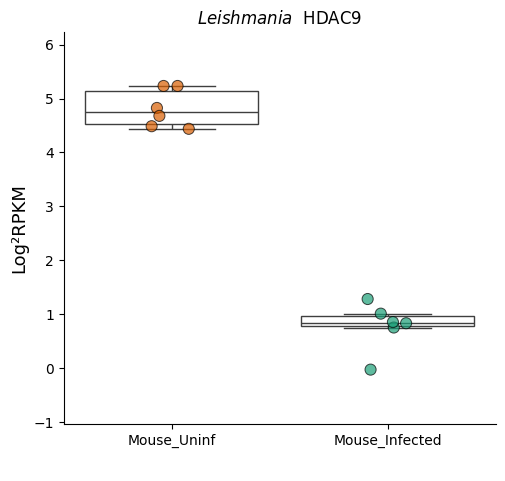

carregando


<Figure size 800x800 with 0 Axes>

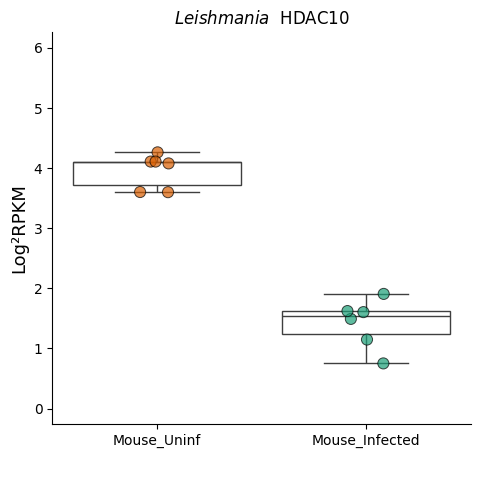

carregando


<Figure size 800x800 with 0 Axes>

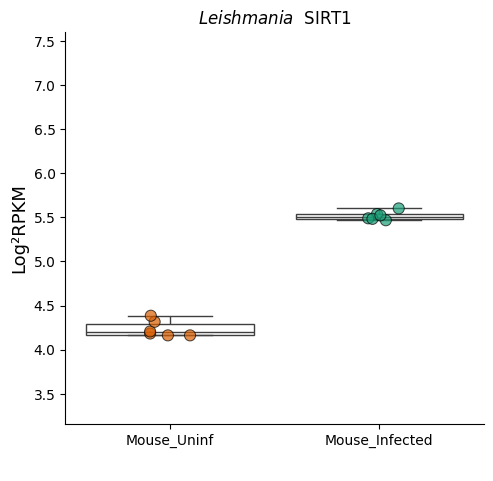

carregando


<Figure size 800x800 with 0 Axes>

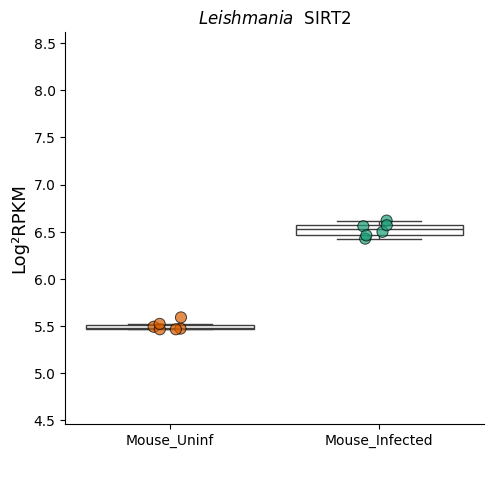

carregando


<Figure size 800x800 with 0 Axes>

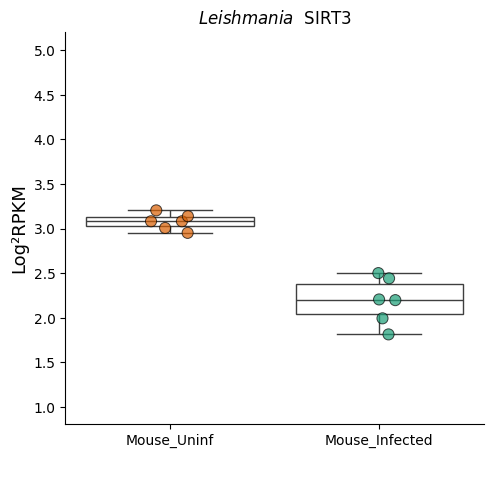

carregando


<Figure size 800x800 with 0 Axes>

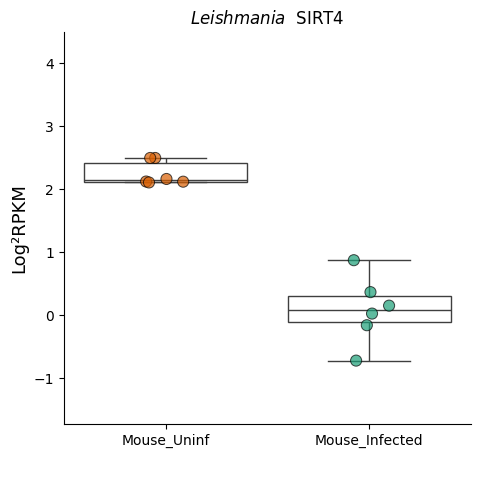

carregando


<Figure size 800x800 with 0 Axes>

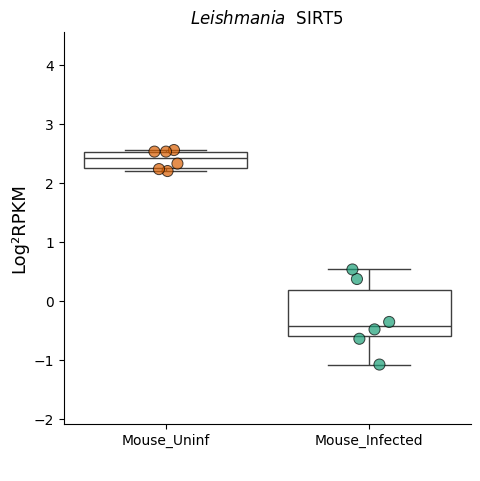

carregando


<Figure size 800x800 with 0 Axes>

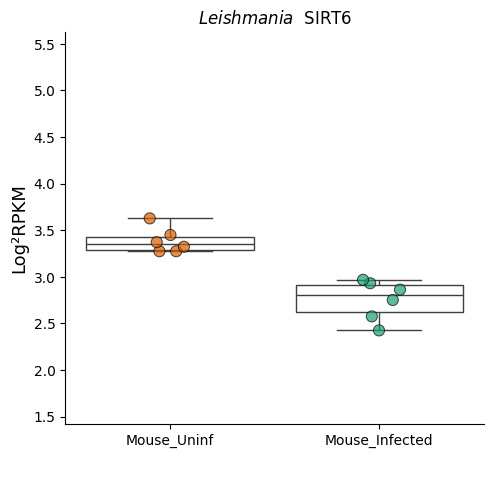

carregando


<Figure size 800x800 with 0 Axes>

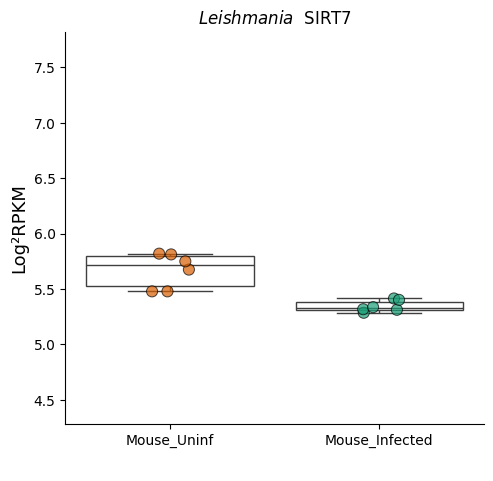

carregando


In [ ]:
graficos_boxplot(df_filtrado, "Dark2", "Leishmania",    [ 'Mouse_Uninf' ,'Mouse_Infected']        , nome)


##PRJEB36928 ✅


In [16]:
id_gene_pasta="PRJEB36928"
PRJEB36928_tab = pd.read_excel(PRJEB36928 )
PRJEB36928_tab.head()

,Nome,Active_Disease_Linf_1_ERR3957399,Active_Disease_Linf_2_ERR3957400,Active_Disease_Linf_3_ERR3957401,Active_Disease_Linf_4_ERR3957402,Active_Disease_Linf_5_ERR3957403,Active_Disease_Linf_6_ERR3957404,Healthy_Linf_1_ERR3957386,Healthy_Linf_2_ERR3957387,Healthy_Linf_3_ERR3957388,Healthy_Linf_4_ERR3957389,Healthy_Linf_Positive_1_ERR3957390,Healthy_Linf_Positive_2_ERR3957391,Healthy_Linf_Positive_3_ERR3957392,Healthy_Linf_Positive_4_ERR3957393,Healthy_Linf_Positive_5_ERR3957394,Healthy_Linf_Positive_6_ERR3957395,Healthy_Linf_Positive_7_ERR3957396,Healthy_Linf_Positive_8_ERR3957397,Healthy_Linf_Positive_9_ERR3957398
0,YTHDF1,5.089985,4.136770,4.580332,4.958992,3.739433,5.107882,5.315122,5.048314,5.062229,5.227565,5.506061,5.454729,5.211380,5.146003,4.913798,4.896927,5.121337,5.225190,5.071946
1,YTHDF2,5.432388,4.200328,4.902308,5.455539,4.010735,5.242749,5.132416,4.911974,5.074039,5.036451,5.708488,5.642262,5.537675,5.354274,5.339423,4.966490,5.079342,5.526724,5.155934
2,YTHDF3,4.690716,1.862442,3.627294,4.281067,2.172268,4.175711,4.581468,4.722758,4.441741,4.703537,5.441352,5.350073,5.499113,4.805145,5.575804,5.550898,5.047179,5.168981,4.944063
3,YTHDC1,-4.523943,0.000000,0.713448,-3.529537,-2.855016,-3.677594,-4.782778,-4.602439,-5.317691,-5.420073,-3.168220,-1.362990,1.120250,-3.796182,-1.342578,-1.406397,-4.445146,-1.048140,1.875659
4,FTO,3.666194,3.165580,3.266221,3.713430,3.203764,4.034206,3.680132,3.487147,4.109988,3.881161,4.758883,4.520242,4.515768,3.961040,3.750968,3.378932,3.643805,4.414476,3.790520


In [17]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
PRJEB36928_df_filtrado = PRJEB36928_tab[PRJEB36928_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
PRJEB36928_df_filtrado.index = PRJEB36928_df_filtrado["Nome"]


In [18]:
df_filtrado = PRJEB36928_df_filtrado.T

In [19]:
df_filtrado = df_filtrado.iloc[1:]

In [20]:
df_filtrado.index.to_list()

['Active_Disease_Linf_1_ERR3957399',
 'Active_Disease_Linf_2_ERR3957400',
 'Active_Disease_Linf_3_ERR3957401',
 'Active_Disease_Linf_4_ERR3957402',
 'Active_Disease_Linf_5_ERR3957403',
 'Active_Disease_Linf_6_ERR3957404',
 'Healthy_Linf_1_ERR3957386',
 'Healthy_Linf_2_ERR3957387',
 'Healthy_Linf_3_ERR3957388',
 'Healthy_Linf_4_ERR3957389',
 'Healthy_Linf_Positive_1_ERR3957390',
 'Healthy_Linf_Positive_2_ERR3957391',
 'Healthy_Linf_Positive_3_ERR3957392',
 'Healthy_Linf_Positive_4_ERR3957393',
 'Healthy_Linf_Positive_5_ERR3957394',
 'Healthy_Linf_Positive_6_ERR3957395',
 'Healthy_Linf_Positive_7_ERR3957396',
 'Healthy_Linf_Positive_8_ERR3957397',
 'Healthy_Linf_Positive_9_ERR3957398']

In [21]:
df_filtrado["Status"] =['Disease_Linf',
 'Disease_Linf',
 'Disease_Linf',
 'Disease_Linf',
 'Disease_Linf',
 'Disease_Linf',
 'Healthy_Linf',
 'Healthy_Linf',
 'Healthy_Linf',
 'Healthy_Linf',
 'Healthy_Linf_Positive',
 'Healthy_Linf_Positive',
 'Healthy_Linf_Positive',
 'Healthy_Linf_Positive',
 'Healthy_Linf_Positive',
 'Healthy_Linf_Positive',
 'Healthy_Linf_Positive',
 'Healthy_Linf_Positive',
 'Healthy_Linf_Positive']


In [22]:
df_filtrado.iloc[[1,-1],:]

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7,Status
Active_Disease_Linf_2_ERR3957400,-1.287097,3.617497,2.123822,4.815951,2.646645,-0.652452,4.473542,5.878544,1.131442,3.1711,...,-0.55283,5.955722,0.072899,6.638172,3.600429,0.350333,2.997235,5.89672,6.261202,Disease_Linf
Healthy_Linf_Positive_9_ERR3957398,3.649697,4.752235,4.408958,4.66574,4.13588,1.916815,5.106555,5.938538,1.558615,4.607697,...,2.071593,5.5492,3.223329,6.499568,4.217313,0.650425,3.941078,5.259483,6.453232,Healthy_Linf_Positive


In [25]:
list(set(df_filtrado["Status"]))


['Healthy_Linf_Positive', 'Disease_Linf', 'Healthy_Linf']

In [26]:
#############################################################
infected_data = df_filtrado[(df_filtrado['Status'] == 'Disease_Linf')]
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Healthy_Linf']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.681341,-0.414958,0.074103,0.001323,-1.188694,-0.852099,-0.409465,-0.623311,-0.145929,-1.683005,...,0.632612,-1.598919,0.052978,-0.737324,0.294632,-0.385486,-0.013841,0.171221,0.251166,-0.072012


In [28]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania infantum_Disease_Linf_vs_Healthy_Linf_PRJEB36928"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJEB36928/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Normal,Normal,Normal,Down,Down,Normal,Down,Normal,Down,...,UP,Down,Normal,Down,Normal,Normal,Normal,Normal,Normal,Normal


In [29]:
#############################################################
infected_data = df_filtrado[(df_filtrado['Status'] == 'Healthy_Linf_Positive')]
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Healthy_Linf']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,1.339303,-0.159295,1.11445,-0.069674,0.100442,0.28894,0.301199,-0.187612,0.597915,-0.176898,...,0.523778,0.324284,-0.331358,0.90771,-0.222191,-0.380202,0.289581,0.259552,-0.595839,-0.258897


In [30]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania infantum_Healthy_Linf_Positive_Healthy_Linf_PRJEB36928"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJEB36928/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Normal,UP,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,UP,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Down,Normal,Normal,Normal,Down,Normal,Down,Down,UP,...,Down,Down,Down,UP,UP,Down,Down,Down,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, caminho="aqui"):
  sns.set_theme(style="ticks", font_scale=0.8)
  sns.set_style("whitegrid")
  for i in tabela:
    if "Status" in i: continue

    plt.figure(figsize=(4,8));
    graficos=sns.catplot(data=tabela,x="Status",y=i,kind="strip",palette=paleta, size=5 ,edgecolor='black',linewidth=1,hue="Status",order=ordem);
    graficos=sns.boxplot(data = tabela,x="Status", y = i, showcaps=True,boxprops={'facecolor':'None'},showfliers=True,whiskerprops={'linewidth':1},hue="Status", order=ordem)
    plt.xticks(rotation=0)
    # graficos.set_axis_labels("Time", "Log²RPKM")

    plt.ylim(min(tabela[i])-1,max(tabela[i])+1)
    if max(tabela[i])-min(tabela[i])<5:
        plt.ylim(min(tabela[i])-1,max(tabela[i])+2)
    titulo = plt.gcf().suptitle(f'${especie}$  '+i, fontsize=14)
    titulo.set_y(1.05)
    graficos = plt.xlabel(' ', fontdict={'size': 13});
    graficos = plt.ylabel('Log²RPKM', fontdict={'size': 13});
    # plt.savefig(f"{caminho}/{i}.png",dpi=200, format='png')
    plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJEB36928/{especie}{i}.png",dpi=200, format='png')

    plt.show(graficos)
    print("carregando")
    # break


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, caminho="aqui"):
    for i in tabela:
        if "Status" in i:
            continue

        plt.figure(figsize=(10, 8))  # Aumentando o tamanho da figura

        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=5, edgecolor='black',
                         linewidth=1, hue="Status", order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", order=ordem)

        plt.xticks(rotation=0)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJEB36928/{especie}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")



<Figure size 1000x800 with 0 Axes>

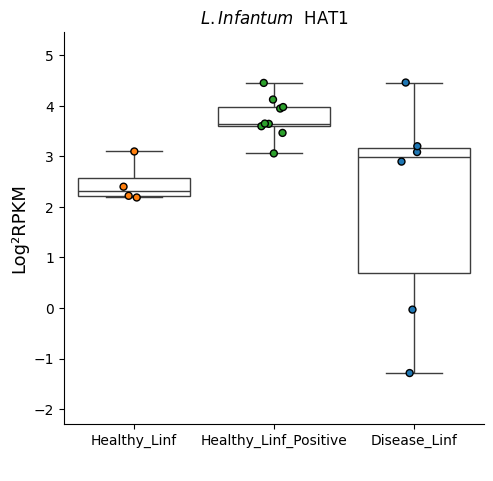

carregando


<Figure size 1000x800 with 0 Axes>

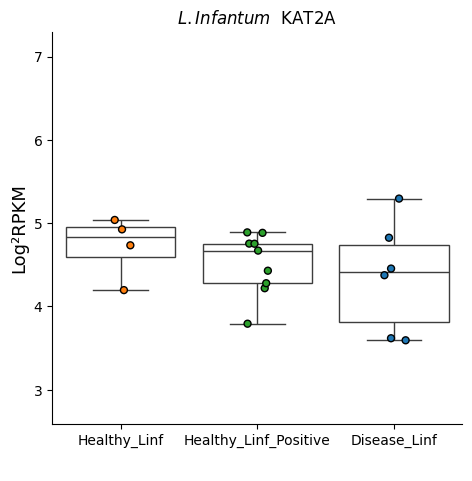

carregando


<Figure size 1000x800 with 0 Axes>

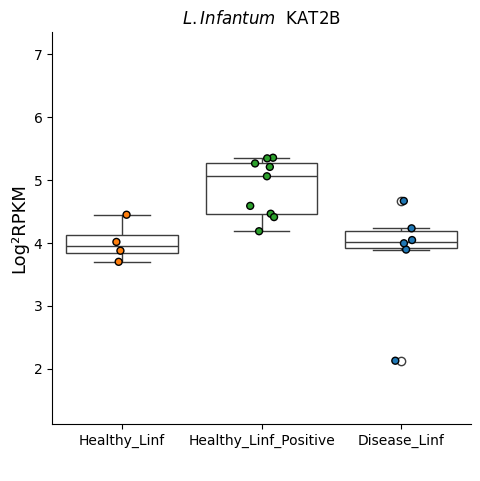

carregando


<Figure size 1000x800 with 0 Axes>

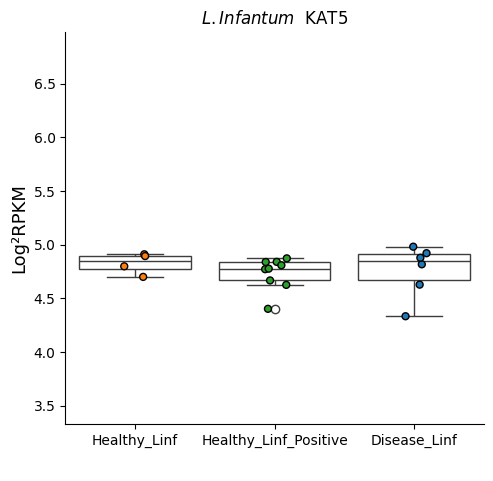

carregando


<Figure size 1000x800 with 0 Axes>

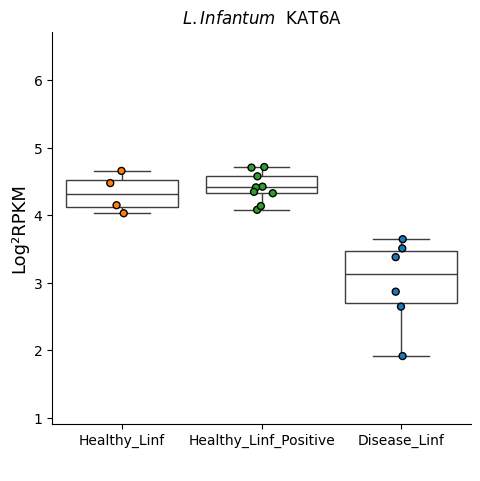

carregando


<Figure size 1000x800 with 0 Axes>

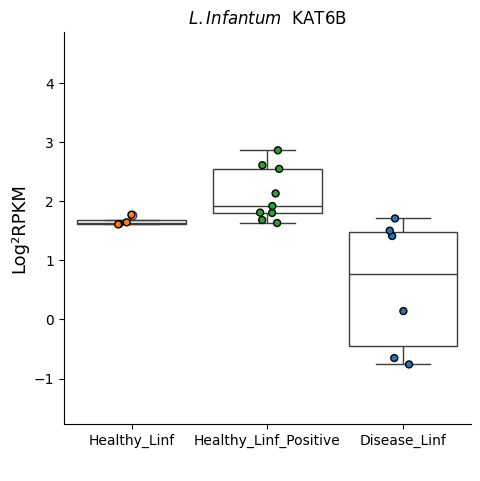

carregando


<Figure size 1000x800 with 0 Axes>

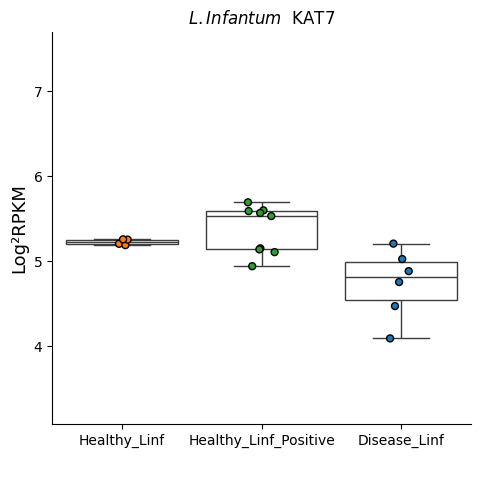

carregando


<Figure size 1000x800 with 0 Axes>

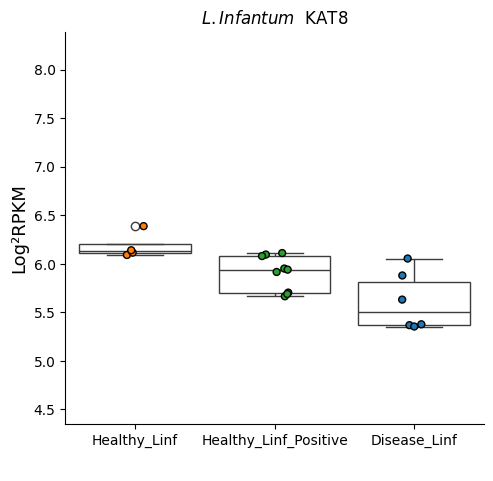

carregando


<Figure size 1000x800 with 0 Axes>

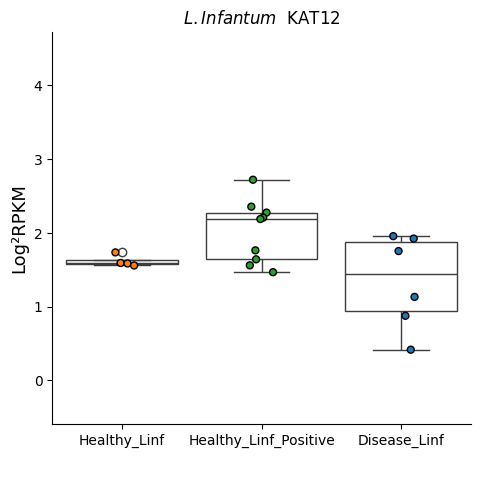

carregando


<Figure size 1000x800 with 0 Axes>

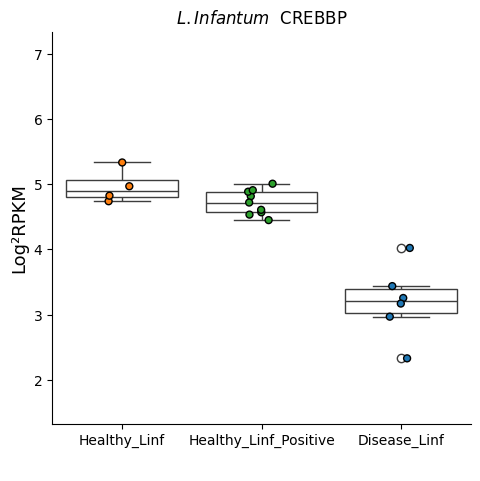

carregando


<Figure size 1000x800 with 0 Axes>

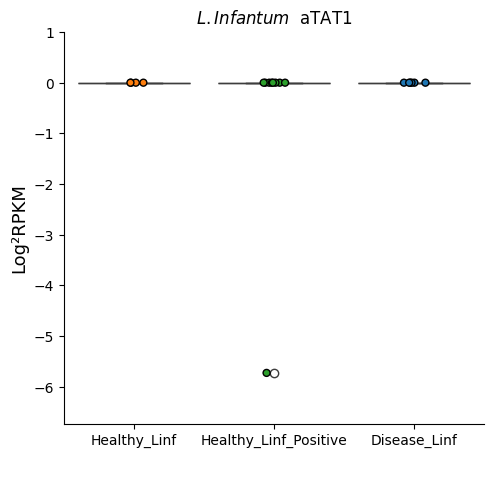

carregando


<Figure size 1000x800 with 0 Axes>

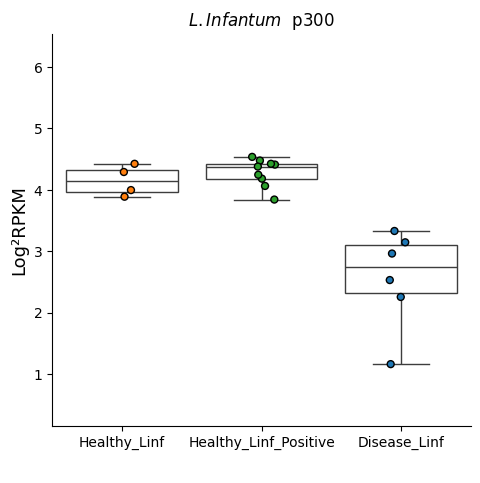

carregando


<Figure size 1000x800 with 0 Axes>

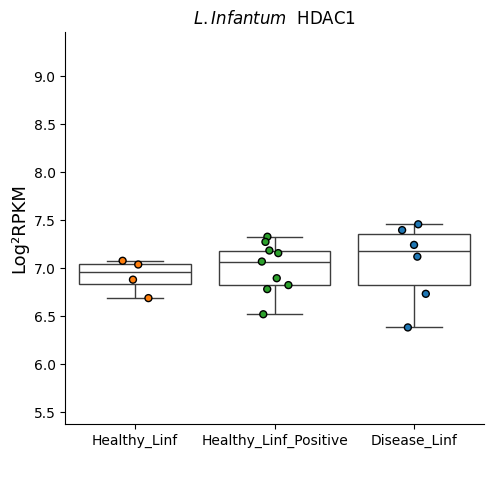

carregando


<Figure size 1000x800 with 0 Axes>

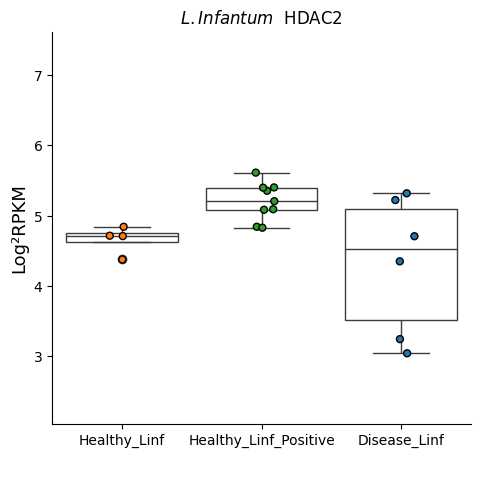

carregando


<Figure size 1000x800 with 0 Axes>

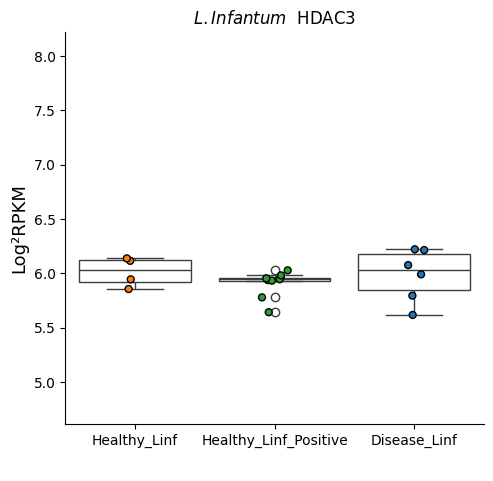

carregando


<Figure size 1000x800 with 0 Axes>

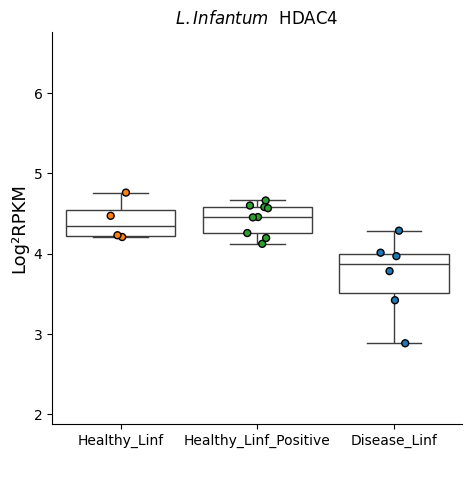

carregando


<Figure size 1000x800 with 0 Axes>

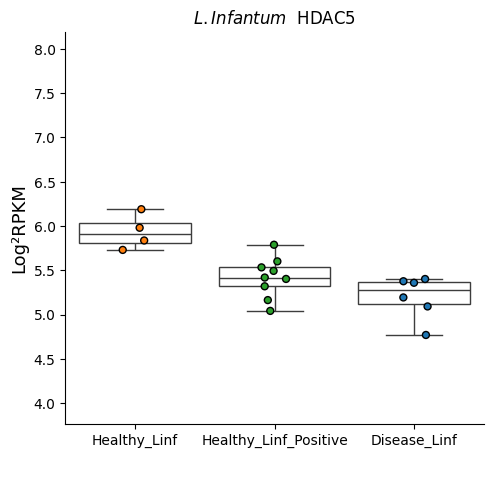

carregando


<Figure size 1000x800 with 0 Axes>

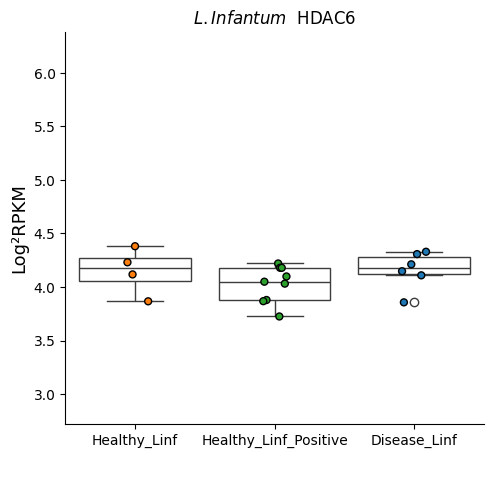

carregando


<Figure size 1000x800 with 0 Axes>

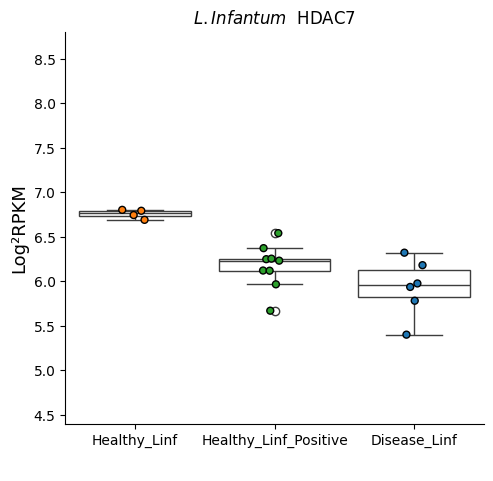

carregando


<Figure size 1000x800 with 0 Axes>

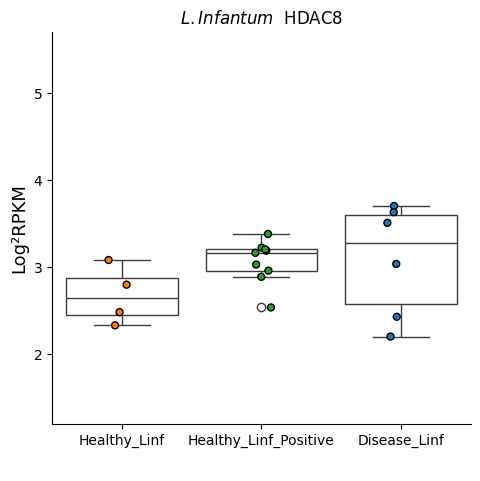

carregando


<Figure size 1000x800 with 0 Axes>

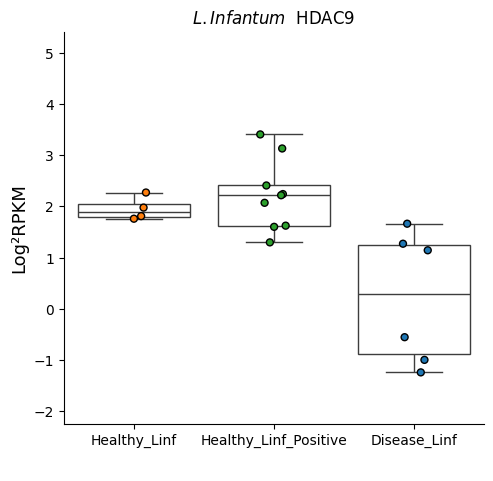

carregando


<Figure size 1000x800 with 0 Axes>

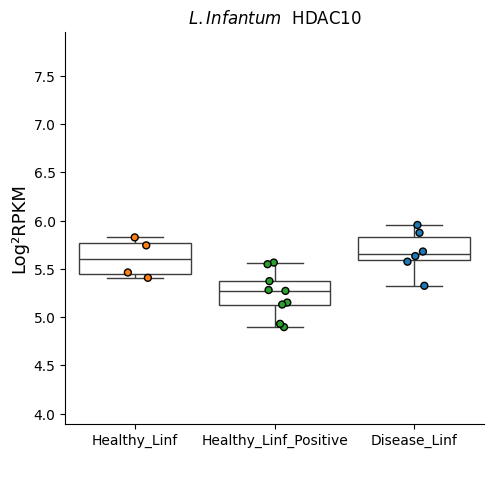

carregando


<Figure size 1000x800 with 0 Axes>

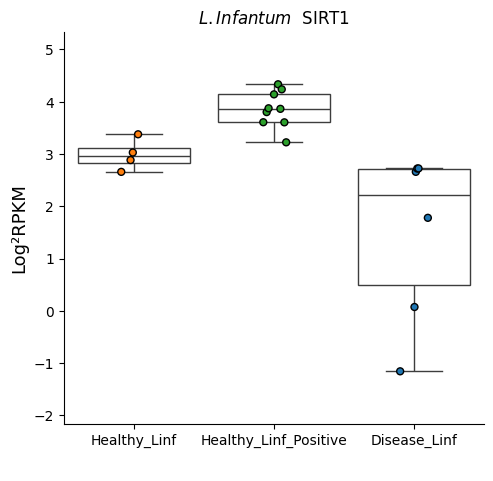

carregando


<Figure size 1000x800 with 0 Axes>

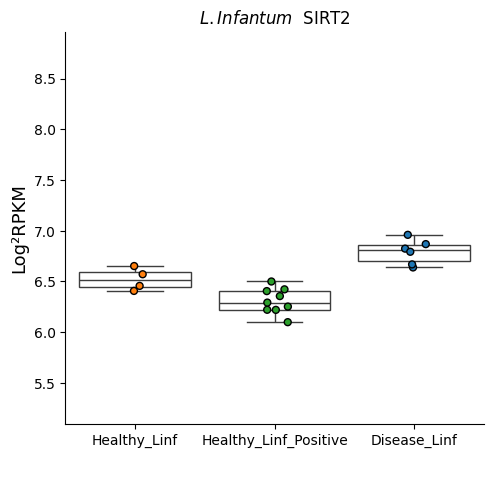

carregando


<Figure size 1000x800 with 0 Axes>

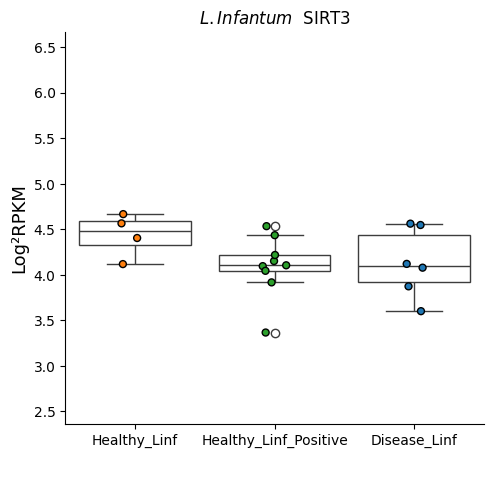

carregando


<Figure size 1000x800 with 0 Axes>

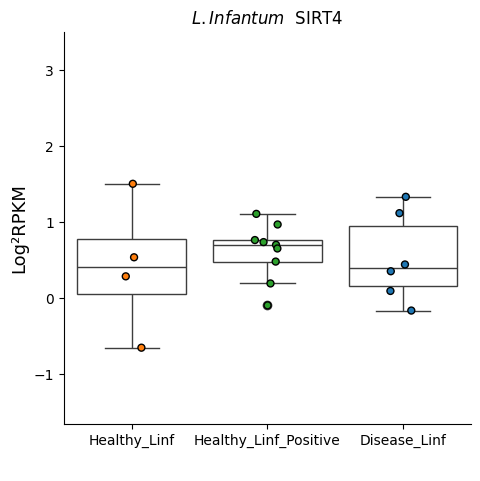

carregando


<Figure size 1000x800 with 0 Axes>

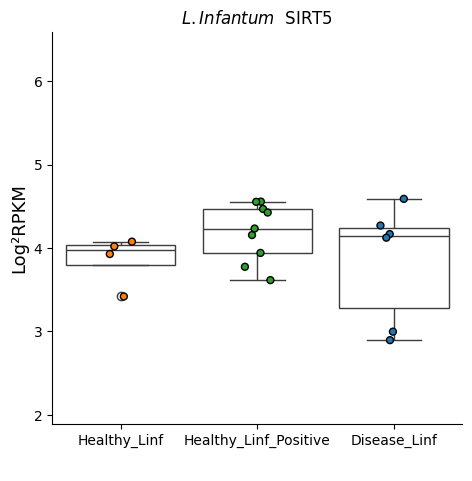

carregando


<Figure size 1000x800 with 0 Axes>

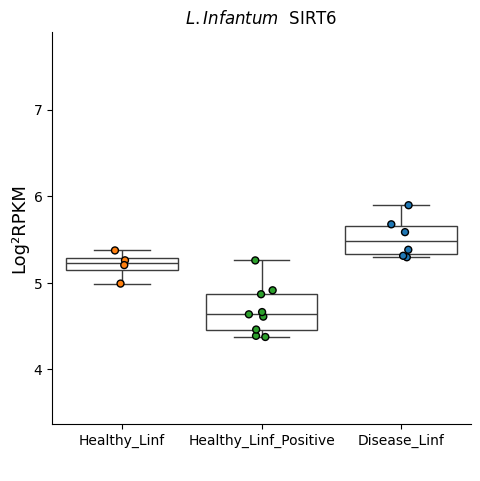

carregando


<Figure size 1000x800 with 0 Axes>

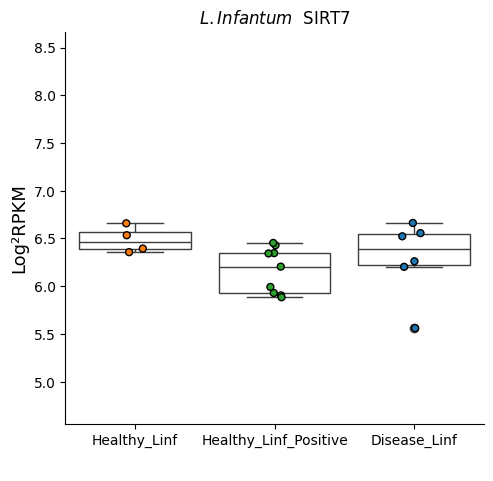

carregando


In [ ]:
graficos_boxplot(PRJEB36928_df_filtrado, "BrBG", "L. Infantum", ['Healthy_Linf', 'Healthy_Linf_Positive','Disease_Linf' ])


##PRJNA290995 ✅⚠️

In [ ]:
id_gene_pasta="PRJNA290995"
PRJNA290995_tab = pd.read_excel(PRJNA290995 )
PRJNA290995_tab.head()

,Nome,Lama_Infected_24h_R1_SRR2156274,Lama_Infected_24h_R2_SRR2163242,Lama_Infected_24h_R3_SRR2163283,Lama_Infected_48h_R1_SRR2156856,Lama_Infected_48h_R2_SRR2163272,Lama_Infected_48h_R3_SRR2163289,Lama_Infected_4h_R1_SRR2156271,Lama_Infected_4h_R2_SRR2163237,Lama_Infected_4h_R3_SRR2163279,...,Lmj_Uninfected_24h_R3_SRR2156106,Lmj_Uninfected_48h_R1_SRR2155075,Lmj_Uninfected_48h_R2_SRR2155161,Lmj_Uninfected_48h_R3_SRR2156108,Lmj_Uninfected_4h_R1_SRR2155070,Lmj_Uninfected_4h_R2_SRR2155101,Lmj_Uninfected_4h_R3_SRR2155165,Lmj_Uninfected_72h_R1_SRR2155082,Lmj_Uninfected_72h_R2_SRR2155163,Lmj_Uninfected_72h_R3_SRR2156110
0,YTHDF1,4.786970,5.018997,4.845101,4.998841,4.909372,4.877132,4.318083,5.333188,4.775170,...,4.827598,4.808341,4.745160,4.707940,5.038853,4.771240,5.055206,4.756757,4.653161,4.710209
1,YTHDF2,5.172648,5.499894,5.350962,5.487303,5.455480,5.362321,4.896659,5.399034,5.136276,...,5.233520,5.212702,5.087936,5.073899,5.249746,5.202642,5.327045,5.184206,5.048682,5.120340
2,YTHDF3,6.114749,5.755357,5.976349,6.481777,5.891765,6.239192,6.330472,6.595073,6.179396,...,6.053884,5.953639,5.990009,6.158381,5.899957,5.669412,6.102161,6.144187,6.150825,6.059397
3,YTHDC1,-5.433106,-3.643375,-4.795506,-3.479019,-6.488035,-4.668170,0.000000,-3.534949,-4.374831,...,-4.985542,-3.355058,-5.043273,-3.949795,-4.427500,-4.247517,0.176429,-5.019429,-5.381179,-5.383407
4,FTO,3.453639,3.820026,4.070925,3.488726,3.928550,4.268142,3.366164,2.869776,2.510451,...,3.882667,3.710095,3.969368,3.723624,3.389294,3.455771,3.627230,3.670279,3.955264,3.606961


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
PRJNA290995_df_filtrado = PRJNA290995_tab[PRJNA290995_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
PRJNA290995_df_filtrado.index = PRJNA290995_df_filtrado["Nome"]


In [ ]:
PRJNA290995_df_filtrado = PRJNA290995_df_filtrado.T

In [ ]:
PRJNA290995_df_filtrado = PRJNA290995_df_filtrado.iloc[1:]

In [ ]:
PRJNA290995_df_filtrado.index.to_list()

['Lama_Infected_24h_R1_SRR2156274',
 'Lama_Infected_24h_R2_SRR2163242',
 'Lama_Infected_24h_R3_SRR2163283',
 'Lama_Infected_48h_R1_SRR2156856',
 'Lama_Infected_48h_R2_SRR2163272',
 'Lama_Infected_48h_R3_SRR2163289',
 'Lama_Infected_4h_R1_SRR2156271',
 'Lama_Infected_4h_R2_SRR2163237',
 'Lama_Infected_4h_R3_SRR2163279',
 'Lama_Infected_72h_R1_SRR2156860',
 'Lama_Infected_72h_R2_SRR2163276',
 'Lama_Infected_72h_R3_SRR2163299',
 'Lama_Uninfected_24h_R1_SRR2156273',
 'Lama_Uninfected_24h_R2_SRR2163240',
 'Lama_Uninfected_24h_R3_SRR2163282',
 'Lama_Uninfected_48h_R1_SRR2156855',
 'Lama_Uninfected_48h_R2_SRR2163270',
 'Lama_Uninfected_48h_R3_SRR2163287',
 'Lama_Uninfected_4h_R1_SRR2156271',
 'Lama_Uninfected_4h_R2_SRR2156863',
 'Lama_Uninfected_4h_R3_SRR2163278',
 'Lama_Uninfected_72h_R1_SRR2156859',
 'Lama_Uninfected_72h_R2_SRR2163275',
 'Lama_Uninfected_72h_R3_SRR2163292 ',
 'Lmj_Infected_24h_R1_SRR2155074',
 'Lmj_Infected_24h_R2_SRR2155160',
 'Lmj_Infected_24h_R3_SRR2156107',
 'Lmj_Infect

In [ ]:
PRJNA290995_df_filtrado["Status"] =['Lama_Infected_24h',
 'Lama_Infected_24h',
 'Lama_Infected_24h',
 'Lama_Infected_48h',
 'Lama_Infected_48h',
 'Lama_Infected_48h',
 'Lama_Infected_4h',
 'Lama_Infected_4h',
 'Lama_Infected_4h',
 'Lama_Infected_72h',
 'Lama_Infected_72h',
 'Lama_Infected_72h',
 'Lama_Uninfected_24h',
 'Lama_Uninfected_24h',
 'Lama_Uninfected_24h',
 'Lama_Uninfected_48h',
 'Lama_Uninfected_48h',
 'Lama_Uninfected_48h',
 'Lama_Uninfected_4h',
 'Lama_Uninfected_4h',
 'Lama_Uninfected_4h',
 'Lama_Uninfected_72h',
 'Lama_Uninfected_72h',
 'Lama_Uninfected_72h',
 'Lmj_Infected_24h',
 'Lmj_Infected_24h',
 'Lmj_Infected_24h',
 'Lmj_Infected_48h',
 'Lmj_Infected_48h',
 'Lmj_Infected_48h',
 'Lmj_Infected_4h',
 'Lmj_Infected_4h',
 'Lmj_Infected_4h',
 'Lmj_Infected_72h',
 'Lmj_Infected_72h',
 'Lmj_Infected_72h',
 'Lmj_Uninfected_24h',
 'Lmj_Uninfected_24h',
 'Lmj_Uninfected_24h',
 'Lmj_Uninfected_48h',
 'Lmj_Uninfected_48h',
 'Lmj_Uninfected_48h',
 'Lmj_Uninfected_4h',
 'Lmj_Uninfected_4h',
 'Lmj_Uninfected_4h',
 'Lmj_Uninfected_72h',
 'Lmj_Uninfected_72h',
 'Lmj_Uninfected_72h']


In [ ]:
list(set(PRJNA290995_df_filtrado["Status"]))


['Lama_Infected_72h',
 'Lama_Uninfected_72h',
 'Lmj_Infected_72h',
 'Lama_Uninfected_48h',
 'Lama_Uninfected_24h',
 'Lama_Infected_24h',
 'Lmj_Infected_4h',
 'Lmj_Uninfected_24h',
 'Lama_Uninfected_4h',
 'Lama_Infected_48h',
 'Lmj_Infected_48h',
 'Lmj_Uninfected_72h',
 'Lmj_Uninfected_48h',
 'Lmj_Infected_24h',
 'Lmj_Uninfected_4h',
 'Lama_Infected_4h']

In [ ]:
# Filtrando as linhas para Uninfected_Mouse e Infected_Mouse_Lama
subset_PRJNA290995_df_Lama = PRJNA290995_df_filtrado[(PRJNA290995_df_filtrado['Status'] == 'Lama_Uninfected_4h') | (PRJNA290995_df_filtrado['Status'] == 'Lama_Uninfected_24h') |
 (PRJNA290995_df_filtrado['Status'] == 'Lama_Uninfected_48h') | (PRJNA290995_df_filtrado['Status'] == 'Lama_Uninfected_72h') |
  (PRJNA290995_df_filtrado['Status'] == 'Lama_Infected_4h') | (PRJNA290995_df_filtrado['Status'] == 'Lama_Infected_24h') |
   (PRJNA290995_df_filtrado['Status'] == 'Lama_Infected_48h') | (PRJNA290995_df_filtrado['Status'] == 'Lama_Infected_72h')]
subset_PRJNA290995_df_Lama.iloc[[1,-1],:]

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7,Status
Lama_Infected_24h_R2_SRR2163242,5.445561,2.778104,3.599652,4.531682,2.804926,1.197895,4.102887,4.753388,2.952261,3.369315,...,2.60838,3.882962,3.660341,5.819332,3.28306,-2.019751,3.053969,4.377371,5.106719,Lama_Infected_24h
Lama_Uninfected_72h_R3_SRR2163292,4.904097,2.099734,4.11617,4.237208,3.232726,2.376259,4.266772,4.27565,2.974136,3.749481,...,-0.014015,3.736292,4.359003,6.314951,3.630944,-1.529936,3.239568,3.635931,4.265744,Lama_Uninfected_72h


In [ ]:
#############################################################
infected_data = subset_PRJNA290995_df_Lama[subset_PRJNA290995_df_Lama['Status'] == 'Lama_Infected_72h']
uninfected_data = subset_PRJNA290995_df_Lama[subset_PRJNA290995_df_Lama['Status'] == 'Lama_Uninfected_72h']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,-0.076341,-7.991291e-08,0.083513,0.120779,0.706732,-0.664336,-0.218352,-0.414482,-0.108256,-0.411454,...,0.124064,2.434196,-0.910187,-0.947166,-0.073602,-0.904942,0.038019,-0.491942,-0.048347,-7.991291e-08


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Lama_PRJNA290995"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA290995/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,UP,Down,Normal,Normal,Normal,Normal,...,Normal,UP,Down,Down,Normal,Down,Normal,Normal,Normal,Normal


In [ ]:
# def graficos_boxplot(tabela, paleta, especie, ordem, nome):
#     for i in tabela:
#         if "Status" in i or "Patient" in i or "tret" in i:
#             continue

#         plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
#         # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
#         ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

#         sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
#                     showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

#         # plt.xticks(rotation=45)

#         plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

#         if max(tabela[i]) - min(tabela[i]) < 5:
#             plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

#         # Ajustando o título para evitar cortes
#         ax.set(title=f'${especie}$  ' + i)
#         ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
#         # ax.fig.subplots_adjust(bottom=0.25)

#         plt.xlabel(' ', fontdict={'size': 13})
#         plt.ylabel('Log²RPKM', fontdict={'size': 13})

#         plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

#         plt.show()

#         print("carregando")
#         # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,UP,Down,Normal,Normal,Normal,Normal,...,Normal,UP,Down,Down,Normal,Down,Normal,Normal,Normal,Normal


In [ ]:
# Filtrando as linhas para Uninfected_Mouse e Infected_Mouse_Lmj
subset_PRJNA290995_df_Lmj = PRJNA290995_df_filtrado[(PRJNA290995_df_filtrado['Status'] == 'Lmj_Uninfected_4h') | (PRJNA290995_df_filtrado['Status'] == 'Lmj_Uninfected_24h') |
 (PRJNA290995_df_filtrado['Status'] == 'Lmj_Uninfected_48h') | (PRJNA290995_df_filtrado['Status'] == 'Lmj_Uninfected_72h') |
  (PRJNA290995_df_filtrado['Status'] == 'Lmj_Infected_4h') | (PRJNA290995_df_filtrado['Status'] == 'Lmj_Infected_24h') |
   (PRJNA290995_df_filtrado['Status'] == 'Lmj_Infected_48h') | (PRJNA290995_df_filtrado['Status'] == 'Lmj_Infected_72h')]
subset_PRJNA290995_df_Lmj.iloc[[1,-1],:]

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7,Status
Lmj_Infected_24h_R2_SRR2155160,5.091906,1.001212,3.533788,5.855316,3.861132,2.256754,4.171788,4.24986,3.518928,4.743879,...,4.240129,2.496838,4.561184,5.790254,1.911293,-3.953512,1.885104,4.159982,4.880632,Lmj_Infected_24h
Lmj_Uninfected_72h_R3_SRR2156110,4.951723,3.096576,4.249161,4.109808,3.16308,1.595032,4.210186,4.535294,2.706426,3.818682,...,1.73695,3.771169,4.109362,6.61196,3.674057,-0.56011,3.08917,4.019342,4.61712,Lmj_Uninfected_72h


In [ ]:
#############################################################
infected_data = subset_PRJNA290995_df_Lmj[subset_PRJNA290995_df_Lmj['Status'] == 'Lmj_Infected_72h']
uninfected_data = subset_PRJNA290995_df_Lmj[subset_PRJNA290995_df_Lmj['Status'] == 'Lmj_Uninfected_72h']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.342441,0.040146,-0.316758,0.032134,-0.207122,0.229965,-0.104197,-0.022388,0.074,-0.078565,...,0.33069,-1.141285,-0.243485,-0.412151,-0.342558,-0.146577,-0.264085,0.208265,0.375346,0.050311


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Lmj_PRJNA290995"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA290995/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,UP,UP,Down,Normal,Normal,Down,Down,UP,Down,...,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Down


In [ ]:
lama = [ 'Lama_Uninfected_4h','Lama_Infected_4h', 'Lama_Uninfected_24h','Lama_Infected_24h', 'Lama_Uninfected_48h', 'Lama_Infected_48h','Lama_Uninfected_72h', 'Lama_Infected_72h']

lmj = [ 'Lmj_Uninfected_4h','Lmj_Infected_4h', 'Lmj_Uninfected_24h','Lmj_Infected_24h', 'Lmj_Uninfected_48h', 'Lmj_Infected_48h','Lmj_Uninfected_72h', 'Lmj_Infected_72h']

In [ ]:
PRJNA290995_df_filtrado.iloc[[1,-1],:]

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7,Status
Lama_Infected_24h_R2_SRR2163242,5.445561,2.778104,3.599652,4.531682,2.804926,1.197895,4.102887,4.753388,2.952261,3.369315,...,2.60838,3.882962,3.660341,5.819332,3.28306,-2.019751,3.053969,4.377371,5.106719,Lama_Infected_24h
Lmj_Uninfected_72h_R3_SRR2156110,4.951723,3.096576,4.249161,4.109808,3.16308,1.595032,4.210186,4.535294,2.706426,3.818682,...,1.73695,3.771169,4.109362,6.61196,3.674057,-0.56011,3.08917,4.019342,4.61712,Lmj_Uninfected_72h


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, caminho="aqui"):
  sns.set_theme(style="ticks", font_scale=0.8)
  sns.set_style("whitegrid")
  for i in tabela:
    if "Status" in i: continue

    plt.figure(figsize=(4,8));
    graficos=sns.catplot(data=tabela,x="Status",y=i,kind="strip",palette=paleta, size=5 ,edgecolor='black',linewidth=1,hue="Status",order=ordem);
    graficos=sns.boxplot(data = tabela,x="Status", y = i, showcaps=True,boxprops={'facecolor':'None'},showfliers=True,whiskerprops={'linewidth':1},hue="Status", order=ordem)
    plt.xticks(rotation=0)
    # graficos.set_axis_labels("Time", "Log²RPKM")

    plt.ylim(min(tabela[i])-1,max(tabela[i])+1)
    if max(tabela[i])-min(tabela[i])<5:
        plt.ylim(min(tabela[i])-1,max(tabela[i])+2)
    titulo = plt.gcf().suptitle(f'${especie}$  '+i, fontsize=14)
    titulo.set_y(1.05)
    graficos = plt.xlabel(' ', fontdict={'size': 13});
    graficos = plt.ylabel('Log²RPKM', fontdict={'size': 13});
    # plt.savefig(f"{caminho}/{i}.png",dpi=200, format='png')
    plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA290995/{especie}{i}.png",dpi=200, format='png')

    plt.show(graficos)
    print("carregando")
    # break


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, caminho="aqui"):
    for i in tabela:
        if "Status" in i:
            continue

        plt.figure(figsize=(12, 8))  # Aumentando o tamanho da figura

        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=5, edgecolor='black',palette=paleta,
                         linewidth=1, hue="Status", order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", order=ordem)

        plt.xticks(rotation=45, ha="right")

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        plt.subplots_adjust(bottom=0.27)
        plt.subplots_adjust(left=0.2)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA290995/{especie}_{i}.png",dpi=200, format='png')
        # plt.savefig("teste.png" ,dpi=200, format='png')

        plt.show()

        print("carregando")
        # break


<Figure size 1200x800 with 0 Axes>

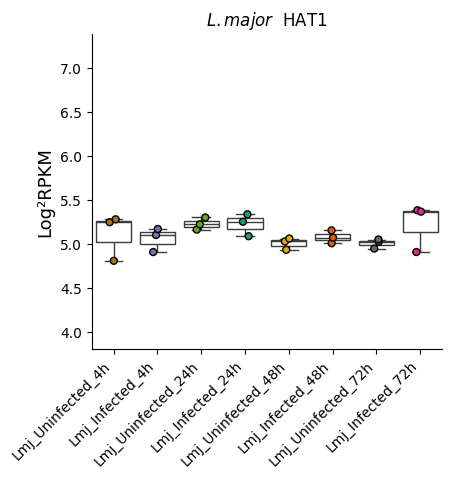

carregando


<Figure size 1200x800 with 0 Axes>

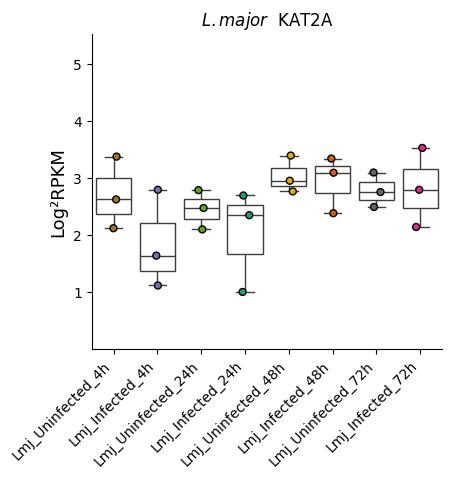

carregando


<Figure size 1200x800 with 0 Axes>

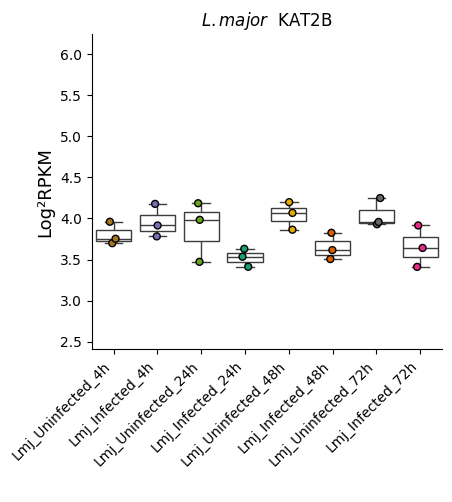

carregando


<Figure size 1200x800 with 0 Axes>

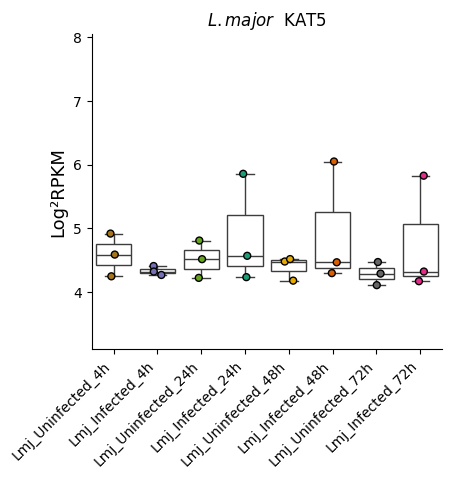

carregando


<Figure size 1200x800 with 0 Axes>

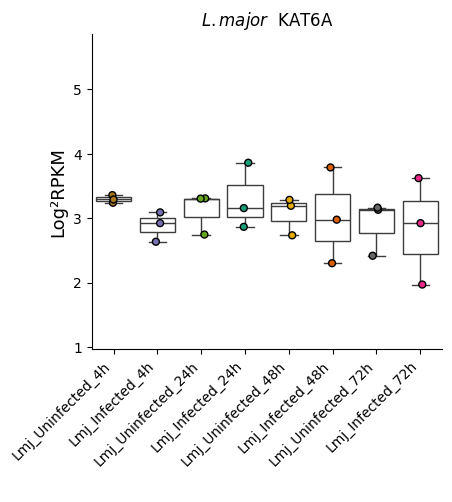

carregando


<Figure size 1200x800 with 0 Axes>

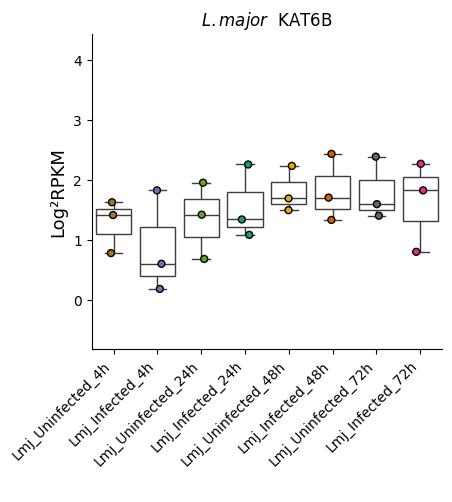

carregando


<Figure size 1200x800 with 0 Axes>

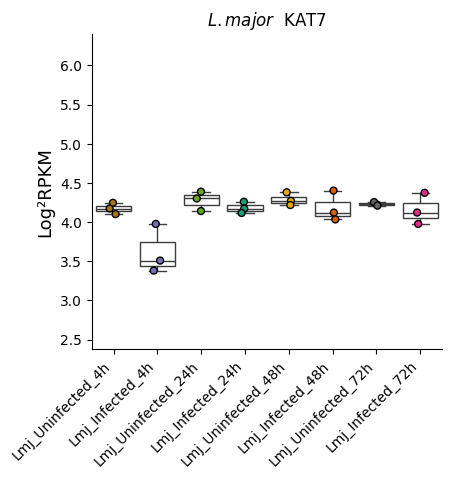

carregando


<Figure size 1200x800 with 0 Axes>

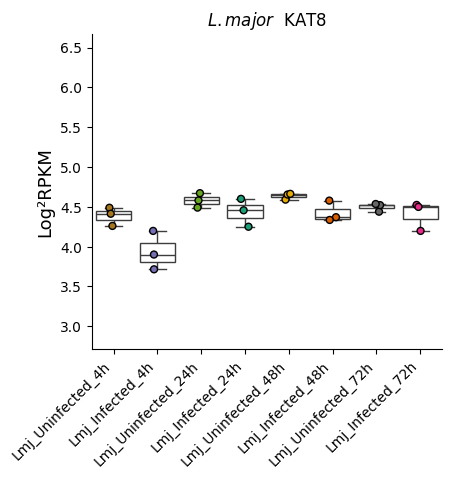

carregando


<Figure size 1200x800 with 0 Axes>

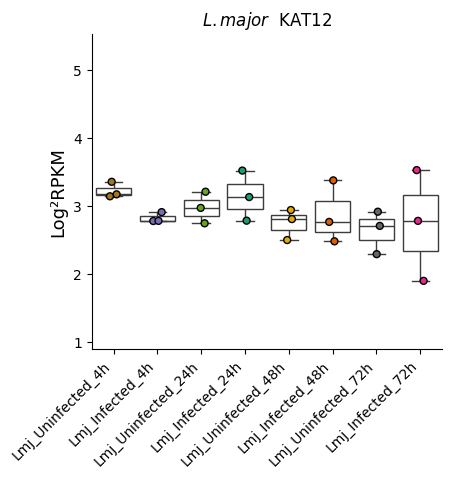

carregando


<Figure size 1200x800 with 0 Axes>

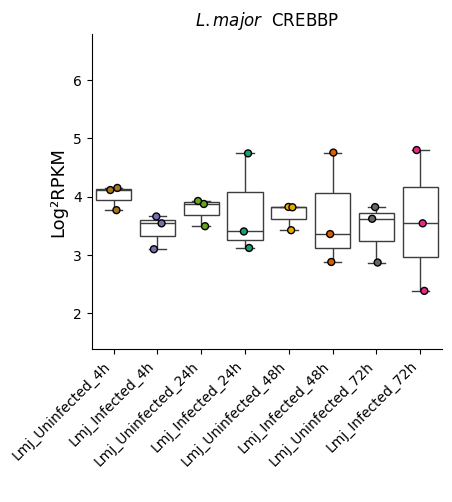

carregando


<Figure size 1200x800 with 0 Axes>

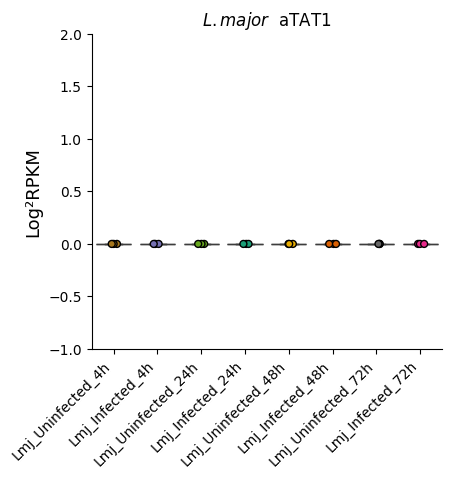

carregando


<Figure size 1200x800 with 0 Axes>

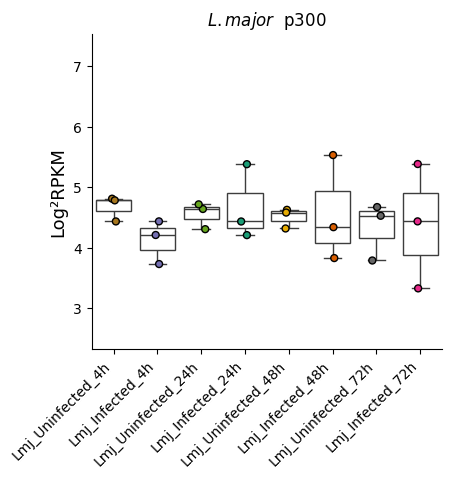

carregando


<Figure size 1200x800 with 0 Axes>

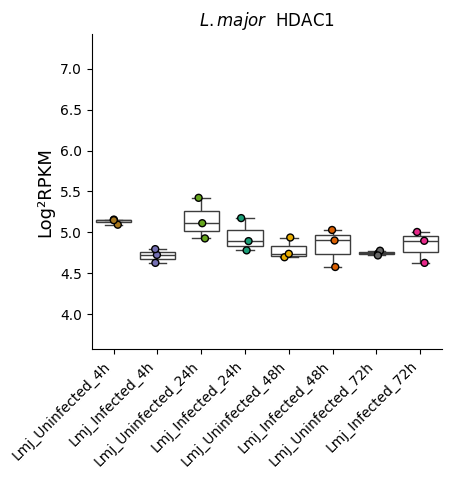

carregando


<Figure size 1200x800 with 0 Axes>

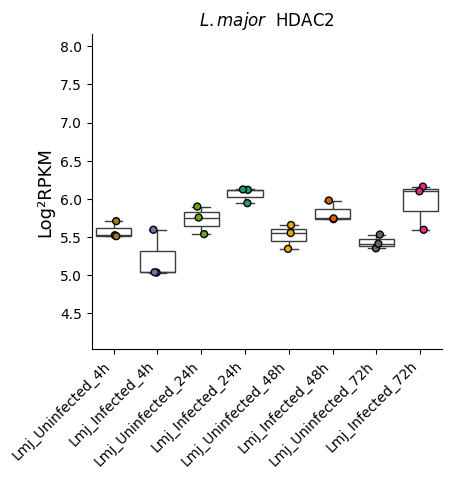

carregando


<Figure size 1200x800 with 0 Axes>

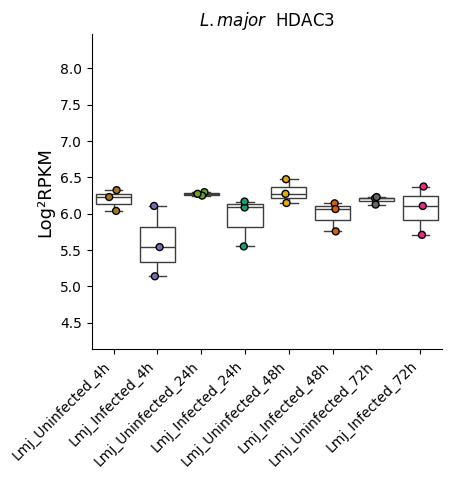

carregando


<Figure size 1200x800 with 0 Axes>

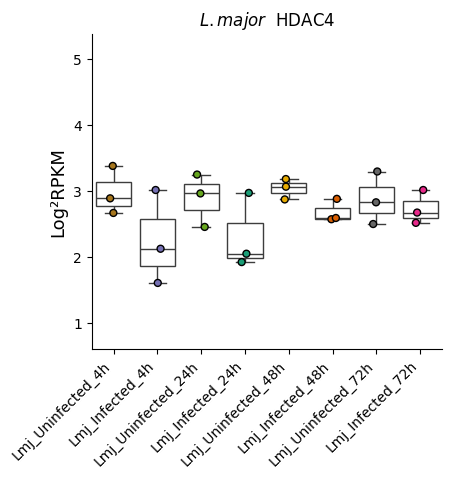

carregando


<Figure size 1200x800 with 0 Axes>

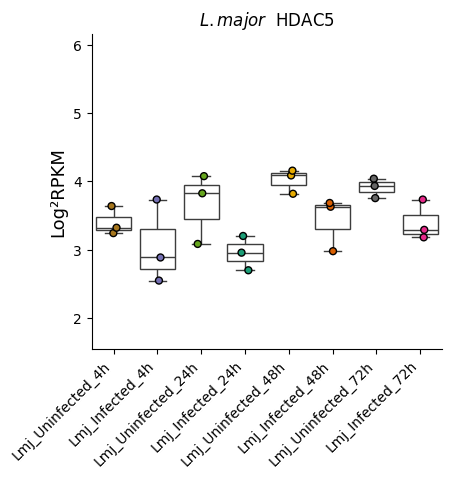

carregando


<Figure size 1200x800 with 0 Axes>

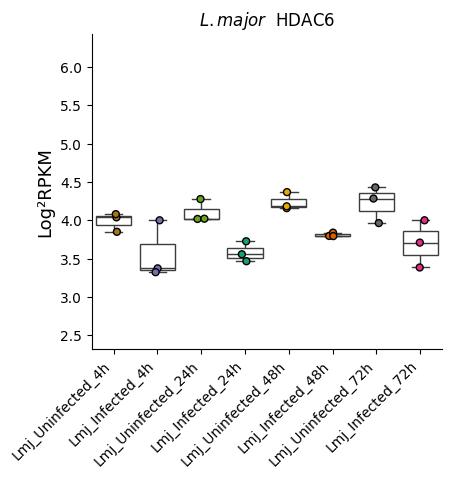

carregando


<Figure size 1200x800 with 0 Axes>

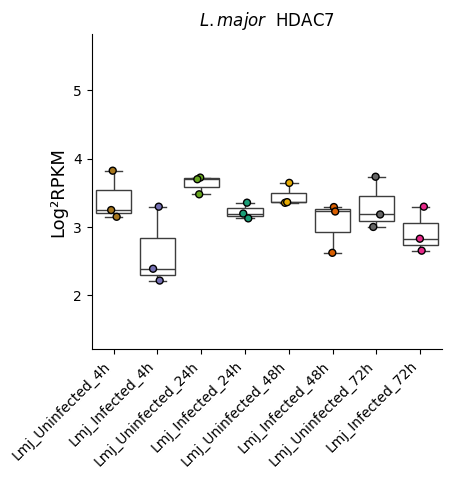

carregando


<Figure size 1200x800 with 0 Axes>

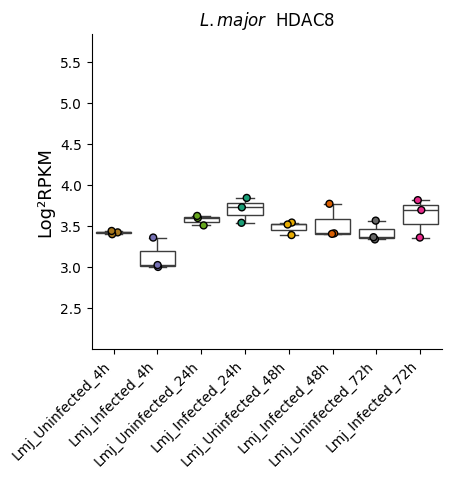

carregando


<Figure size 1200x800 with 0 Axes>

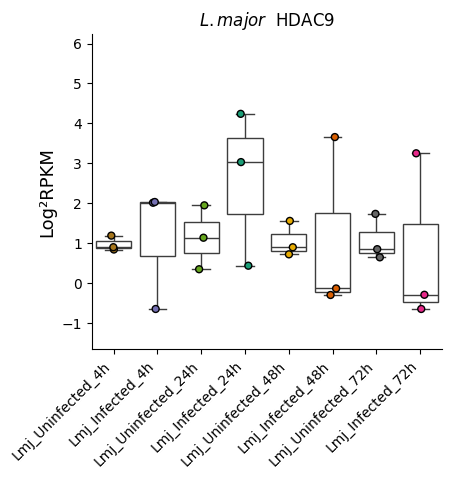

carregando


<Figure size 1200x800 with 0 Axes>

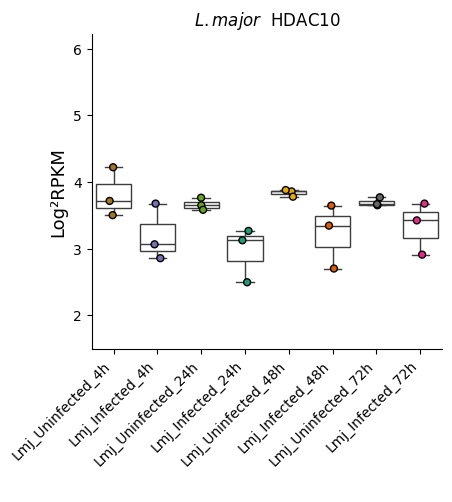

carregando


<Figure size 1200x800 with 0 Axes>

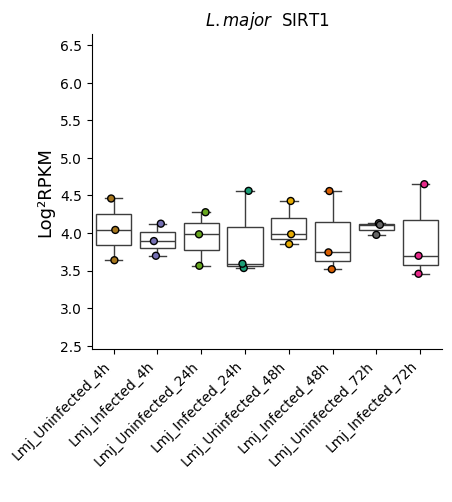

carregando


<Figure size 1200x800 with 0 Axes>

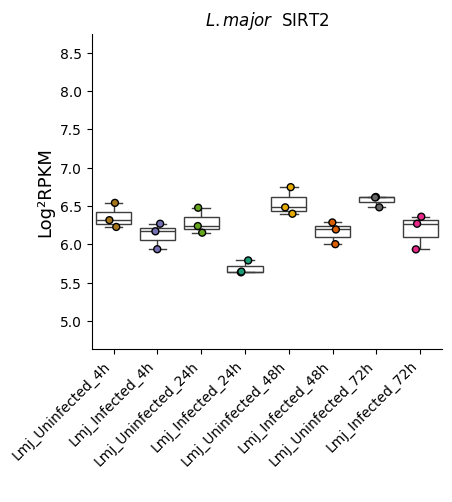

carregando


<Figure size 1200x800 with 0 Axes>

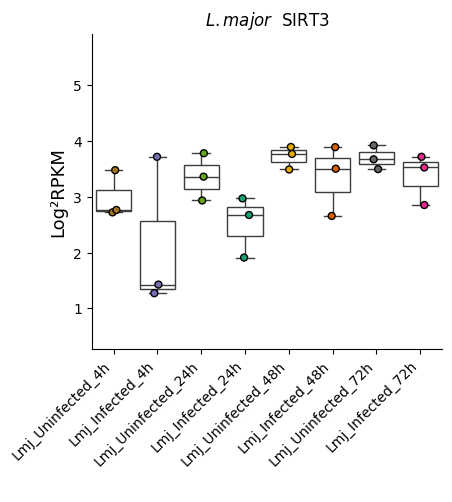

carregando


<Figure size 1200x800 with 0 Axes>

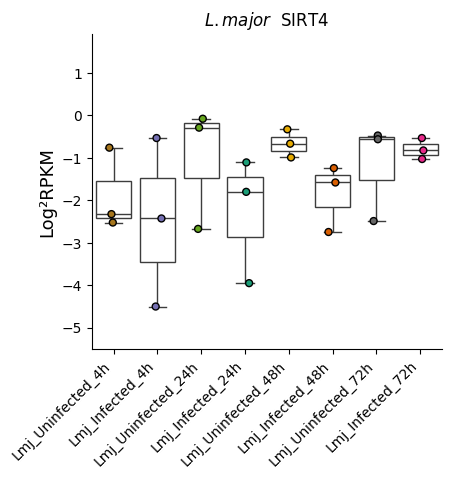

carregando


<Figure size 1200x800 with 0 Axes>

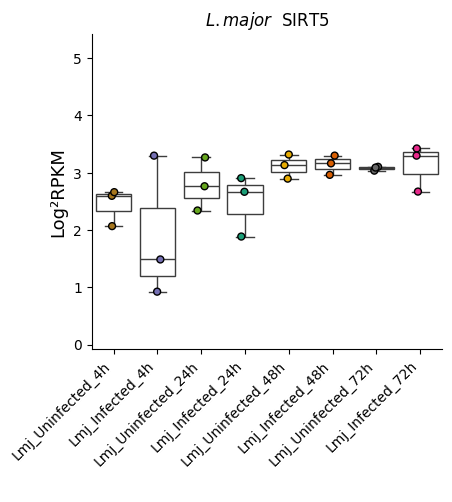

carregando


<Figure size 1200x800 with 0 Axes>

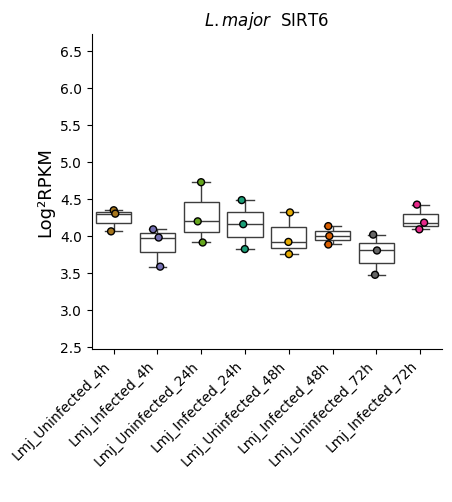

carregando


<Figure size 1200x800 with 0 Axes>

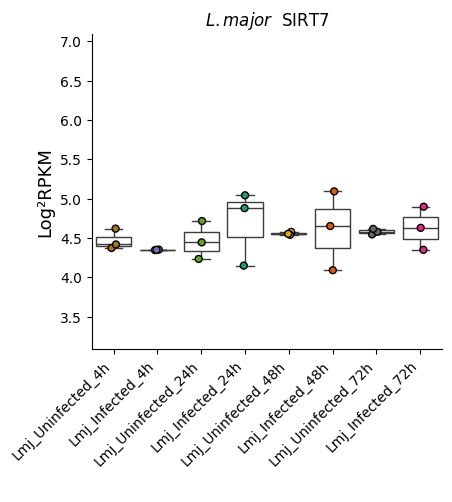

carregando


In [ ]:
graficos_boxplot(subset_PRJNA290995_df_Lmj, "Dark2", "L. major",lmj)


<Figure size 1200x800 with 0 Axes>

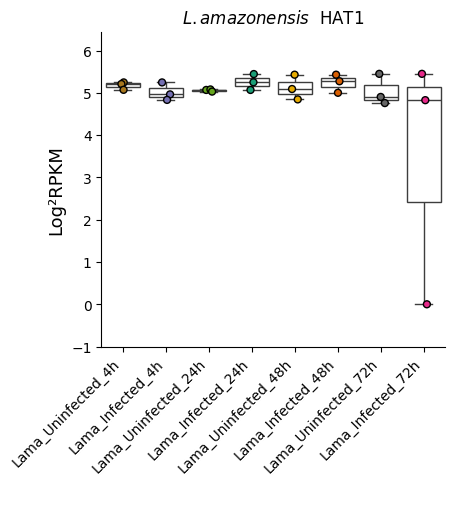

carregando


<Figure size 1200x800 with 0 Axes>

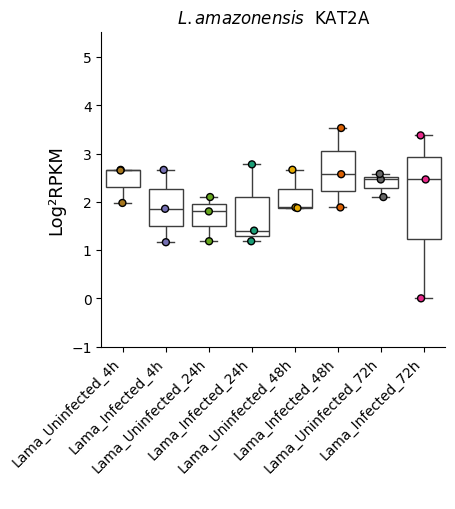

carregando


<Figure size 1200x800 with 0 Axes>

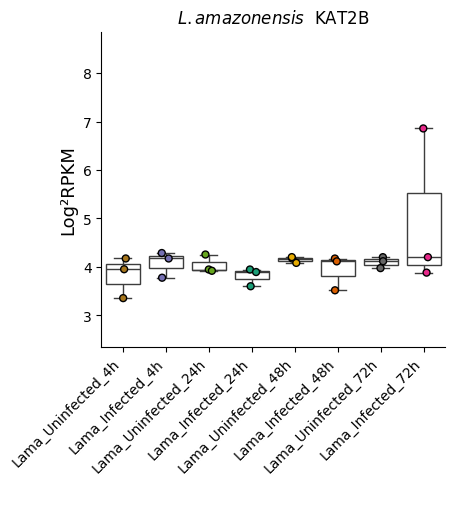

carregando


<Figure size 1200x800 with 0 Axes>

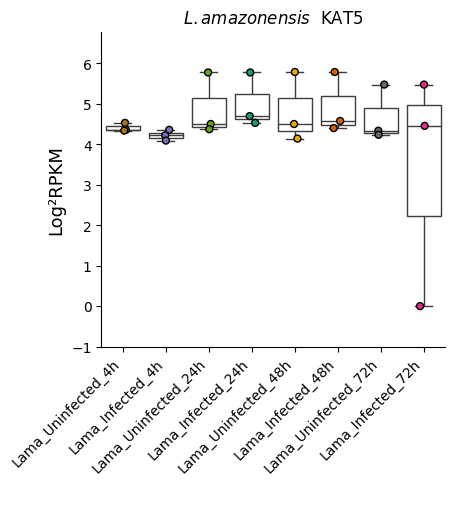

carregando


<Figure size 1200x800 with 0 Axes>

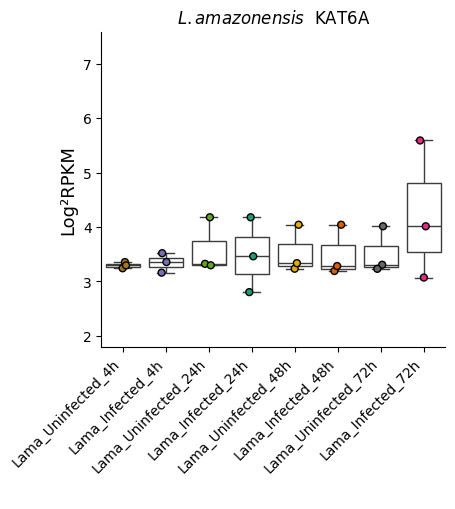

carregando


<Figure size 1200x800 with 0 Axes>

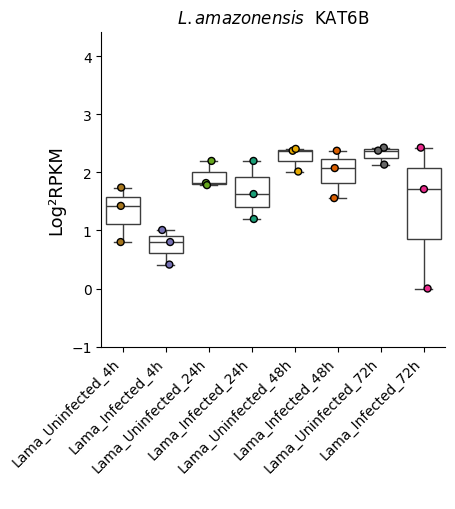

carregando


<Figure size 1200x800 with 0 Axes>

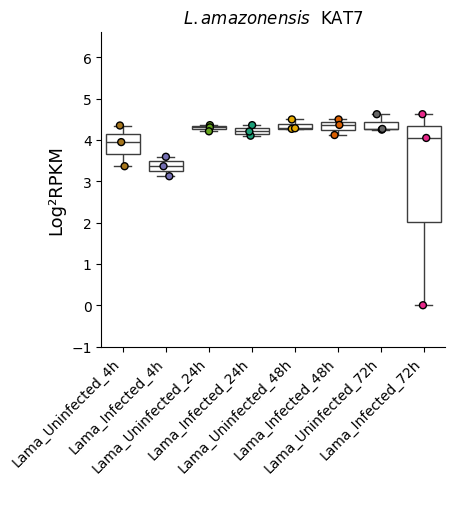

carregando


<Figure size 1200x800 with 0 Axes>

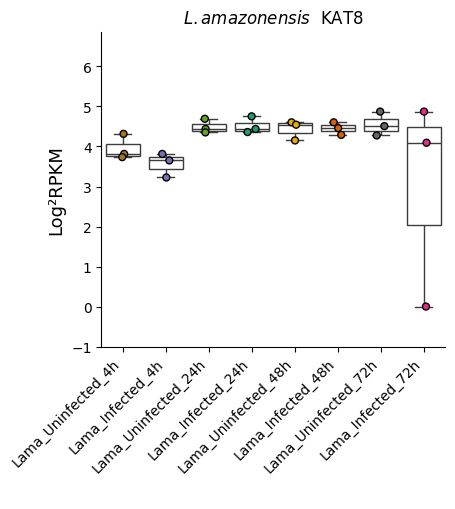

carregando


<Figure size 1200x800 with 0 Axes>

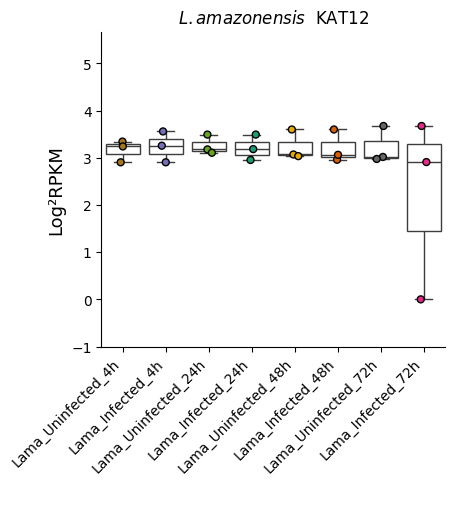

carregando


<Figure size 1200x800 with 0 Axes>

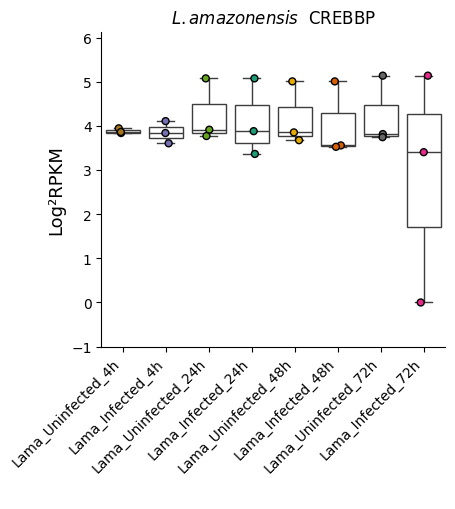

carregando


<Figure size 1200x800 with 0 Axes>

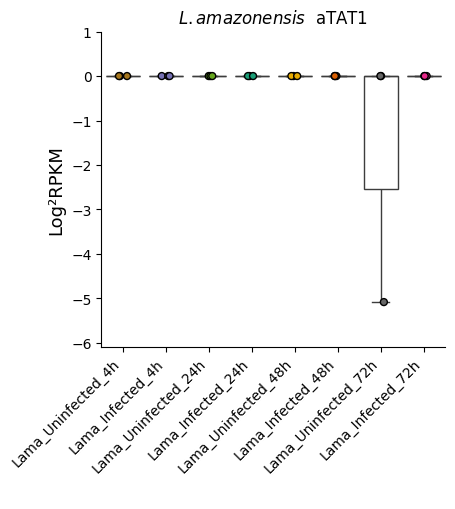

carregando


<Figure size 1200x800 with 0 Axes>

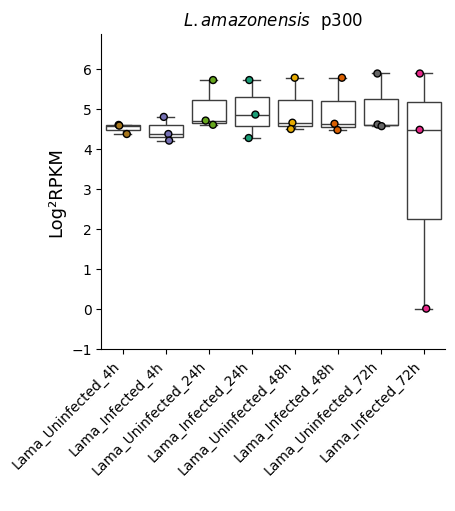

carregando


<Figure size 1200x800 with 0 Axes>

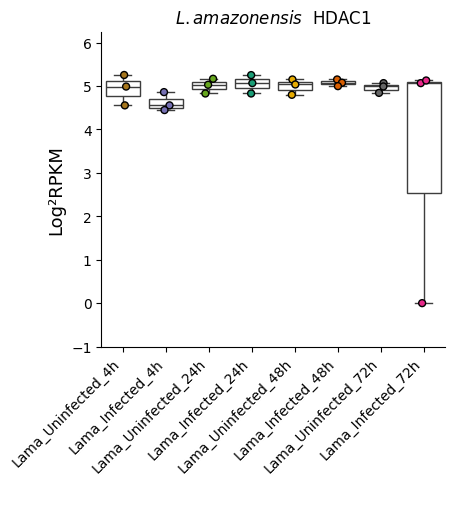

carregando


<Figure size 1200x800 with 0 Axes>

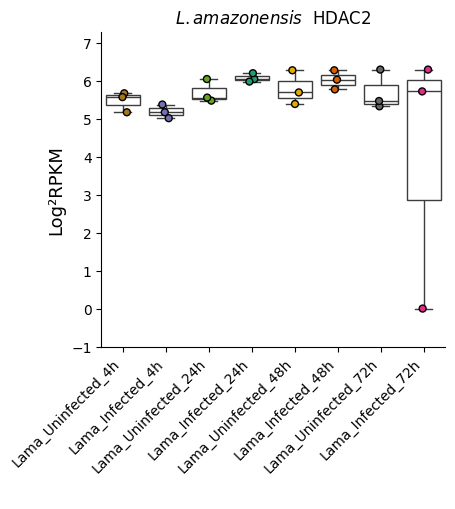

carregando


<Figure size 1200x800 with 0 Axes>

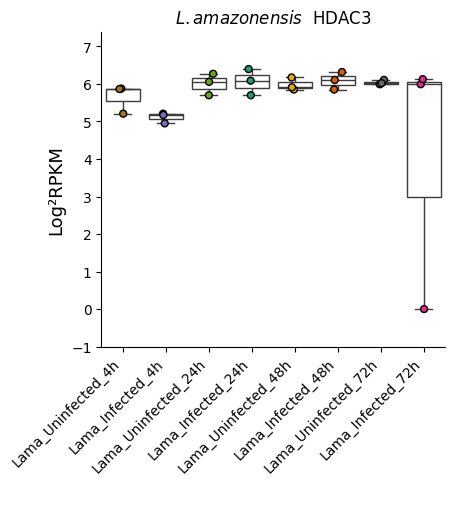

carregando


<Figure size 1200x800 with 0 Axes>

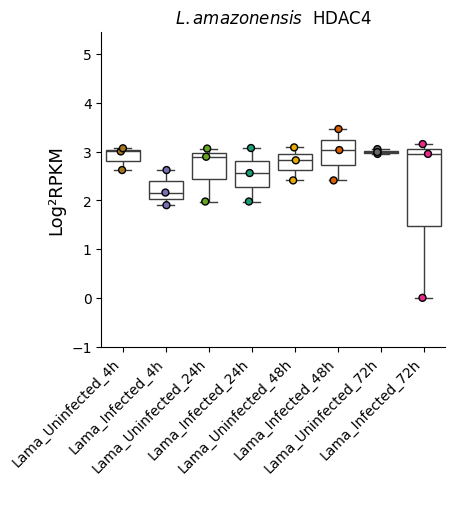

carregando


<Figure size 1200x800 with 0 Axes>

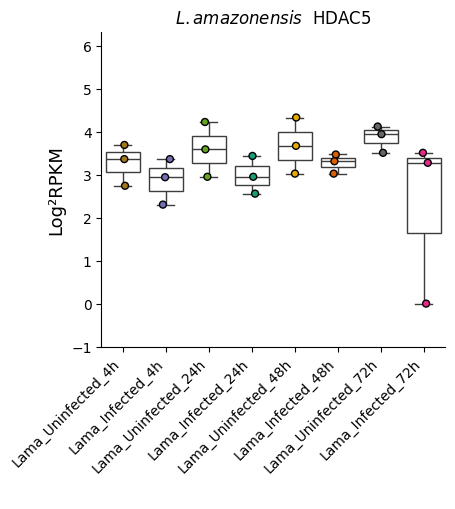

carregando


<Figure size 1200x800 with 0 Axes>

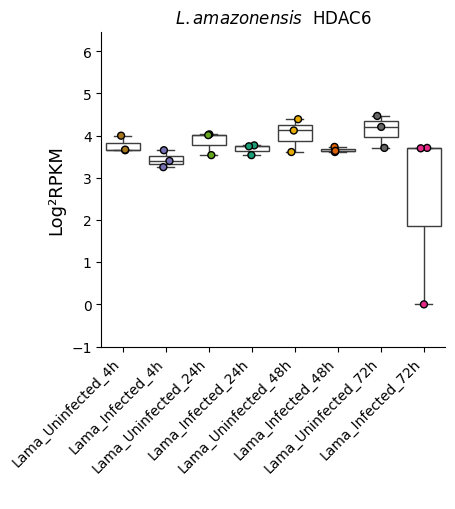

carregando


<Figure size 1200x800 with 0 Axes>

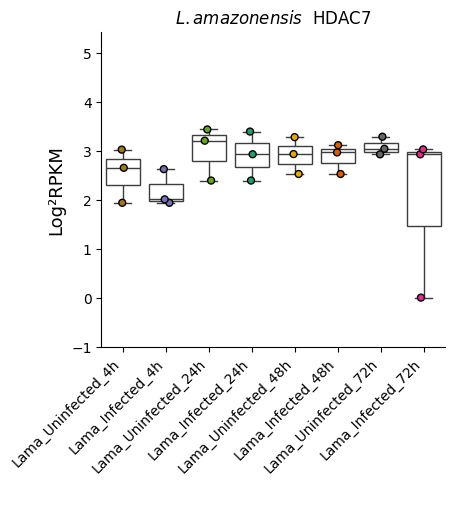

carregando


<Figure size 1200x800 with 0 Axes>

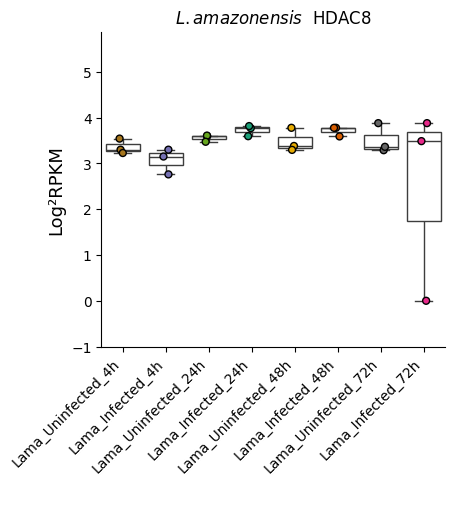

carregando


<Figure size 1200x800 with 0 Axes>

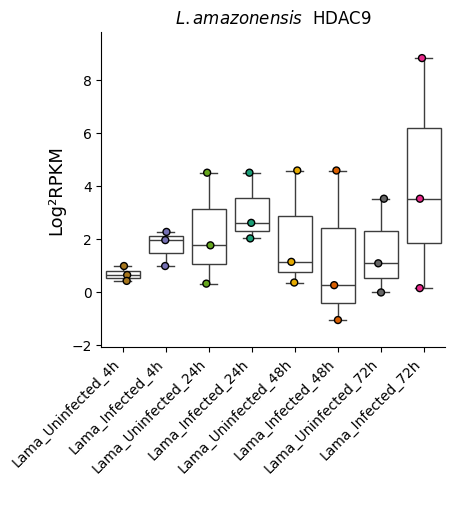

carregando


<Figure size 1200x800 with 0 Axes>

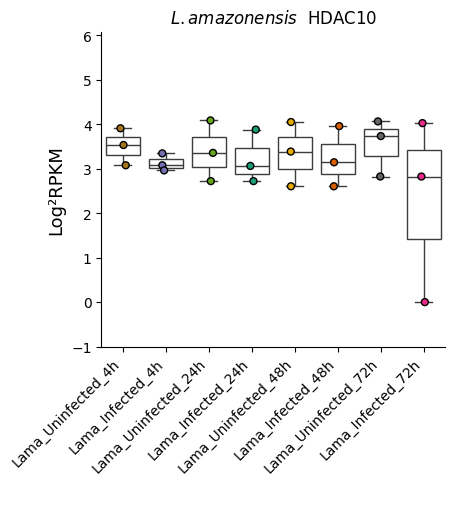

carregando


<Figure size 1200x800 with 0 Axes>

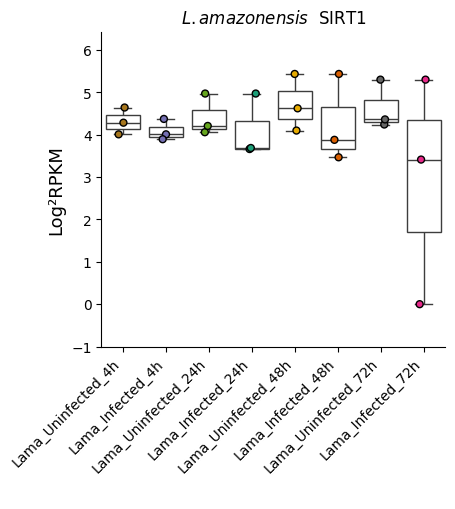

carregando


<Figure size 1200x800 with 0 Axes>

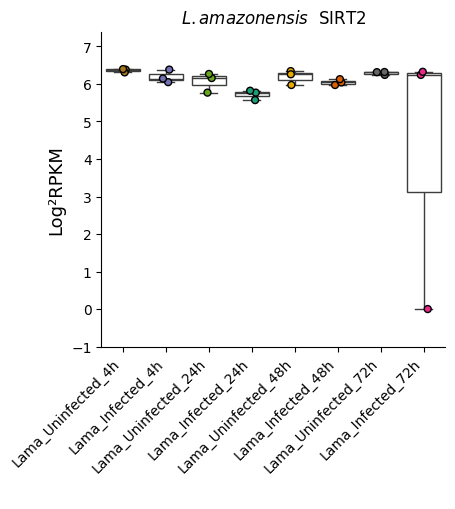

carregando


<Figure size 1200x800 with 0 Axes>

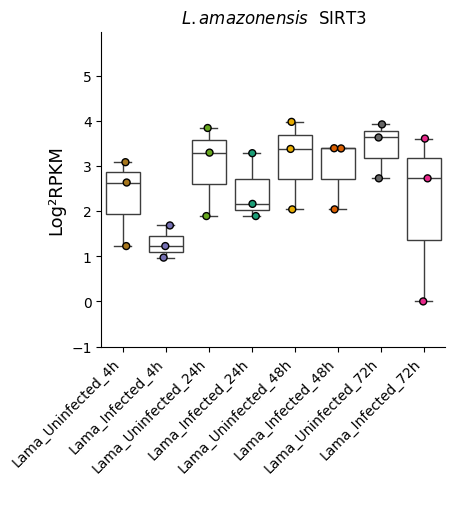

carregando


<Figure size 1200x800 with 0 Axes>

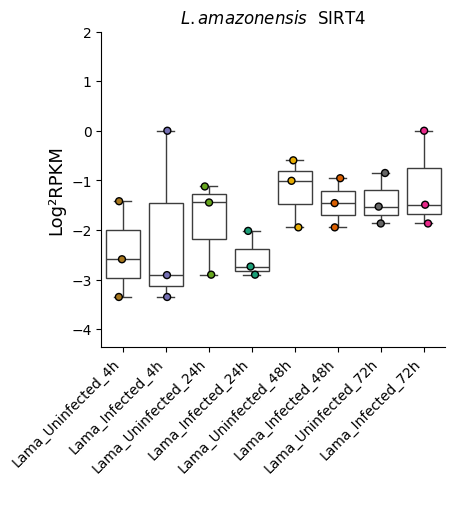

carregando


<Figure size 1200x800 with 0 Axes>

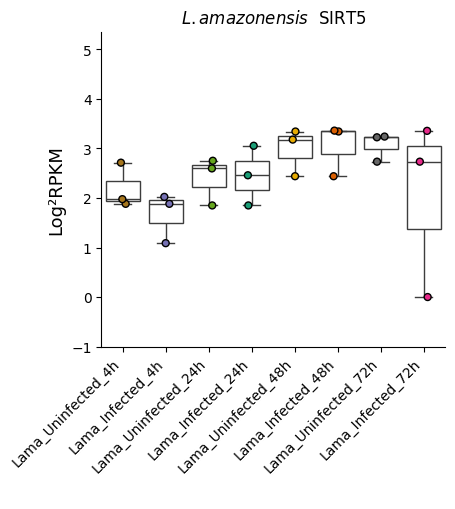

carregando


<Figure size 1200x800 with 0 Axes>

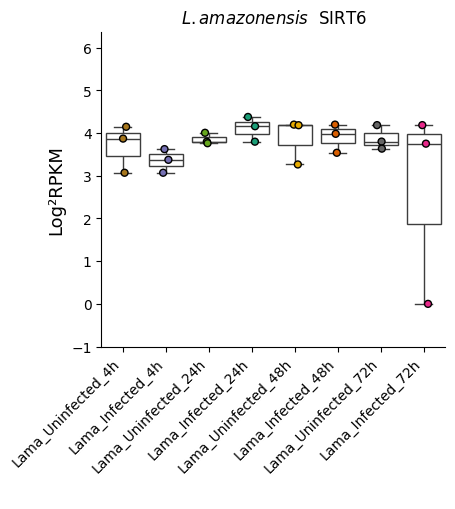

carregando


<Figure size 1200x800 with 0 Axes>

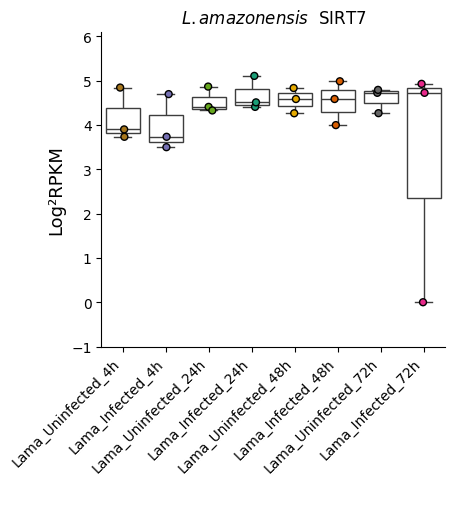

carregando


In [ ]:
graficos_boxplot(subset_PRJNA290995_df_Lama, "Dark2", "L. amazonensis",lama)

In [ ]:
subset_PRJNA290995_df_Lmj
subset_PRJNA290995_df_Lama

PRJNA290995

##PRJNA516707 ✅

In [35]:
id_gene_pasta="PRJNA516707"
PRJNA516707_tab = pd.read_excel(PRJNA516707 )
PRJNA516707_tab.head()

,Nome,Control_Uninfected_SRR8479210,Infected_Ldono_A2_SRR8479211,Infected_Ldono_A5_SRR8479212
0,YTHDF1,4.206024,4.101487,4.138054
1,YTHDF2,4.348690,4.009889,3.647246
2,YTHDF3,4.422908,3.497289,1.608254
3,YTHDC1,4.151685,3.525242,1.810422
4,FTO,4.795192,4.634867,4.548032


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
df_filtrado = PRJNA516707_tab[PRJNA516707_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
df_filtrado.index = df_filtrado["Nome"]


In [ ]:
df_filtrado = df_filtrado.T
df_filtrado

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
Control_Uninfected_SRR8479210,4.03476,4.097301,3.640333,5.003293,2.634837,0.566103,5.509747,3.803464,3.735952,2.004462,...,2.233906,-2.877602,2.985698,2.376747,6.885786,3.521887,2.7223,1.907695,4.788953,6.047401
Infected_Ldono_A2_SRR8479211,4.088559,4.180887,2.454082,5.24296,1.815955,-0.637006,5.639496,4.062881,3.241352,1.011139,...,2.024672,0.0,3.028609,2.275269,7.309156,3.472927,3.10045,1.765575,5.262831,6.334864
Infected_Ldono_A5_SRR8479212,4.095771,3.907176,1.120665,5.095255,0.194698,-2.057369,5.683107,3.952271,3.110235,-0.029082,...,2.512189,-3.864023,3.53146,-0.254757,7.114289,3.600119,2.970344,1.166387,5.178082,5.993596


In [ ]:
df_filtrado = df_filtrado.iloc[1:]

In [ ]:
df_filtrado["Status"] = ["Control_Uninfected", "InfectedA2", "Infected_A5"]
df_filtrado

<ipython-input-386-d280beff2c6f>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] = ["Control_Uninfected", "InfectedA2", "Infected_A5"]


Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7,Status
Control_Uninfected_SRR8479210,4.03476,4.097301,3.640333,5.003293,2.634837,0.566103,5.509747,3.803464,3.735952,2.004462,...,-2.877602,2.985698,2.376747,6.885786,3.521887,2.7223,1.907695,4.788953,6.047401,Control_Uninfected
Infected_Ldono_A2_SRR8479211,4.088559,4.180887,2.454082,5.24296,1.815955,-0.637006,5.639496,4.062881,3.241352,1.011139,...,0.0,3.028609,2.275269,7.309156,3.472927,3.10045,1.765575,5.262831,6.334864,InfectedA2
Infected_Ldono_A5_SRR8479212,4.095771,3.907176,1.120665,5.095255,0.194698,-2.057369,5.683107,3.952271,3.110235,-0.029082,...,-3.864023,3.53146,-0.254757,7.114289,3.600119,2.970344,1.166387,5.178082,5.993596,Infected_A5


In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'InfectedA2']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Control_Uninfected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.0538,0.083586,-1.186251,0.239666,-0.818881,-1.203108,0.129749,0.259417,-0.4946,-0.993324,...,-0.209234,2.877602,0.042912,-0.101478,0.42337,-0.04896,0.378151,-0.14212,0.473878,0.287463


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania_donovani_A2_PRJNA516707"
regulated_genes.to_excel(nome+"_A2"+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA516707/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Down,Normal,Down,Down,Normal,Normal,Normal,Down,...,Normal,UP,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'Infected_A5']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Control_Uninfected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.061011,-0.190125,-2.519668,0.091962,-2.440138,-2.623471,0.17336,0.148807,-0.625717,-2.033544,...,0.278283,-0.98642,0.545762,-2.631504,0.228503,0.078232,0.248045,-0.741308,0.389129,-0.053805


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania_donovani_A5_PRJNA516707"
regulated_genes.to_excel(nome+"_A5"+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA516707/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Down,Normal,Down,Down,Normal,Normal,Down,Down,...,Normal,Down,Normal,Down,Normal,Normal,Normal,Down,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
# graficos_boxplot(subset_PRJNA290995_df_Lmj, "Dark2", "L. major",lmj)

<Figure size 800x800 with 0 Axes>

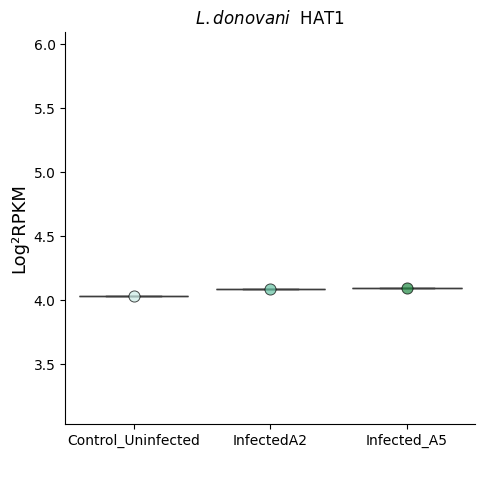

carregando


<Figure size 800x800 with 0 Axes>

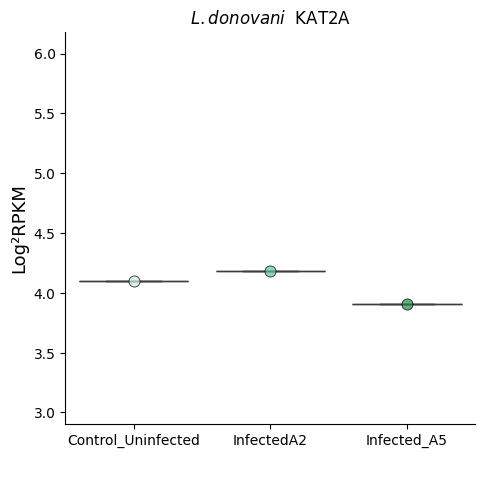

carregando


<Figure size 800x800 with 0 Axes>

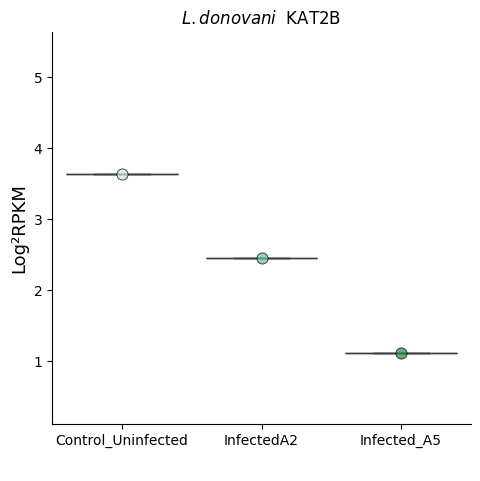

carregando


<Figure size 800x800 with 0 Axes>

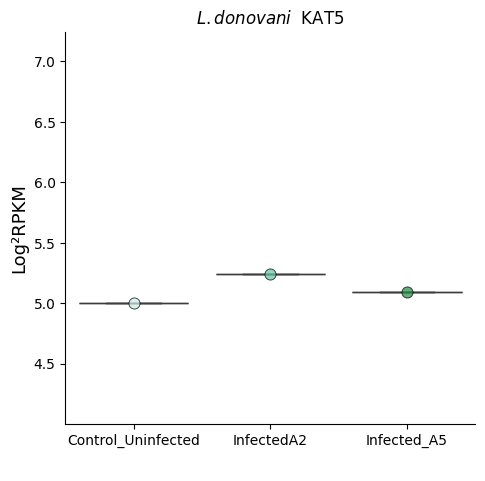

carregando


<Figure size 800x800 with 0 Axes>

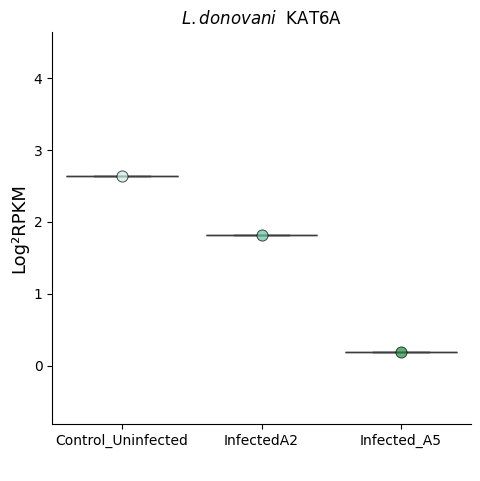

carregando


<Figure size 800x800 with 0 Axes>

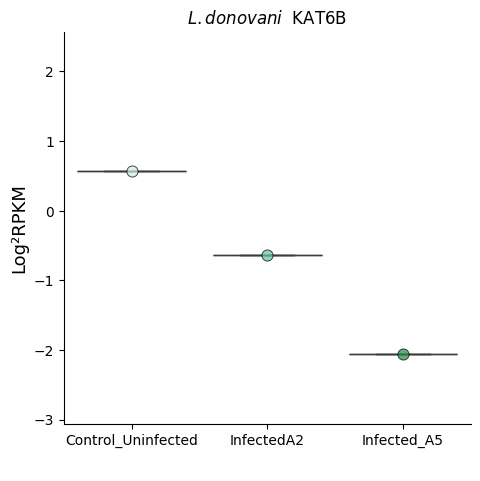

carregando


<Figure size 800x800 with 0 Axes>

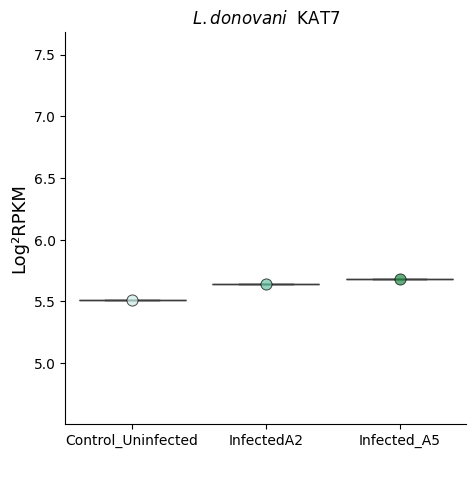

carregando


<Figure size 800x800 with 0 Axes>

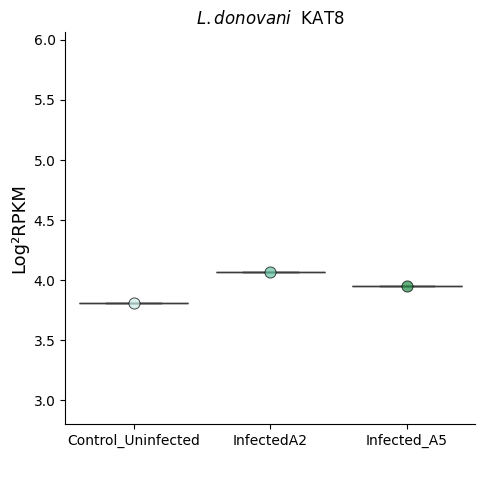

carregando


<Figure size 800x800 with 0 Axes>

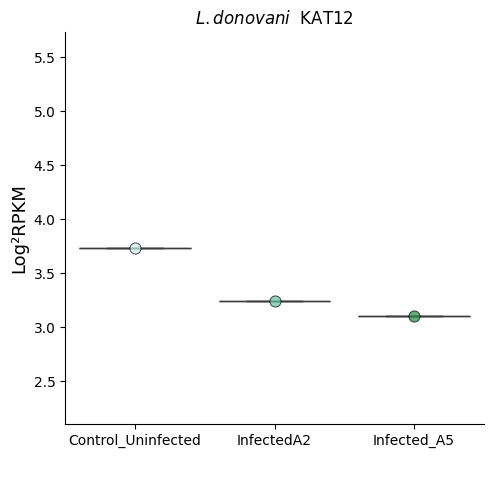

carregando


<Figure size 800x800 with 0 Axes>

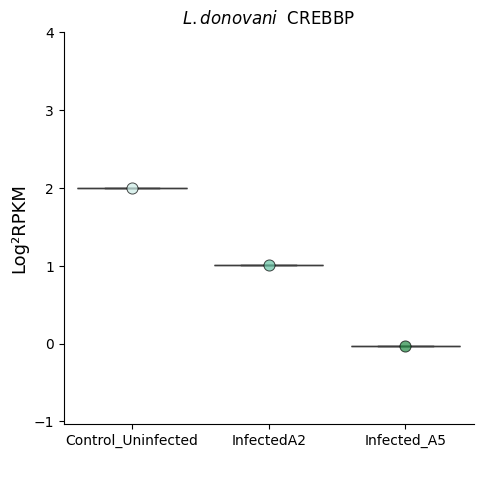

carregando


<Figure size 800x800 with 0 Axes>

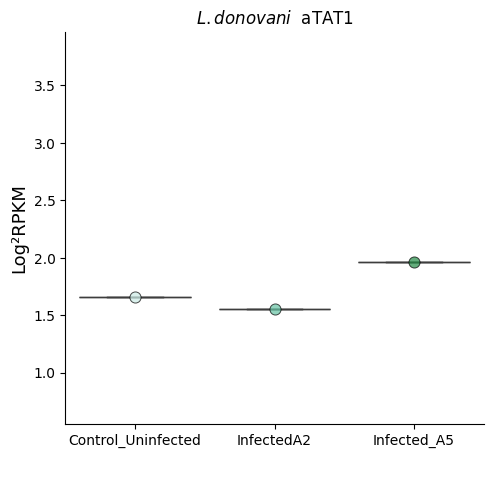

carregando


<Figure size 800x800 with 0 Axes>

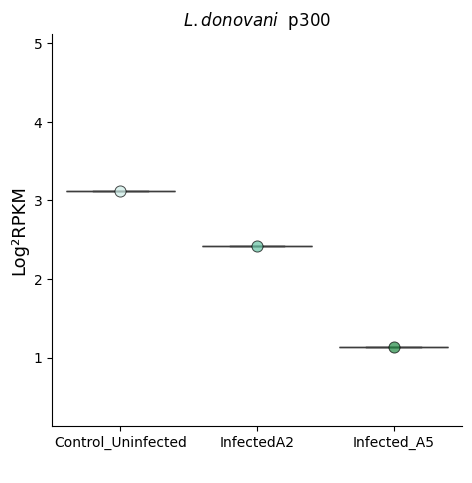

carregando


<Figure size 800x800 with 0 Axes>

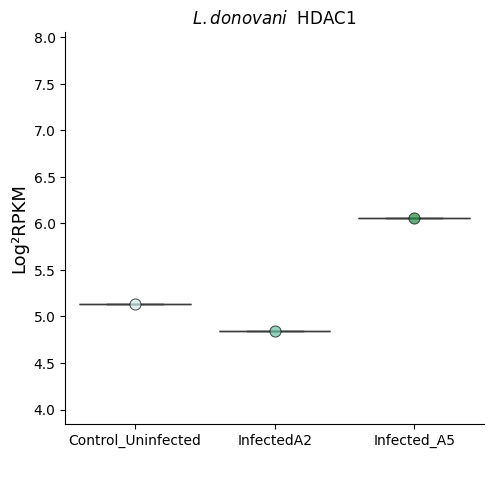

carregando


<Figure size 800x800 with 0 Axes>

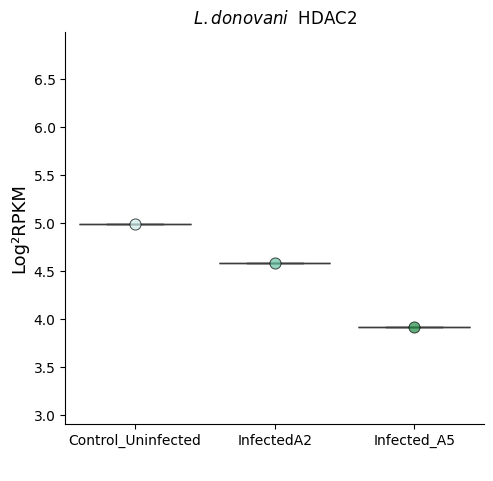

carregando


<Figure size 800x800 with 0 Axes>

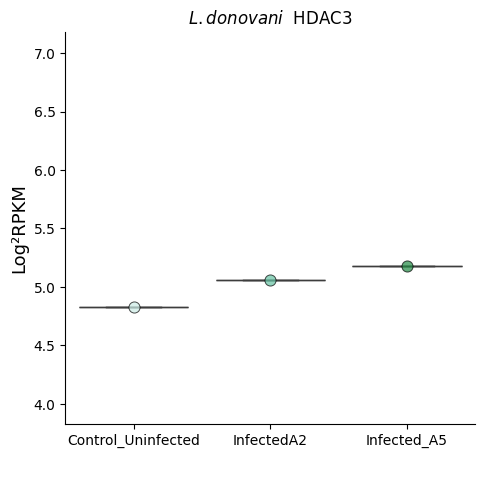

carregando


<Figure size 800x800 with 0 Axes>

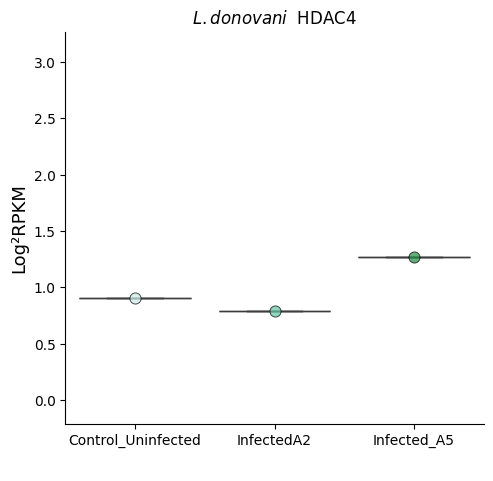

carregando


<Figure size 800x800 with 0 Axes>

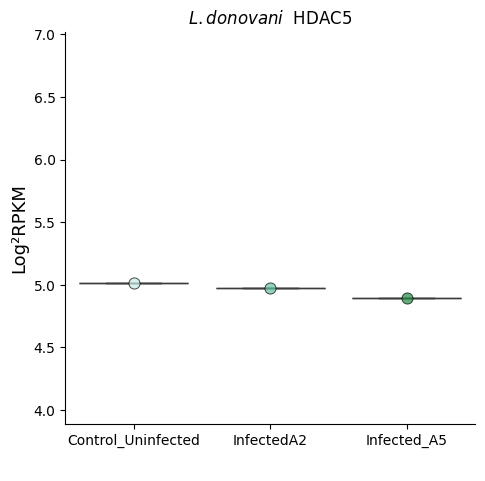

carregando


<Figure size 800x800 with 0 Axes>

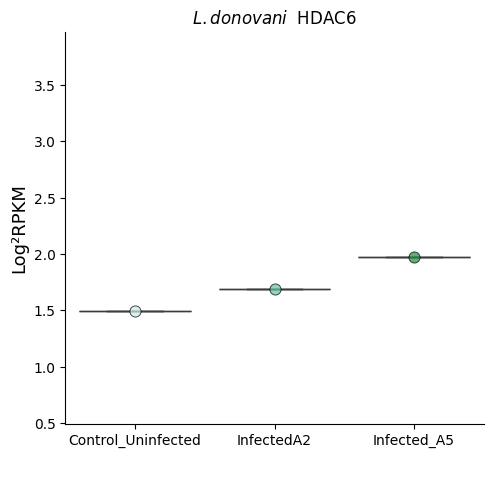

carregando


<Figure size 800x800 with 0 Axes>

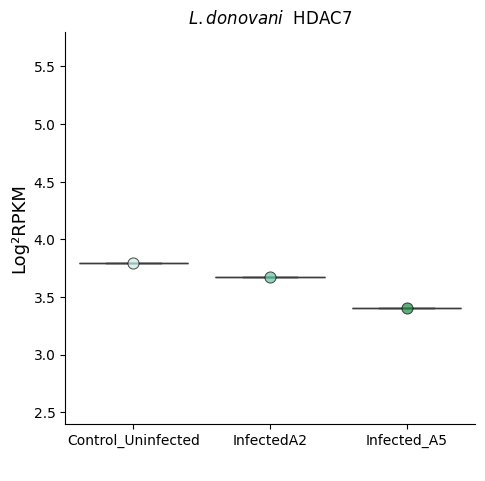

carregando


<Figure size 800x800 with 0 Axes>

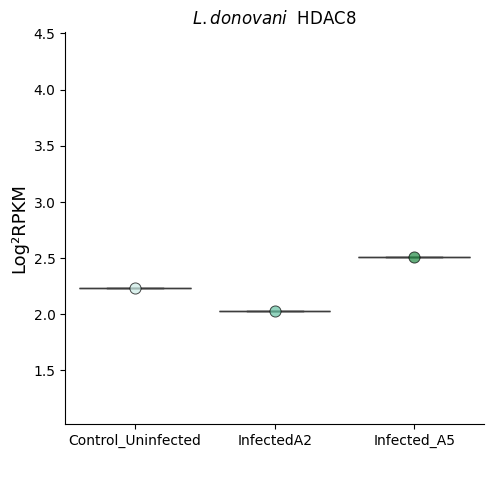

carregando


<Figure size 800x800 with 0 Axes>

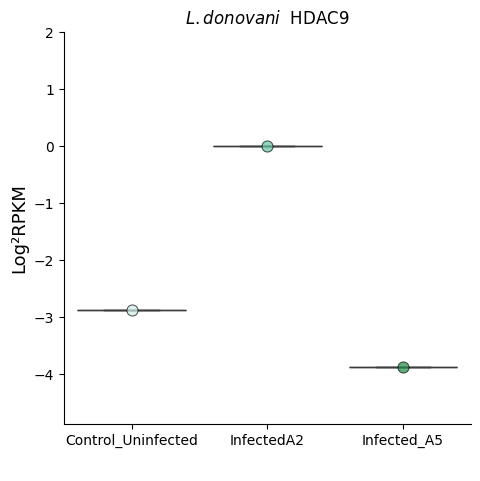

carregando


<Figure size 800x800 with 0 Axes>

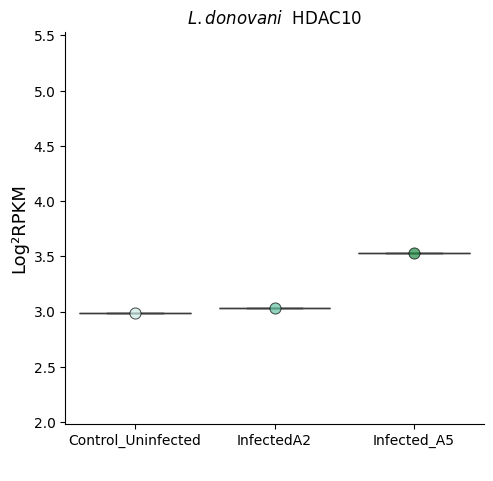

carregando


<Figure size 800x800 with 0 Axes>

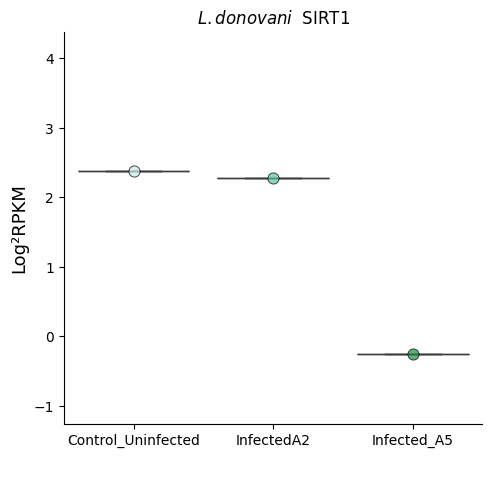

carregando


<Figure size 800x800 with 0 Axes>

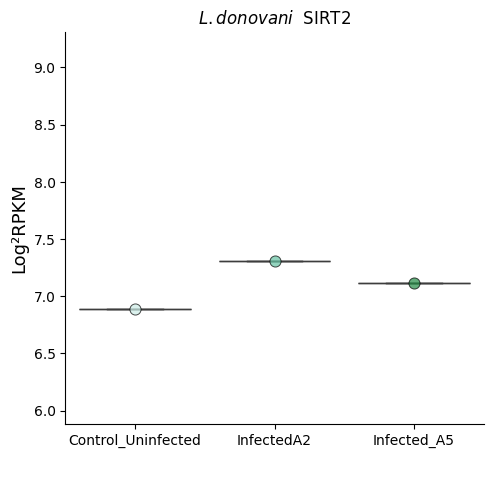

carregando


<Figure size 800x800 with 0 Axes>

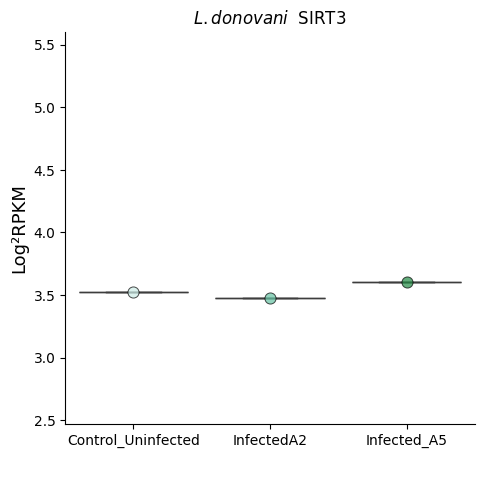

carregando


<Figure size 800x800 with 0 Axes>

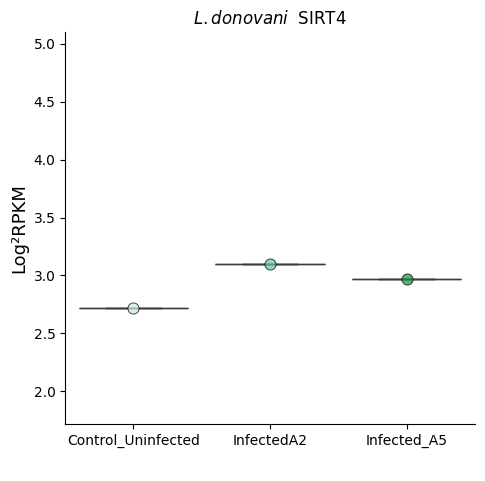

carregando


<Figure size 800x800 with 0 Axes>

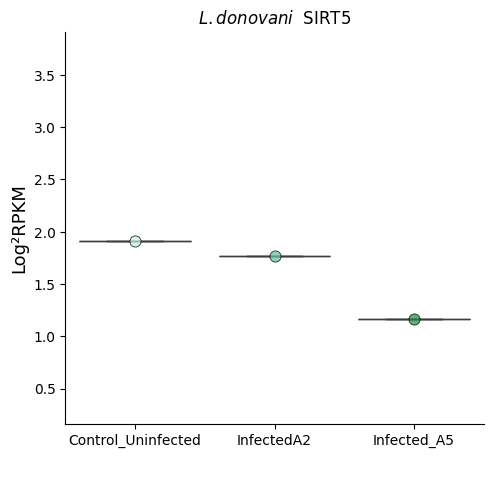

carregando


<Figure size 800x800 with 0 Axes>

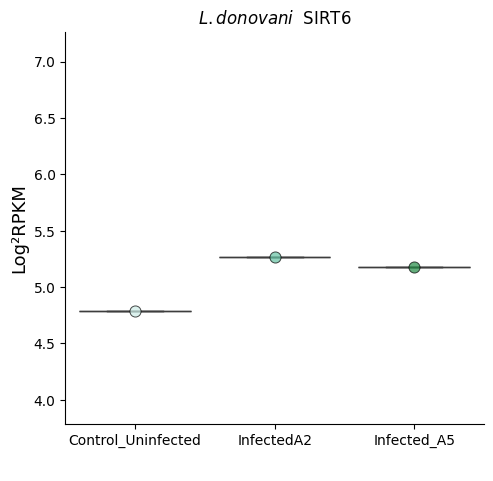

carregando


<Figure size 800x800 with 0 Axes>

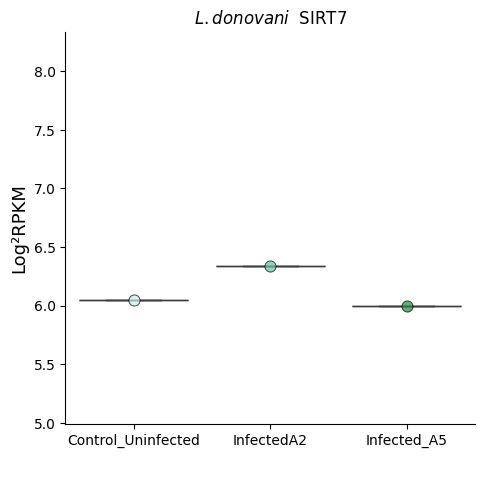

carregando


In [ ]:
graficos_boxplot(df_filtrado, "BuGn", "L. donovani", ["Control_Uninfected", "InfectedA2", "Infected_A5"], "Leishmania_donovani")

##PRJNA552352  ✅


In [ ]:
id_gene_pasta="PRJNA552352"
PRJNA552352_tab = pd.read_excel(PRJNA552352 )
PRJNA552352_tab.head()

,Nome,Control_Linf_Non-infected_1_SRR9624225,Control_Linf_Non-infected_2_SRR9624226,Control_Linf_Non-infected_3_SRR9624227,LPS_1_SRR9624224,LPS_2_SRR9624230,LPS_3_SRR9624231,Linf_Infected_1_SRR9624228,Linf_Infected_2_SRR9624229,Linf_Infected_3_SRR9624232
0,YTHDF1,5.478396,5.450322,5.395436,5.338560,5.310342,5.377361,5.571912,5.549222,5.558633
1,YTHDF2,5.800386,5.708316,5.838429,5.757143,5.754357,5.744781,5.820207,5.819174,5.734097
2,YTHDF3,6.731230,6.613689,6.565822,6.581336,6.702568,6.618676,6.720533,6.773746,6.658919
3,YTHDC1,-3.919011,-0.086849,-1.019038,-2.218201,-0.933784,-3.320070,-1.073386,-2.569407,-4.788545
4,FTO,3.835810,3.881558,3.860606,3.428996,3.341788,3.446317,3.451415,3.666889,3.624999


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
PRJNA552352_df_filtrado = PRJNA552352_tab[PRJNA552352_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
PRJNA552352_df_filtrado.index = PRJNA552352_df_filtrado["Nome"]

PRJNA552352_df_filtrado = PRJNA552352_df_filtrado.T
df_filtrado = PRJNA552352_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
Control_Linf_Non-infected_1_SRR9624225,5.276484,3.436398,3.371434,4.655148,4.94062,2.895326,5.090035,4.133373,3.321887,4.380787,...,3.740787,5.631951,3.551705,3.836305,5.700842,2.311249,-0.5405,2.335919,5.488089,5.457518
Control_Linf_Non-infected_2_SRR9624226,5.22019,3.585919,3.234788,4.492264,4.742868,2.692579,4.958493,4.265656,3.449892,4.299906,...,3.509467,5.464401,3.955126,3.796249,5.802754,2.262516,-0.937157,1.85387,5.556384,5.712713
Control_Linf_Non-infected_3_SRR9624227,5.251491,3.456889,3.319764,4.623658,4.85922,2.767297,5.079751,4.355358,3.465512,4.254123,...,3.626954,5.573545,3.681071,3.822623,5.895232,2.553852,0.189549,1.865099,5.546204,5.531028
LPS_1_SRR9624224,5.004406,3.509524,3.310797,4.746225,4.38988,2.447982,4.723367,4.309364,3.555158,4.074074,...,3.418513,5.624229,3.682936,3.608948,5.674729,1.967665,-0.009615,1.593785,5.386244,5.530878
LPS_2_SRR9624230,4.995375,3.244913,3.215792,4.74107,4.401038,2.327046,4.71158,4.230893,3.546374,4.219045,...,3.440611,5.642274,3.404417,3.692998,5.441166,2.062604,-0.255712,2.29324,5.519371,5.447699


In [ ]:
df_filtrado.index.to_list()

['Control_Linf_Non-infected_1_SRR9624225',
 'Control_Linf_Non-infected_2_SRR9624226',
 'Control_Linf_Non-infected_3_SRR9624227',
 'LPS_1_SRR9624224',
 'LPS_2_SRR9624230',
 'LPS_3_SRR9624231',
 'Linf_Infected_1_SRR9624228',
 'Linf_Infected_2_SRR9624229',
 'Linf_Infected_3_SRR9624232']

In [ ]:
df_filtrado["Status"] =       ['Control',
'Control',
'Control',
'LPS',
'LPS',
'LPS',
'Linf_Infected',
'Linf_Infected',
'Linf_Infected']

<ipython-input-22-2f2b39ab65ff>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =       ['Control',


In [ ]:
list(set(df_filtrado["Status"]))


['Linf_Infected', 'LPS', 'Control']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'Linf_Infected']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Control']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,-0.115658,0.220253,-0.081176,0.007466,-0.019159,0.047708,-0.035931,0.024872,0.02485,0.155009,...,-0.193823,0.097027,-0.02791,0.081192,0.031973,-0.122148,-0.454496,0.255372,-0.071466,0.134112


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania infantum Control_PRJNA552352"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA552352/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'Linf_Infected']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'LPS']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.140458,0.222944,0.022796,-0.115101,0.439023,0.442541,0.320452,0.059635,-0.071632,0.23587,...,-0.00748,0.046343,-0.029775,0.294868,0.244971,0.126497,-0.757981,0.372215,-0.044633,0.155248


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania infantum LPS_PRJNA552352"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA552352/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Down,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Down,Normal,Normal,Normal


<Figure size 800x800 with 0 Axes>

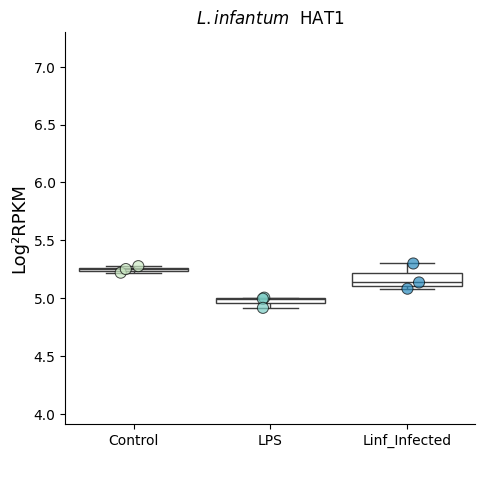

carregando


<Figure size 800x800 with 0 Axes>

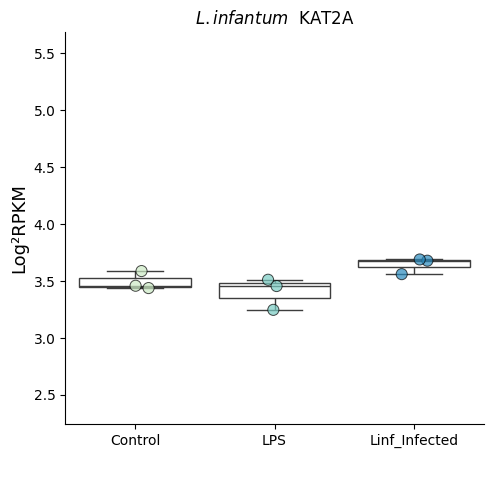

carregando


<Figure size 800x800 with 0 Axes>

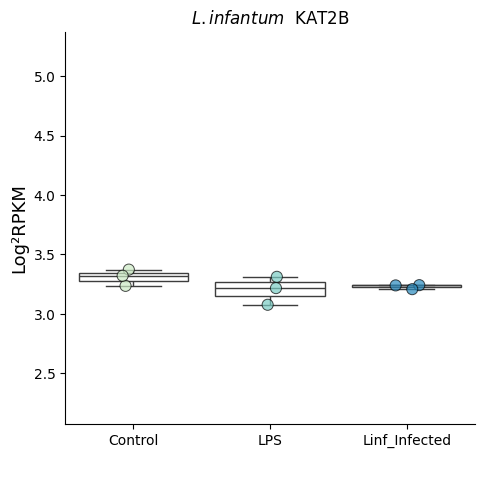

carregando


<Figure size 800x800 with 0 Axes>

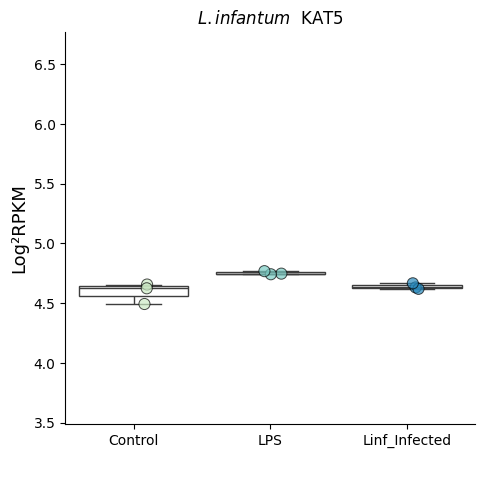

carregando


<Figure size 800x800 with 0 Axes>

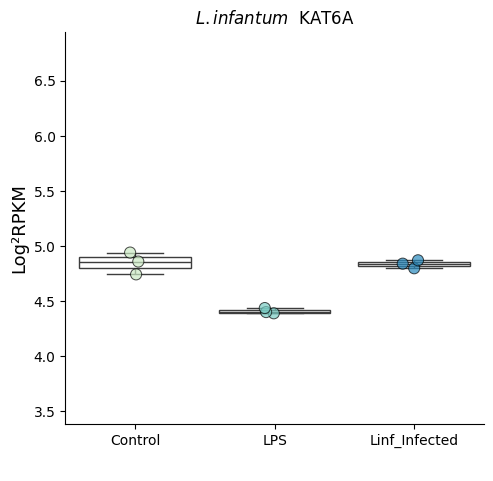

carregando


<Figure size 800x800 with 0 Axes>

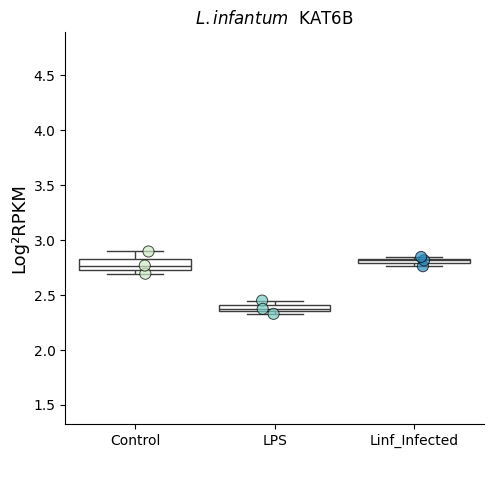

carregando


<Figure size 800x800 with 0 Axes>

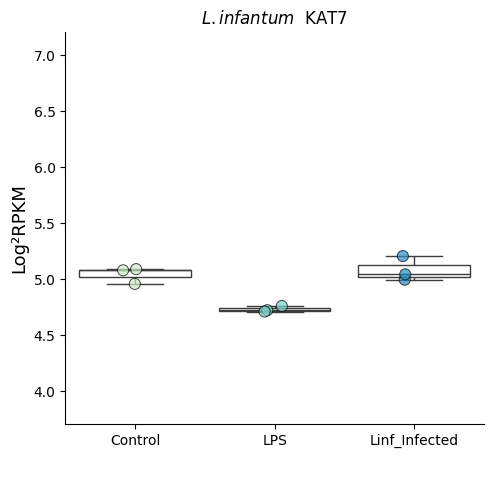

carregando


<Figure size 800x800 with 0 Axes>

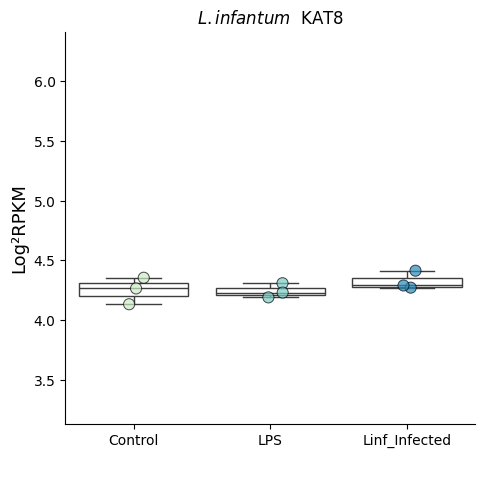

carregando


<Figure size 800x800 with 0 Axes>

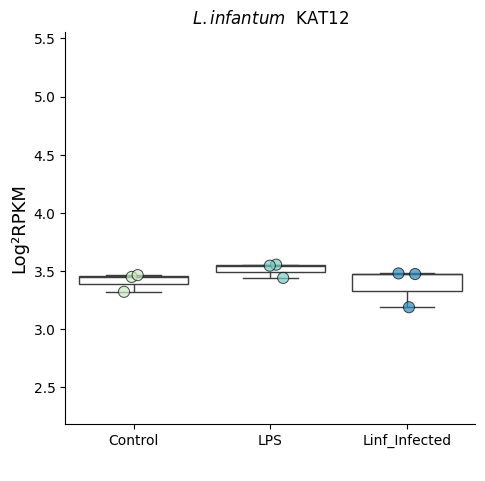

carregando


<Figure size 800x800 with 0 Axes>

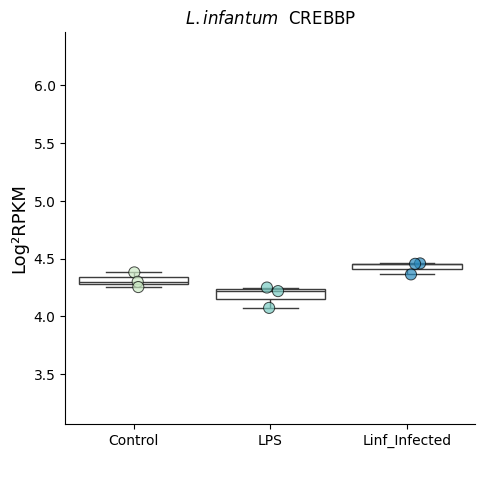

carregando


<Figure size 800x800 with 0 Axes>

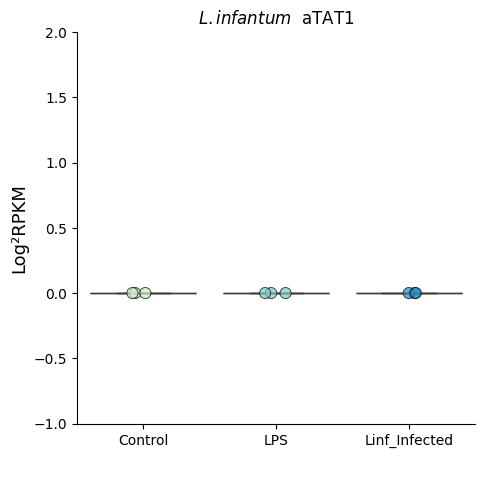

carregando


<Figure size 800x800 with 0 Axes>

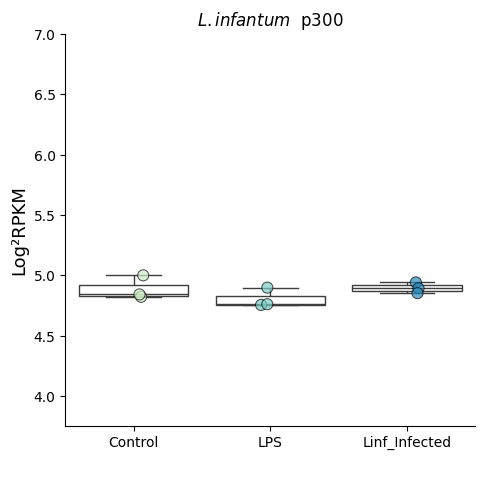

carregando


<Figure size 800x800 with 0 Axes>

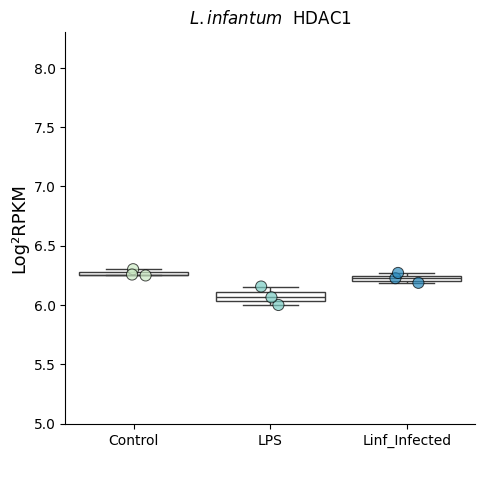

carregando


<Figure size 800x800 with 0 Axes>

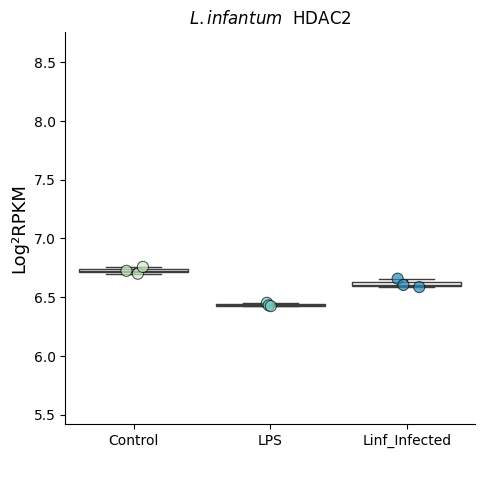

carregando


<Figure size 800x800 with 0 Axes>

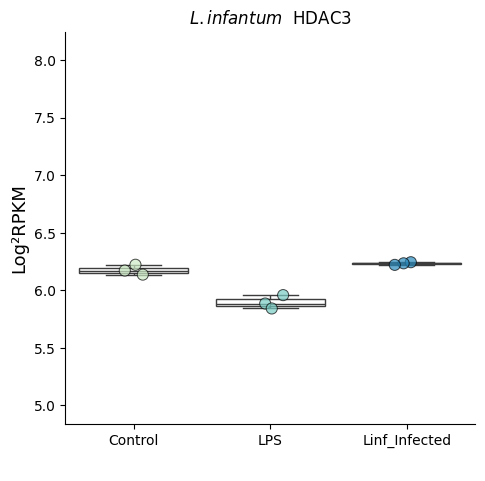

carregando


<Figure size 800x800 with 0 Axes>

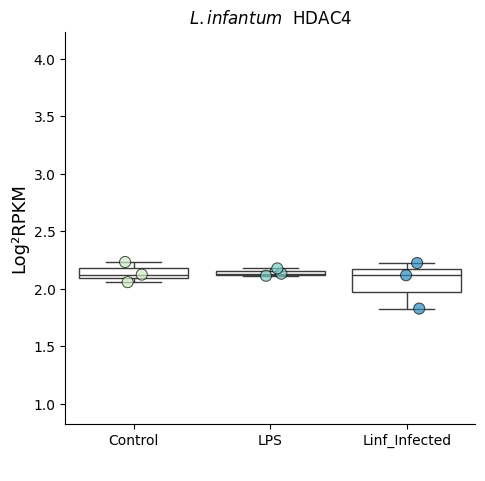

carregando


<Figure size 800x800 with 0 Axes>

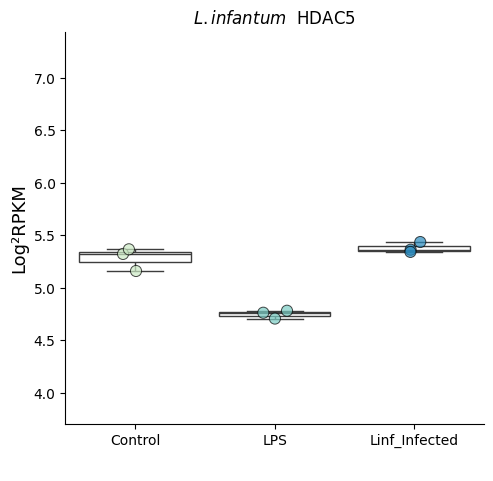

carregando


<Figure size 800x800 with 0 Axes>

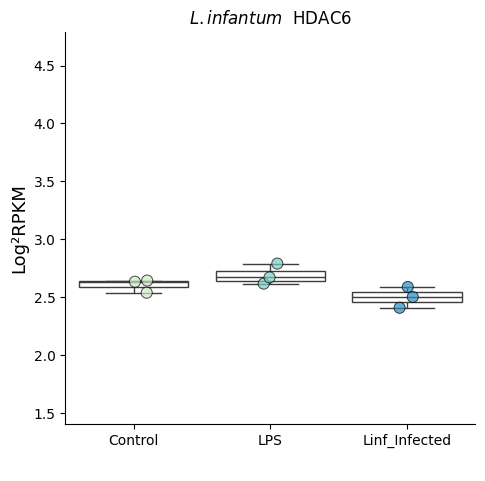

carregando


<Figure size 800x800 with 0 Axes>

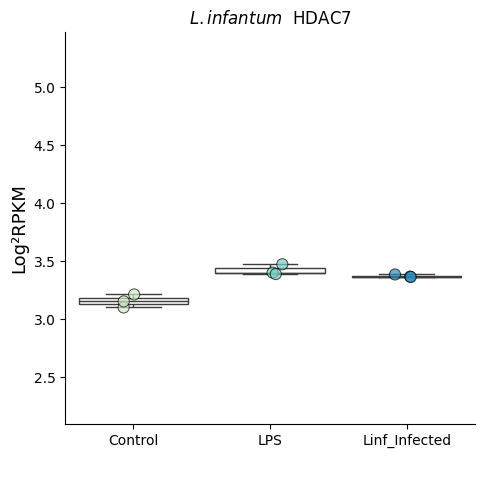

carregando


<Figure size 800x800 with 0 Axes>

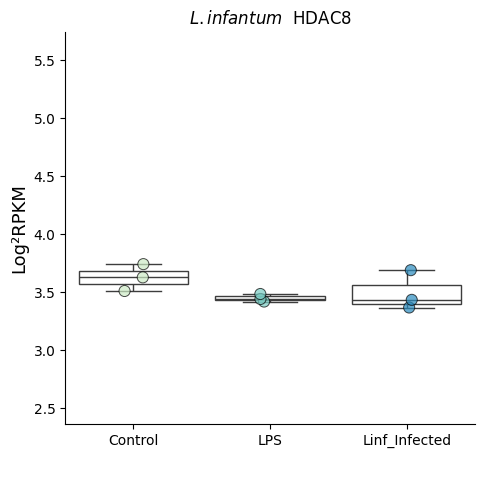

carregando


<Figure size 800x800 with 0 Axes>

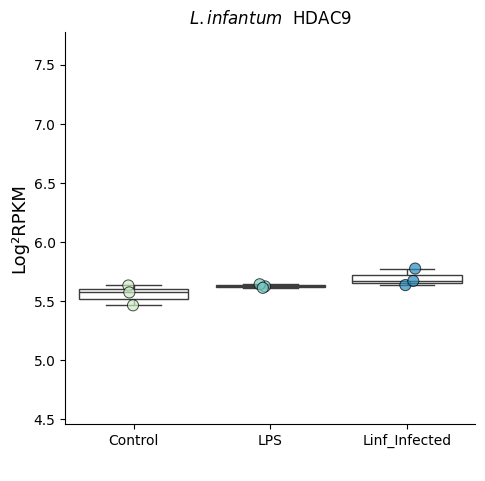

carregando


<Figure size 800x800 with 0 Axes>

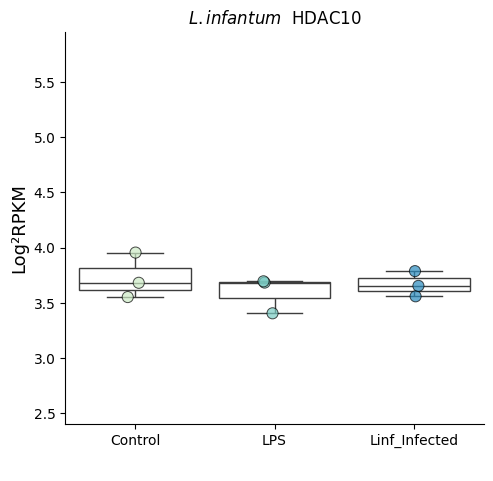

carregando


<Figure size 800x800 with 0 Axes>

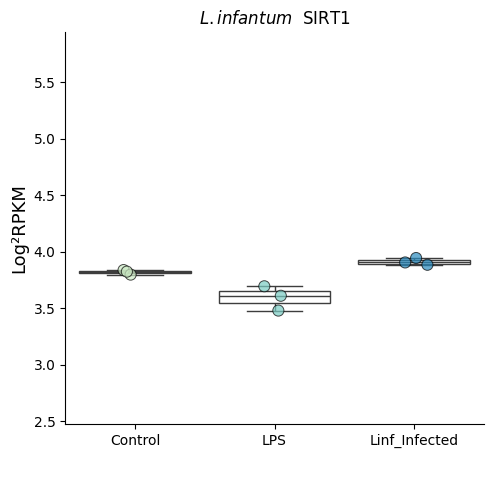

carregando


<Figure size 800x800 with 0 Axes>

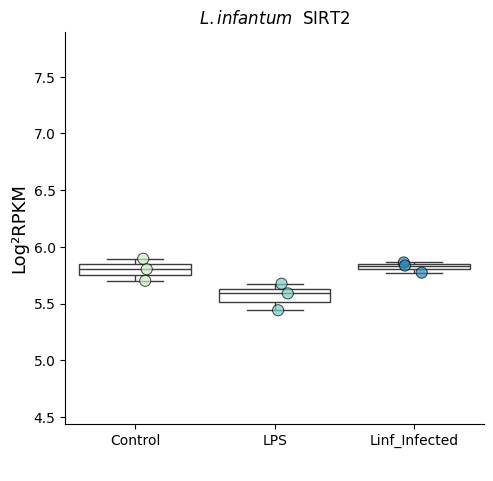

carregando


<Figure size 800x800 with 0 Axes>

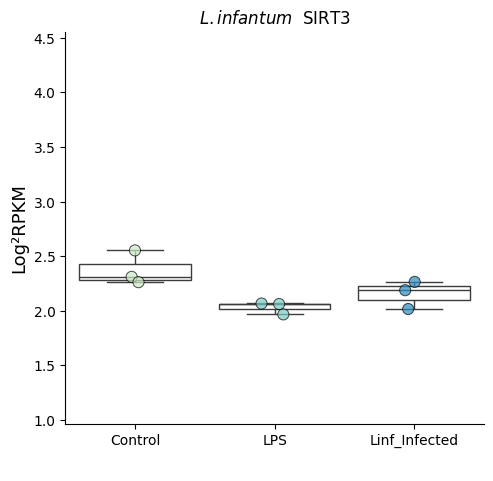

carregando


<Figure size 800x800 with 0 Axes>

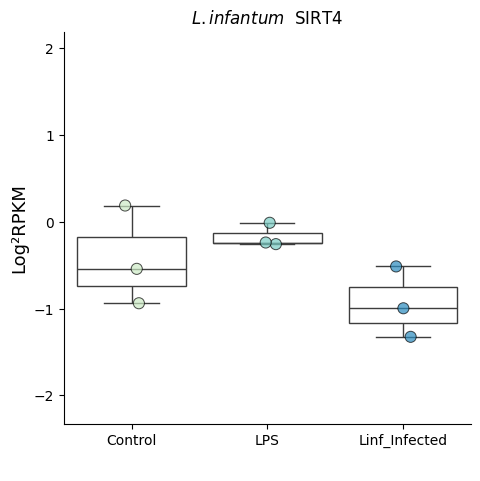

carregando


<Figure size 800x800 with 0 Axes>

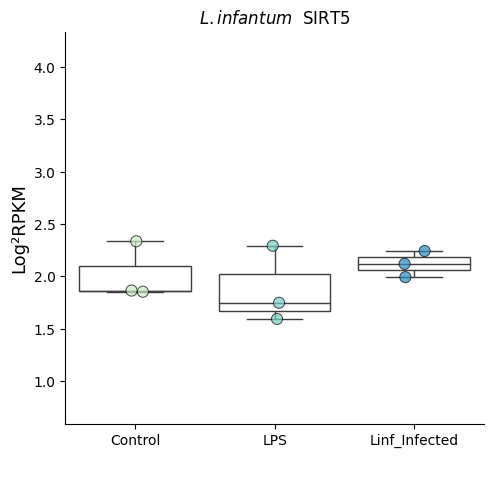

carregando


<Figure size 800x800 with 0 Axes>

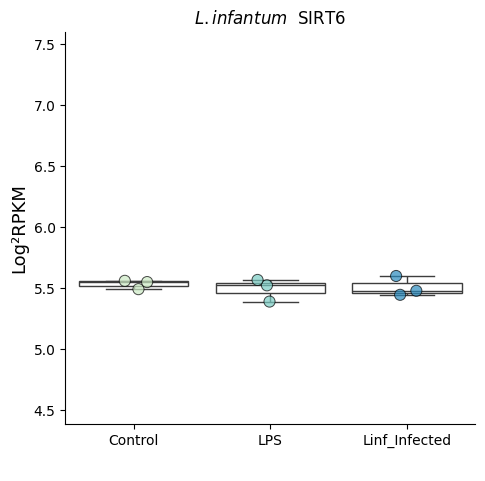

carregando


<Figure size 800x800 with 0 Axes>

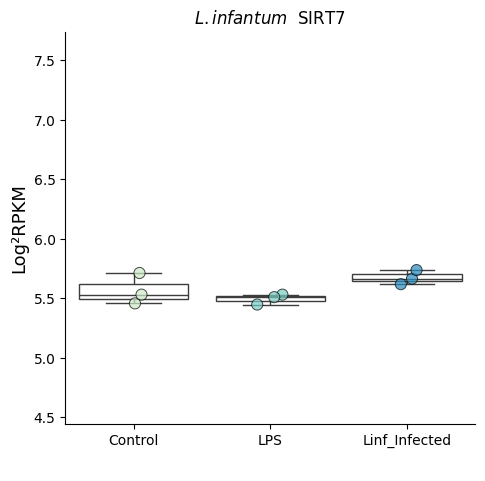

carregando


In [ ]:
graficos_boxplot(df_filtrado, "GnBu", "L.infantum",       [ 'Control', 'LPS','Linf_Infected']       , nome)


##PRJNA601732 ✅

In [ ]:
id_gene_pasta="PRJNA601732"
PRJNA601732_tab = pd.read_excel(PRJNA601732 )
PRJNA601732_tab.head()

,Nome,Infected_Mouse_Ldonovani1,Infected_Mouse_Ldonovani10,Infected_Mouse_Ldonovani2,Infected_Mouse_Ldonovani3,Infected_Mouse_Ldonovani4,Infected_Mouse_Ldonovani5,Infected_Mouse_Ldonovani6,Infected_Mouse_Ldonovani7,Infected_Mouse_Ldonovani8,...,Uninfected_MouseC1,Uninfected_MouseC10,Uninfected_MouseC2,Uninfected_MouseC3,Uninfected_MouseC4,Uninfected_MouseC5,Uninfected_MouseC6,Uninfected_MouseC7,Uninfected_MouseC8,Uninfected_MouseC9
0,YTHDF1,4.797692,3.949929,4.981626,4.936650,4.847908,4.948637,4.166941,3.957723,4.039697,...,4.129603,4.981286,3.811571,3.979777,3.808289,3.914652,5.007366,5.081593,4.957327,4.091182
1,YTHDF2,5.286845,3.789202,5.190563,5.263156,5.214163,5.183272,3.759020,3.939599,3.969780,...,4.066061,5.313471,3.752332,3.784900,3.847803,3.422022,5.317232,5.326197,5.193091,5.625518
2,YTHDF3,5.786607,5.419098,6.055765,5.823467,5.941092,5.787205,5.418640,5.361933,5.414753,...,5.605753,6.295163,5.500951,5.262531,5.441987,5.370709,6.366249,6.225117,6.175318,6.311172
3,YTHDC1,5.575178,4.208377,5.717751,5.571168,5.540941,5.498622,4.233908,4.305356,4.271810,...,4.504098,6.001372,4.111825,4.246269,4.018467,3.829616,5.956159,5.944768,5.942710,5.620255
4,FTO,4.681569,4.338228,4.813266,4.720604,4.752599,4.666357,4.721351,4.489697,4.235055,...,4.553494,4.676918,4.447566,4.236555,4.288119,4.089420,4.938425,4.908927,4.596195,1.438696


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
PRJNA601732_df_filtrado = PRJNA601732_tab[PRJNA601732_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
PRJNA601732_df_filtrado.index = PRJNA601732_df_filtrado["Nome"]


In [ ]:
PRJNA601732_df_filtrado = PRJNA601732_df_filtrado.T

In [ ]:
PRJNA601732_df_filtrado = PRJNA601732_df_filtrado.iloc[1:]

In [ ]:
PRJNA601732_df_filtrado["Status"] =['Mouse_Ldonovani',
 'Mouse_Ldonovani',
 'Mouse_Ldonovani',
 'Mouse_Ldonovani',
 'Mouse_Ldonovani',
 'Mouse_Ldonovani',
 'Mouse_Ldonovani',
 'Mouse_Ldonovani',
 'Mouse_Ldonovani',
 'Mouse_Ldonovani',
 'Mouse_Linfantum',
 'Mouse_Linfantum',
 'Mouse_Linfantum',
 'Mouse_Linfantum',
 'Mouse_Linfantum',
 'Mouse_Linfantum',
 'Mouse_Linfantum',
 'Mouse_Linfantum',
 'Mouse_Linfantum',
 'Mouse_Linfantum',
 'Uninfected_Mouse',
 'Uninfected_Mouse',
 'Uninfected_Mouse',
 'Uninfected_Mouse',
 'Uninfected_Mouse',
 'Uninfected_Mouse',
 'Uninfected_Mouse',
 'Uninfected_Mouse',
 'Uninfected_Mouse',
 'Uninfected_Mouse']


In [ ]:
set(PRJNA601732_df_filtrado["Status"])

{'Mouse_Ldonovani', 'Mouse_Linfantum', 'Uninfected_Mouse'}

In [ ]:
#############################################################
infected_data = PRJNA601732_df_filtrado[(PRJNA601732_df_filtrado['Status'] == 'Mouse_Linfantum')]
uninfected_data = PRJNA601732_df_filtrado[PRJNA601732_df_filtrado['Status'] == 'Uninfected_Mouse']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,1.150913,0.127452,-0.006135,0.036311,-0.278709,-0.425723,-0.015772,0.004293,0.102727,-0.379888,...,0.276308,0.422889,-0.319062,0.323707,0.079883,-0.128176,-0.181073,-0.386733,0.261637,-0.044762


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania infantum_PRJNA601732"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA601732/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
#############################################################
infected_data = PRJNA601732_df_filtrado[(PRJNA601732_df_filtrado['Status'] == 'Mouse_Ldonovani')]
uninfected_data = PRJNA601732_df_filtrado[PRJNA601732_df_filtrado['Status'] == 'Uninfected_Mouse']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,1.302888,0.112095,-0.034091,0.033919,-0.222651,-0.55094,0.032815,0.442599,0.028874,-0.281331,...,0.204156,0.020758,-0.395644,0.247633,0.296032,-0.145041,-0.213566,-0.536646,0.302558,-0.055652


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania donovani_PRJNA601732"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA601732/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
PRJNA601732_df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7,Status
Infected_Mouse_Ldonovani1,5.85534,4.535978,5.060283,4.91921,4.012288,1.312265,6.373165,4.326465,4.415382,1.813906,...,2.136845,4.264443,4.401926,6.161618,4.271892,3.640881,1.956544,4.563986,6.450257,Mouse_Ldonovani
Infected_Mouse_Ldonovani10,3.30647,3.200638,5.304406,3.529607,2.511945,0.905166,4.849405,3.492119,3.79287,1.152455,...,-0.20296,2.854229,2.87663,5.385308,6.335107,3.736294,3.544685,3.152036,5.253196,Mouse_Ldonovani
Infected_Mouse_Ldonovani2,5.768612,4.511164,5.150976,4.903017,4.273902,2.068778,6.522869,4.456863,4.44,2.536001,...,2.692369,4.182267,4.439079,6.096611,4.281885,3.486197,1.962589,4.669911,6.486304,Mouse_Ldonovani
Infected_Mouse_Ldonovani3,5.81116,4.490908,5.053111,4.752398,3.850626,1.517197,6.284102,4.431825,4.414153,1.971418,...,2.403785,4.063055,4.311561,6.077804,4.451709,3.580131,2.154685,4.502829,6.413536,Mouse_Ldonovani
Infected_Mouse_Ldonovani4,5.70529,4.465238,5.055383,4.920622,3.758895,1.575885,6.333836,4.220783,4.415395,1.964068,...,2.47705,4.07408,4.175584,6.146853,4.291577,3.600847,1.866755,4.370466,6.426205,Mouse_Ldonovani


In [ ]:
# Filtrando as linhas para Uninfected_Mouse e Infected_Mouse_Linfantum
subset_PRJNA601732_df_Linfantum = PRJNA601732_df_filtrado[(PRJNA601732_df_filtrado['Status'] == 'Uninfected_Mouse') | (PRJNA601732_df_filtrado['Status'] == 'Mouse_Linfantum')]
subset_PRJNA601732_df_Linfantum.iloc[[1,-1],:]

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7,Status
Infected_Mouse_Linfantum10,5.869482,4.529,5.157299,4.756446,4.071213,1.52942,6.34041,4.101823,4.693451,2.304626,...,3.220821,4.166746,4.48206,6.080105,4.10319,3.367414,2.332844,4.232793,6.185487,Mouse_Linfantum
Uninfected_MouseC9,4.031135,5.038071,5.203657,6.020793,4.39864,2.213438,6.561111,2.57076,4.010098,2.966618,...,3.783754,4.591771,3.963962,5.613135,3.986845,0.0,3.132339,4.832448,6.282036,Uninfected_Mouse


In [ ]:
# Filtrando as linhas para Infected_Mouse_Ldonovani e Infected_Mouse_Linfantum
subset_PRJNA601732_df_Ldonovani = PRJNA601732_df_filtrado[(PRJNA601732_df_filtrado['Status'] == 'Mouse_Ldonovani') | (PRJNA601732_df_filtrado['Status'] == 'Infected_Mouse_Linfantum')]
subset_PRJNA601732_df_Ldonovani.iloc[[1,-1],:]

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7,Status
Infected_Mouse_Ldonovani10,3.30647,3.200638,5.304406,3.529607,2.511945,0.905166,4.849405,3.492119,3.79287,1.152455,...,-0.20296,2.854229,2.87663,5.385308,6.335107,3.736294,3.544685,3.152036,5.253196,Mouse_Ldonovani
Infected_Mouse_Ldonovani9,3.462722,3.26249,5.371241,3.856609,2.353019,1.132731,4.869392,3.894971,4.082344,1.090372,...,0.872205,2.842624,3.03834,5.396009,6.10736,3.408131,3.61106,2.713267,5.106679,Mouse_Ldonovani


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, caminho="aqui"):
    for i in tabela:
        if "Status" in i:
            continue

        plt.figure(figsize=(10, 8))  # Aumentando o tamanho da figura

        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=5, edgecolor='black',
                         linewidth=1, hue="Status", order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", order=ordem)

        plt.xticks(rotation=0)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA601732/{especie}_{i}.png",
                    dpi=200, format='png')

        plt.show()

        print("carregando")


<Figure size 1000x800 with 0 Axes>

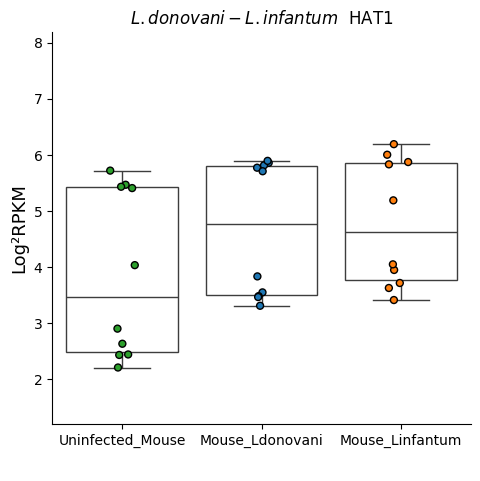

carregando


<Figure size 1000x800 with 0 Axes>

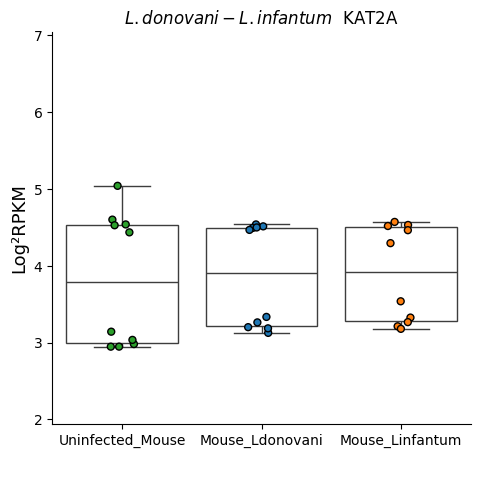

carregando


<Figure size 1000x800 with 0 Axes>

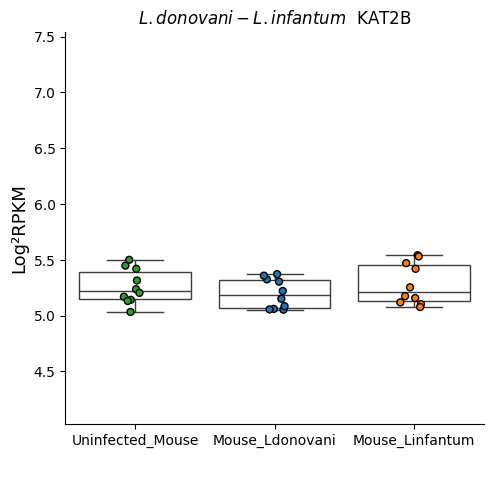

carregando


<Figure size 1000x800 with 0 Axes>

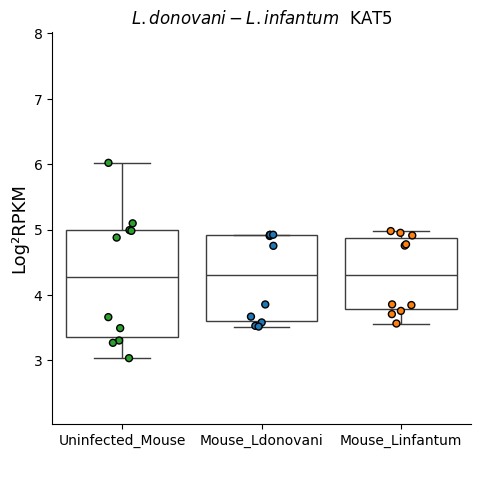

carregando


<Figure size 1000x800 with 0 Axes>

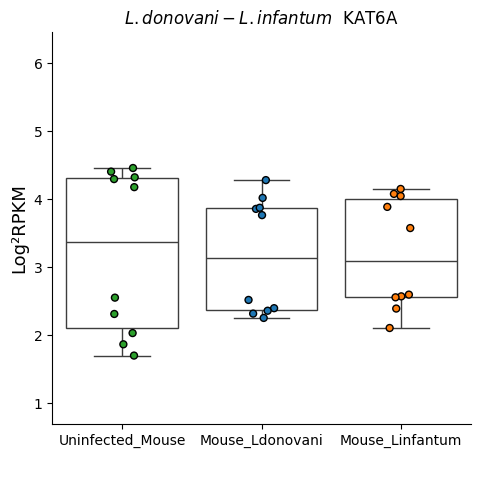

carregando


<Figure size 1000x800 with 0 Axes>

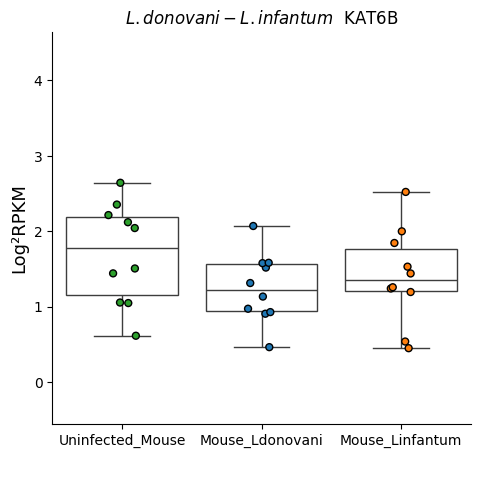

carregando


<Figure size 1000x800 with 0 Axes>

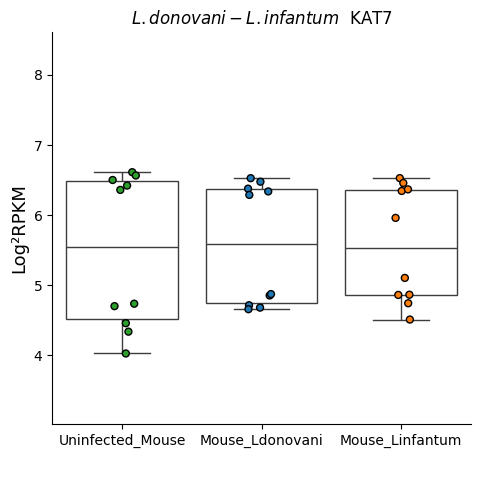

carregando


<Figure size 1000x800 with 0 Axes>

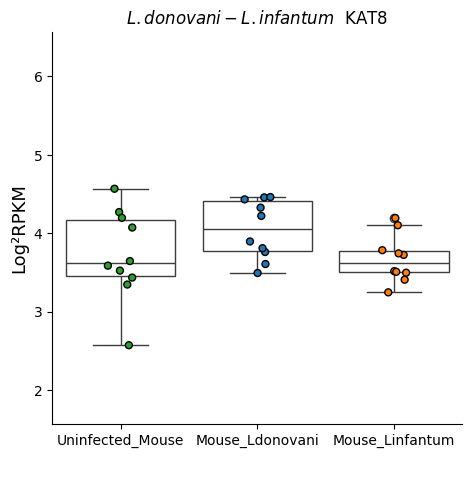

carregando


<Figure size 1000x800 with 0 Axes>

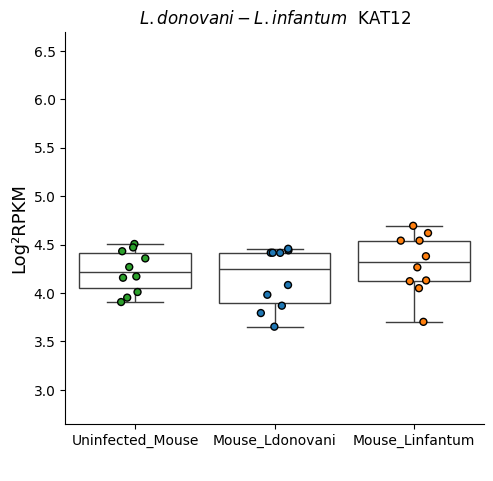

carregando


<Figure size 1000x800 with 0 Axes>

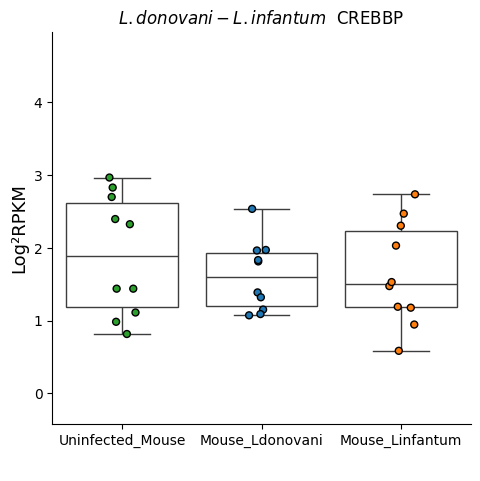

carregando


<Figure size 1000x800 with 0 Axes>

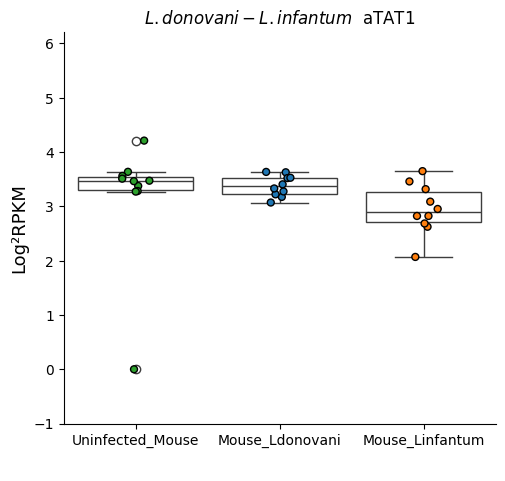

carregando


<Figure size 1000x800 with 0 Axes>

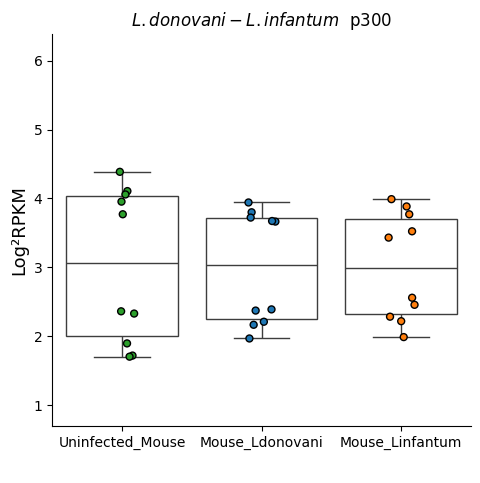

carregando


<Figure size 1000x800 with 0 Axes>

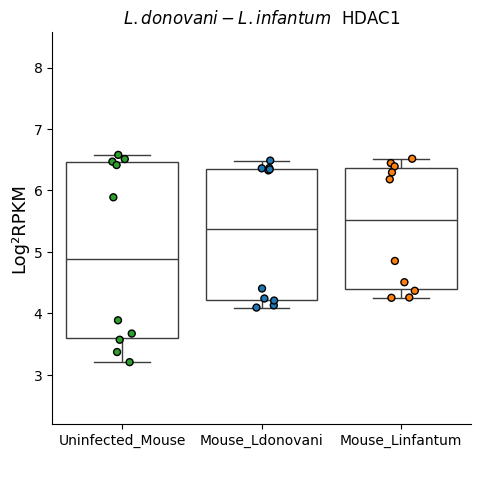

carregando


<Figure size 1000x800 with 0 Axes>

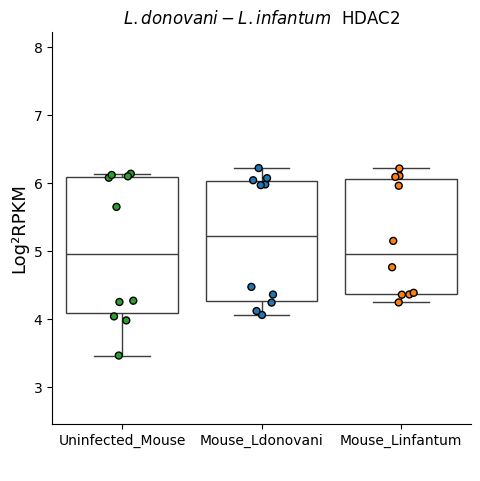

carregando


<Figure size 1000x800 with 0 Axes>

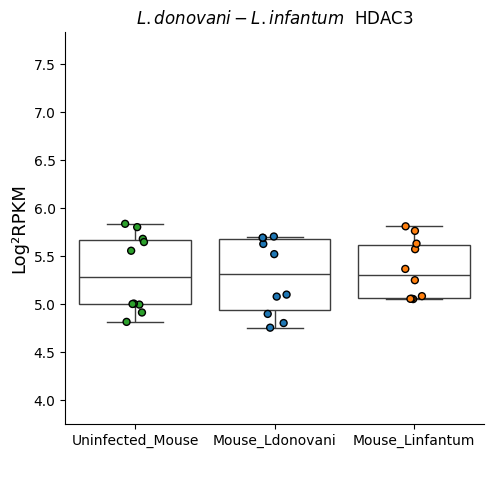

carregando


<Figure size 1000x800 with 0 Axes>

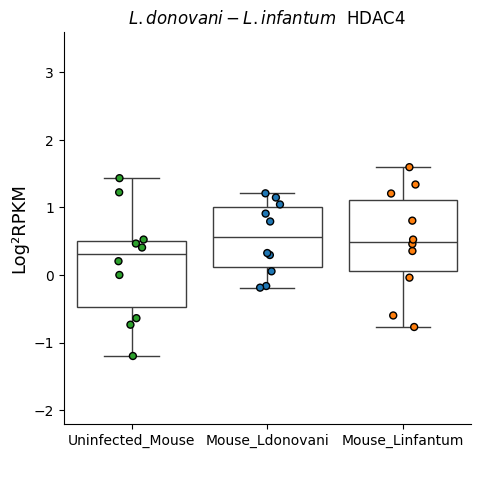

carregando


<Figure size 1000x800 with 0 Axes>

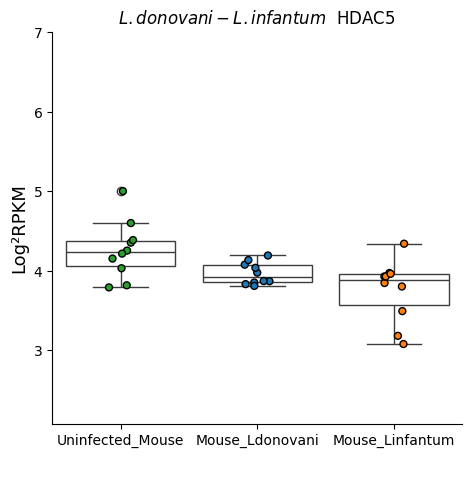

carregando


<Figure size 1000x800 with 0 Axes>

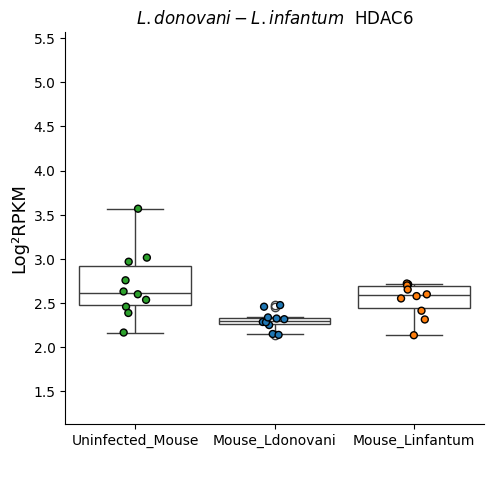

carregando


<Figure size 1000x800 with 0 Axes>

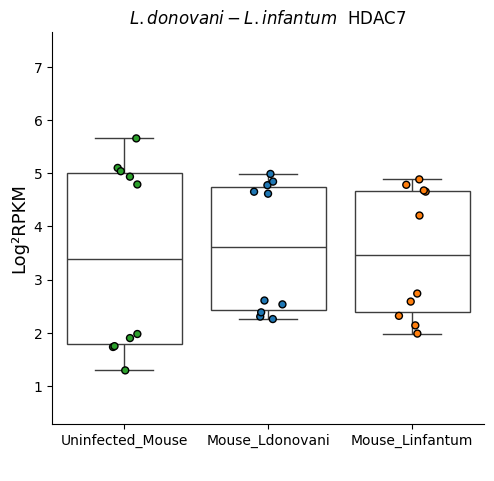

carregando


<Figure size 1000x800 with 0 Axes>

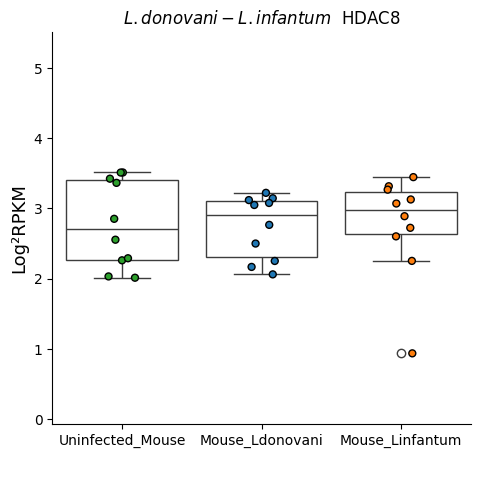

carregando


<Figure size 1000x800 with 0 Axes>

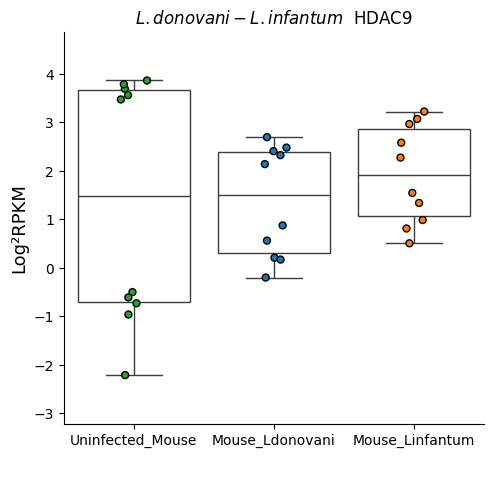

carregando


<Figure size 1000x800 with 0 Axes>

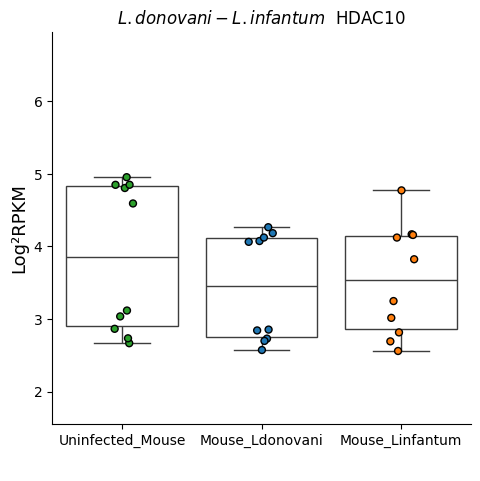

carregando


<Figure size 1000x800 with 0 Axes>

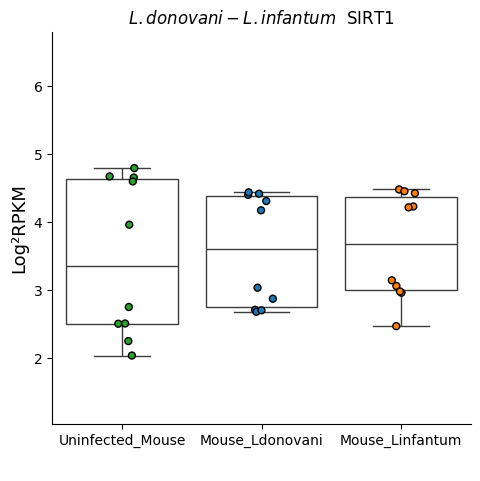

carregando


<Figure size 1000x800 with 0 Axes>

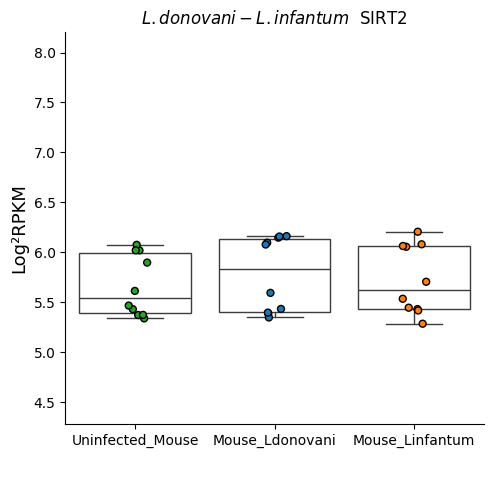

carregando


<Figure size 1000x800 with 0 Axes>

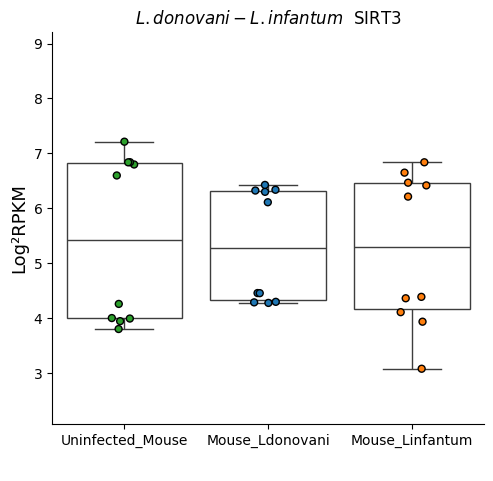

carregando


<Figure size 1000x800 with 0 Axes>

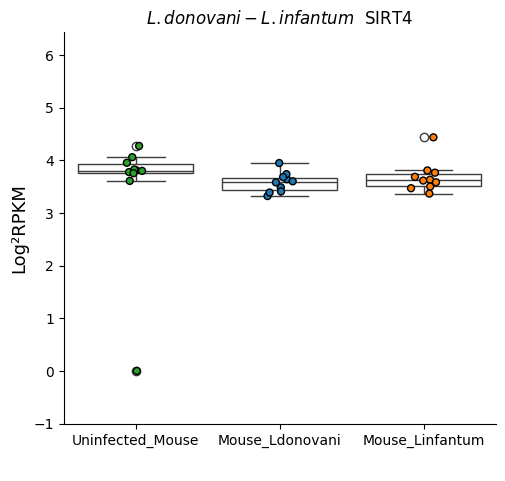

carregando


<Figure size 1000x800 with 0 Axes>

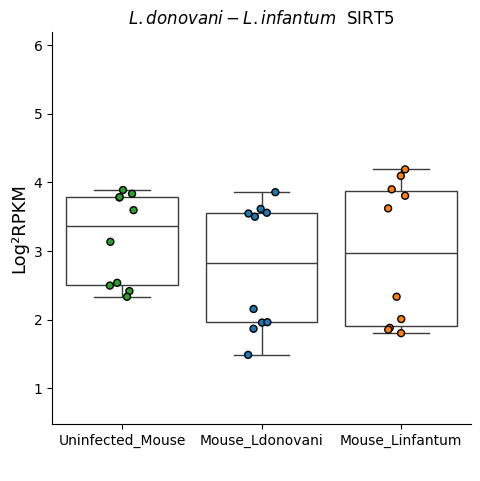

carregando


<Figure size 1000x800 with 0 Axes>

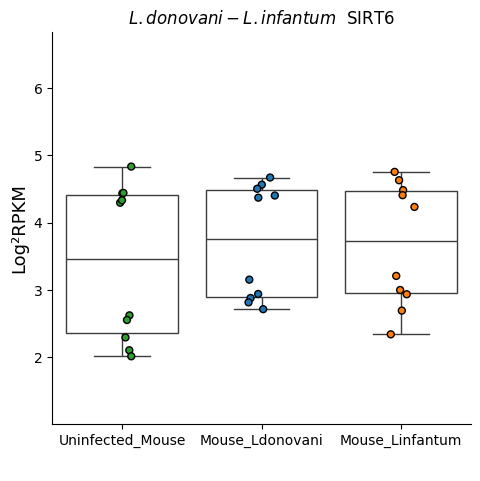

carregando


<Figure size 1000x800 with 0 Axes>

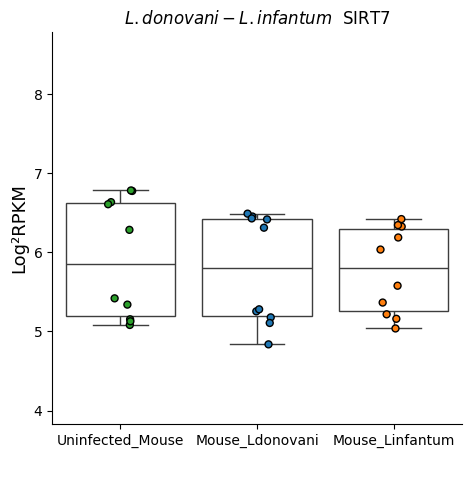

carregando


In [ ]:
graficos_boxplot(PRJNA601732_df_filtrado, "BuGn", "L. donovani-L. infantum", ["Uninfected_Mouse", "Mouse_Ldonovani" ,'Mouse_Linfantum'])
#,)

##PRJNA633893  ✅


In [ ]:
id_gene_pasta="PRJNA633893"
PRJNA633893_tab = pd.read_excel(PRJNA633893 )
PRJNA633893_tab.head()

,Nome,Leishmania_CL _Antimony_R_1_,Leishmania_CL _Antimony_R_2_,Leishmania_CL _Antimony_R_3_,Leishmania_CL _Antimony_R_4_,Leishmania_CL _Antimony_R_5_,Leishmania_CL _Antimony_R_6_,Macrophages_Human_Control_1_SRR12185377,Macrophages_Human_Control_2_SRR12185379,Macrophages_Human_Control_3_SRR12185381,Macrophages_Human_Control_4_SRR12185383,Macrophages_Human_Control_5_SRR12185385,Macrophages_Human_Control_6_SRR12185387
0,YTHDF1,4.606326,5.121771,4.902902,4.931944,4.553458,4.644274,5.099993,4.676171,4.877325,4.517210,4.635308,4.517210
1,YTHDF2,5.235044,5.595550,5.389419,5.335914,5.038700,5.343260,5.542565,5.283046,5.376468,4.829555,5.306184,4.829555
2,YTHDF3,5.390121,5.675620,5.632883,5.462408,4.660561,6.059265,5.526124,5.833279,5.403944,4.573954,6.114684,4.573954
3,YTHDC1,-5.919390,-4.472678,-4.873926,-4.048338,-7.355948,-4.686106,0.376205,-4.050184,-4.225213,0.000000,-5.312584,0.000000
4,FTO,3.668806,4.528531,4.033715,3.941621,3.863211,4.027532,4.405292,4.250063,3.991082,3.667105,4.091800,3.667105


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
PRJNA633893_df_filtrado = PRJNA633893_tab[PRJNA633893_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
PRJNA633893_df_filtrado.index = PRJNA633893_df_filtrado["Nome"]

PRJNA633893_df_filtrado = PRJNA633893_df_filtrado.T
df_filtrado = PRJNA633893_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
Leishmania_CL _Antimony_R_1_,3.270764,1.345203,3.093246,4.870218,3.169765,2.097681,4.586045,4.259782,2.807537,3.799022,...,3.352591,1.833348,3.584091,2.01879,5.851439,2.764727,-0.623341,3.042343,4.716297,6.015087
Leishmania_CL _Antimony_R_2_,5.639037,3.61356,4.579684,4.543346,4.197158,2.9318,4.791284,4.312572,3.624163,4.151002,...,3.820126,1.634686,4.070565,3.310527,5.39357,3.922642,-0.456737,3.632907,4.401733,5.742275
Leishmania_CL _Antimony_R_3_,5.235678,2.522975,4.258575,4.391469,3.495472,1.925827,4.503701,4.260753,3.041877,3.730369,...,3.644516,1.176323,3.835315,3.291545,5.556749,2.978697,-1.129287,3.211079,4.345982,5.780501
Leishmania_CL _Antimony_R_4_,5.233453,3.338114,4.287885,4.721172,3.757325,2.026219,4.681445,4.370657,3.167884,3.968231,...,3.70199,1.045677,3.947342,3.258632,5.537576,3.415513,-1.354325,3.478809,4.692462,5.30345
Leishmania_CL _Antimony_R_5_,2.734517,1.995629,2.887426,4.592211,2.717249,1.280851,4.398781,4.199,2.518307,3.418764,...,3.659725,0.132846,3.624916,1.662944,6.15254,3.329765,-1.503505,3.048496,4.518464,5.831099


In [ ]:
df_filtrado.index.to_list()

['Leishmania_CL _Antimony_R_1_',
 'Leishmania_CL _Antimony_R_2_',
 'Leishmania_CL _Antimony_R_3_',
 'Leishmania_CL _Antimony_R_4_',
 'Leishmania_CL _Antimony_R_5_',
 'Leishmania_CL _Antimony_R_6_',
 'Macrophages_Human_Control_1_SRR12185377',
 'Macrophages_Human_Control_2_SRR12185379',
 'Macrophages_Human_Control_3_SRR12185381',
 'Macrophages_Human_Control_4_SRR12185383',
 'Macrophages_Human_Control_5_SRR12185385',
 'Macrophages_Human_Control_6_SRR12185387']

In [ ]:
df_filtrado["Status"] =      ['Leishmania_CL_Antimony',
'Leishmania_CL_Antimony',
'Leishmania_CL_Antimony',
'Leishmania_CL_Antimony',
'Leishmania_CL_Antimony',
'Leishmania_CL_Antimony',
'Control',
'Control',
'Control',
'Control',
'Control',
'Control']

<ipython-input-53-93a367eccb27>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =      ['Leishmania_CL_Antimony',


In [ ]:
list(set(df_filtrado["Status"]))


['Leishmania_CL_Antimony', 'Control']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'Leishmania_CL_Antimony']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Control']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.004124,-0.921402,0.068987,0.397507,0.098512,0.041461,0.159105,-0.079472,0.127379,0.100083,...,0.168141,0.174261,0.002288,0.032538,-0.269244,-0.3863,-0.820906,-0.2753,0.247828,0.446929


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania _PRJNA633893"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA633893/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Down,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Down,Normal,Normal,Normal


<Figure size 800x800 with 0 Axes>

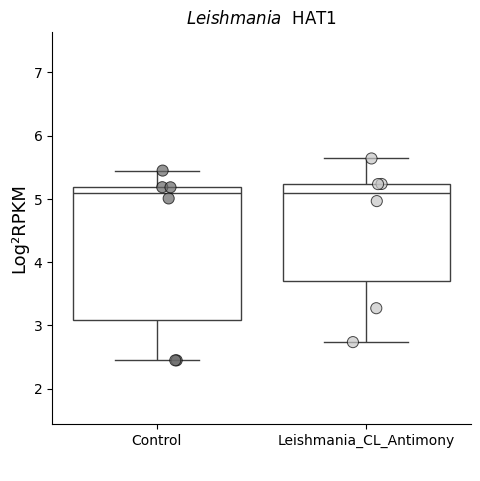

carregando


<Figure size 800x800 with 0 Axes>

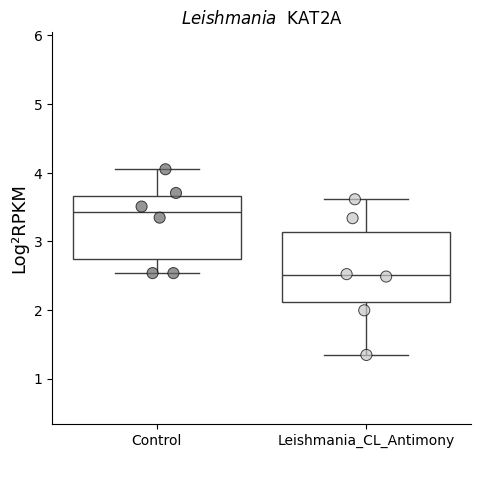

carregando


<Figure size 800x800 with 0 Axes>

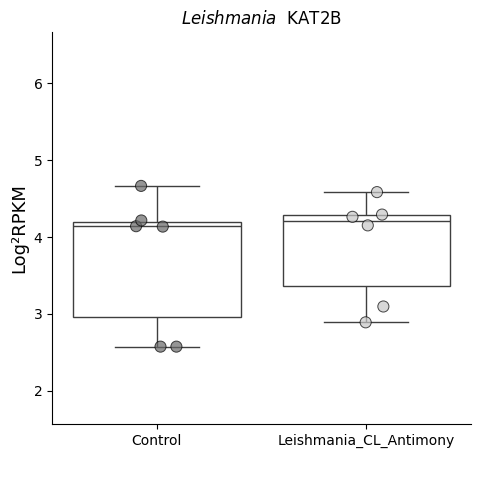

carregando


<Figure size 800x800 with 0 Axes>

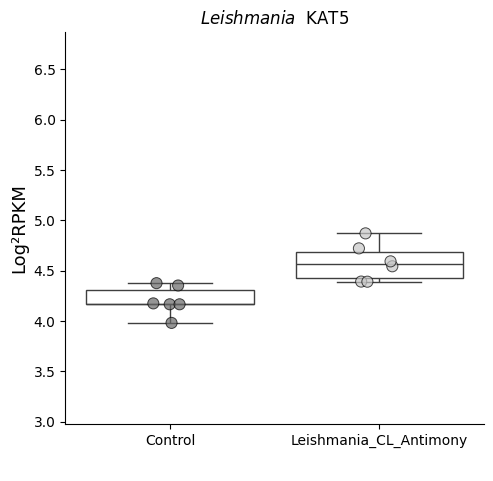

carregando


<Figure size 800x800 with 0 Axes>

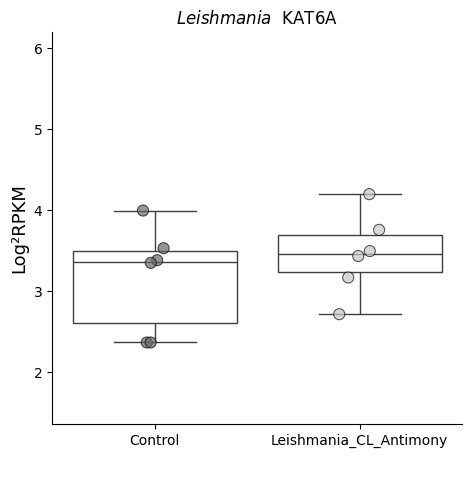

carregando


<Figure size 800x800 with 0 Axes>

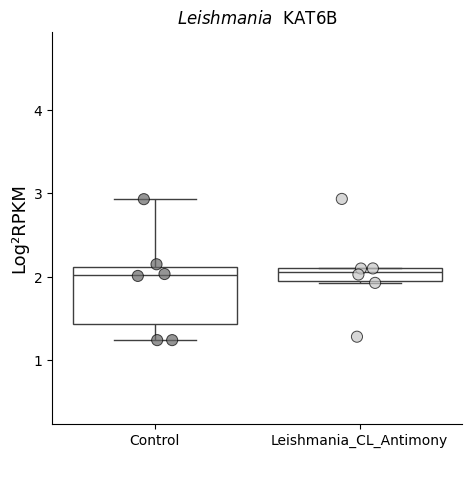

carregando


<Figure size 800x800 with 0 Axes>

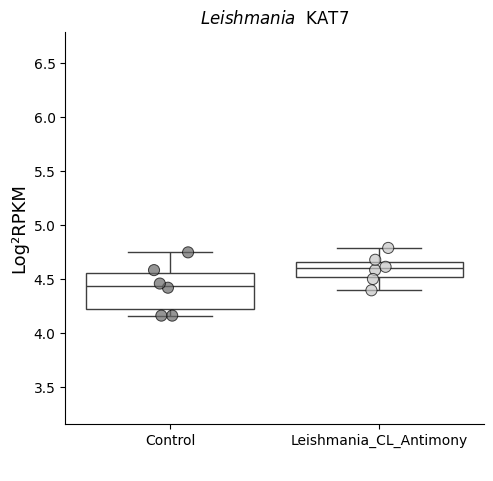

carregando


<Figure size 800x800 with 0 Axes>

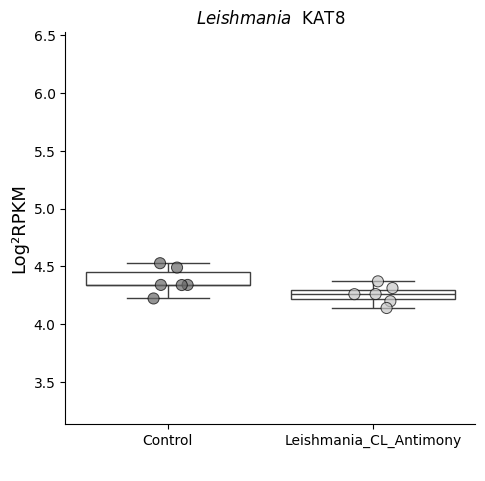

carregando


<Figure size 800x800 with 0 Axes>

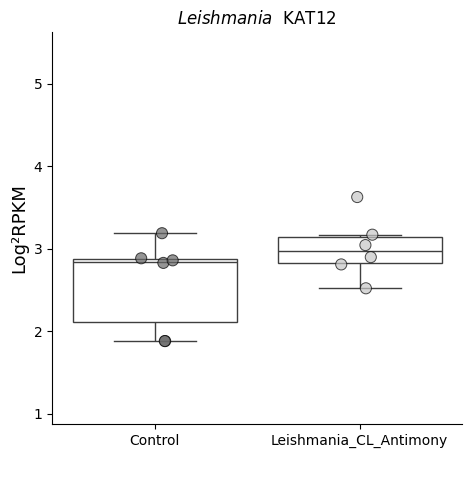

carregando


<Figure size 800x800 with 0 Axes>

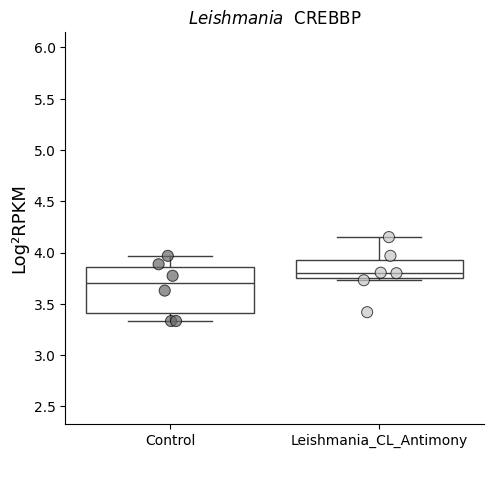

carregando


<Figure size 800x800 with 0 Axes>

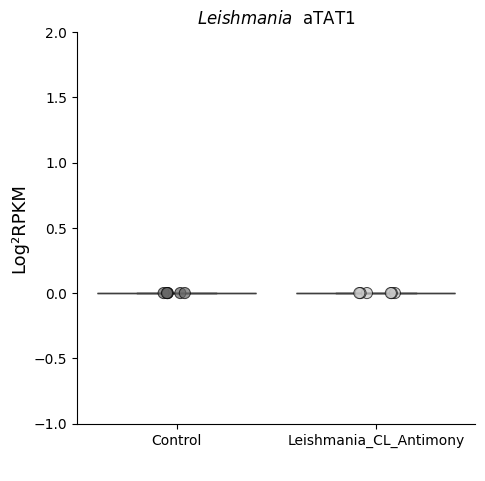

carregando


<Figure size 800x800 with 0 Axes>

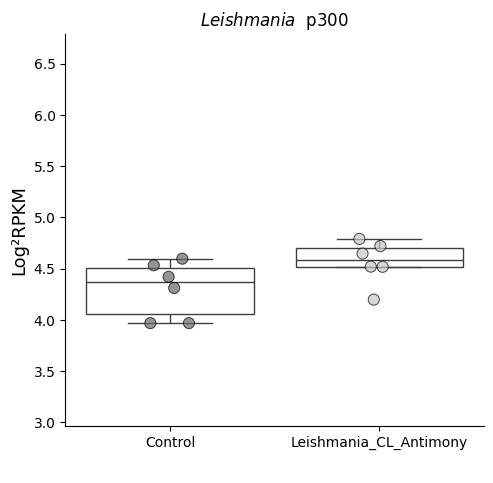

carregando


<Figure size 800x800 with 0 Axes>

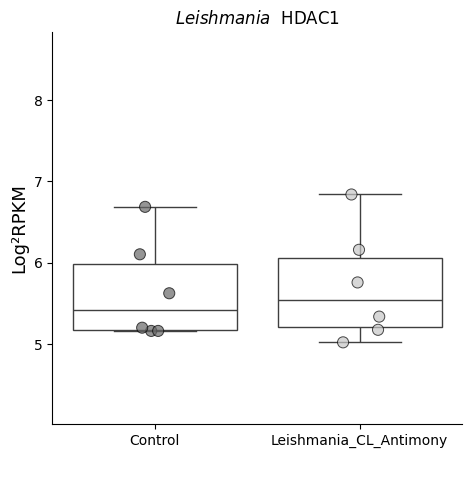

carregando


<Figure size 800x800 with 0 Axes>

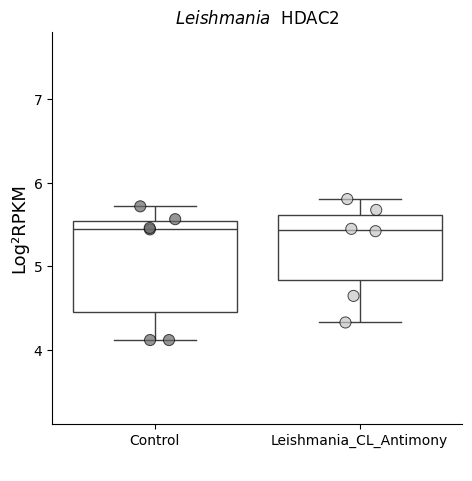

carregando


<Figure size 800x800 with 0 Axes>

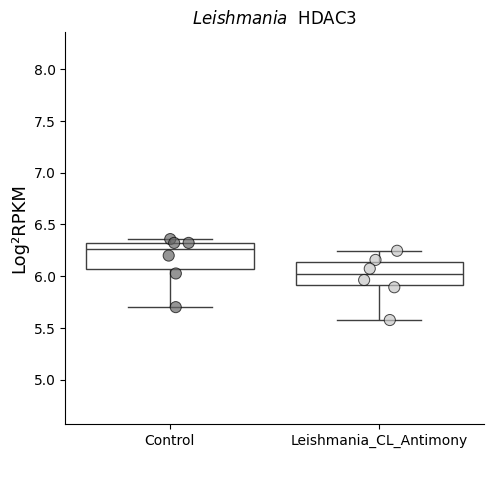

carregando


<Figure size 800x800 with 0 Axes>

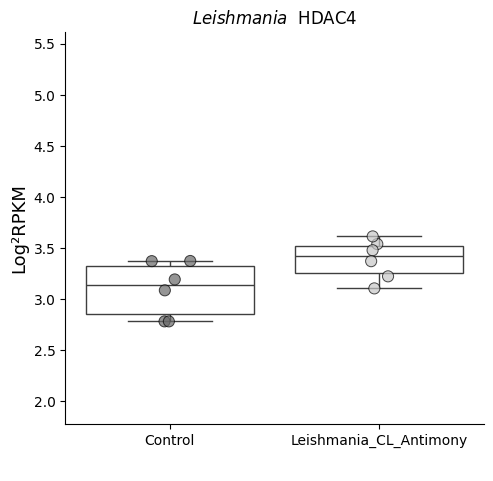

carregando


<Figure size 800x800 with 0 Axes>

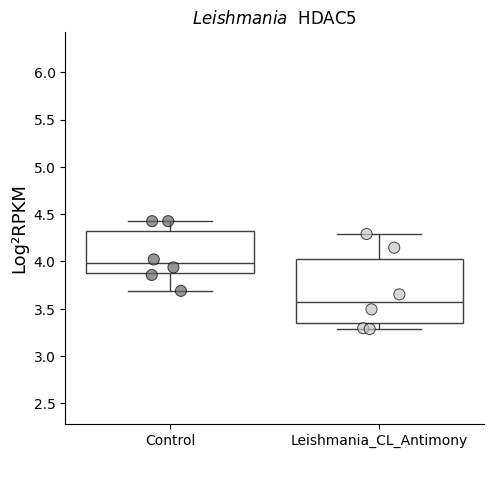

carregando


<Figure size 800x800 with 0 Axes>

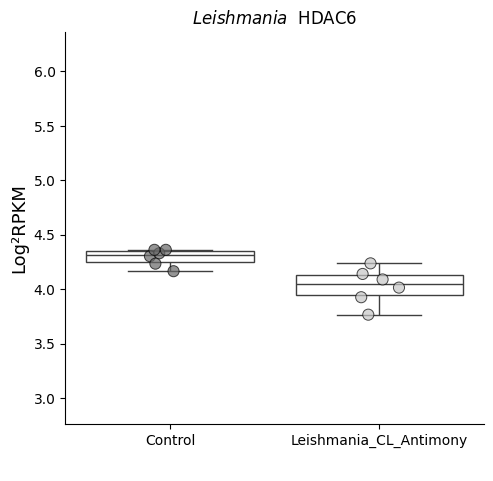

carregando


<Figure size 800x800 with 0 Axes>

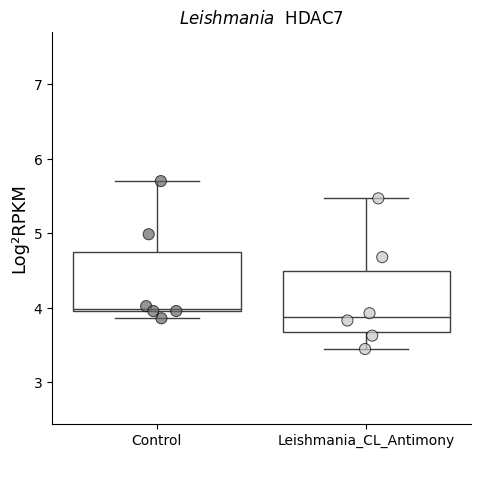

carregando


<Figure size 800x800 with 0 Axes>

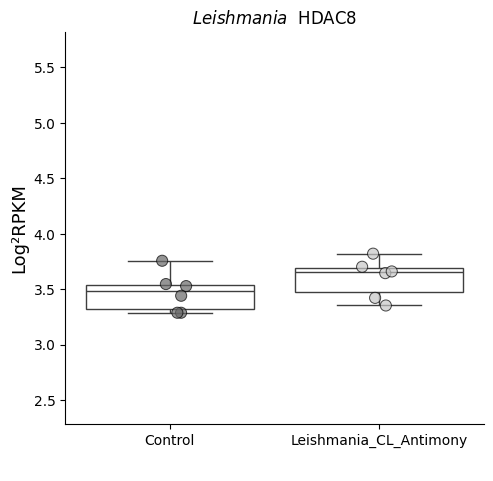

carregando


<Figure size 800x800 with 0 Axes>

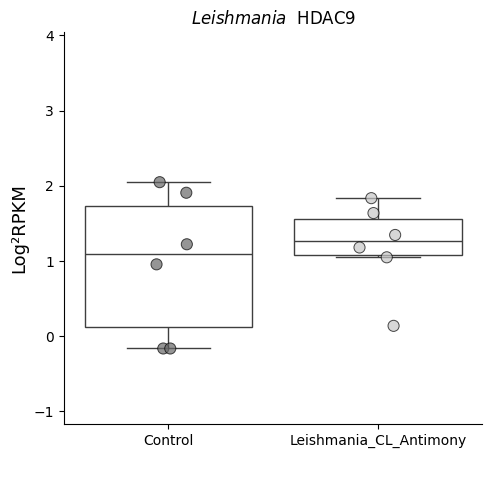

carregando


<Figure size 800x800 with 0 Axes>

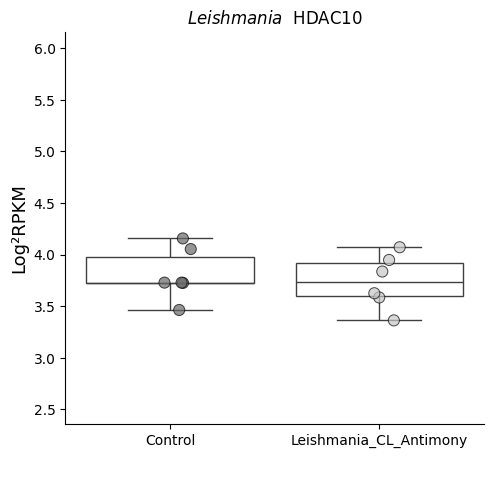

carregando


<Figure size 800x800 with 0 Axes>

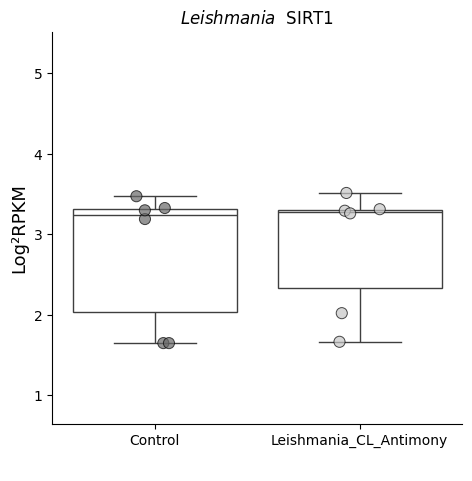

carregando


<Figure size 800x800 with 0 Axes>

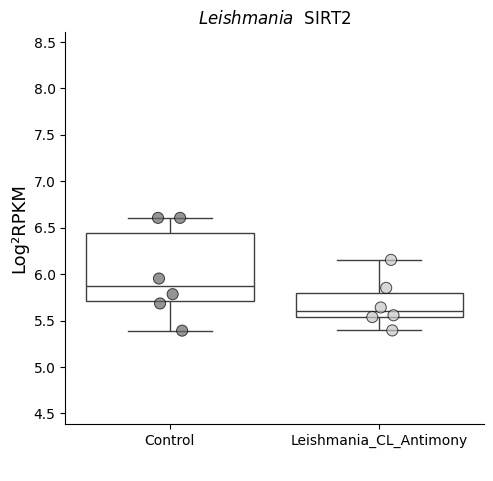

carregando


<Figure size 800x800 with 0 Axes>

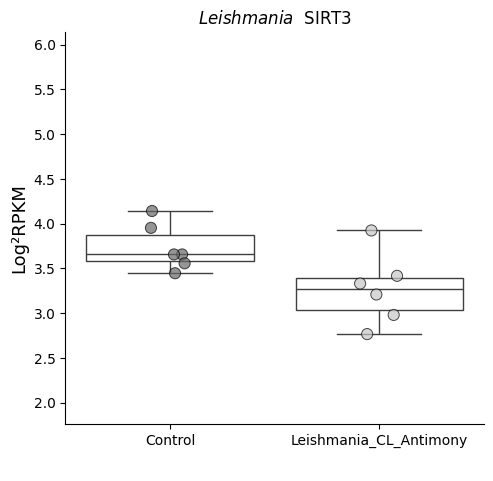

carregando


<Figure size 800x800 with 0 Axes>

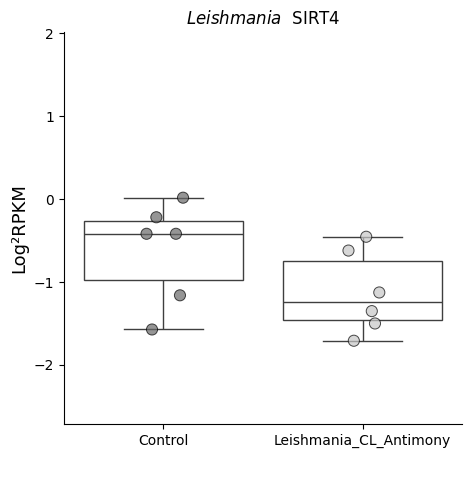

carregando


<Figure size 800x800 with 0 Axes>

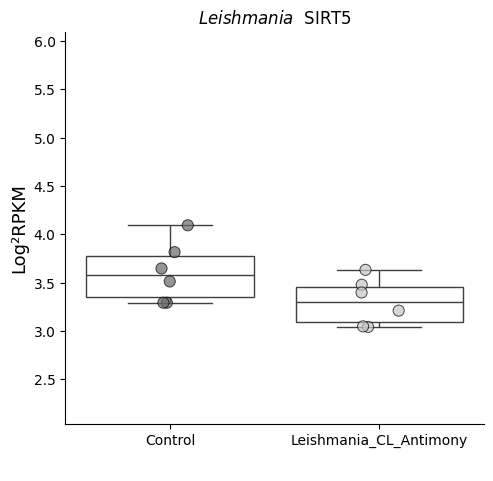

carregando


<Figure size 800x800 with 0 Axes>

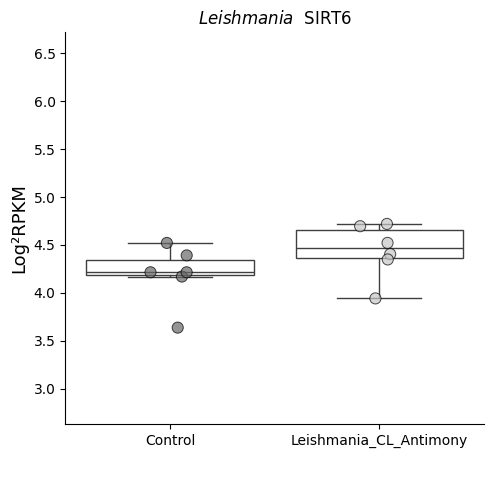

carregando


<Figure size 800x800 with 0 Axes>

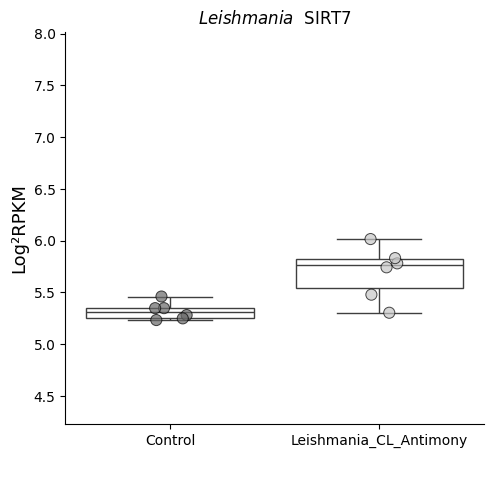

carregando


In [ ]:
graficos_boxplot(df_filtrado, "Greys", "Leishmania",       ['Control','Leishmania_CL_Antimony']       , nome)


##PRJNA656921  ✅


In [ ]:
id_gene_pasta="PRJNA656921"
PRJNA656921_tab = pd.read_excel(PRJNA656921 )
PRJNA656921_tab.head()

,Nome,BALB_c_Infected_Leish_pan_1_SRR13686167,BALB_c_Infected_Leish_pan_2_SRR13686168,BALB_c_Infected_Leish_pan_3_SRR13686169,BALB_c_Uninfected_1_SRR13686170,BALB_c_Uninfected_2_SRR13686173,BALB_c_Uninfected_3_SRR13686174,C57BL_6_Infected_Leish_pan_1_SRR13686163,C57BL_6_Infected_Leish_pan_2_SRR13686171,C57BL_6_Infected_Leish_pan_3_SRR13686172,C57BL_6_Uninfected_1_SRR13686164,C57BL_6_Uninfected_2_SRR13686165,C57BL_6_Uninfected_3_SRR13686166
0,YTHDF1,4.890024,4.769809,4.747054,4.822580,4.543177,4.794505,4.893815,4.872895,4.777331,4.835074,4.872628,4.949641
1,YTHDF2,4.911827,4.916012,4.817805,4.949777,4.860272,4.872430,4.851698,4.934872,4.904963,4.935687,4.922074,5.007599
2,YTHDF3,5.869357,5.678828,5.674400,6.106322,5.761756,5.969407,5.810952,5.912921,5.717506,6.091493,6.141286,6.320270
3,YTHDC1,5.090609,4.965702,4.943335,5.335202,5.205789,5.193850,4.753226,4.787449,4.678358,5.293569,5.353360,5.307850
4,FTO,4.779041,4.695461,4.634336,4.841501,4.683458,4.829651,5.020024,5.052756,4.990820,5.037439,5.008933,4.945797


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
PRJNA656921_df_filtrado = PRJNA656921_tab[PRJNA656921_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
PRJNA656921_df_filtrado.index = PRJNA656921_df_filtrado["Nome"]

PRJNA656921_df_filtrado = PRJNA656921_df_filtrado.T
df_filtrado = PRJNA656921_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
BALB_c_Infected_Leish_pan_1_SRR13686167,4.02375,4.278487,3.978473,4.70923,4.108054,1.957366,6.130603,3.55655,4.226021,2.830088,...,2.633917,1.555602,4.105499,3.56721,6.714336,3.259396,3.169612,2.517997,4.274923,5.938135
BALB_c_Infected_Leish_pan_2_SRR13686168,4.119938,4.364738,3.83505,4.719905,3.918681,1.756469,6.121507,3.613973,4.100005,2.659144,...,2.548227,1.242694,4.165552,3.398769,6.664865,3.469565,3.113788,2.48834,4.337654,6.046214
BALB_c_Infected_Leish_pan_3_SRR13686169,4.06032,4.330615,3.837753,4.749599,3.678438,1.607069,6.038026,3.67219,4.022616,2.367873,...,2.627121,0.946247,4.078776,3.430432,6.707261,3.454276,3.13454,2.485012,4.315687,6.063834
BALB_c_Uninfected_1_SRR13686170,3.431582,4.026726,4.461107,4.970994,4.327916,2.67813,6.101718,3.88539,4.293271,3.225814,...,2.798418,2.501691,4.689997,3.928609,6.741949,3.549616,3.449218,2.487611,3.907612,6.195466
BALB_c_Uninfected_2_SRR13686173,3.388975,4.054956,4.170594,5.052727,3.550822,2.084094,6.006239,4.229302,3.885452,2.423167,...,3.032261,2.173464,4.889033,3.662814,6.847205,3.734404,3.331654,2.503749,4.086991,6.47087


In [ ]:
df_filtrado.index.to_list()

['BALB_c_Infected_Leish_pan_1_SRR13686167',
 'BALB_c_Infected_Leish_pan_2_SRR13686168',
 'BALB_c_Infected_Leish_pan_3_SRR13686169',
 'BALB_c_Uninfected_1_SRR13686170',
 'BALB_c_Uninfected_2_SRR13686173',
 'BALB_c_Uninfected_3_SRR13686174',
 'C57BL_6_Infected_Leish_pan_1_SRR13686163',
 'C57BL_6_Infected_Leish_pan_2_SRR13686171',
 'C57BL_6_Infected_Leish_pan_3_SRR13686172',
 'C57BL_6_Uninfected_1_SRR13686164',
 'C57BL_6_Uninfected_2_SRR13686165',
 'C57BL_6_Uninfected_3_SRR13686166']

In [ ]:
df_filtrado["Status"] =      ['BALB_c_Infected',
'BALB_c_Infected',
'BALB_c_Infected',
'BALB_c_Uninfected',
'BALB_c_Uninfected',
'BALB_c_Uninfected',
'C57BL_6_Infected',
'C57BL_6_Infected',
'C57BL_6_Infected',
'C57BL_6_Uninfected',
'C57BL_6_Uninfected',
'C57BL_6_Uninfected']

<ipython-input-121-1329fa44fa27>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =      ['BALB_c_Infected',


In [ ]:
list(set(df_filtrado["Status"]))

['BALB_c_Uninfected',
 'C57BL_6_Infected',
 'C57BL_6_Uninfected',
 'BALB_c_Infected']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'BALB_c_Infected']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'BALB_c_Uninfected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.665146,0.275659,-0.611217,-0.278432,-0.229107,-0.747781,0.019789,-0.374924,-0.118363,-0.365361,...,-0.254394,-0.93077,-0.584498,-0.33449,-0.042656,-0.09534,-0.296219,0.000729,0.356367,-0.149252


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="BALB_c_Leishmania panamensis _PRJNA656921"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA656921/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Normal,Down,Normal,Normal,Down,Normal,Normal,Normal,Normal,...,Normal,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
list(set(df_filtrado["Status"]))


['BALB_c_Uninfected',
 'C57BL_6_Infected',
 'C57BL_6_Uninfected',
 'BALB_c_Infected']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'C57BL_6_Infected']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'C57BL_6_Uninfected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.55066,0.287506,-0.613827,-0.399908,-0.457128,-0.91579,-0.069002,-0.171824,-0.136899,-0.656459,...,-0.270937,-1.877207,-0.69745,-0.320797,0.159249,-0.354213,-0.486581,0.203217,0.259636,-0.199321


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="C57BL_6_Leishmania panamensis _PRJNA656921"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA656921/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Down,Normal,Normal,Down,Normal,Normal,Normal,Down,...,Normal,Down,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Down,Normal,Normal,Down,Normal,Normal,Normal,Down,...,Normal,Down,Down,Normal,Normal,Normal,Normal,Normal,Normal,Normal


<Figure size 800x800 with 0 Axes>

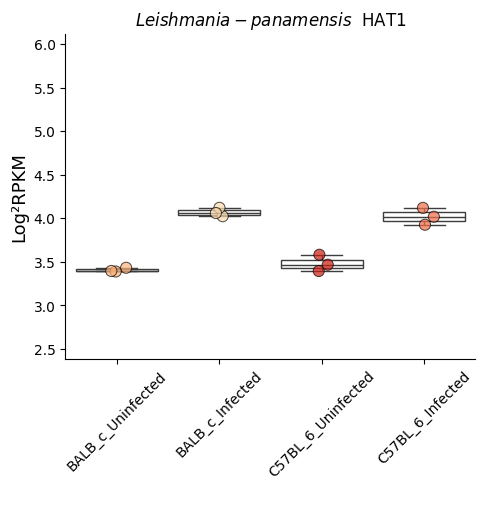

carregando


<Figure size 800x800 with 0 Axes>

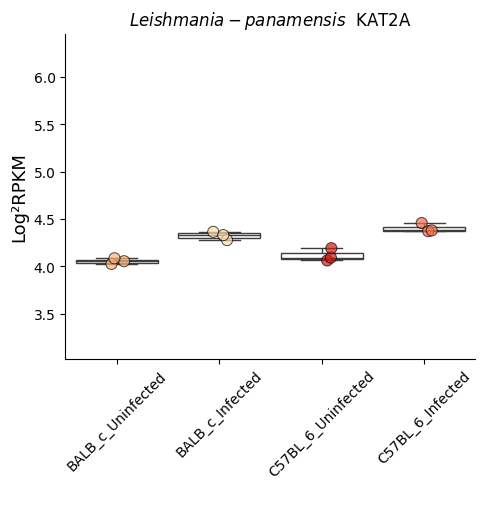

carregando


<Figure size 800x800 with 0 Axes>

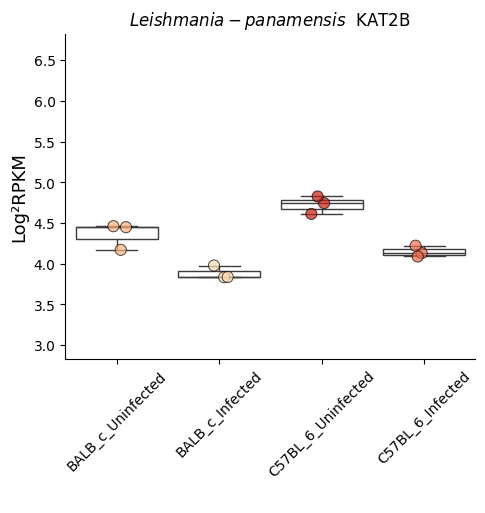

carregando


<Figure size 800x800 with 0 Axes>

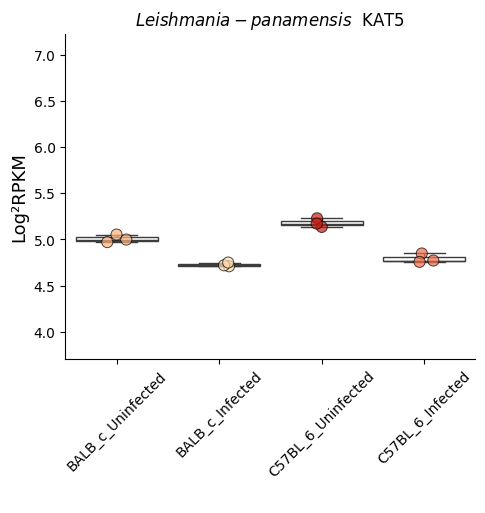

carregando


<Figure size 800x800 with 0 Axes>

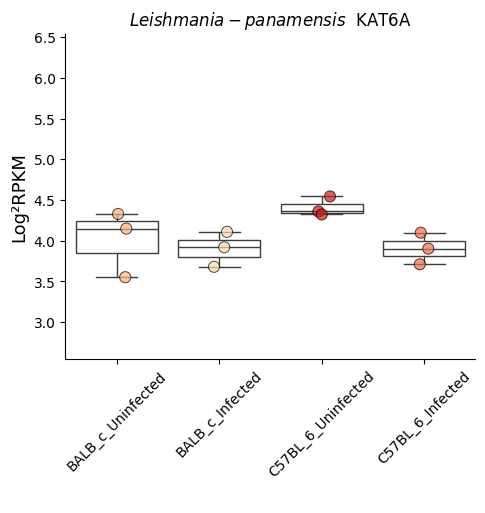

carregando


<Figure size 800x800 with 0 Axes>

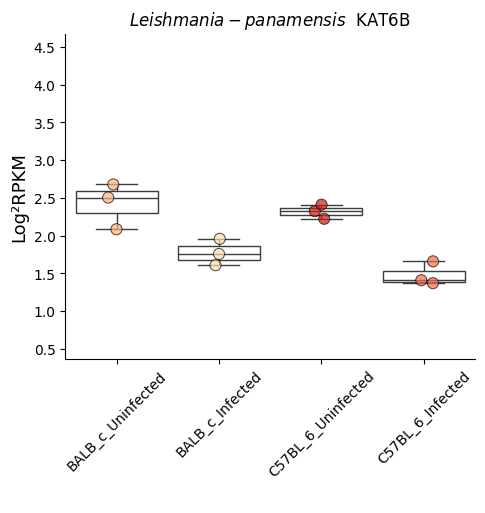

carregando


<Figure size 800x800 with 0 Axes>

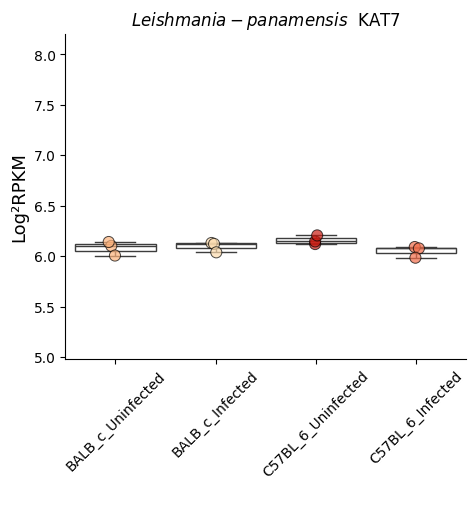

carregando


<Figure size 800x800 with 0 Axes>

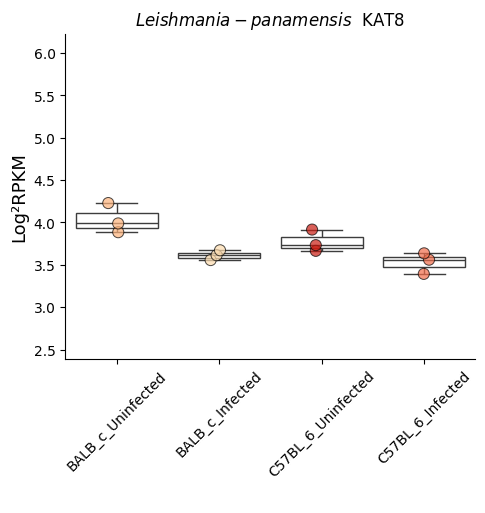

carregando


<Figure size 800x800 with 0 Axes>

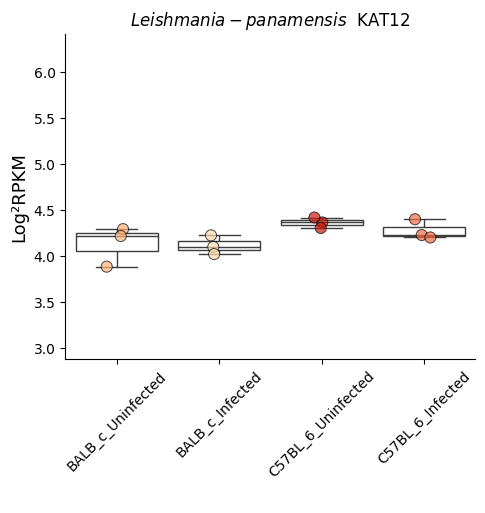

carregando


<Figure size 800x800 with 0 Axes>

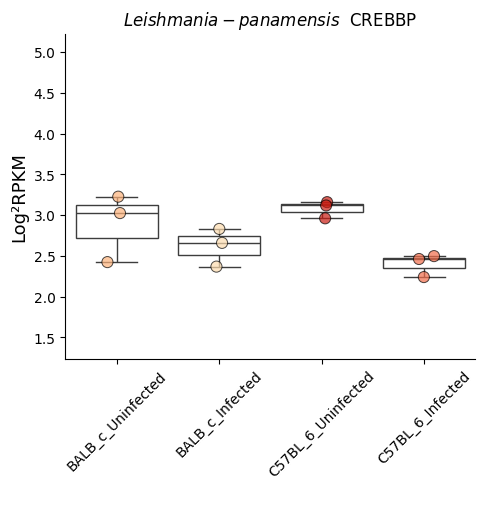

carregando


<Figure size 800x800 with 0 Axes>

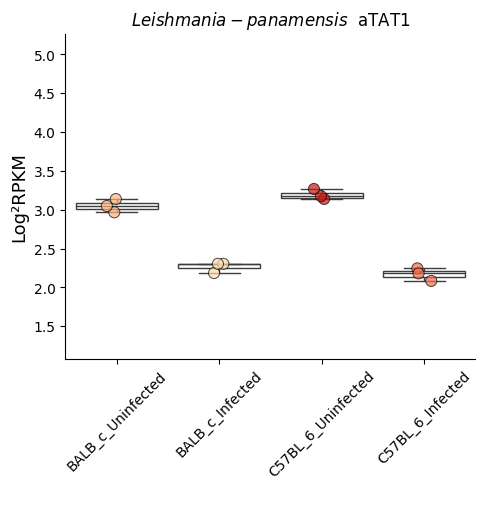

carregando


<Figure size 800x800 with 0 Axes>

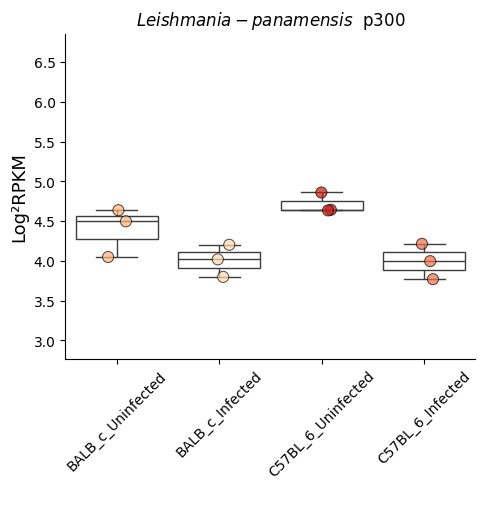

carregando


<Figure size 800x800 with 0 Axes>

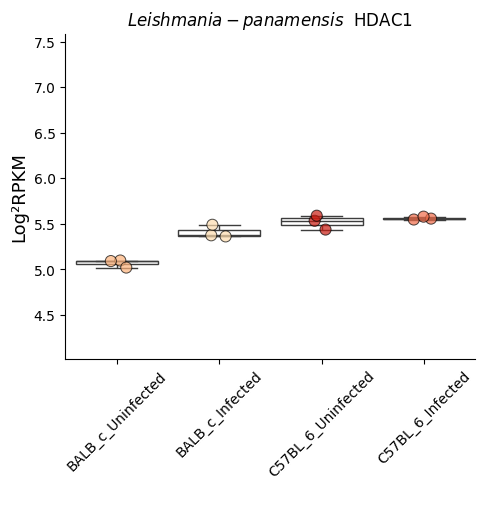

carregando


<Figure size 800x800 with 0 Axes>

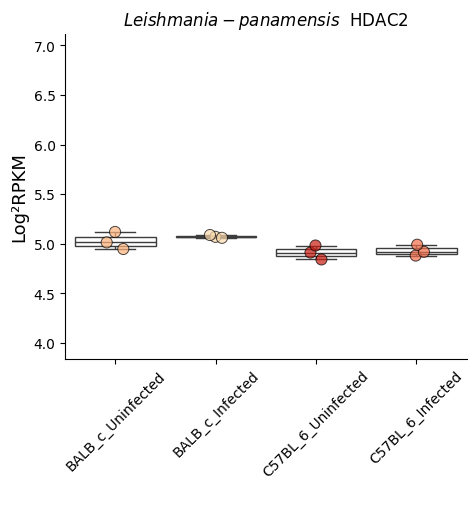

carregando


<Figure size 800x800 with 0 Axes>

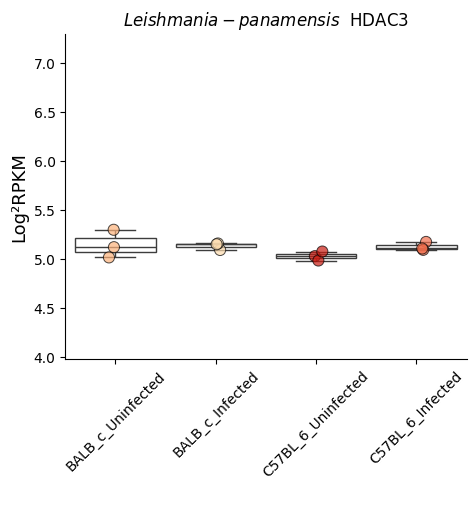

carregando


<Figure size 800x800 with 0 Axes>

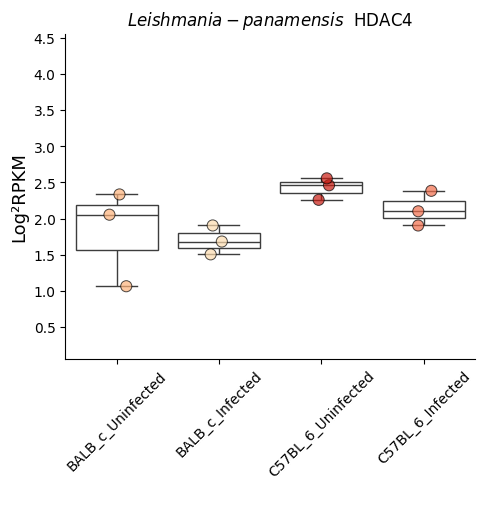

carregando


<Figure size 800x800 with 0 Axes>

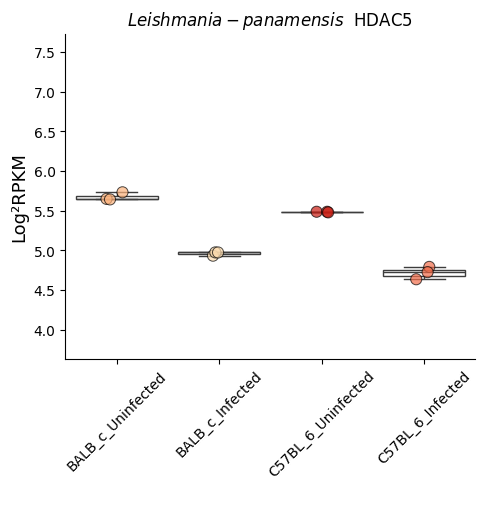

carregando


<Figure size 800x800 with 0 Axes>

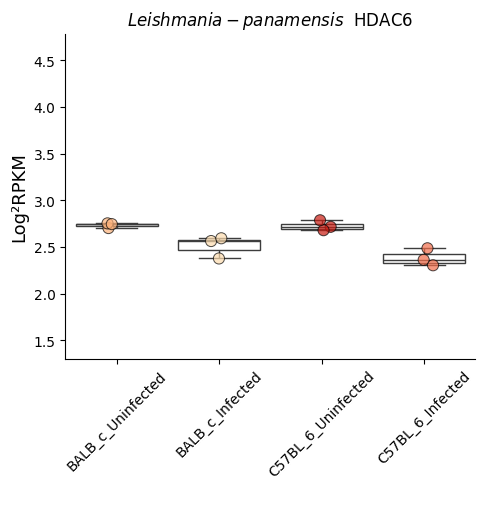

carregando


<Figure size 800x800 with 0 Axes>

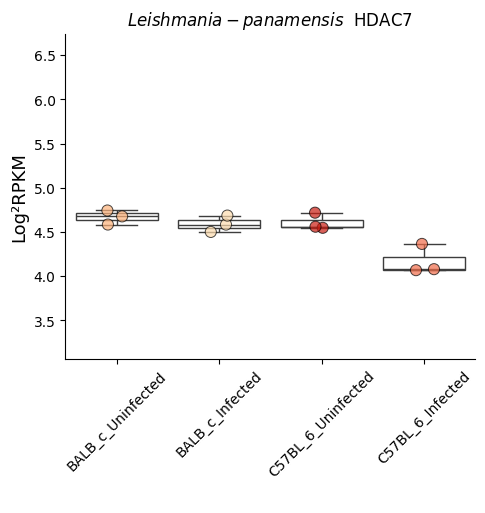

carregando


<Figure size 800x800 with 0 Axes>

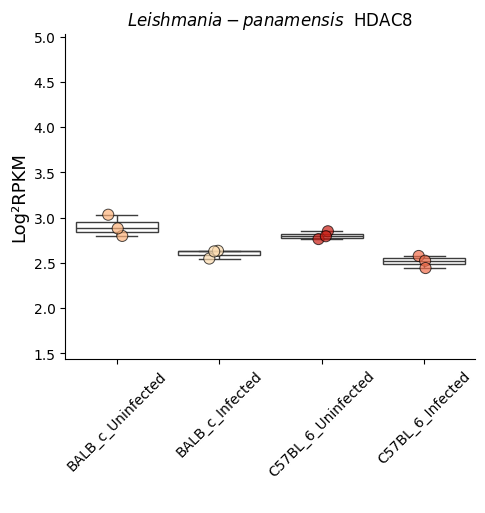

carregando


<Figure size 800x800 with 0 Axes>

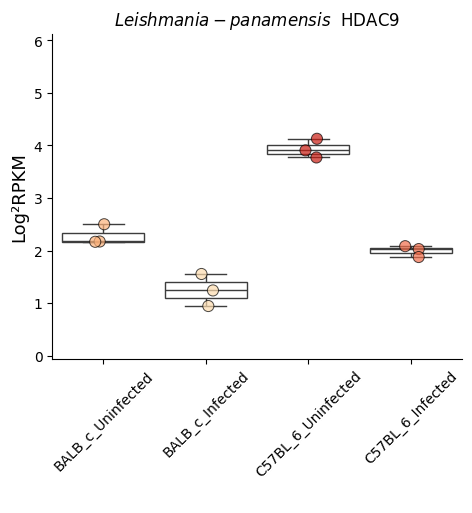

carregando


<Figure size 800x800 with 0 Axes>

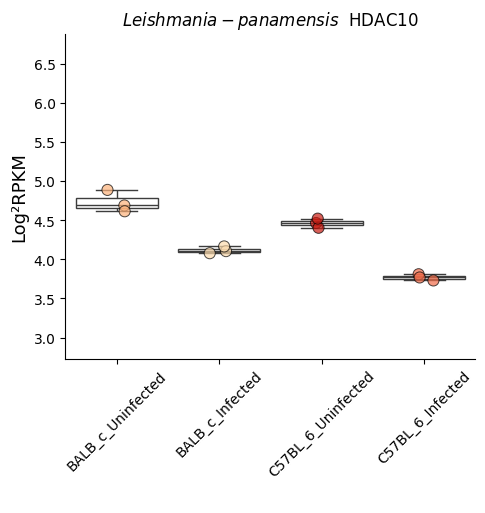

carregando


<Figure size 800x800 with 0 Axes>

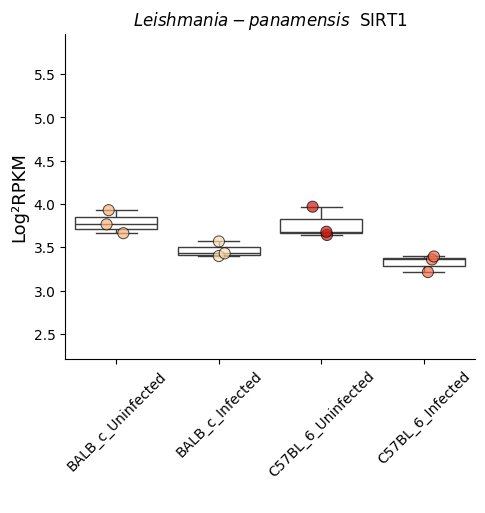

carregando


<Figure size 800x800 with 0 Axes>

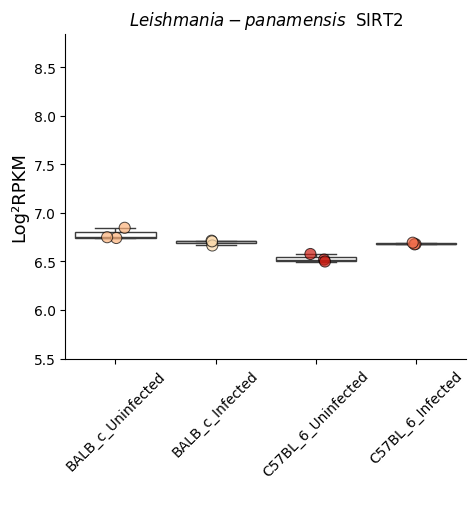

carregando


<Figure size 800x800 with 0 Axes>

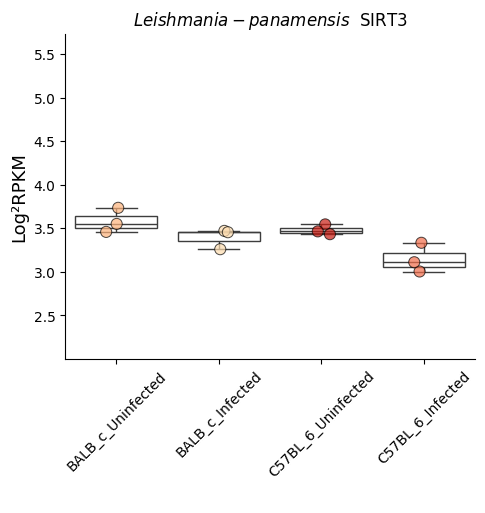

carregando


<Figure size 800x800 with 0 Axes>

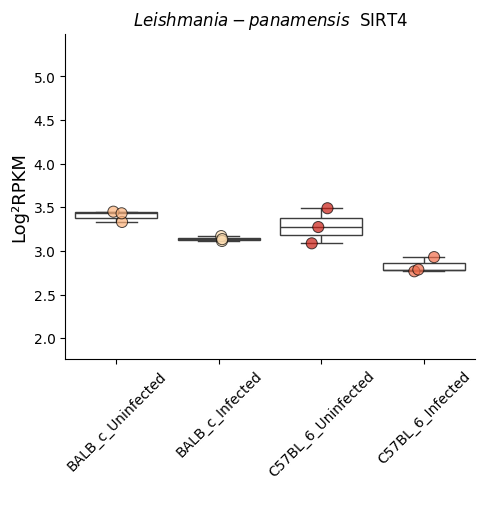

carregando


<Figure size 800x800 with 0 Axes>

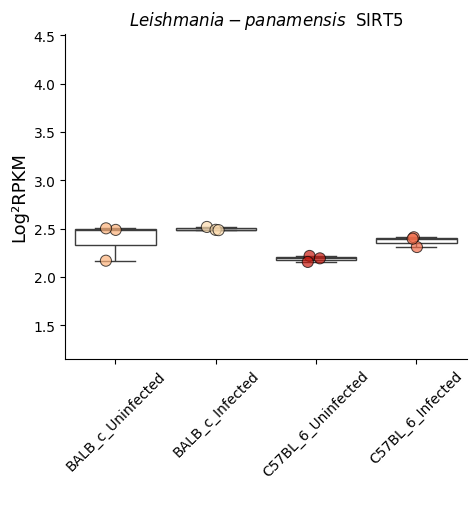

carregando


<Figure size 800x800 with 0 Axes>

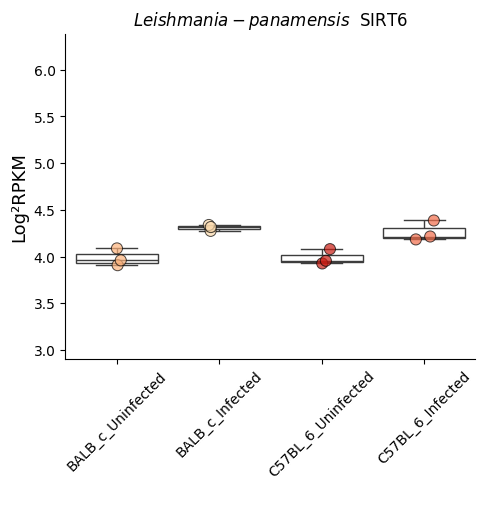

carregando


<Figure size 800x800 with 0 Axes>

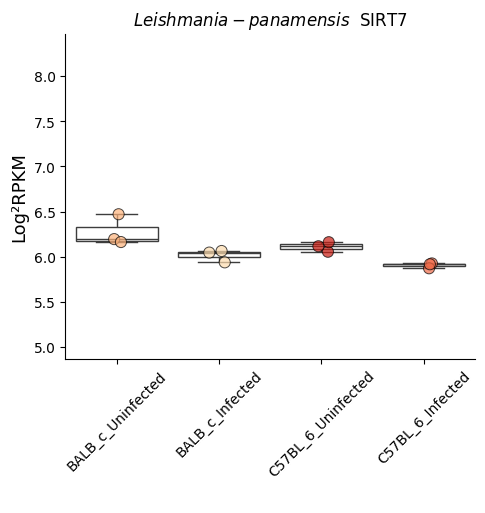

carregando


In [ ]:
graficos_boxplot(df_filtrado, "OrRd", "Leishmania-panamensis",   ['BALB_c_Uninfected',  "BALB_c_Infected", 'C57BL_6_Uninfected','C57BL_6_Infected']       , "Leishmania-panamensis")


##PRJNA838552  ✅

In [ ]:
id_gene_pasta="PRJNA838552"
PRJNA838552_tab = pd.read_excel(PRJNA838552 )
PRJNA838552_tab.head()

,Nome,Mo_Infected_LgyLRV1(+)_24h_1_SRR19221390,Mo_Infected_LgyLRV1(+)_24h_2_SRR19221394,Mo_Infected_LgyLRV1(+)_24h_3_SRR19221400,Mo_Infected_LgyLRV1(+)_8h_1_SRR19221375,Mo_Infected_LgyLRV1(+)_8h_2_SRR19221379,Mo_Infected_LgyLRV1(+)_8h_3_SRR19221385,Mo_Infected_LgyLRV1(-)_24h_1_SRR19221391,Mo_Infected_LgyLRV1(-)_24h_2_SRR19221395,Mo_Infected_LgyLRV1(-)_24h_3_SRR19221401,Mo_Infected_LgyLRV1(-)_8h_1_SRR19221376,Mo_Infected_LgyLRV1(-)_8h_2_SRR19221380,Mo_Infected_LgyLRV1(-)_8h_3_SRR19221389
0,YTHDF1,5.313177,5.382536,5.424555,6.399866,6.291965,6.262216,4.984753,5.029789,5.017859,5.542514,5.518275,5.482732
1,YTHDF2,5.122878,5.148659,5.226316,4.649949,4.722586,4.651482,5.382257,5.389969,5.253647,5.518997,5.307562,5.423667
2,YTHDF3,6.216260,6.117960,6.161390,5.733311,5.609926,5.437926,6.069533,6.411088,6.213959,6.164147,6.033260,5.941068
3,YTHDC1,5.025732,5.117501,5.194863,4.923182,5.034067,5.135225,5.120279,4.980811,5.125698,5.208886,5.311281,5.226404
4,FTO,4.362082,4.405340,4.379874,3.139058,3.402546,3.477345,5.104979,5.054318,5.047113,4.760536,4.855641,4.901145


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
PRJNA838552_df_filtrado = PRJNA838552_tab[PRJNA838552_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
PRJNA838552_df_filtrado.index = PRJNA838552_df_filtrado["Nome"]

PRJNA838552_df_filtrado = PRJNA838552_df_filtrado.T
df_filtrado = PRJNA838552_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
Mo_Infected_LgyLRV1(+)_24h_1_SRR19221390,5.696144,3.303371,5.542838,4.883871,4.759036,0.93319,6.07394,3.08907,4.113371,2.861644,...,1.810447,-0.118197,1.330926,3.758481,6.348696,2.33523,1.364494,0.341897,3.978159,5.433412
Mo_Infected_LgyLRV1(+)_24h_2_SRR19221394,5.692259,3.432894,5.580617,4.738224,4.775142,0.991175,6.191932,3.291244,4.128746,2.707724,...,1.782517,-0.529016,1.605362,3.765976,6.39717,2.675925,1.323625,0.929059,4.086025,5.353428
Mo_Infected_LgyLRV1(+)_24h_3_SRR19221400,5.726038,3.432448,5.56572,4.834678,4.819438,1.121744,6.243414,3.14298,4.172961,2.700201,...,1.694634,-0.416874,1.369769,3.750012,6.288301,2.584451,1.350494,0.625608,3.910679,5.204775
Mo_Infected_LgyLRV1(+)_8h_1_SRR19221375,7.064337,1.871844,5.922111,4.667022,4.965817,-0.434247,5.553905,2.392561,3.277604,2.40593,...,-0.157406,1.020592,-1.10726,5.004124,5.90603,0.098153,-0.274324,-0.823467,3.132296,4.40258
Mo_Infected_LgyLRV1(+)_8h_2_SRR19221379,6.998822,1.972988,5.91062,4.66335,4.922561,-0.369752,5.705821,2.320345,3.347345,2.469288,...,0.372647,0.152763,-2.008846,4.800056,5.976721,-0.236802,0.110613,-0.271881,2.928301,4.363243


In [ ]:
df_filtrado.index.to_list()

['Mo_Infected_LgyLRV1(+)_24h_1_SRR19221390',
 'Mo_Infected_LgyLRV1(+)_24h_2_SRR19221394',
 'Mo_Infected_LgyLRV1(+)_24h_3_SRR19221400',
 'Mo_Infected_LgyLRV1(+)_8h_1_SRR19221375',
 'Mo_Infected_LgyLRV1(+)_8h_2_SRR19221379',
 'Mo_Infected_LgyLRV1(+)_8h_3_SRR19221385',
 'Mo_Infected_LgyLRV1(-)_24h_1_SRR19221391',
 'Mo_Infected_LgyLRV1(-)_24h_2_SRR19221395',
 'Mo_Infected_LgyLRV1(-)_24h_3_SRR19221401',
 'Mo_Infected_LgyLRV1(-)_8h_1_SRR19221376',
 'Mo_Infected_LgyLRV1(-)_8h_2_SRR19221380',
 'Mo_Infected_LgyLRV1(-)_8h_3_SRR19221389']

In [ ]:
# df_filtrado["Status"] =     [
# 'Infected_LRV1(+)',
# 'Infected_LRV1(+)',
# 'Infected_LRV1(+)',
# 'Infected_LRV1(+)',
# 'Infected_LRV1(+)',
# 'Infected_LRV1(+)',

# 'Infected_LRV1(-)',
# 'Infected_LRV1(-)',
# 'Infected_LRV1(-)',
# 'Infected_LRV1(-)',
# 'Infected_LRV1(-)',
# 'Infected_LRV1(-)']

# df_filtrado["Patient"] =     ['24h',
# '24h',
# '24h',
# '8h',
# '8h',
# '8h',
# '24h',
# '24h',
# '24h',
# '8h',
# '8h',
# '8h']

df_filtrado["Status"] =     ['Infected_LRV1(+)_24h',
'Infected_LRV1(+)_24h',
'Infected_LRV1(+)_24h',
'Infected_LRV1(+)_8h',
'Infected_LRV1(+)_8h',
'Infected_LRV1(+)_8h',
'Infected_LRV1(-)_24h',
'Infected_LRV1(-)_24h',
'Infected_LRV1(-)_24h',
'Infected_LRV1(-)_8h',
'Infected_LRV1(-)_8h',
'Infected_LRV1(-)_8h']

<ipython-input-231-3eca62b33a56>:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =     ['Infected_LRV1(+)_24h',


In [ ]:
list(set(df_filtrado["Status"]))


['Infected_LRV1(+)_8h',
 'Infected_LRV1(+)_24h',
 'Infected_LRV1(-)_24h',
 'Infected_LRV1(-)_8h']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] ==   'Infected_LRV1(+)_8h'  ]
uninfected_data = df_filtrado[df_filtrado['Status'] ==  'Infected_LRV1(-)_8h']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,1.988429,-2.145377,1.254229,-0.334753,0.222592,-1.847084,-0.487557,-0.937823,-1.418647,-0.227982,...,-1.578884,0.018797,-2.073701,1.001736,-0.247348,-1.875796,-1.17611,-1.414022,0.195215,-0.923208


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania guyanensis_8h_PRJNA838552"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA838552/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Down,UP,Normal,Normal,Down,Normal,Down,Down,Normal,...,Down,Normal,Down,UP,Normal,Down,Down,Down,Normal,Down


In [ ]:

#############################################################
infected_data = df_filtrado[df_filtrado['Status'] ==   'Infected_LRV1(+)_24h'  ]
uninfected_data = df_filtrado[df_filtrado['Status'] ==  'Infected_LRV1(-)_24h'  ]
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,1.527434,-0.636282,1.03364,-0.112375,0.115653,-0.836014,-0.095611,-0.151674,-0.437984,-0.014156,...,-0.843126,-2.5385,-0.912969,-0.050939,-0.189783,-0.607083,-0.234865,-0.871223,0.882305,-0.265005


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania guyanensis_24h_PRJNA838552"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA838552/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Down,UP,Normal,Normal,Down,Normal,Normal,Normal,Normal,...,Down,Down,Down,Normal,Normal,Down,Normal,Down,UP,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.catplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        ax.fig.subplots_adjust(bottom=0.30)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC7,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6
valores,UP,Down,UP,Normal,Normal,Down,Normal,Normal,Normal,Normal,...,Normal,Down,Down,Down,Normal,Normal,Down,Normal,Down,UP


<Figure size 800x800 with 0 Axes>

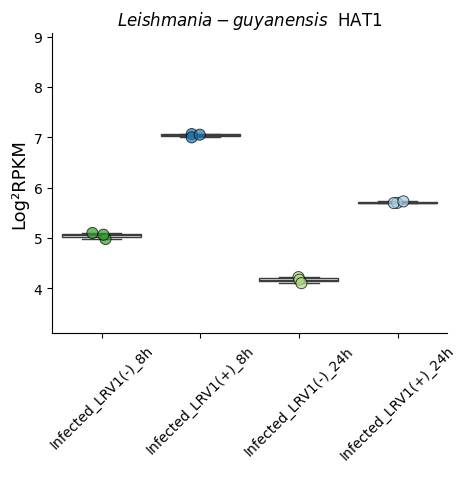

carregando


<Figure size 800x800 with 0 Axes>

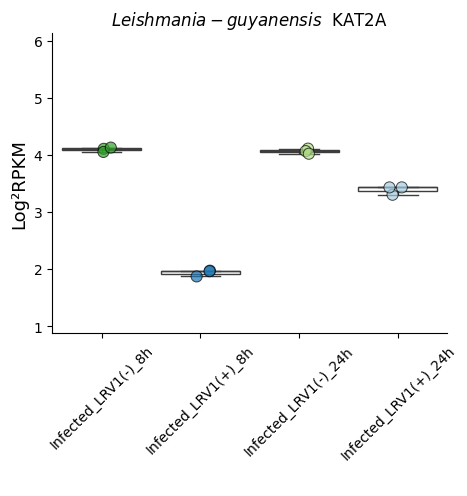

carregando


<Figure size 800x800 with 0 Axes>

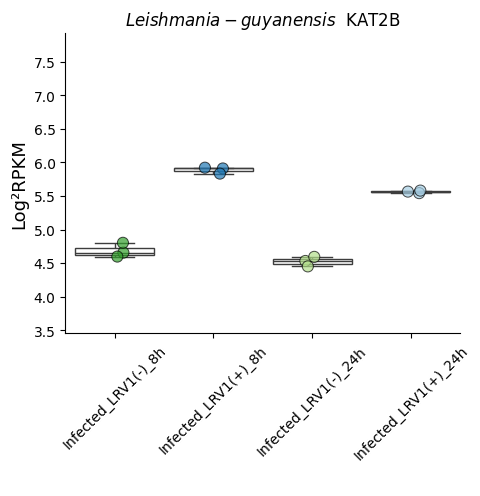

carregando


<Figure size 800x800 with 0 Axes>

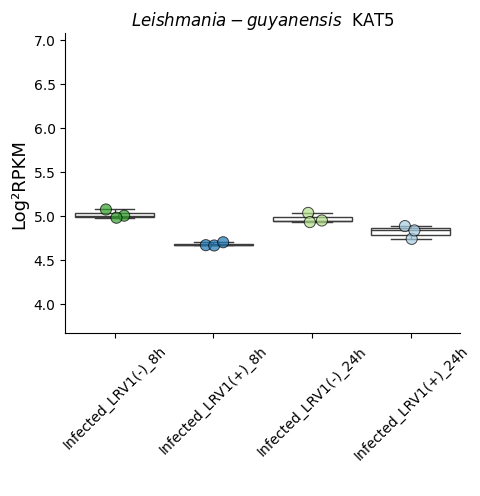

carregando


<Figure size 800x800 with 0 Axes>

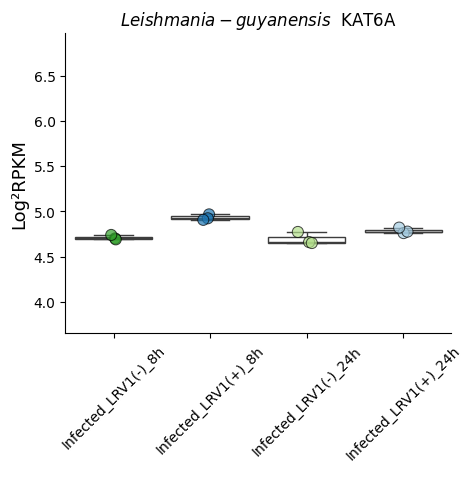

carregando


<Figure size 800x800 with 0 Axes>

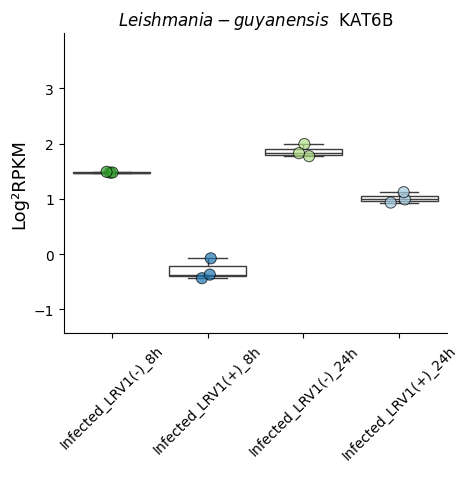

carregando


<Figure size 800x800 with 0 Axes>

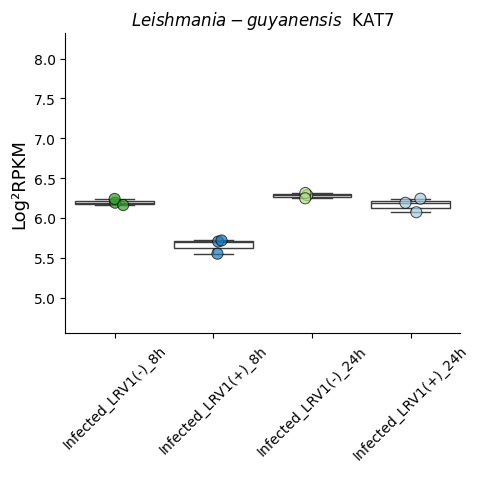

carregando


<Figure size 800x800 with 0 Axes>

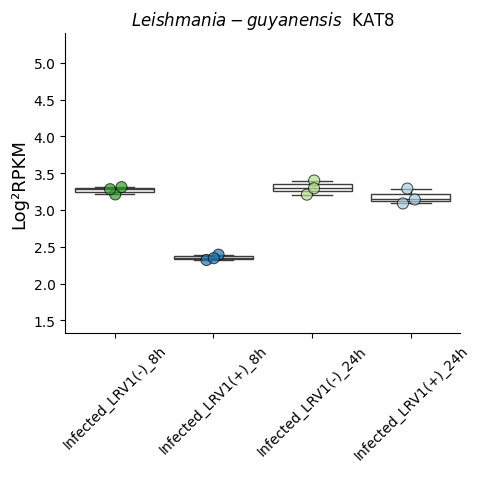

carregando


<Figure size 800x800 with 0 Axes>

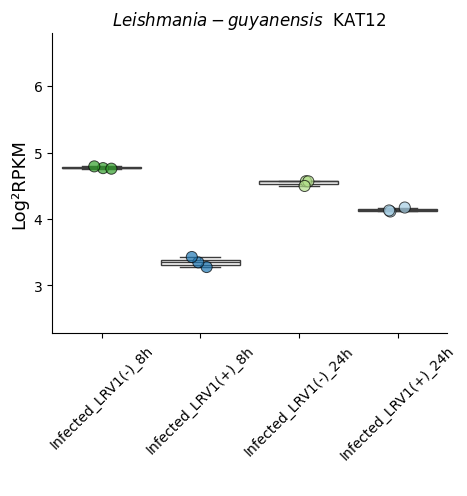

carregando


<Figure size 800x800 with 0 Axes>

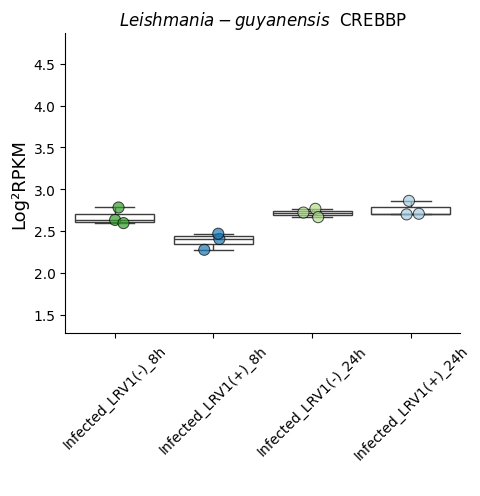

carregando


<Figure size 800x800 with 0 Axes>

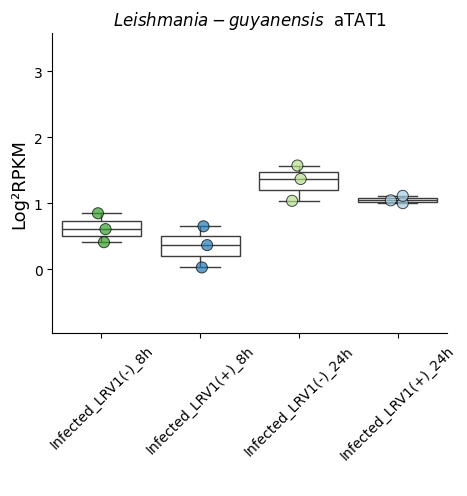

carregando


<Figure size 800x800 with 0 Axes>

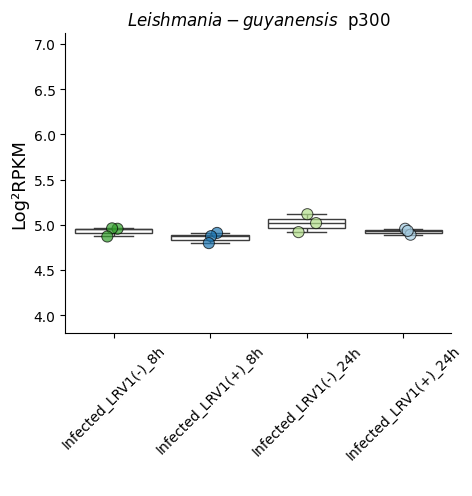

carregando


<Figure size 800x800 with 0 Axes>

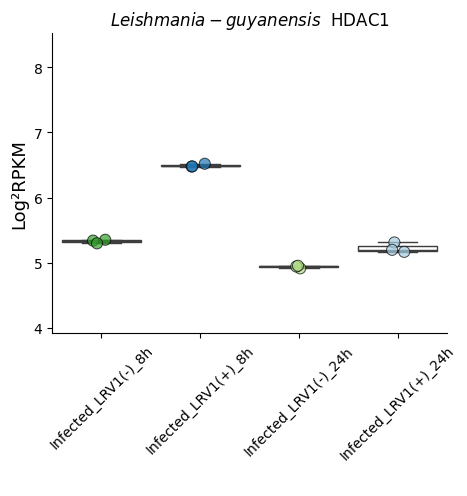

carregando


<Figure size 800x800 with 0 Axes>

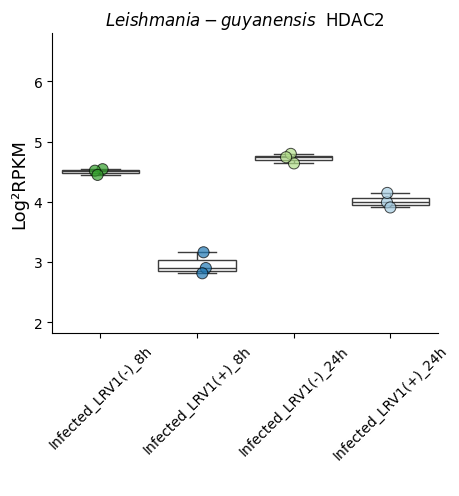

carregando


<Figure size 800x800 with 0 Axes>

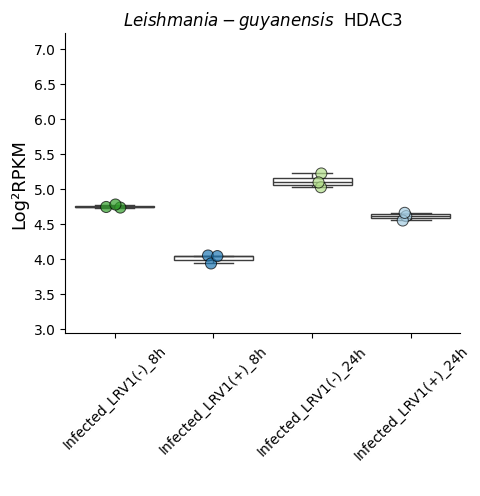

carregando


<Figure size 800x800 with 0 Axes>

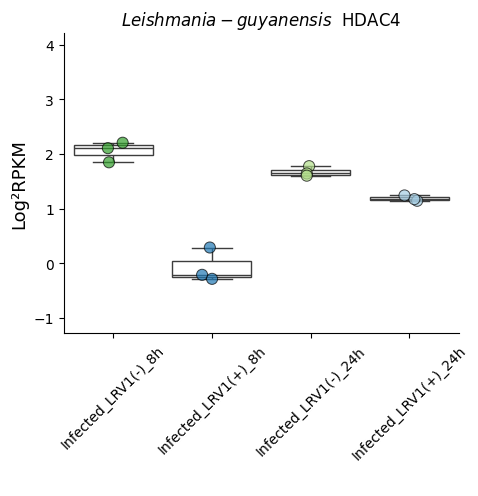

carregando


<Figure size 800x800 with 0 Axes>

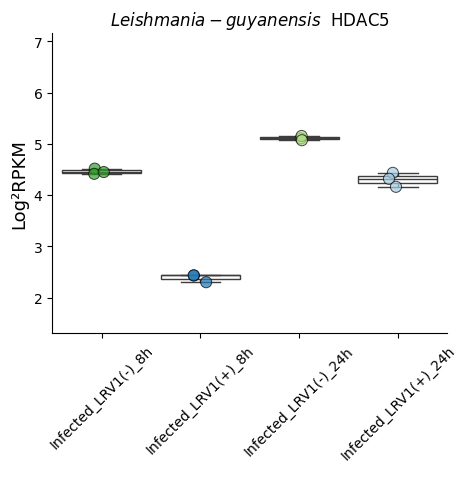

carregando


<Figure size 800x800 with 0 Axes>

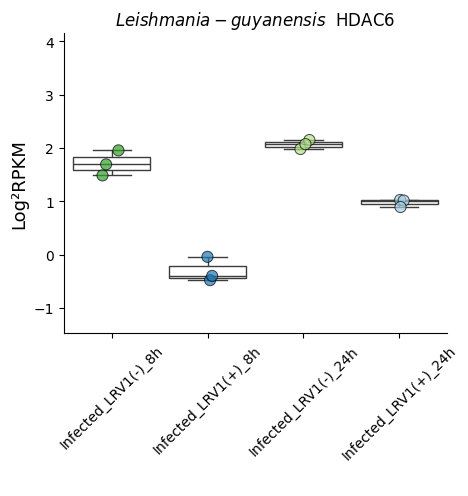

carregando


<Figure size 800x800 with 0 Axes>

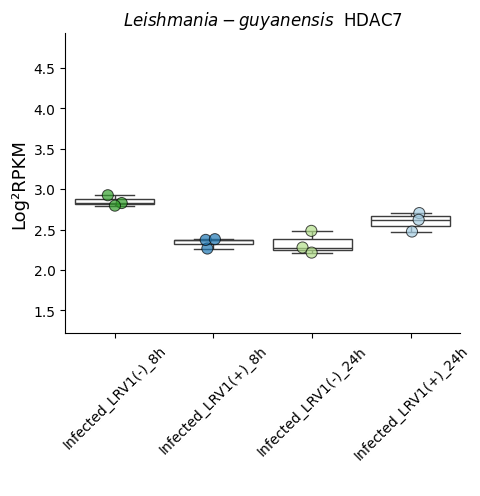

carregando


<Figure size 800x800 with 0 Axes>

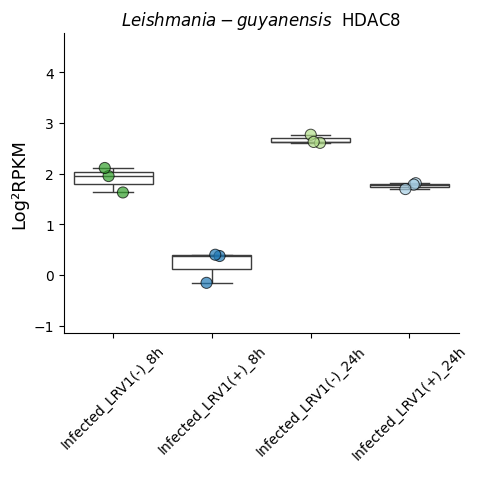

carregando


<Figure size 800x800 with 0 Axes>

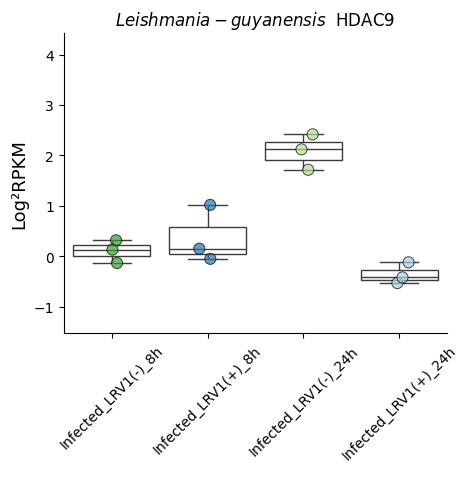

carregando


<Figure size 800x800 with 0 Axes>

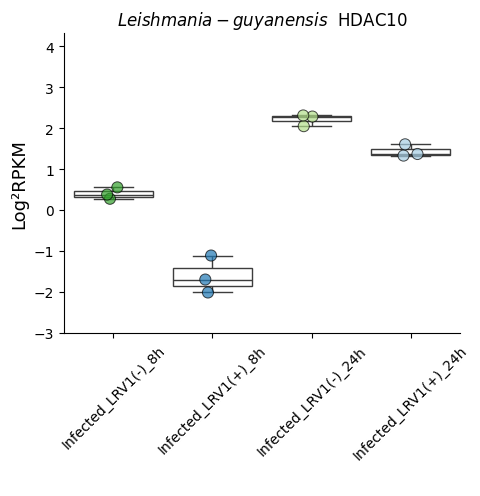

carregando


<Figure size 800x800 with 0 Axes>

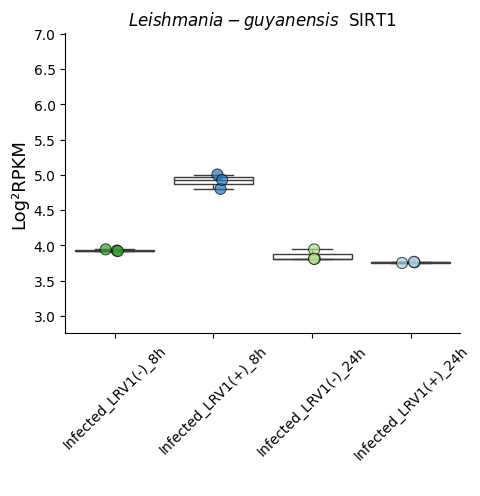

carregando


<Figure size 800x800 with 0 Axes>

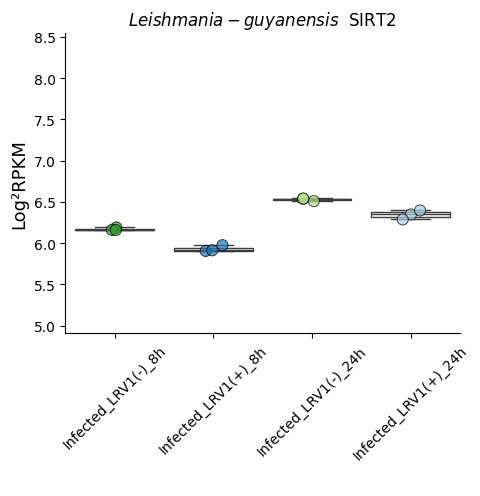

carregando


<Figure size 800x800 with 0 Axes>

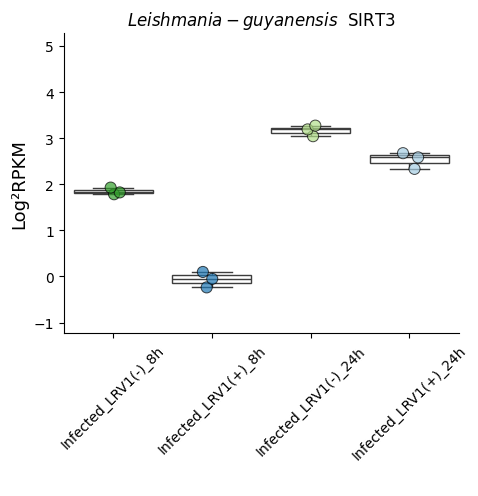

carregando


<Figure size 800x800 with 0 Axes>

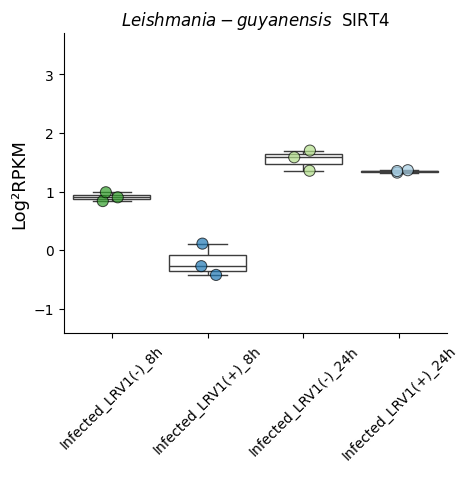

carregando


<Figure size 800x800 with 0 Axes>

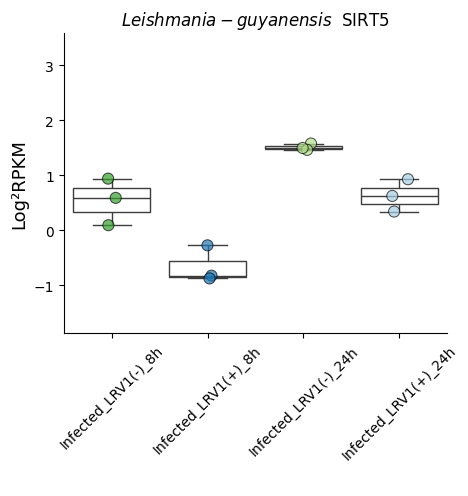

carregando


<Figure size 800x800 with 0 Axes>

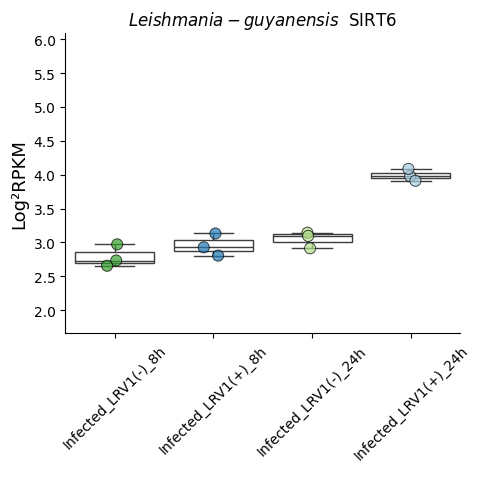

carregando


<Figure size 800x800 with 0 Axes>

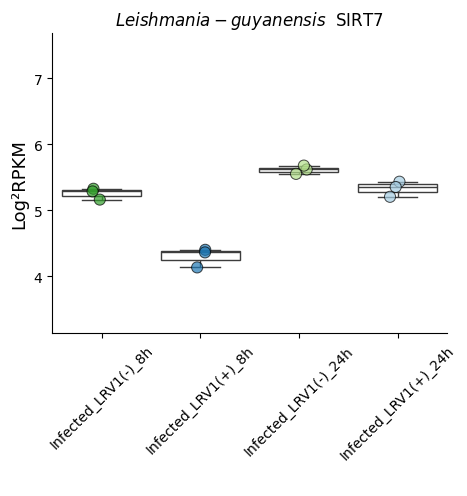

carregando


In [ ]:
graficos_boxplot(df_filtrado, "Paired", "Leishmania-guyanensis",    ['Infected_LRV1(-)_8h','Infected_LRV1(+)_8h','Infected_LRV1(-)_24h','Infected_LRV1(+)_24h']         , "Leishmania-guyanensis")


##SRP009251  ✅

In [ ]:
id_gene_pasta="SRP009251"
SRP009251_tab = pd.read_excel(SRP009251 )
SRP009251_tab.head()

,Nome,Lbr_Localized_Cutaneous_1_SRR363756,Lbr_Localized_Cutaneous_2_SRR363757,Lbr_Localized_Cutaneous_3_SRR363758,Lbr_Localized_Cutaneous_4_SRR363759,Lbr_Localized_Cutaneous_5_SRR363760,Lbr_Localized_Mucosal_1_SRR363761,Lbr_Localized_Mucosal_2_SRR363762,Lbr_Localized_Mucosal_3_SRR363763,Lbr_Localized_Mucosal_4_SRR363764,Lbr_Localized_Mucosal_5_SRR363765
0,YTHDF1,4.583280,4.441620,4.200017,4.939286,4.693604,4.993461,4.376325,4.336851,4.787898,4.527176
1,YTHDF2,4.165083,2.940332,3.485818,4.422093,3.823736,4.790832,4.232589,4.023190,3.950767,3.221736
2,YTHDF3,3.175770,1.521094,1.412077,3.755168,3.243291,3.817563,3.834413,3.925201,2.506106,1.862933
3,YTHDC1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-4.150544
4,FTO,3.793048,4.153189,3.793765,4.946173,3.998197,3.524091,3.914932,4.414193,4.160228,4.379882


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
SRP009251_df_filtrado = SRP009251_tab[SRP009251_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
SRP009251_df_filtrado.index = SRP009251_df_filtrado["Nome"]

SRP009251_df_filtrado = SRP009251_df_filtrado.T
df_filtrado = SRP009251_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
Lbr_Localized_Cutaneous_1_SRR363756,1.346954,3.093617,1.879859,4.156486,3.407455,1.6069,4.280249,5.078991,1.918978,4.848301,...,1.675835,-0.940795,5.698442,1.663168,6.120132,3.949064,-0.439643,3.365391,5.929183,5.559064
Lbr_Localized_Cutaneous_2_SRR363757,1.373574,3.309899,0.833106,3.487188,1.998852,-1.067884,3.125888,4.704901,1.644079,2.492891,...,1.066146,-3.435007,4.06055,0.0,6.205933,3.154457,0.0,0.347618,4.947071,5.003298
Lbr_Localized_Cutaneous_3_SRR363758,1.378015,2.931651,0.752658,4.159135,2.043439,0.07406,3.727957,4.86882,0.474626,3.107283,...,1.892588,-1.77849,4.323153,0.400976,6.24236,3.610676,-1.014303,2.628626,5.1311,4.71782
Lbr_Localized_Cutaneous_4_SRR363759,0.0,4.357763,1.288394,4.117562,3.060709,1.756638,4.291175,4.470145,0.135893,3.869985,...,1.580328,0.757247,4.315268,0.85871,6.721106,3.636217,0.0,2.124834,4.299105,4.81704
Lbr_Localized_Cutaneous_5_SRR363760,2.612441,3.292839,1.372127,4.426715,3.293575,1.561094,3.963069,4.194335,2.134978,4.614277,...,2.231949,0.010905,4.306179,1.297923,6.49455,3.942894,-0.727409,2.855813,4.754277,4.735983


In [ ]:
df_filtrado.index.to_list()

['Lbr_Localized_Cutaneous_1_SRR363756',
 'Lbr_Localized_Cutaneous_2_SRR363757',
 'Lbr_Localized_Cutaneous_3_SRR363758',
 'Lbr_Localized_Cutaneous_4_SRR363759',
 'Lbr_Localized_Cutaneous_5_SRR363760',
 'Lbr_Localized_Mucosal_1_SRR363761',
 'Lbr_Localized_Mucosal_2_SRR363762',
 'Lbr_Localized_Mucosal_3_SRR363763',
 'Lbr_Localized_Mucosal_4_SRR363764',
 'Lbr_Localized_Mucosal_5_SRR363765']

In [ ]:
df_filtrado["Status"] =      ['Lbr_Cutaneous',
'Lbr_Cutaneous',
'Lbr_Cutaneous',
'Lbr_Cutaneous',
'Lbr_Cutaneous',
'Lbr_Mucosal',
'Lbr_Mucosal',
'Lbr_Mucosal',
'Lbr_Mucosal',
'Lbr_Mucosal']

<ipython-input-11-d9771d1fd048>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =      ['Lbr_Cutaneous',


In [ ]:
list(set(df_filtrado["Status"]))


['Lbr_Mucosal', 'Lbr_Cutaneous']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'Lbr_Mucosal']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Lbr_Cutaneous']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,1.219956,-0.10572,0.322396,0.062248,-0.607905,-0.936641,-0.438749,-0.277112,-0.545313,-0.315281,...,0.484737,0.92376,-0.117242,0.17127,0.034115,0.1106,0.439643,0.448165,0.113719,0.15448


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania_braziliensis_LCL_vs_ML_SRP009251"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/SRP009251/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Normal,Normal,Normal,Down,Down,Normal,Normal,Normal,Normal,...,Normal,UP,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        # print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Normal,Normal,Normal,Down,Down,Normal,Normal,Normal,Normal,...,Normal,UP,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


<Figure size 800x800 with 0 Axes>

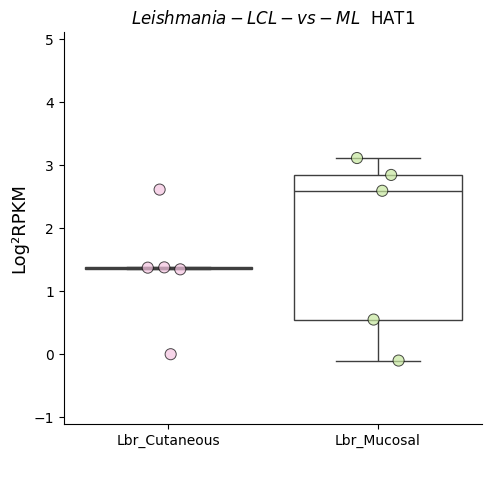

<Figure size 800x800 with 0 Axes>

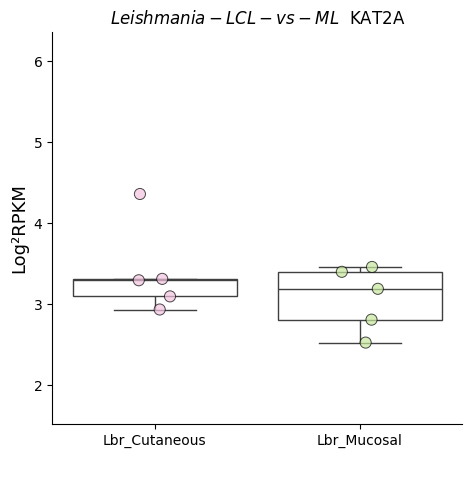

<Figure size 800x800 with 0 Axes>

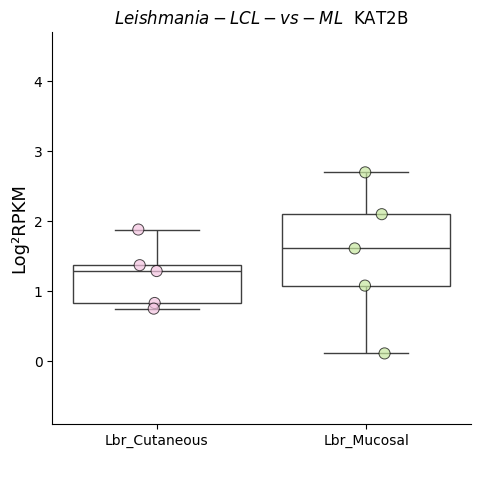

<Figure size 800x800 with 0 Axes>

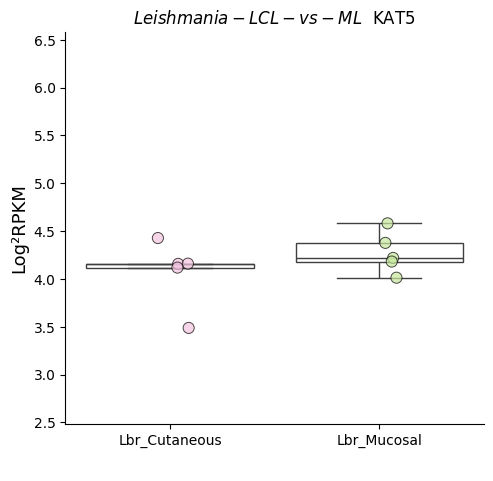

<Figure size 800x800 with 0 Axes>

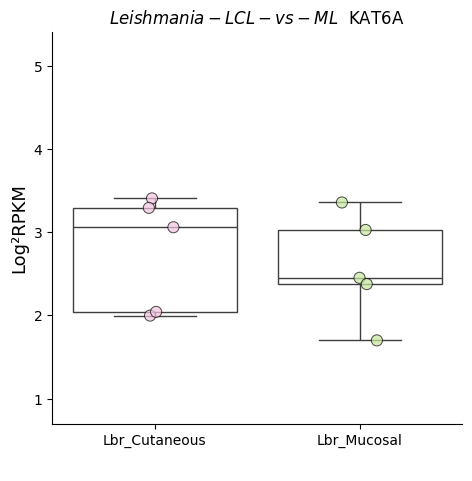

<Figure size 800x800 with 0 Axes>

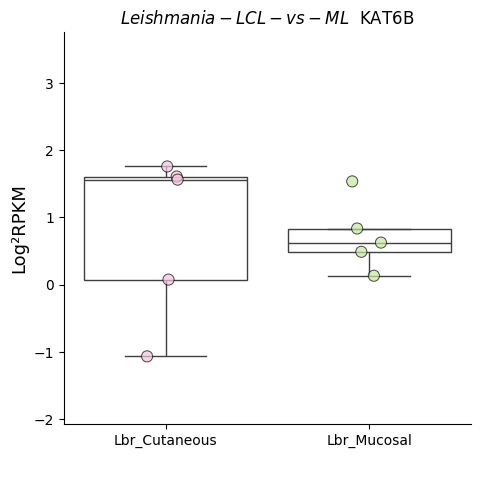

<Figure size 800x800 with 0 Axes>

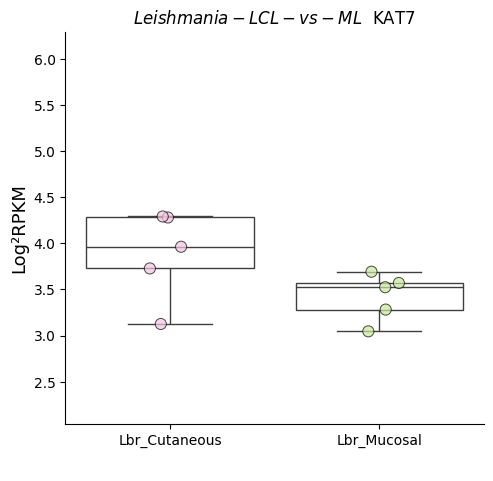

<Figure size 800x800 with 0 Axes>

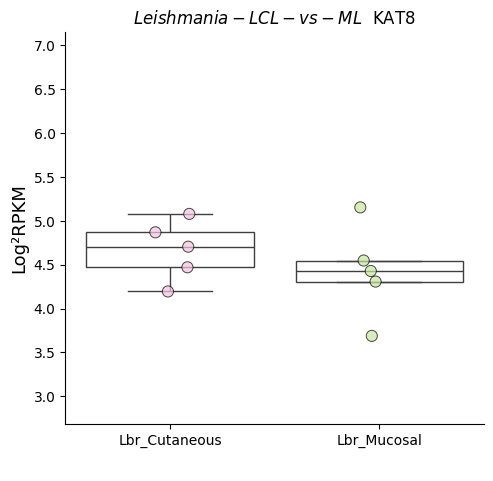

<Figure size 800x800 with 0 Axes>

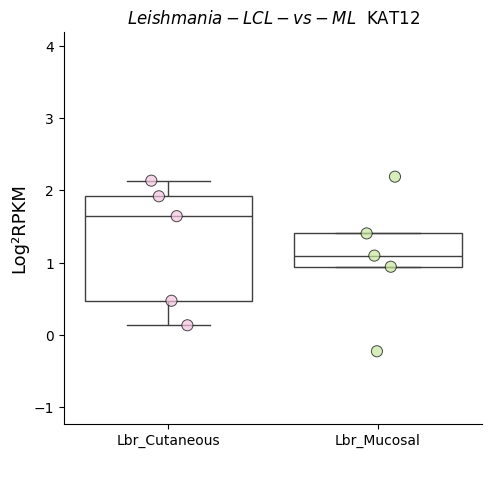

<Figure size 800x800 with 0 Axes>

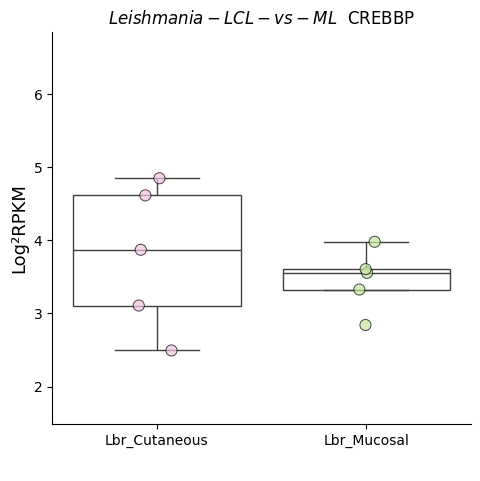

<Figure size 800x800 with 0 Axes>

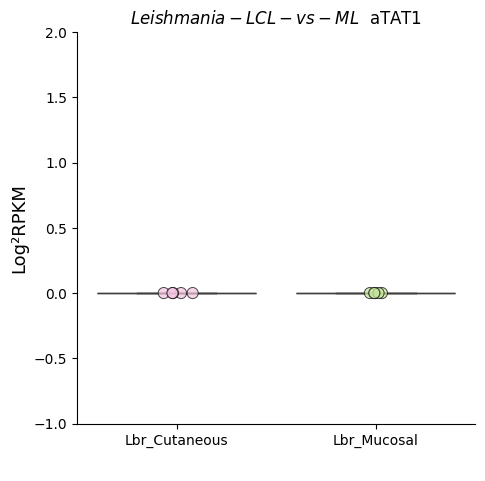

<Figure size 800x800 with 0 Axes>

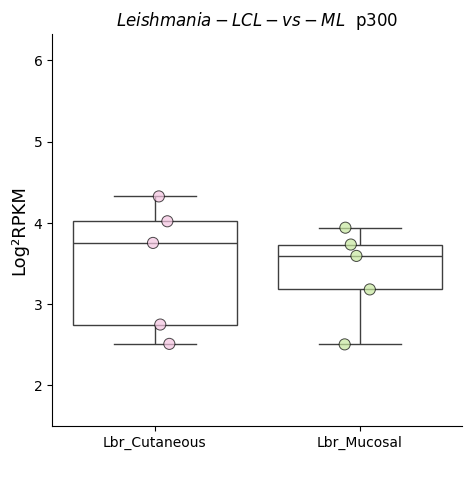

<Figure size 800x800 with 0 Axes>

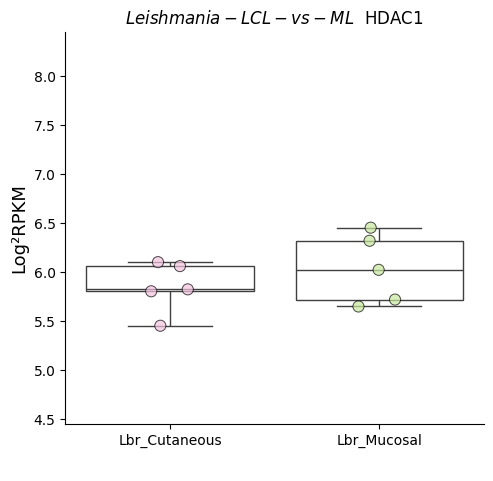

<Figure size 800x800 with 0 Axes>

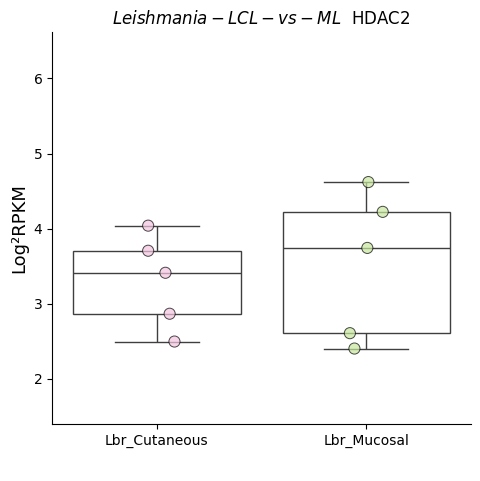

<Figure size 800x800 with 0 Axes>

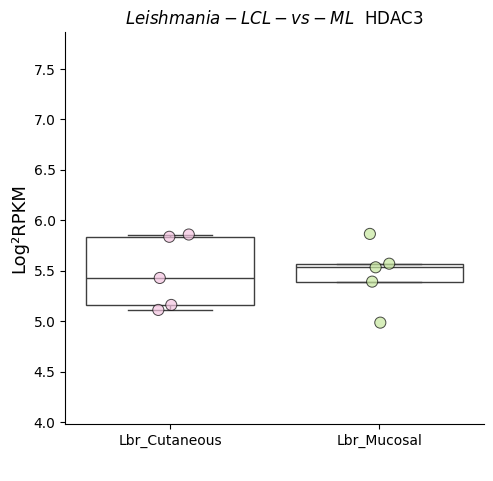

<Figure size 800x800 with 0 Axes>

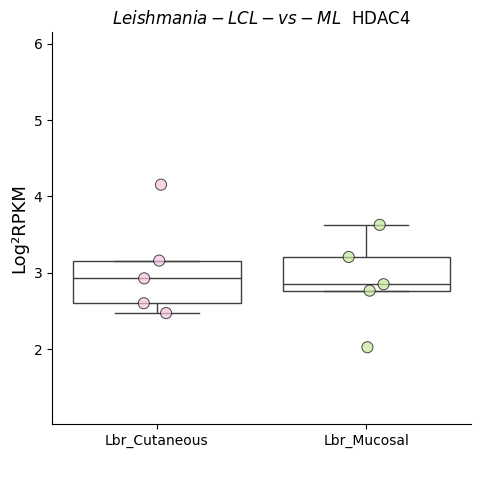

<Figure size 800x800 with 0 Axes>

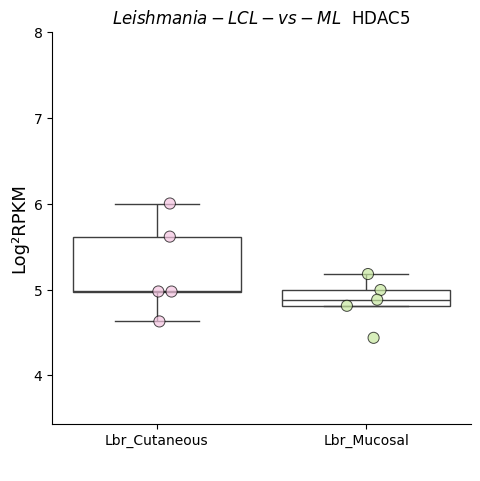

<Figure size 800x800 with 0 Axes>

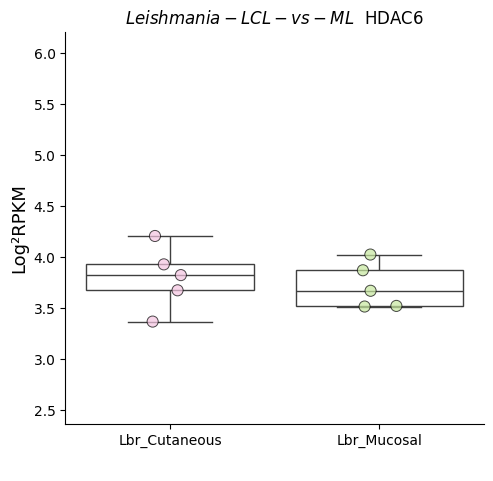

<Figure size 800x800 with 0 Axes>

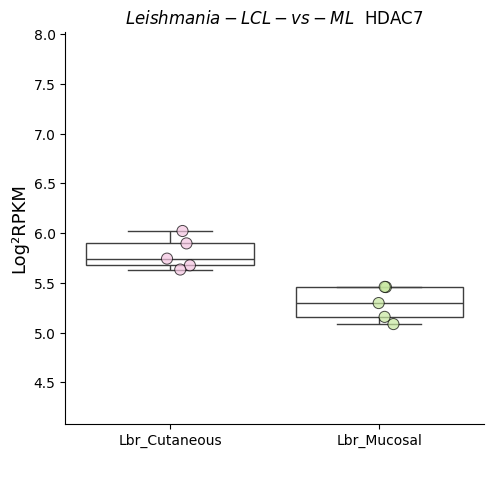

<Figure size 800x800 with 0 Axes>

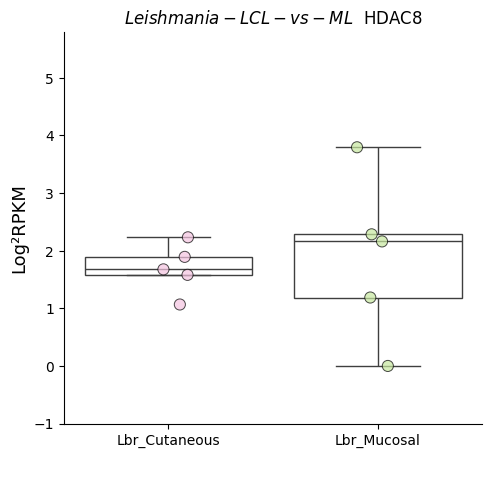

<Figure size 800x800 with 0 Axes>

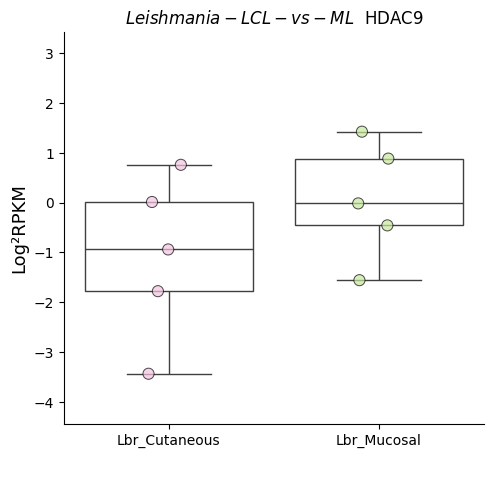

<Figure size 800x800 with 0 Axes>

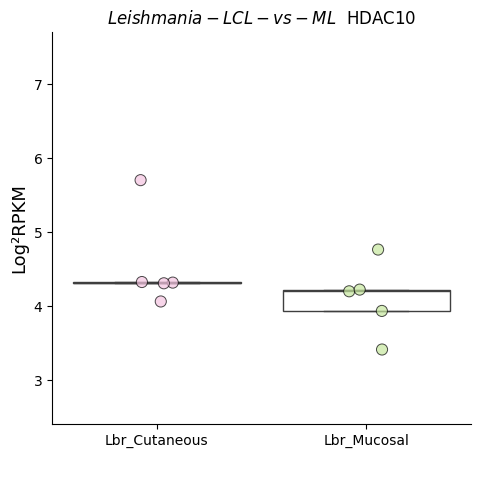

<Figure size 800x800 with 0 Axes>

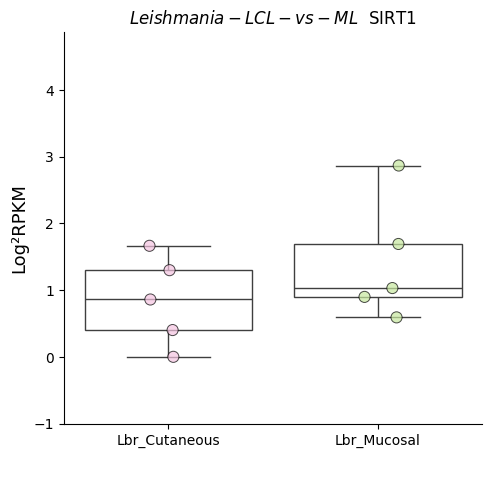

<Figure size 800x800 with 0 Axes>

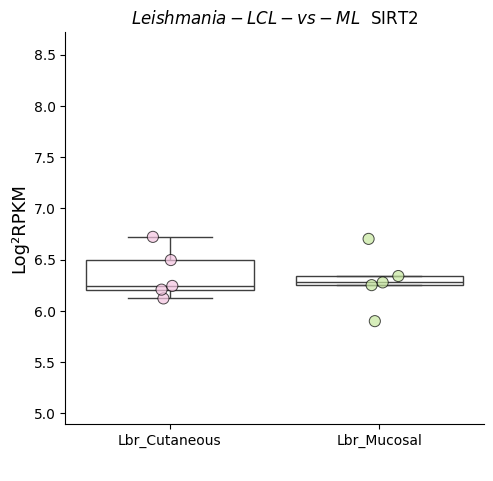

<Figure size 800x800 with 0 Axes>

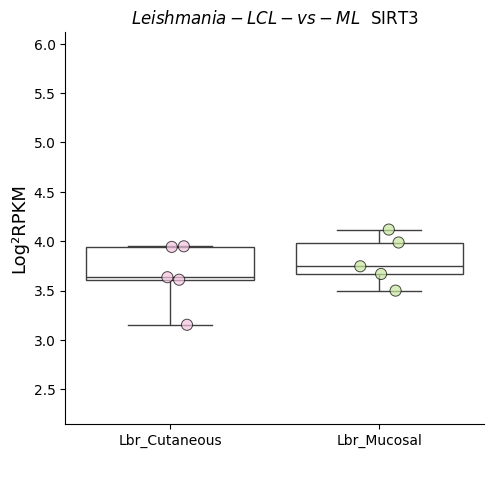

<Figure size 800x800 with 0 Axes>

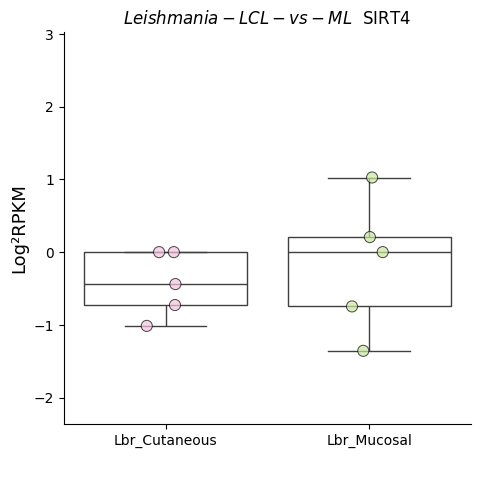

<Figure size 800x800 with 0 Axes>

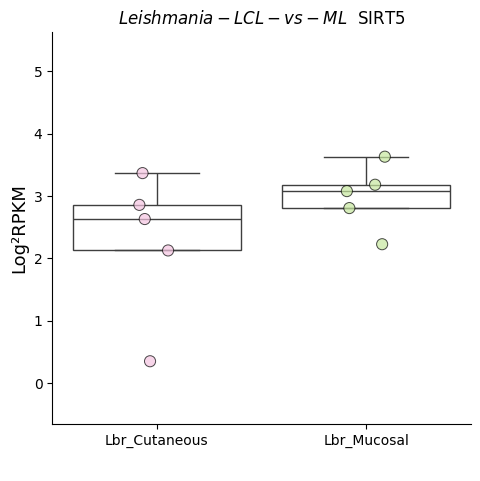

<Figure size 800x800 with 0 Axes>

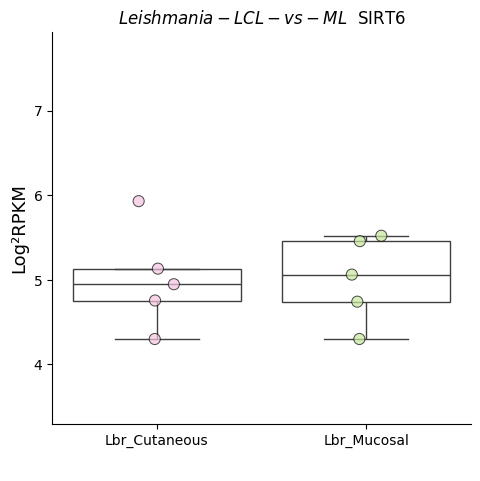

<Figure size 800x800 with 0 Axes>

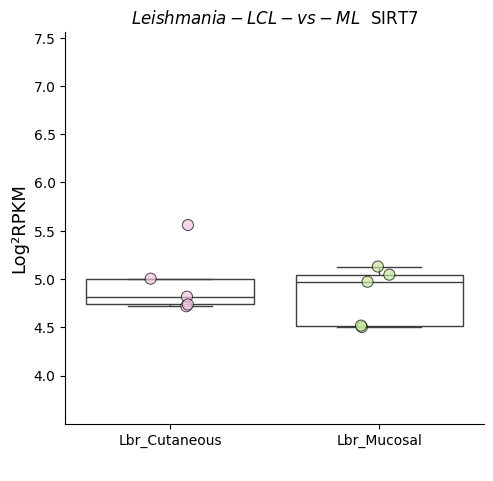

In [ ]:
graficos_boxplot(df_filtrado, "PiYG", "Leishmania-LCL-vs-ML",      [ 'Lbr_Cutaneous', 'Lbr_Mucosal']         , nome)


##SRP069976 ✅

In [ ]:
id_gene_pasta="SRP069976"
SRP069976_tab = pd.read_excel(SRP069976 )
SRP069976_tab.head()

,Nome,Health_10_SRR3162851,Health_1_SRR3162842,Health_2_SRR3162843,Health_3_SRR3162844,Health_4_SRR3162845,Health_5_SRR3162846,Health_6_SRR3162847,Health_7_SRR3162848,Health_8_SRR3162849,...,Lama_Late_Infection_17_SRR3162871,Lama_Late_Infection_1_SRR3162860,Lama_Late_Infection_2_SRR3162861,Lama_Late_Infection_3_SRR3162862,Lama_Late_Infection_4_SRR3162863,Lama_Late_Infection_5_SRR3162864,Lama_Late_Infection_6_SRR3162865,Lama_Late_Infection_7_SRR3162866,Lama_Late_Infection_8_SRR3162867,Lama_Late_Infection_9_SRR3162868
0,YTHDF1,5.405853,4.637366,4.860832,5.050745,4.962156,5.012771,4.850772,5.151217,5.031150,...,5.251087,4.937038,5.088797,4.835171,4.652830,4.571949,4.990859,5.159428,5.107759,5.122698
1,YTHDF2,5.678406,5.521820,5.459031,5.488752,5.362402,5.402450,5.365123,5.510235,5.246922,...,5.503342,5.297359,5.573963,5.428449,5.689118,5.355364,5.551884,5.583155,5.532676,5.381121
2,YTHDF3,5.352834,5.524650,5.349187,5.503833,5.476837,5.195135,5.232614,5.713141,5.260285,...,5.588969,5.188145,5.418797,5.460030,5.707464,5.191679,5.400393,5.733605,5.705362,5.493204
3,YTHDC1,-3.407287,0.000000,0.000000,-3.502692,-2.899596,-5.688233,-3.331512,-3.655954,-2.858675,...,-4.267487,-6.812706,-5.276504,-5.214587,-4.871189,-3.896146,-4.235023,-3.391789,-4.095181,-4.296377
4,FTO,4.949613,4.599300,5.517500,5.107449,5.096880,5.430893,5.094156,5.178486,5.218154,...,4.801119,4.887021,4.469078,4.574657,4.380398,4.345646,5.045333,5.022432,4.380905,4.647120


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
SRP069976_df_filtrado = SRP069976_tab[SRP069976_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
SRP069976_df_filtrado.index = SRP069976_df_filtrado["Nome"]


In [ ]:
SRP069976_df_filtrado = SRP069976_df_filtrado.T

In [ ]:
SRP069976_df_filtrado = SRP069976_df_filtrado.iloc[1:]

In [ ]:
SRP069976_df_filtrado.index.to_list()

['Health_10_SRR3162851',
 'Health_1_SRR3162842',
 'Health_2_SRR3162843',
 'Health_3_SRR3162844',
 'Health_4_SRR3162845',
 'Health_5_SRR3162846',
 'Health_6_SRR3162847',
 'Health_7_SRR3162848',
 'Health_8_SRR3162849',
 'Health_9_SRR3162850',
 'Lama_Chronic_Infection_1_SRR7275002',
 'Lama_Chronic_Infection_2_SRR7275003',
 'Lama_Chronic_Infection_3_SRR7275004',
 'Lama_Chronic_Infection_4_SRR7275005',
 'Lama_Chronic_Infection_5_SRR7275006',
 'Lama_Chronic_Infection_6_SRR7275007',
 'Lama_Early_Infection_1_SRR3162852',
 'Lama_Early_Infection_2_SRR3162853',
 'Lama_Early_Infection_3_SRR3162854',
 'Lama_Early_Infection_4_SRR3162855',
 'Lama_Early_Infection_5_SRR3162856',
 'Lama_Early_Infection_6_SRR3162857',
 'Lama_Early_Infection_7_SRR3162858',
 'Lama_Early_Infection_8_SRR3162859',
 'Lama_Late_Infection_10_SRR3162869',
 'Lama_Late_Infection_11_SRR3162870',
 'Lama_Late_Infection_12_SRR3162872',
 'Lama_Late_Infection_13_SRR3162873',
 'Lama_Late_Infection_14_SRR3162874',
 'Lama_Late_Infection_15_

In [ ]:
SRP069976_df_filtrado["Status"] =['Health',
 'Health',
 'Health',
 'Health',
 'Health',
 'Health',
 'Health',
 'Health',
 'Health',
 'Health',
 'Chronic_Infection',
 'Chronic_Infection',
 'Chronic_Infection',
 'Chronic_Infection',
 'Chronic_Infection',
 'Chronic_Infection',
 'Early_Infection',
 'Early_Infection',
 'Early_Infection',
 'Early_Infection',
 'Early_Infection',
 'Early_Infection',
 'Early_Infection',
 'Early_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection',
 'Late_Infection']
set(SRP069976_df_filtrado["Status"])

{'Chronic_Infection', 'Early_Infection', 'Health', 'Late_Infection'}

In [ ]:
list(set(SRP069976_df_filtrado["Status"]))

['Early_Infection', 'Chronic_Infection', 'Late_Infection', 'Health']

In [ ]:
#############################################################
infected_data = SRP069976_df_filtrado[SRP069976_df_filtrado['Status'] == 'Chronic_Infection']
uninfected_data = SRP069976_df_filtrado[SRP069976_df_filtrado['Status'] == 'Health']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.042703,0.26397,-0.956622,-0.002288,-2.41979,-1.826865,-0.862255,0.183486,-2.839256,-1.236177,...,0.514082,-0.836325,-2.965765,-1.111711,0.108261,0.529524,-0.317901,-0.03243,-0.624203,0.840794


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="L. amazonensis_SRP069976"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/SRP069976/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Down,Normal,Down,Down,Down,Normal,Down,Down,...,Normal,Down,Down,Down,Normal,Normal,Normal,Normal,Down,UP


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=7, palette=paleta,edgecolor='black',linewidth=1,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        # plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        # print("carregando")
        break



<Figure size 800x800 with 0 Axes>

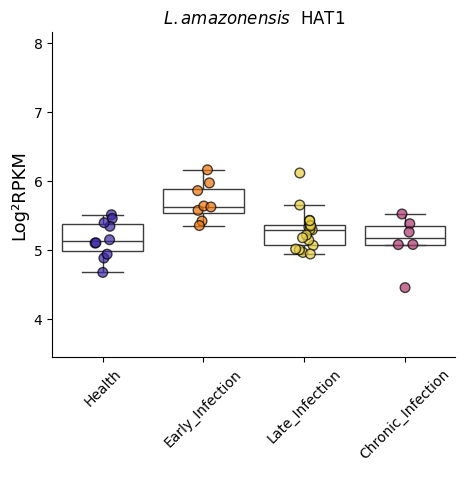

In [ ]:
graficos_boxplot(SRP069976_df_filtrado, "CMRmap", "L. amazonensis", ['Health', 'Early_Infection', 'Late_Infection','Chronic_Infection'], "L. amazonensis")


##SRP377060 ✅




In [ ]:
id_gene_pasta="SRP377060"
SRP377060_tab = pd.read_excel(SRP377060 )
SRP377060_tab.head()

,Nome,DC_Infected_Fixed_Parasites_1_SRR19400237,DC_Infected_Fixed_Parasites_2_SRR19400238,DC_Infected_Fixed_Parasites_3_SRR19400239,DC_Infected_Live_Parasites_1_SRR19400240,DC_Infected_Live_Parasites_2_SRR19400241,DC_Infected_Live_Parasites_3_SRR19400242,DC_Non-Infected_1_SRR19400243,DC_Non-Infected_2_SRR19400244
0,YTHDF1,3.356750,3.136703,3.987144,3.132183,3.429493,3.354849,4.792775,4.361684
1,YTHDF2,4.252084,5.388310,6.304113,4.517142,4.923752,4.551138,4.612866,4.673147
2,YTHDF3,5.141763,6.154937,5.689450,5.827428,5.995711,5.675144,6.100713,6.253233
3,YTHDC1,4.788407,4.977299,5.200437,4.842384,4.926593,5.219481,5.535973,4.962590
4,FTO,4.920010,4.830993,5.762775,4.933743,4.371817,4.211636,4.868209,4.165080


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
SRP377060_df_filtrado = SRP377060_tab[SRP377060_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
SRP377060_df_filtrado.index = SRP377060_df_filtrado["Nome"]

SRP377060_df_filtrado = SRP377060_df_filtrado.T
df_filtrado = SRP377060_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
DC_Infected_Fixed_Parasites_1_SRR19400237,3.782129,3.729508,2.89961,5.582994,4.152711,1.899337,6.195036,3.4142,3.317486,2.706965,...,2.045781,-0.166656,2.287724,3.534384,6.024859,3.654129,3.701366,3.475351,4.874739,7.331711
DC_Infected_Fixed_Parasites_2_SRR19400238,5.134767,2.386815,3.843741,6.055156,3.910532,1.481351,6.079781,3.670276,3.16024,2.617336,...,2.493526,-1.120482,1.424501,4.445947,5.682904,2.620044,3.507434,4.442423,4.335176,7.15916
DC_Infected_Fixed_Parasites_3_SRR19400239,5.379525,3.603013,4.039736,5.095659,4.125845,1.814108,6.652832,2.703541,4.007527,2.912455,...,2.75045,0.676416,2.538881,4.091349,5.770317,4.03843,3.050294,3.591349,5.395565,6.495822
DC_Infected_Live_Parasites_1_SRR19400240,4.368292,3.441116,3.45626,5.884121,3.980447,1.755547,6.528361,3.638125,3.267567,2.216433,...,2.768486,-0.436131,2.371886,3.290971,5.706392,3.363896,3.877762,3.63492,5.190639,7.259175
DC_Infected_Live_Parasites_2_SRR19400241,4.912975,2.62618,3.570431,5.418069,3.818137,1.228173,6.167717,3.433491,3.473734,2.481426,...,2.894172,1.187054,2.373583,4.443365,6.171012,4.165079,3.962527,4.06546,4.813824,6.796464


In [ ]:
df_filtrado.index.to_list()

['DC_Infected_Fixed_Parasites_1_SRR19400237',
 'DC_Infected_Fixed_Parasites_2_SRR19400238',
 'DC_Infected_Fixed_Parasites_3_SRR19400239',
 'DC_Infected_Live_Parasites_1_SRR19400240',
 'DC_Infected_Live_Parasites_2_SRR19400241',
 'DC_Infected_Live_Parasites_3_SRR19400242',
 'DC_Non-Infected_1_SRR19400243',
 'DC_Non-Infected_2_SRR19400244']

In [ ]:
df_filtrado["Status"] =   ['Infected_Fixed',
'Infected_Fixed',
'Infected_Fixed',
'Infected_Live',
'Infected_Live',
'Infected_Live',
'Non-Infected',
'Non-Infected']

<ipython-input-36-8eef0fb5bd05>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =   ['Infected_Fixed',


In [ ]:
list(set(df_filtrado["Status"]))
ordem = ['Non-Infected', 'Infected_Fixed', 'Infected_Live']


In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] ==    'Infected_Live'  ]
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Non-Infected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.842729,-0.930456,-0.598862,0.422404,0.059701,-0.770329,-0.211888,-0.338237,-0.649381,-0.00856,...,-0.173425,-1.622917,0.046092,-0.151145,0.000634,-0.269203,0.666583,0.709114,0.580111,0.287571


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="Leishmania_infantum_SRP377060"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/SRP377060/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Down,Normal,Normal,Normal,Down,Normal,Normal,Down,Normal,...,Normal,Down,Normal,Normal,Normal,Normal,UP,UP,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Down,Normal,Normal,Normal,Down,Normal,Normal,Down,Normal,...,Normal,Down,Normal,Normal,Normal,Normal,UP,UP,Normal,Normal


<Figure size 800x800 with 0 Axes>

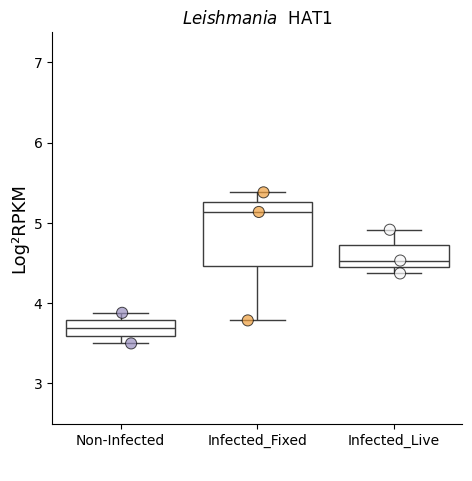

carregando


<Figure size 800x800 with 0 Axes>

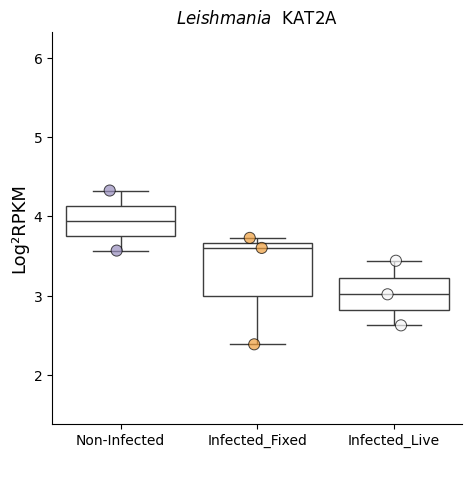

carregando


<Figure size 800x800 with 0 Axes>

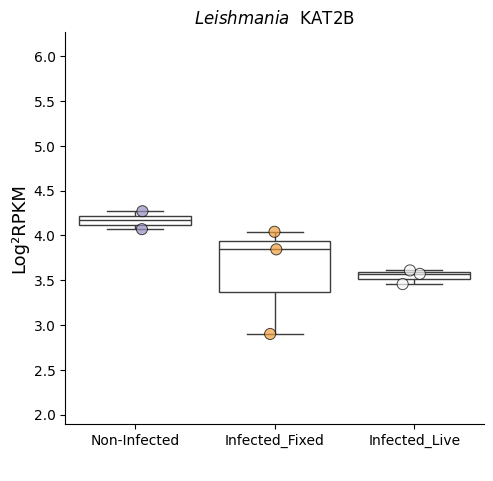

carregando


<Figure size 800x800 with 0 Axes>

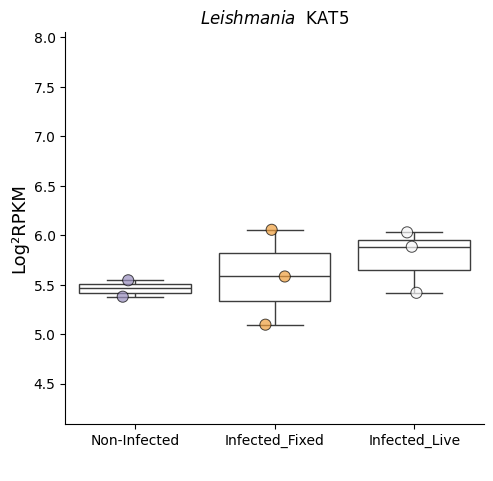

carregando


<Figure size 800x800 with 0 Axes>

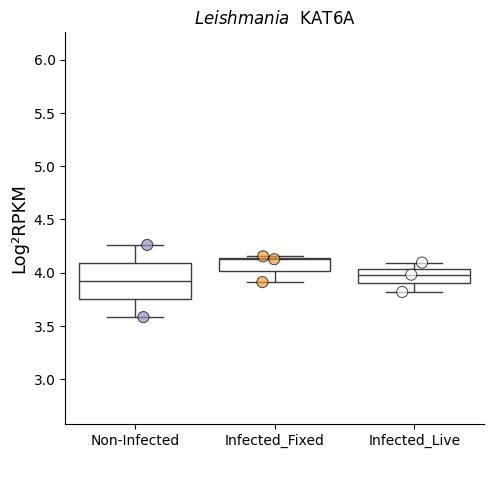

carregando


<Figure size 800x800 with 0 Axes>

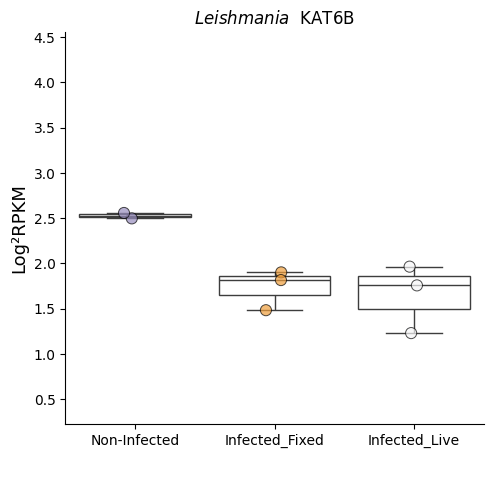

carregando


<Figure size 800x800 with 0 Axes>

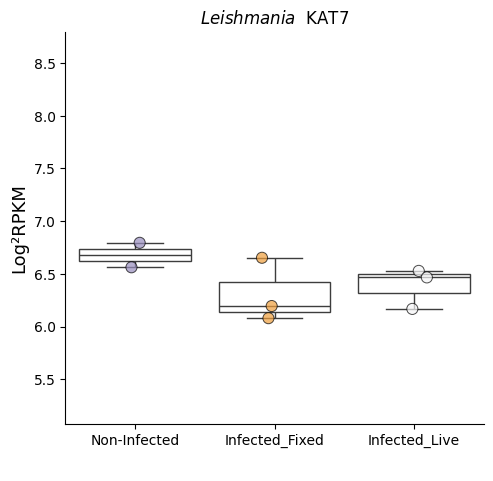

carregando


<Figure size 800x800 with 0 Axes>

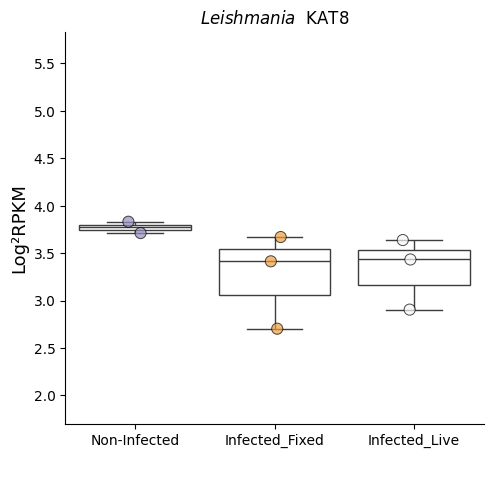

carregando


<Figure size 800x800 with 0 Axes>

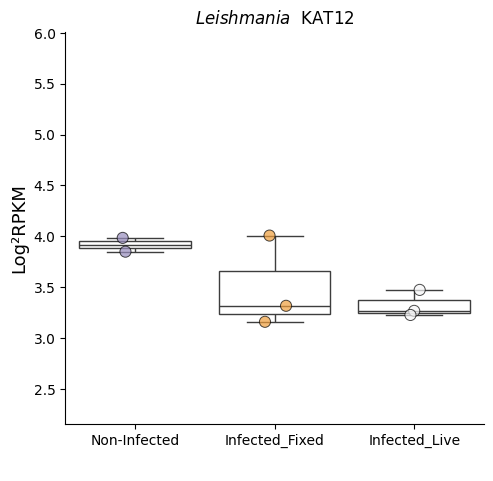

carregando


<Figure size 800x800 with 0 Axes>

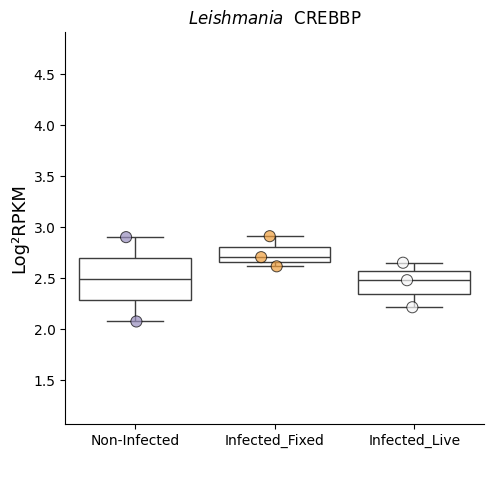

carregando


<Figure size 800x800 with 0 Axes>

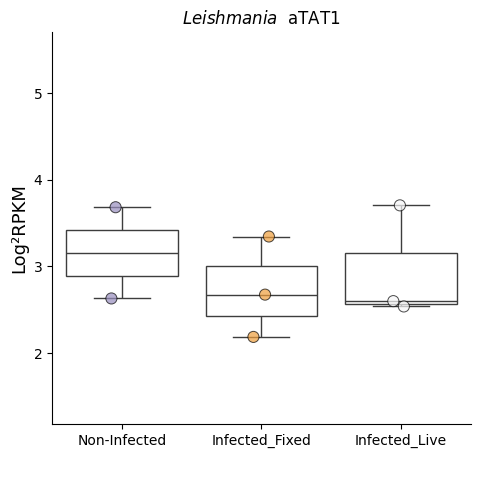

carregando


<Figure size 800x800 with 0 Axes>

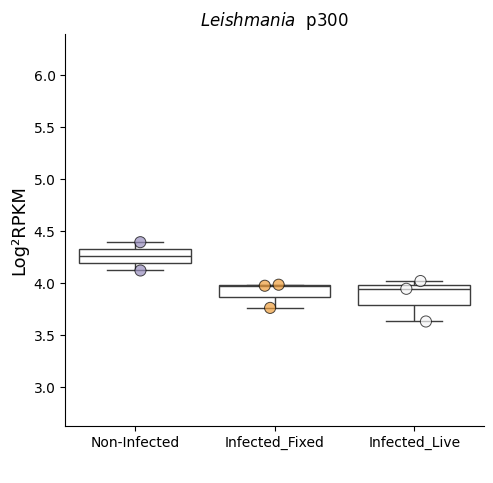

carregando


<Figure size 800x800 with 0 Axes>

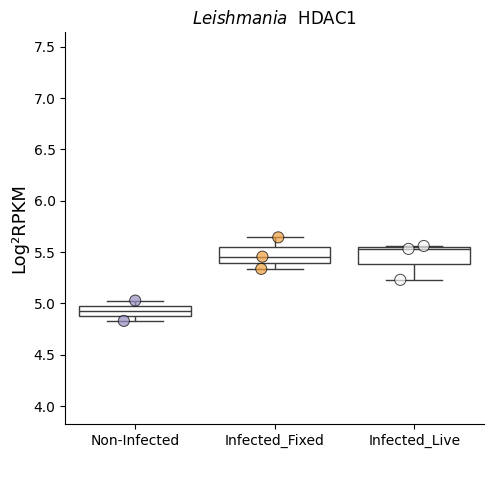

carregando


<Figure size 800x800 with 0 Axes>

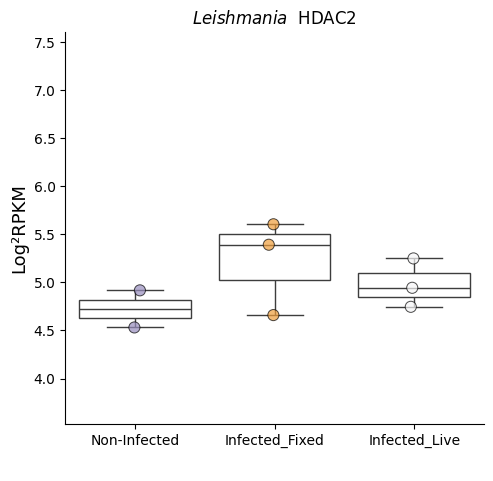

carregando


<Figure size 800x800 with 0 Axes>

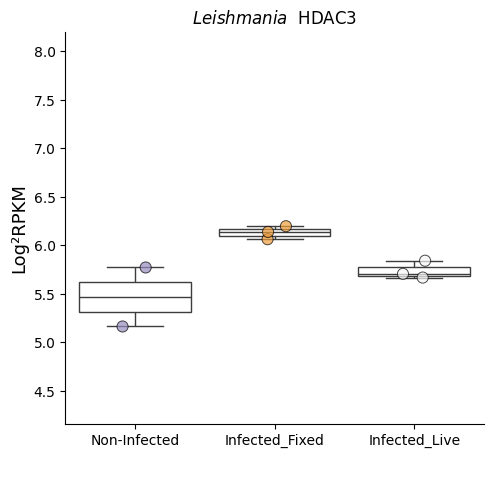

carregando


<Figure size 800x800 with 0 Axes>

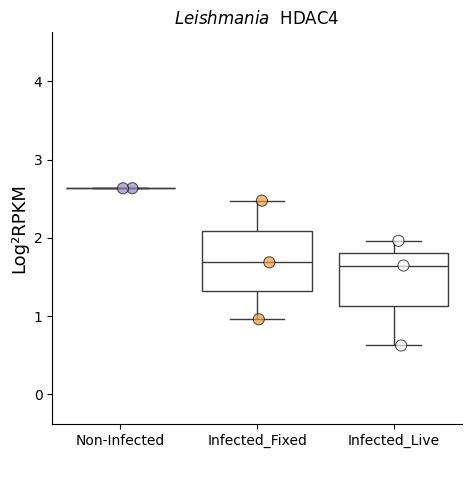

carregando


<Figure size 800x800 with 0 Axes>

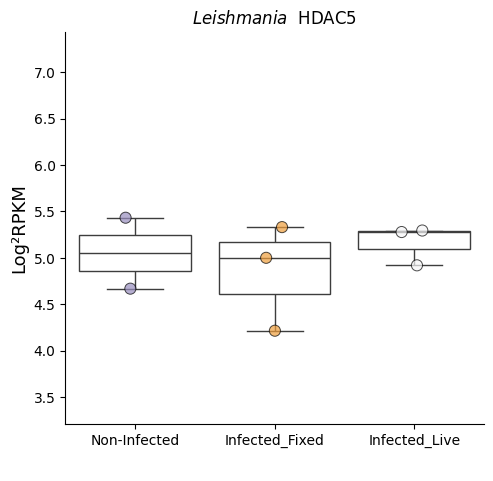

carregando


<Figure size 800x800 with 0 Axes>

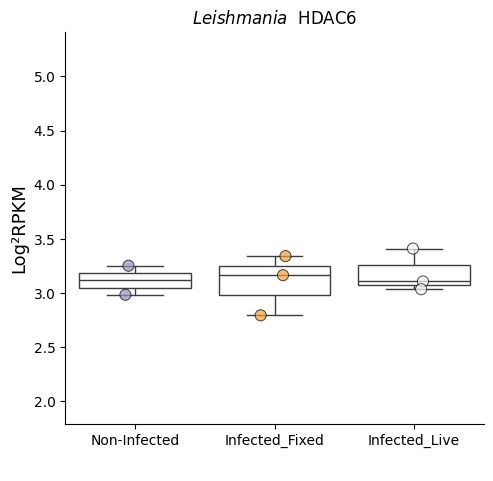

carregando


<Figure size 800x800 with 0 Axes>

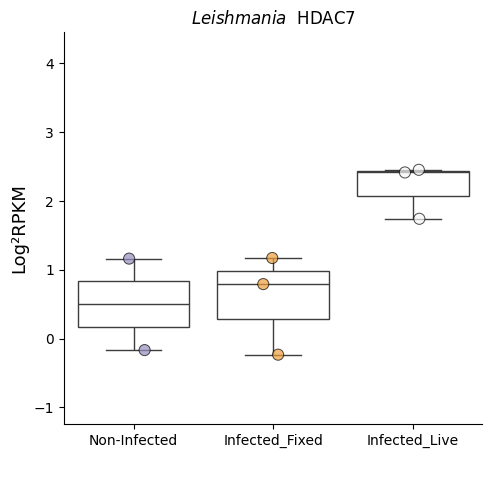

carregando


<Figure size 800x800 with 0 Axes>

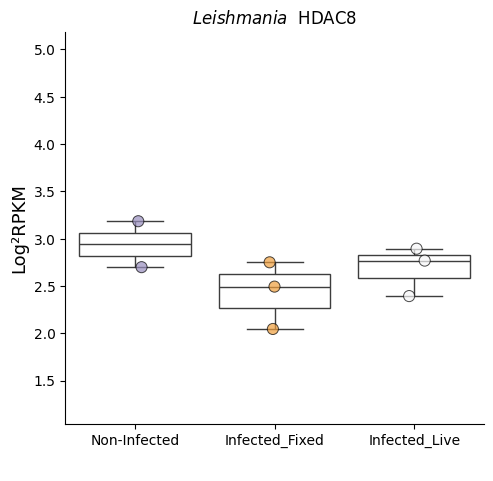

carregando


<Figure size 800x800 with 0 Axes>

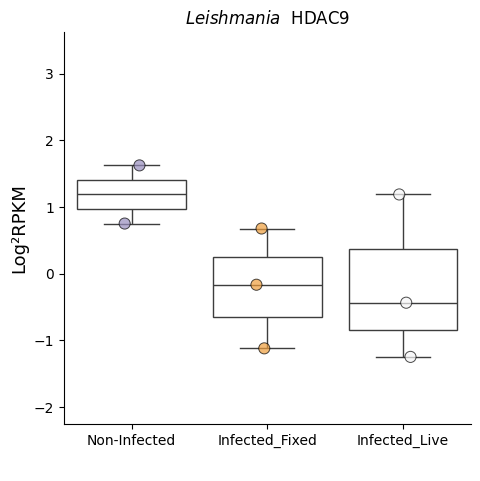

carregando


<Figure size 800x800 with 0 Axes>

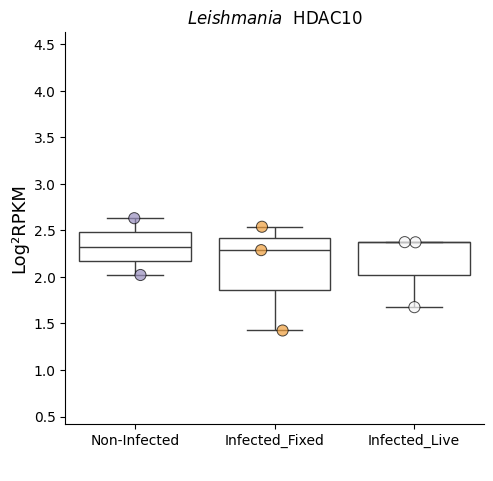

carregando


<Figure size 800x800 with 0 Axes>

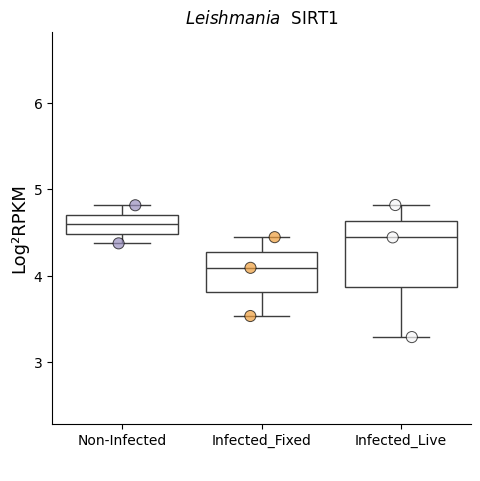

carregando


<Figure size 800x800 with 0 Axes>

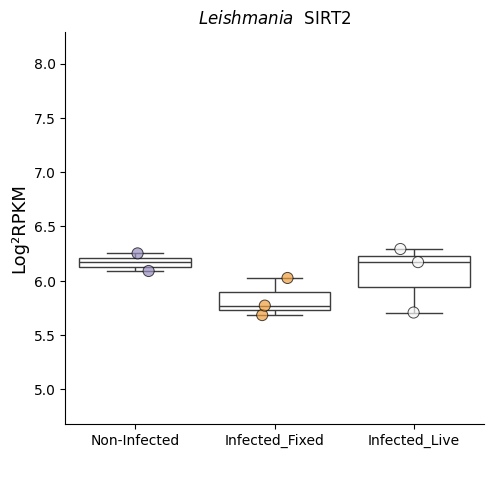

carregando


<Figure size 800x800 with 0 Axes>

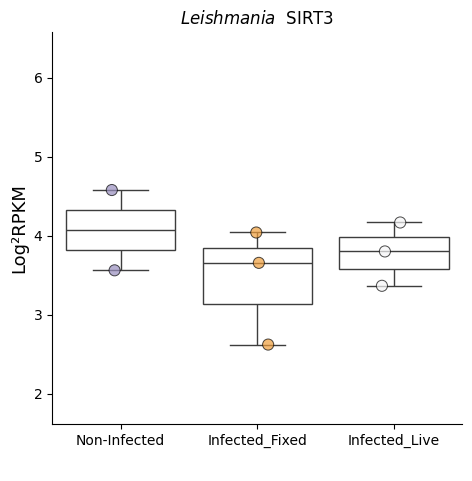

carregando


<Figure size 800x800 with 0 Axes>

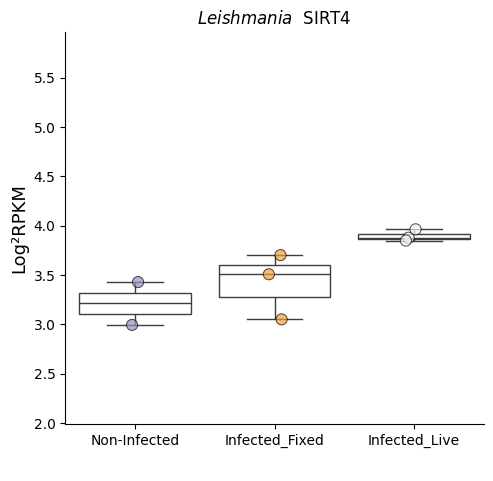

carregando


<Figure size 800x800 with 0 Axes>

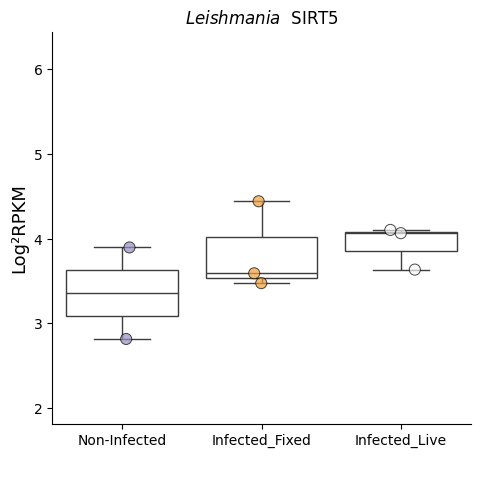

carregando


<Figure size 800x800 with 0 Axes>

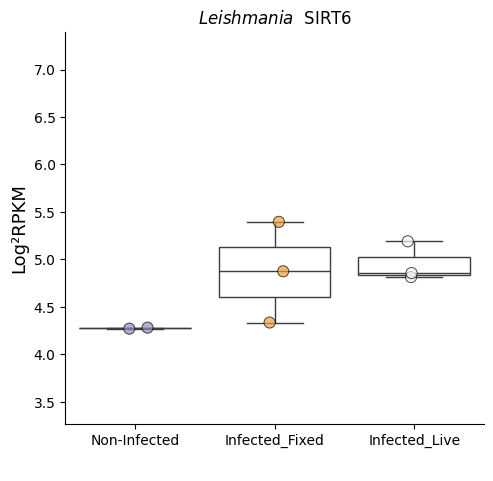

carregando


<Figure size 800x800 with 0 Axes>

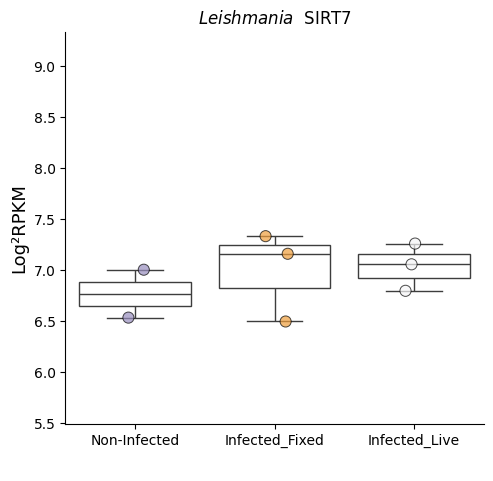

carregando


In [ ]:
graficos_boxplot(df_filtrado, "PuOr", "Leishmania",     ordem         , nome)


#M_tuberculosis

##SRP151491 ✅

In [ ]:
SRP151491_tab = pd.read_excel(SRP151491 )
SRP151491_tab.head()

,Nome,Mo_Alveolar_Infected_1_SRR8556403,Mo_Alveolar_Infected_2_SRR8556404,Mo_Alveolar_Infected_3_SRR8556405,Mo_Alveolar_Infected_4_SRR8556406,Mo_Alveolar_Infected_5_SRR8556407,Mo_Alveolar_Infected_6_SRR8556408,Mo_Alveolar_Uninfected_1_SRR8556397,Mo_Alveolar_Uninfected_2_SRR8556398,Mo_Alveolar_Uninfected_3_SRR8556399,Mo_Alveolar_Uninfected_4_SRR8556400,Mo_Alveolar_Uninfected_5_SRR8556401,Mo_Alveolar_Uninfected_6_SRR8556402
0,YTHDF 1,3.261130,5.111286,5.104322,5.056472,5.118850,5.036741,5.132645,5.103061,4.984566,5.235855,5.270335,5.209164
1,YTHDF 2,5.687368,6.211556,5.864810,6.084114,6.134215,5.840756,5.684027,5.720547,5.534799,5.835042,5.733752,5.701218
2,YTHDF 3,4.355895,6.005562,5.688067,5.873554,5.929676,6.127916,5.665462,5.690040,5.818186,5.543708,5.801842,5.763488
3,YTHDC 1,2.547028,4.376343,4.280942,4.523190,4.650608,4.600771,4.007301,4.185478,4.063113,4.494943,4.284437,4.260886
4,FTO,5.460901,6.128543,5.798674,5.903565,5.695657,5.672839,5.410704,5.394094,5.874755,5.623551,6.056509,6.119527


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
SRP151491_df_filtrado = SRP151491_tab[SRP151491_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
SRP151491_df_filtrado.index = SRP151491_df_filtrado["Nome"]


In [ ]:
SRP151491_df_filtrado = SRP151491_df_filtrado.T

In [ ]:
SRP151491_df_filtrado = SRP151491_df_filtrado.iloc[1:]

In [ ]:
SRP151491_df_filtrado.index.to_list()

['Mo_Alveolar_Infected_1_SRR8556403',
 'Mo_Alveolar_Infected_2_SRR8556404',
 'Mo_Alveolar_Infected_3_SRR8556405',
 'Mo_Alveolar_Infected_4_SRR8556406',
 'Mo_Alveolar_Infected_5_SRR8556407',
 'Mo_Alveolar_Infected_6_SRR8556408',
 'Mo_Alveolar_Uninfected_1_SRR8556397',
 'Mo_Alveolar_Uninfected_2_SRR8556398',
 'Mo_Alveolar_Uninfected_3_SRR8556399',
 'Mo_Alveolar_Uninfected_4_SRR8556400',
 'Mo_Alveolar_Uninfected_5_SRR8556401',
 'Mo_Alveolar_Uninfected_6_SRR8556402']

In [ ]:
SRP151491_df_filtrado["Status"] =['Mo_Infected',
 'Mo_Infected',
 'Mo_Infected',
 'Mo_Infected',
 'Mo_Infected',
 'Mo_Infected',
 'Mo_Uninfected',
 'Mo_Uninfected',
 'Mo_Uninfected',
 'Mo_Uninfected',
 'Mo_Uninfected',
 'Mo_Uninfected']

In [ ]:
SRP151491_df_filtrado.iloc[[1,2,-1,-2],[1,2,-1]]

Nome,KAT2A,KAT2B,Status
Mo_Alveolar_Infected_2_SRR8556404,4.485743,1.136887,Mo_Infected
Mo_Alveolar_Infected_3_SRR8556405,4.039856,0.858485,Mo_Infected
Mo_Alveolar_Uninfected_6_SRR8556402,4.475519,1.476917,Mo_Uninfected
Mo_Alveolar_Uninfected_5_SRR8556401,4.687313,1.431836,Mo_Uninfected


In [ ]:
infected_data = SRP151491_df_filtrado[SRP151491_df_filtrado['Status'] == 'Mo_Infected']
uninfected_data = SRP151491_df_filtrado[SRP151491_df_filtrado['Status'] == 'Mo_Uninfected']

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df
UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,5.52828,4.399509,1.447652,5.188722,0.983715,0.836342,6.596952,3.78631,3.3966,1.819642,...,2.605446,1.292062,1.90301,3.059389,6.916233,4.790374,2.701378,2.748631,2.552758,7.003108


In [ ]:
# Calcular a mediana para cada grupo
median_infected = infected_data.iloc[:, 1:-1].median()
median_uninfected = uninfected_data.iloc[:, 1:-1].median()
median_uninfected-median_infected

# regulados = pd.DataFrame(columns=SRP151491_df_filtrado.columns, index={"valores":median_uninfected.to_list()-median_infected.to_list()})

# median_uninfected.to_list()-median_infected.to_list()

[u-i for u,i  in zip (median_uninfected,median_infected)]
median_uninfected
# median_infected
for I,U in zip (median_infected, median_uninfected):
    pass
#   print(f" inf:{I}      un: {U}    dif:  {I-U}")

median_uninfected
median_infected

Nome
KAT2A     4.052204
KAT2B     1.066295
KAT5      5.393215
KAT6A     0.492978
KAT6B    -0.188629
KAT7       6.62609
KAT8      3.699822
KAT12     3.066502
CREBBP    0.935446
aTAT1     1.714936
p300      1.530126
HDAC1     5.897723
HDAC2     5.761867
HDAC3     5.675406
HDAC4     4.257726
HDAC5     3.887059
HDAC6     2.622841
HDAC7          0.0
HDAC8     2.740671
HDAC9     1.934373
HDAC10    0.998834
SIRT1     3.104549
SIRT2      7.04591
SIRT3     4.584924
SIRT4     2.801611
SIRT5     3.503706
SIRT6     1.892638
SIRT7      6.89984
dtype: object

In [ ]:
# Filtrando as linhas para Uninfected_Mouse e Infected_Mouse_Linfantum
# subset_PRJNA601732_df_Linfantum = PRJNA601732_df_filtrado[(PRJNA601732_df_filtrado['Status'] == 'Uninfected_Mouse') | (PRJNA601732_df_filtrado['Status'] == 'Mouse_Linfantum')]
# subset_PRJNA601732_df_Linfantum.iloc[[1,-1],:]

In [ ]:
# Filtrando as linhas para Infected_Mouse_Ldonovani e Infected_Mouse_Linfantum
# subset_PRJNA601732_df_Ldonovani = PRJNA601732_df_filtrado[(PRJNA601732_df_filtrado['Status'] == 'Mouse_Ldonovani') | (PRJNA601732_df_filtrado['Status'] == 'Infected_Mouse_Linfantum')]
# subset_PRJNA601732_df_Ldonovani.iloc[[1,-1],:]

In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, caminho="aqui"):
  for i in tabela:
    if "Status" in i: continue

    plt.figure(figsize=(4,8));
    graficos=sns.catplot(data=tabela,x="Status",y=i,kind="strip", size=5 ,edgecolor='black',linewidth=1,hue="Status",order=ordem);
    graficos=sns.boxplot(data = tabela,x="Status", y = i, showcaps=True,boxprops={'facecolor':'None'},showfliers=True,whiskerprops={'linewidth':1},hue="Status", order=ordem)
    plt.xticks(rotation=0)
    # graficos.set_axis_labels("Time", "Log²RPKM")

    plt.ylim(min(tabela[i])-1,max(tabela[i])+1)
    titulo = plt.gcf().suptitle(f'${especie}$  '+i, fontsize=14)
    if max(tabela[i])-min(tabela[i])<5:
        plt.ylim(min(tabela[i])-1,max(tabela[i])+2)
    titulo.set_y(1.05)
    graficos = plt.xlabel(' ', fontdict={'size': 13});
    graficos = plt.ylabel('Log²RPKM', fontdict={'size': 13});
    # plt.savefig(f"{caminho}/{i}.png",dpi=200, format='png')

    plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/SRP151491/{especie}{i}.png",dpi=200, format='png')

    plt.show(graficos)
    print("carregando")
    # break


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, caminho="aqui"):
    for i in tabela:
        if "Status" in i:
            continue

        plt.figure(figsize=(10, 8))  # Aumentando o tamanho da figura

        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=5, edgecolor='black',
                         linewidth=1, hue="Status", order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", order=ordem)

        plt.xticks(rotation=0)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/SRP151491/{especie}_{i}.png",
                    dpi=200, format='png')

        plt.show()

        print("carregando")


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"
        continue
    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

regulated_genes.to_excel("M_tuberculosis_SRP151491.xlsx")
regulated_genes


Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Down,Normal,Normal,Normal,Down,...,Normal,UP,Down,Normal,Normal,Normal,Normal,UP,Down,Normal


In [ ]:
gen_reg

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.218319,-0.347304,-0.381356,0.204493,-0.490736,-1.024971,0.029138,-0.086488,-0.330097,-0.884196,...,0.135225,0.642311,-0.904176,0.04516,0.129677,-0.20545,0.100232,0.755075,-0.66012,-0.103268


<Figure size 1000x800 with 0 Axes>

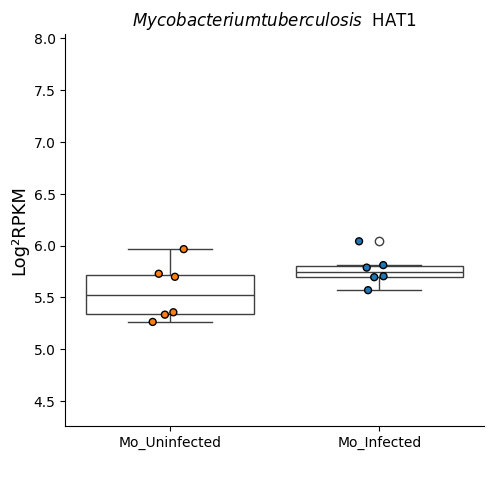

carregando


<Figure size 1000x800 with 0 Axes>

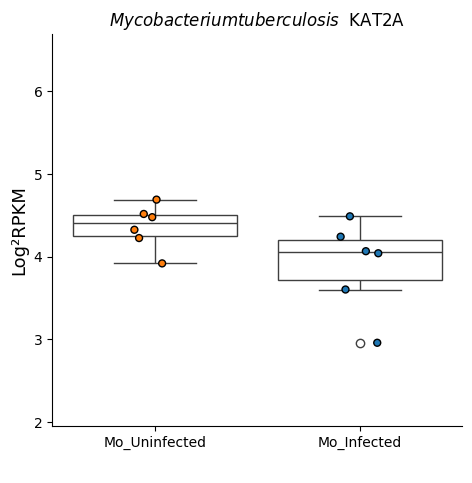

carregando


<Figure size 1000x800 with 0 Axes>

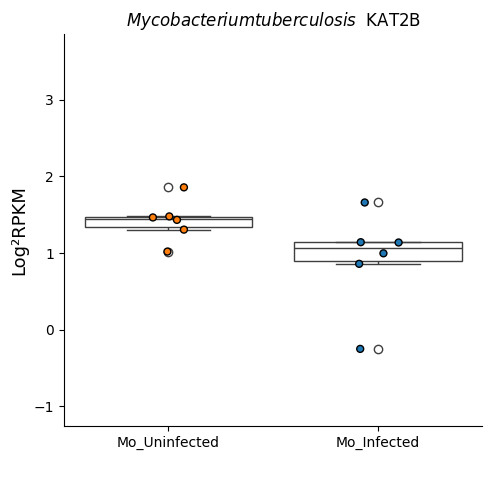

carregando


<Figure size 1000x800 with 0 Axes>

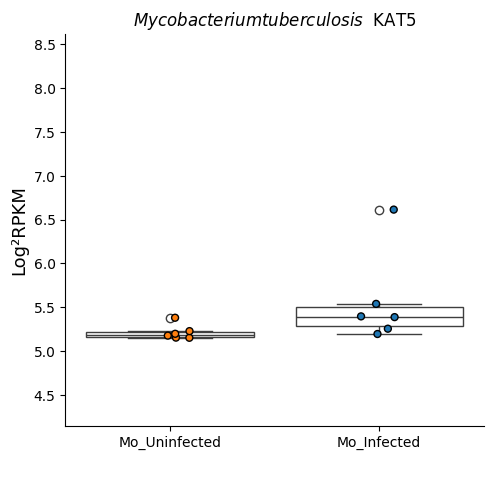

carregando


<Figure size 1000x800 with 0 Axes>

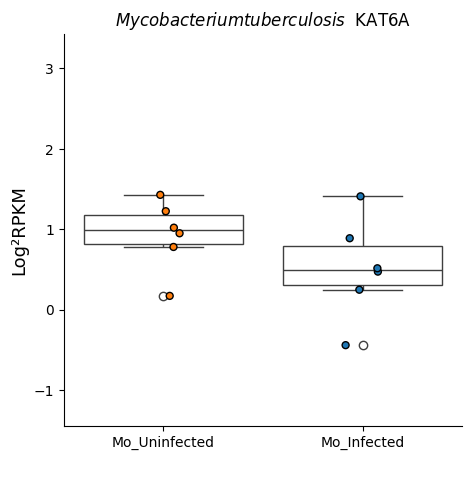

carregando


<Figure size 1000x800 with 0 Axes>

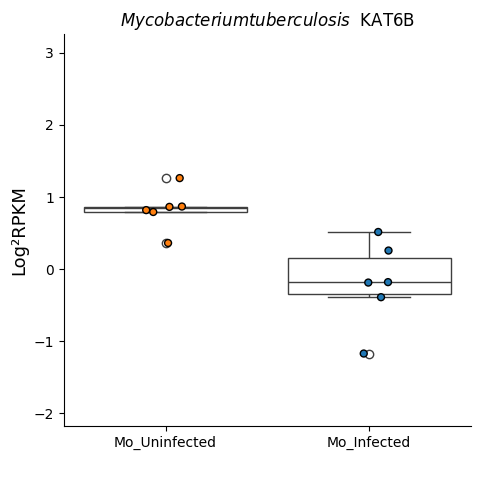

carregando


<Figure size 1000x800 with 0 Axes>

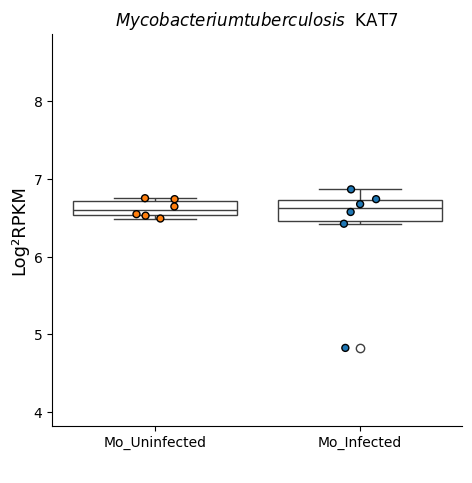

carregando


<Figure size 1000x800 with 0 Axes>

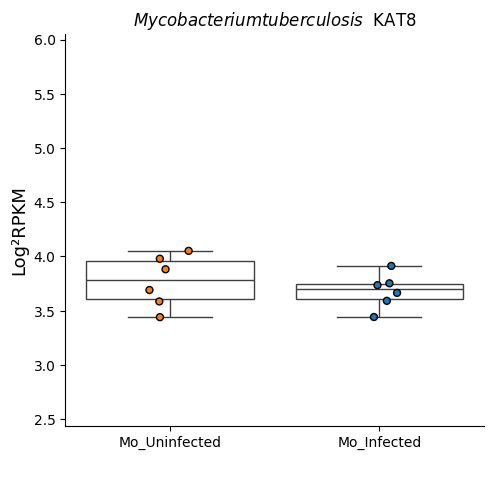

carregando


<Figure size 1000x800 with 0 Axes>

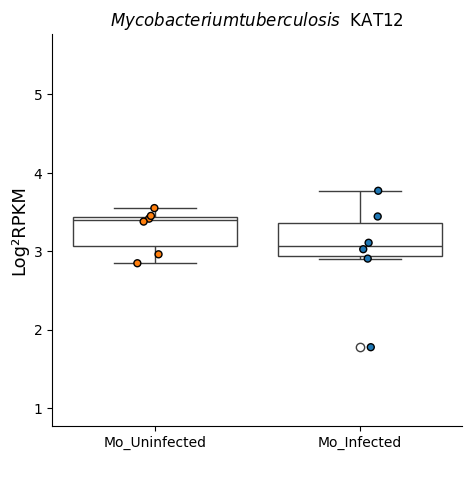

carregando


<Figure size 1000x800 with 0 Axes>

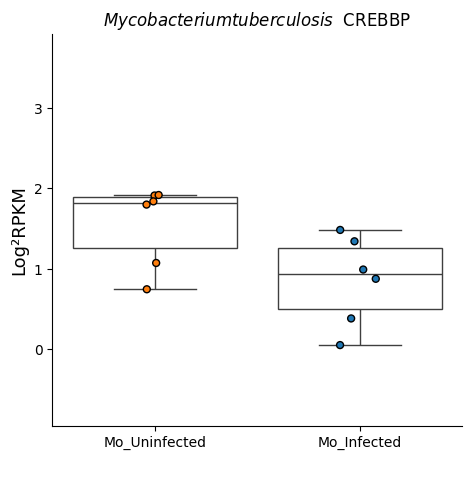

carregando


<Figure size 1000x800 with 0 Axes>

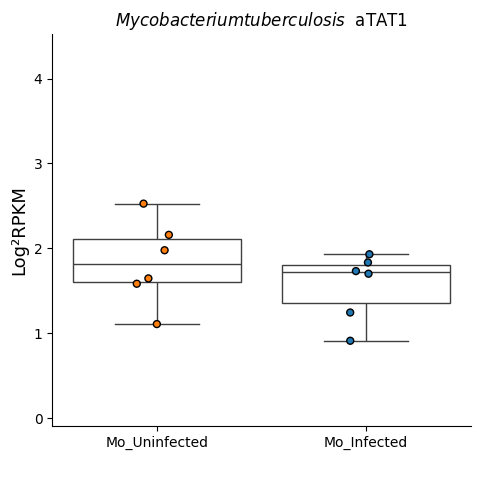

carregando


<Figure size 1000x800 with 0 Axes>

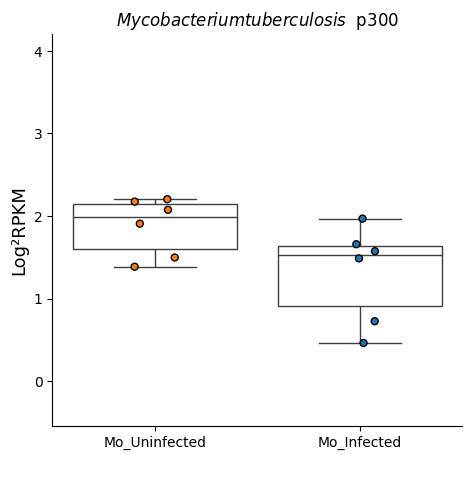

carregando


<Figure size 1000x800 with 0 Axes>

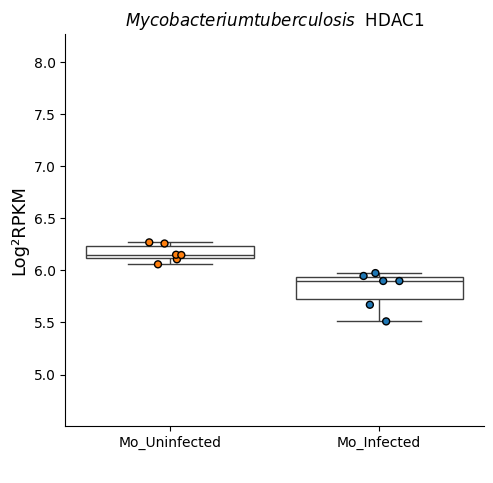

carregando


<Figure size 1000x800 with 0 Axes>

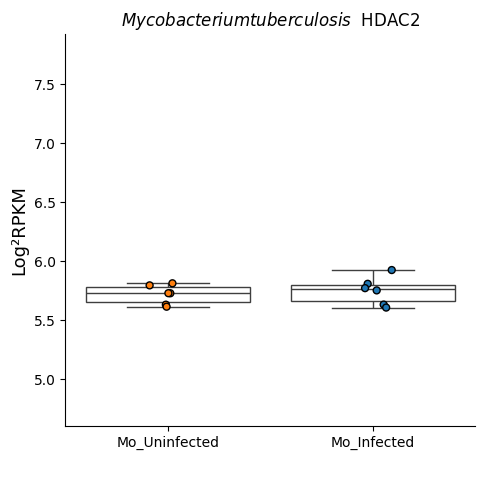

carregando


<Figure size 1000x800 with 0 Axes>

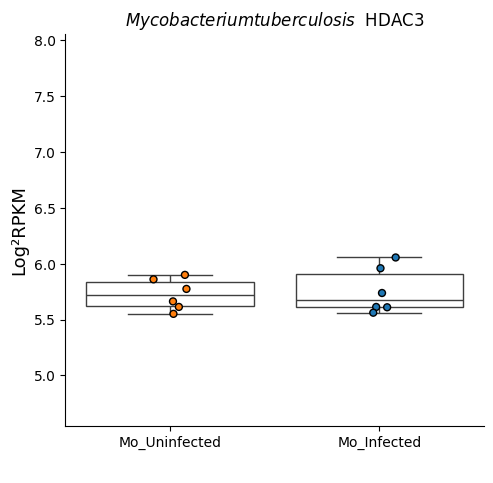

carregando


<Figure size 1000x800 with 0 Axes>

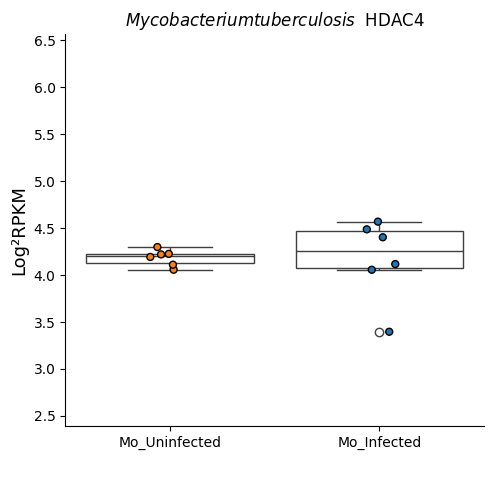

carregando


<Figure size 1000x800 with 0 Axes>

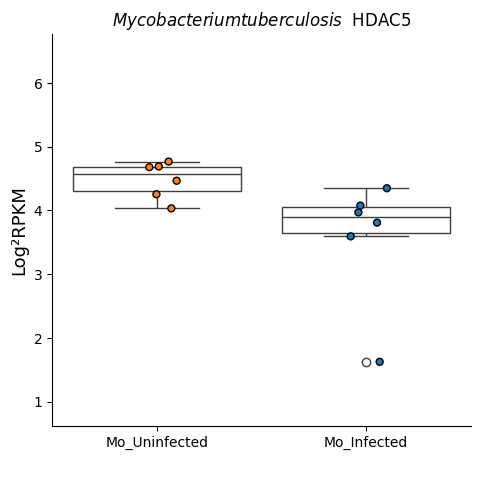

carregando


<Figure size 1000x800 with 0 Axes>

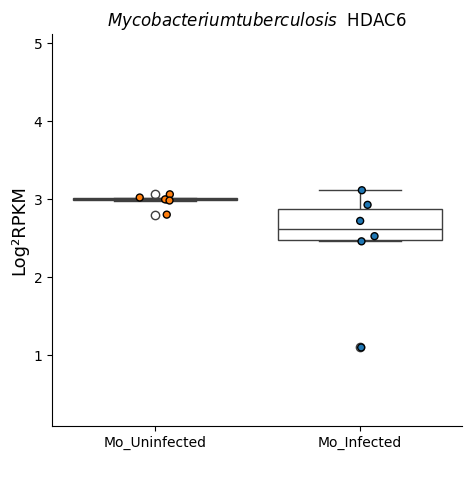

carregando


<Figure size 1000x800 with 0 Axes>

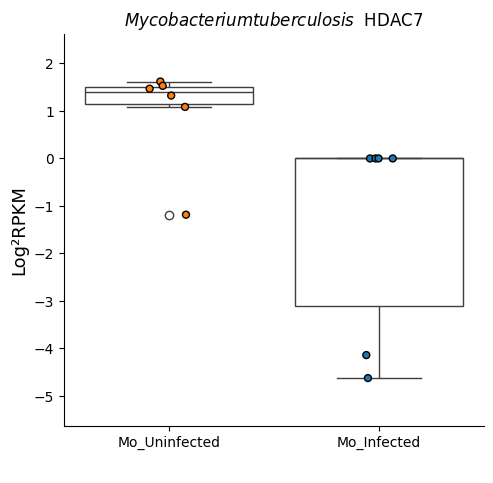

carregando


<Figure size 1000x800 with 0 Axes>

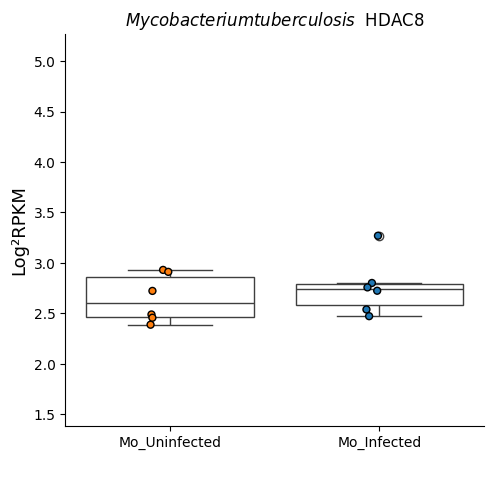

carregando


<Figure size 1000x800 with 0 Axes>

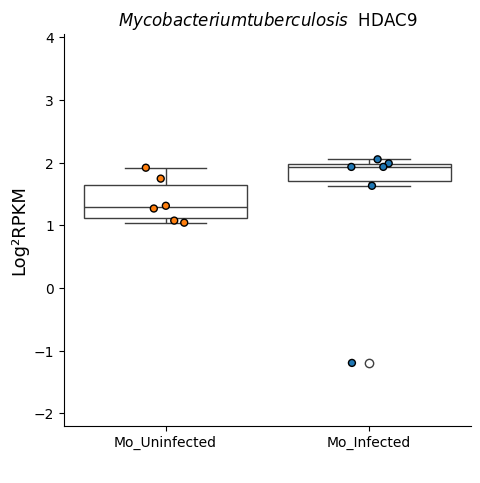

carregando


<Figure size 1000x800 with 0 Axes>

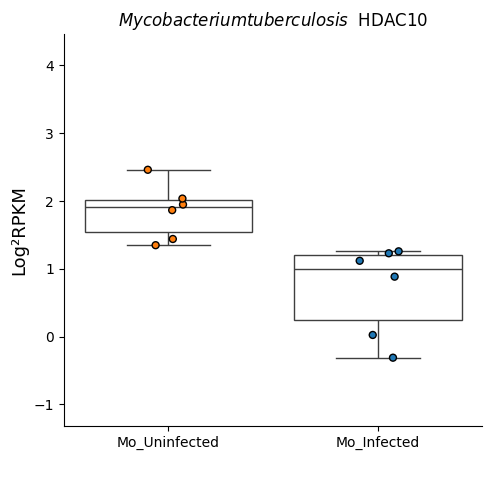

carregando


<Figure size 1000x800 with 0 Axes>

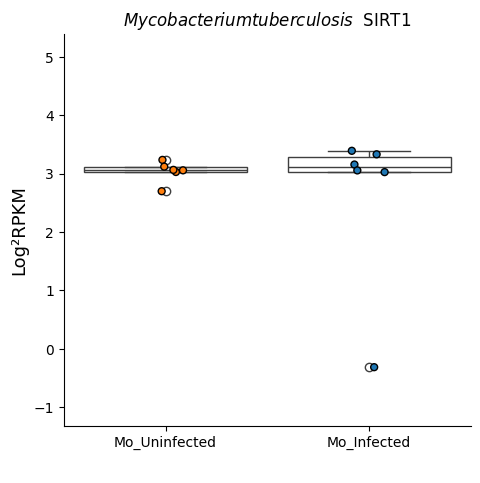

carregando


<Figure size 1000x800 with 0 Axes>

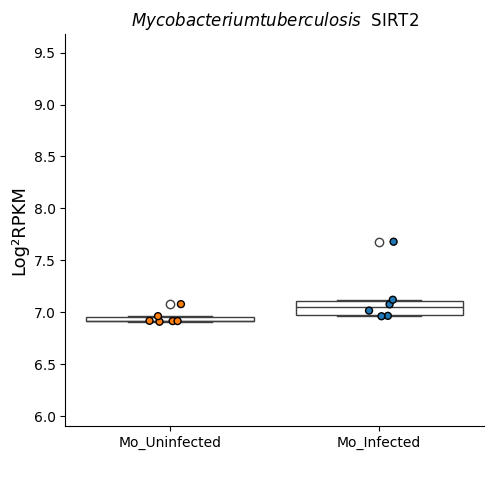

carregando


<Figure size 1000x800 with 0 Axes>

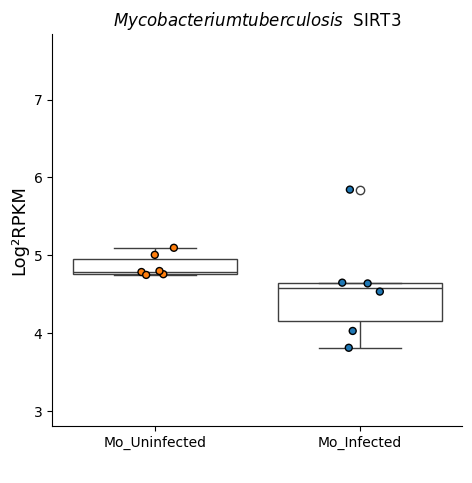

carregando


<Figure size 1000x800 with 0 Axes>

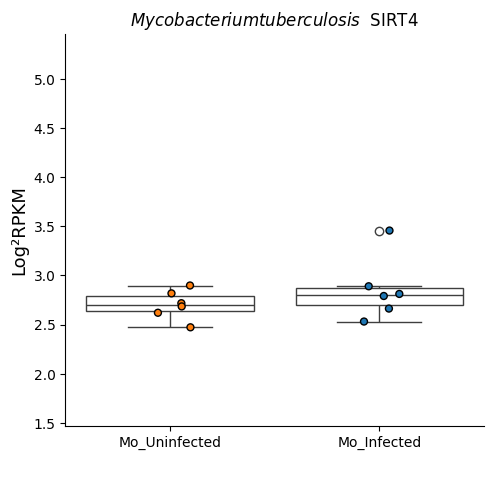

carregando


<Figure size 1000x800 with 0 Axes>

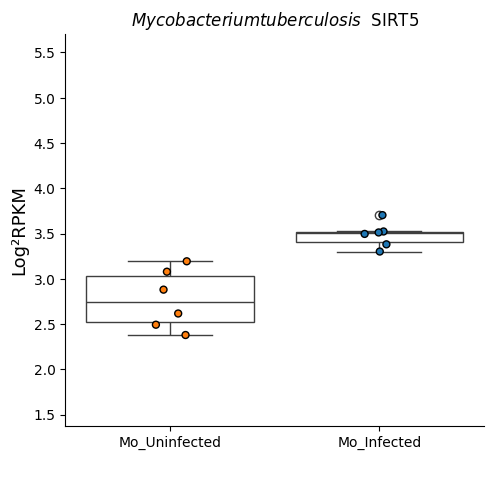

carregando


<Figure size 1000x800 with 0 Axes>

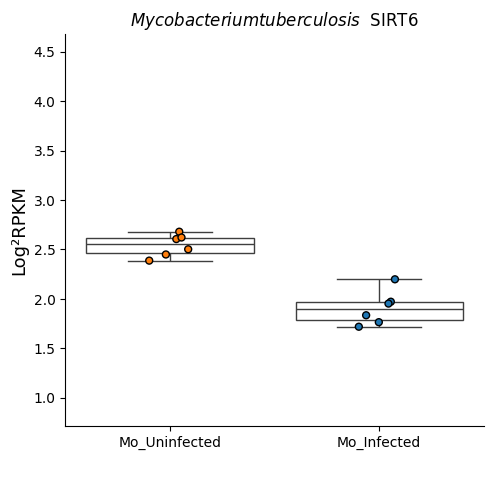

carregando


<Figure size 1000x800 with 0 Axes>

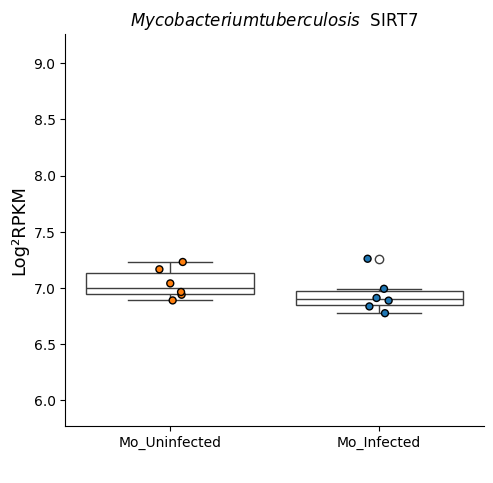

carregando


In [ ]:

graficos_boxplot(SRP151491_df_filtrado, "BuGn", " Mycobacterium tuberculosis", ["Mo_Uninfected", "Mo_Infected" ])



##GSE100897 ✅


In [ ]:
id_gene_pasta="GSE100897"
GSE100897_tab = pd.read_excel(GSE100897 )
GSE100897_tab.head()

,Nome,THP-1_infected_24h_SRR5810182,THP-1_infected_24h_SRR5810186,THP-1_infected_24h_SRR5810190,THP-1_infected_24h_SRR5810191,THP-1_infected_6h_SRR5810183,THP-1_infected_6h_SRR5810187,THP-1_infected_6h_SRR5810193,THP-1_infected_6h_SRR5810194,THP-1_uninfected_Contro_6h_SRR5810189,THP-1_uninfected_Control_24h_SRR5810184,THP-1_uninfected_Control_24h_SRR5810188,THP-1_uninfected_Control_24h_SRR5810192,THP-1_uninfected_Control_6h_SRR5810185,THP-1_uninfected_Control_6h_SRR5810195
0,YTHDF 1,4.655666,4.865315,5.128461,5.292453,4.342884,4.662162,4.558334,5.163883,4.878906,4.641800,4.885562,4.813444,4.971446,4.706040
1,YTHDF 2,5.438681,5.682585,5.709736,5.793060,5.658052,5.583458,5.350850,5.627107,5.783131,5.552966,5.779011,5.379888,5.658261,5.670378
2,YTHDF 3,5.883265,6.478937,6.372829,6.330711,6.015344,6.265324,5.852735,6.359514,6.037638,6.132588,6.106475,5.684126,6.265899,5.868739
3,YTHDC 1,1.866870,2.148387,-1.794913,-1.425908,1.389060,1.941959,-1.230377,-2.007600,0.810079,0.066891,0.790060,-1.403699,0.962092,-2.457761
4,FTO,2.844184,3.534025,3.681633,3.807844,2.956505,3.035044,3.656994,3.054635,3.745813,4.130851,4.231338,4.210493,4.180522,3.978732


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE100897_df_filtrado = GSE100897_tab[GSE100897_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE100897_df_filtrado.index = GSE100897_df_filtrado["Nome"]

GSE100897_df_filtrado = GSE100897_df_filtrado.T
df_filtrado = GSE100897_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
THP-1_infected_24h_SRR5810182,5.918303,1.79097,5.60944,3.717841,4.236836,1.174626,4.838016,2.970888,2.8932,2.194227,...,4.459313,5.857758,1.645611,4.582658,4.058566,0.875199,1.68551,1.890361,3.684427,4.280179
THP-1_infected_24h_SRR5810186,5.181987,1.806212,5.17995,4.40786,5.097161,2.25032,5.118242,3.940743,3.713365,3.695202,...,4.405883,5.795501,1.251486,4.885512,3.980947,0.89131,1.083955,1.932467,3.656368,4.537323
THP-1_infected_24h_SRR5810190,5.283064,3.88343,4.55313,3.980582,5.636237,4.146326,5.338136,3.134356,4.241685,4.938436,...,4.026833,5.99121,2.941123,4.705146,4.341439,2.457722,1.335671,3.908697,3.432164,5.035453
THP-1_infected_24h_SRR5810191,5.832108,4.043505,4.738619,3.054234,5.585425,2.976115,5.268717,3.146427,3.930318,4.918172,...,4.858123,5.291749,2.982114,4.7756,4.241722,2.714871,0.989129,3.989419,3.272036,4.573192
THP-1_infected_6h_SRR5810183,5.612894,2.472929,3.779644,3.523924,4.892791,2.268221,5.072426,3.988077,3.08395,3.168485,...,4.914758,6.436937,0.449944,4.714533,4.215524,1.252998,1.041253,2.526816,3.885789,3.997857


In [ ]:
df_filtrado.index.to_list()

['THP-1_infected_24h_SRR5810182',
 'THP-1_infected_24h_SRR5810186',
 'THP-1_infected_24h_SRR5810190',
 'THP-1_infected_24h_SRR5810191',
 'THP-1_infected_6h_SRR5810183',
 'THP-1_infected_6h_SRR5810187',
 'THP-1_infected_6h_SRR5810193',
 'THP-1_infected_6h_SRR5810194',
 'THP-1_uninfected_Contro_6h_SRR5810189',
 'THP-1_uninfected_Control_24h_SRR5810184',
 'THP-1_uninfected_Control_24h_SRR5810188',
 'THP-1_uninfected_Control_24h_SRR5810192',
 'THP-1_uninfected_Control_6h_SRR5810185',
 'THP-1_uninfected_Control_6h_SRR5810195']

In [ ]:
df_filtrado["Status"] =   ['infected_24h',
'infected_24h',
'infected_24h',
'infected_24h',
'infected_6h',
'infected_6h',
'infected_6h',
'infected_6h',
'uninfected_6h',
'uninfected_24h',
'uninfected_24h',
'uninfected_24h',
'uninfected_6h',
'uninfected_6h']

<ipython-input-61-6935d706fa2d>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =   ['infected_24h',


In [ ]:
list(set(df_filtrado["Status"]))


['infected_6h', 'uninfected_24h', 'infected_24h', 'uninfected_6h']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'infected_6h']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'uninfected_6h']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,-0.272007,0.286552,0.211793,0.19212,-0.089407,0.111341,-0.545399,0.013613,0.040143,1.148752,...,-0.273429,-0.110428,-0.053214,0.129069,-0.614588,-0.4728,-0.926946,0.029135,-0.234325,-0.068753


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="M_tuberculosis_6H_GSE100897"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE100897/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,UP,...,Normal,Normal,Normal,Normal,Down,Normal,Down,Normal,Normal,Normal


In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'infected_24h']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'uninfected_24h']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,-0.449211,0.535307,1.163939,0.385029,0.176775,0.880143,-0.316222,-0.67315,0.467018,1.658512,...,-0.145993,-0.56366,0.45753,0.286201,-0.192251,-0.097616,0.36317,0.14554,-0.585284,0.258797


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes2 = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes2[i].valores >= 0.6:
        regulated_genes2[i] = "UP"
        continue

    if regulated_genes2[i].valores <= -0.6:
        regulated_genes2[i] = "Down"

    else:
        regulated_genes2[i] = "Normal"
    # print(regulated_genes2[i])

#############################################################
nome="M_tuberculosis_24H_GSE100897"
regulated_genes2.to_excel(nome+".xlsx")
regulated_genes2.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE100897/"+ nome+".xlsx")
regulated_genes2
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,UP,Normal,Normal,UP,Normal,Down,Normal,UP,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.7,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



<Figure size 800x800 with 0 Axes>

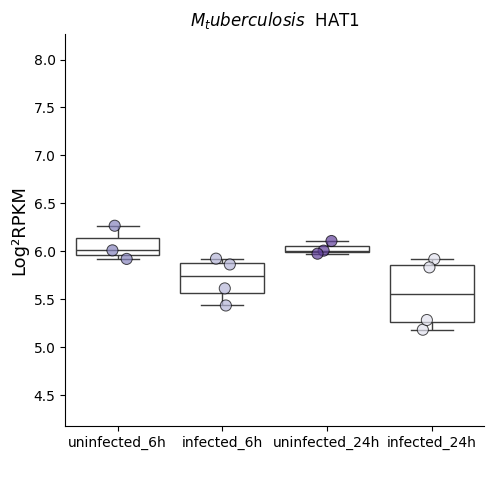

carregando


<Figure size 800x800 with 0 Axes>

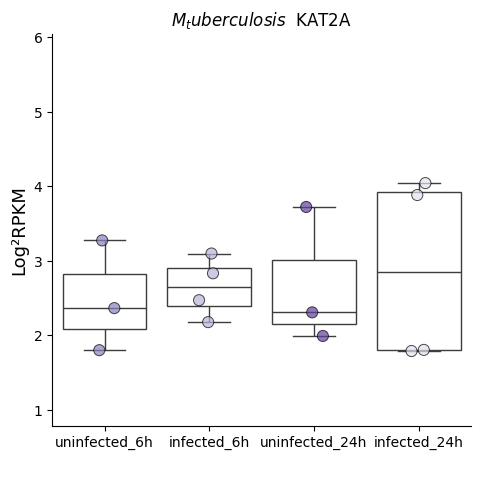

carregando


<Figure size 800x800 with 0 Axes>

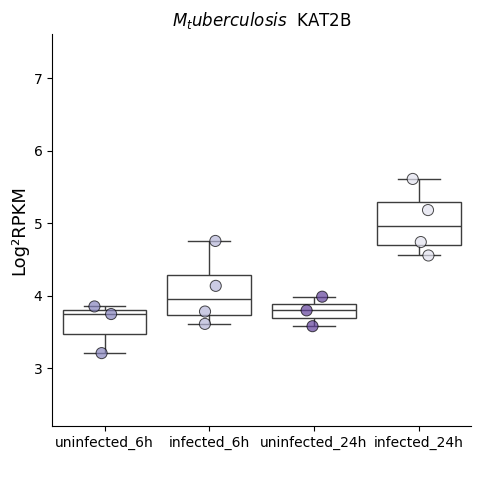

carregando


<Figure size 800x800 with 0 Axes>

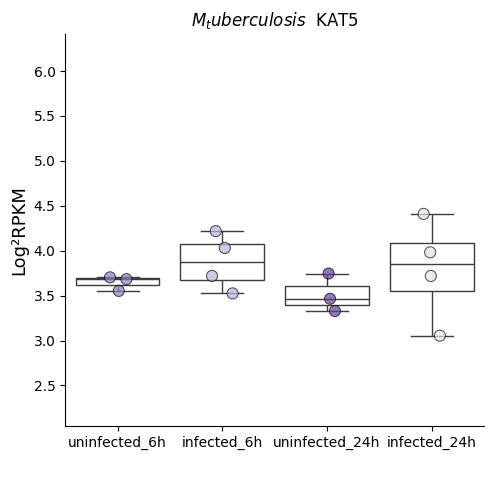

carregando


<Figure size 800x800 with 0 Axes>

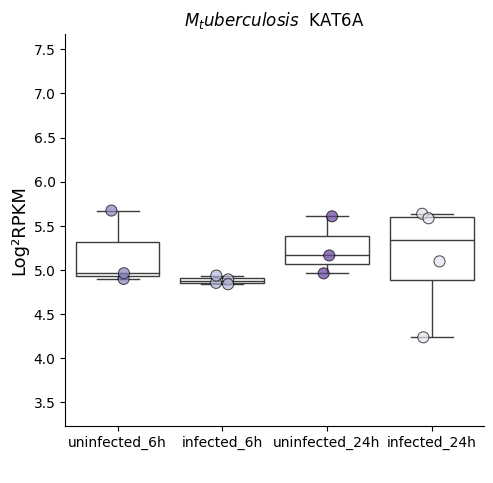

carregando


<Figure size 800x800 with 0 Axes>

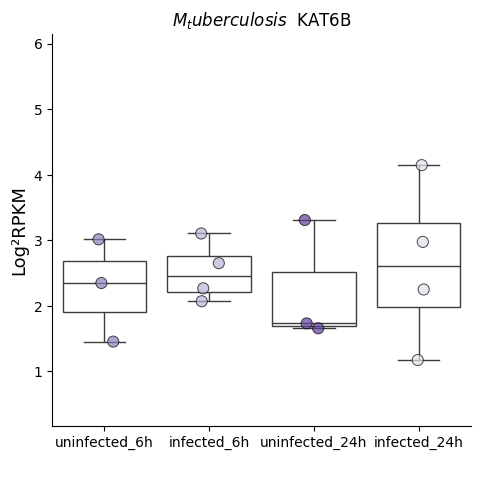

carregando


<Figure size 800x800 with 0 Axes>

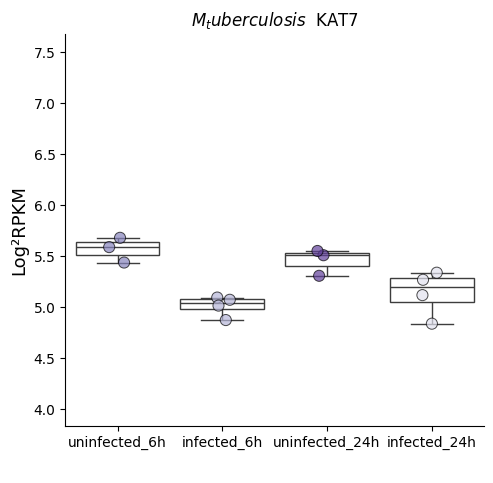

carregando


<Figure size 800x800 with 0 Axes>

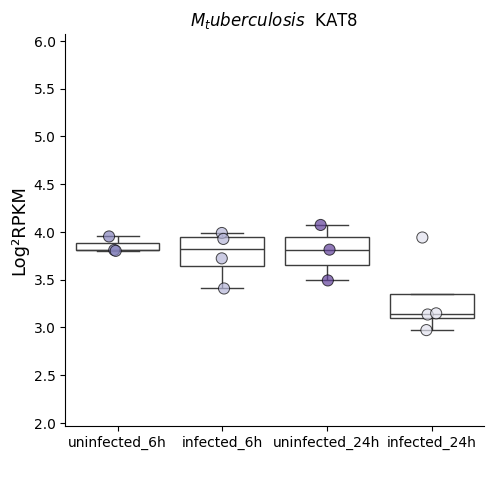

carregando


<Figure size 800x800 with 0 Axes>

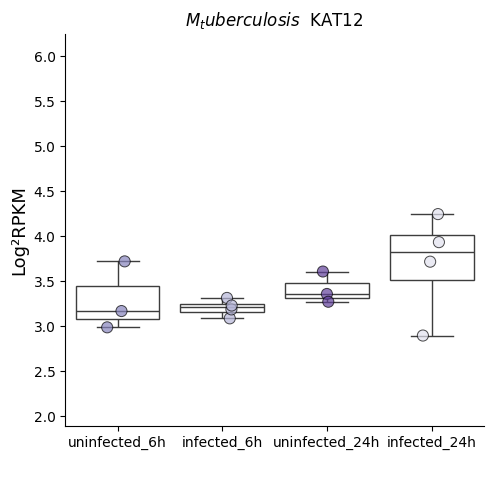

carregando


<Figure size 800x800 with 0 Axes>

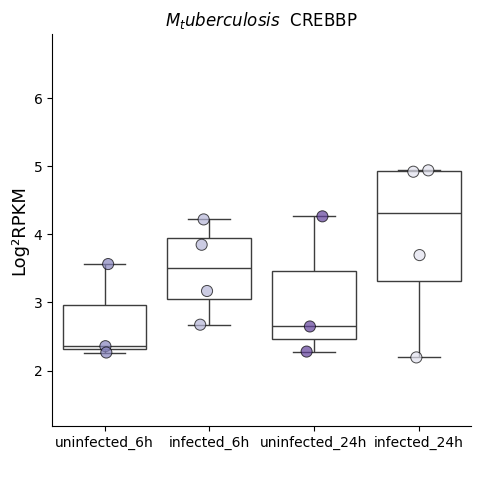

carregando


<Figure size 800x800 with 0 Axes>

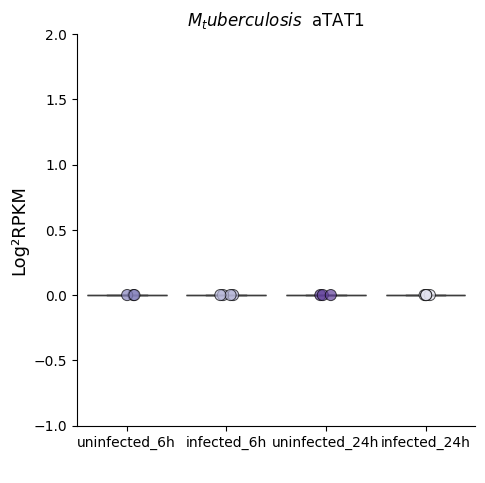

carregando


<Figure size 800x800 with 0 Axes>

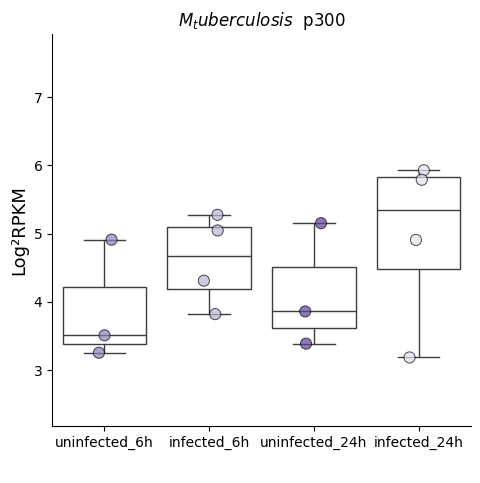

carregando


<Figure size 800x800 with 0 Axes>

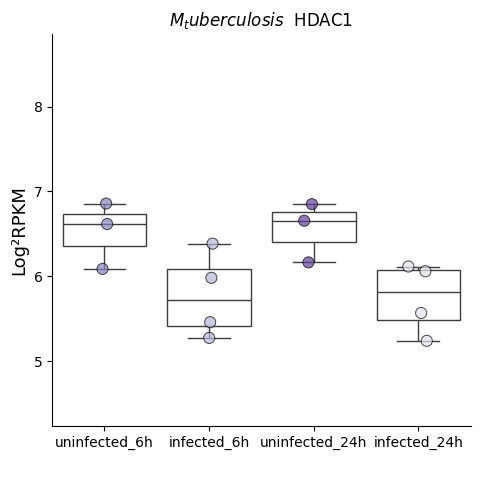

carregando


<Figure size 800x800 with 0 Axes>

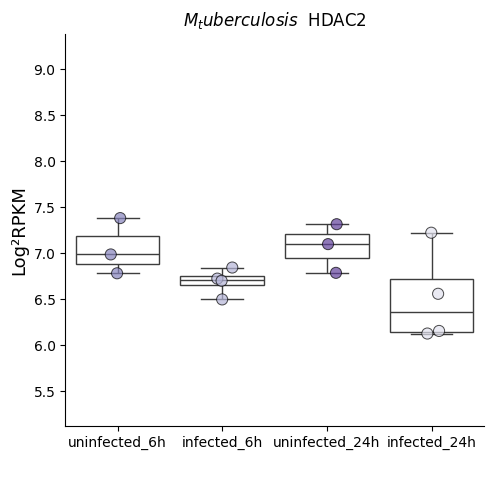

carregando


<Figure size 800x800 with 0 Axes>

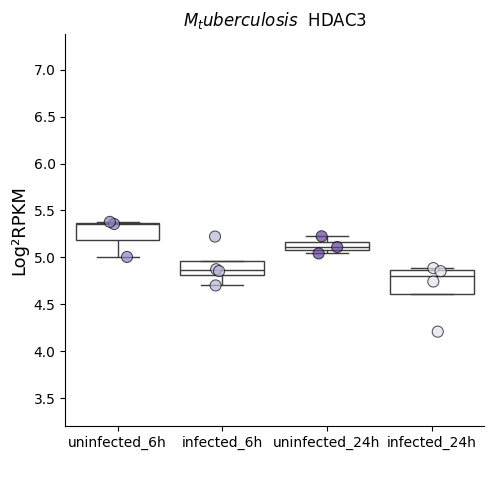

carregando


<Figure size 800x800 with 0 Axes>

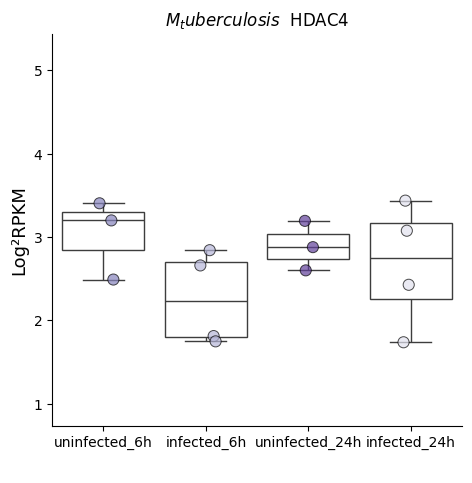

carregando


<Figure size 800x800 with 0 Axes>

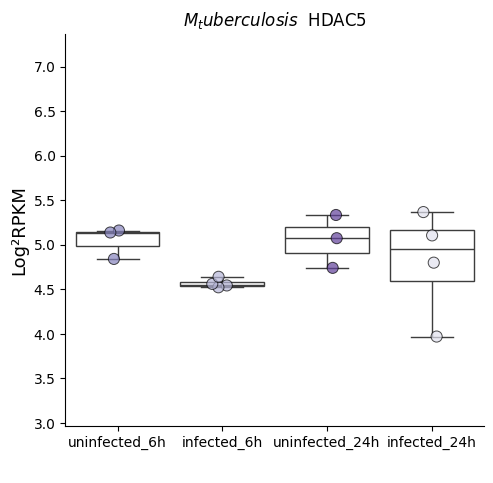

carregando


<Figure size 800x800 with 0 Axes>

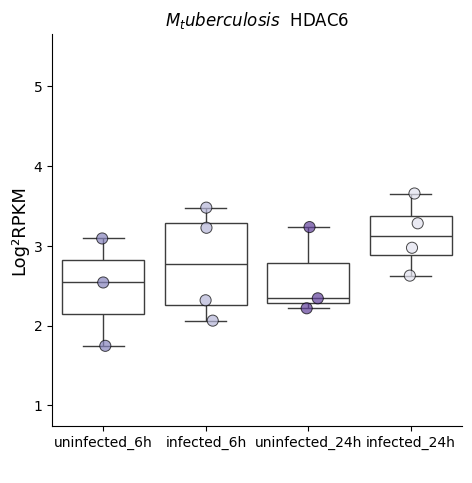

carregando


<Figure size 800x800 with 0 Axes>

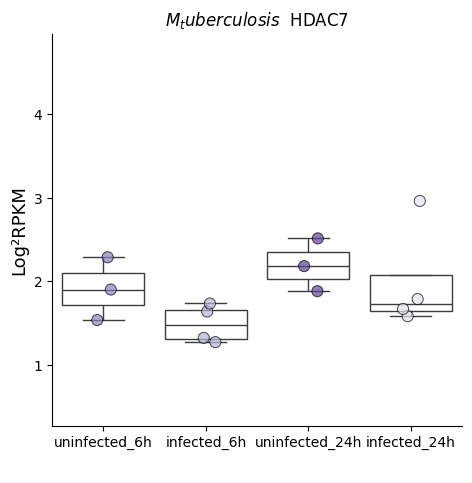

carregando


<Figure size 800x800 with 0 Axes>

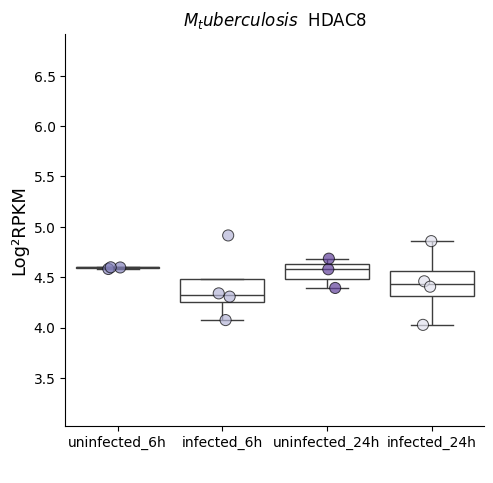

carregando


<Figure size 800x800 with 0 Axes>

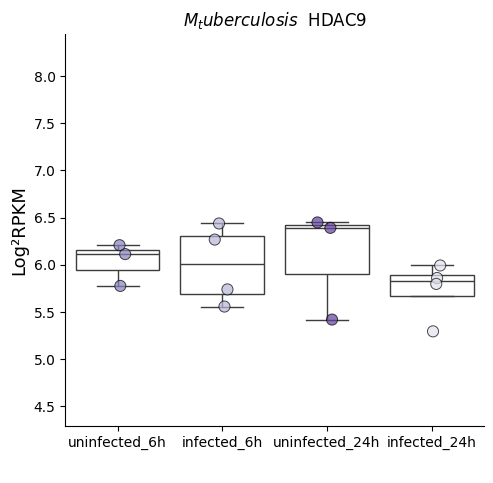

carregando


<Figure size 800x800 with 0 Axes>

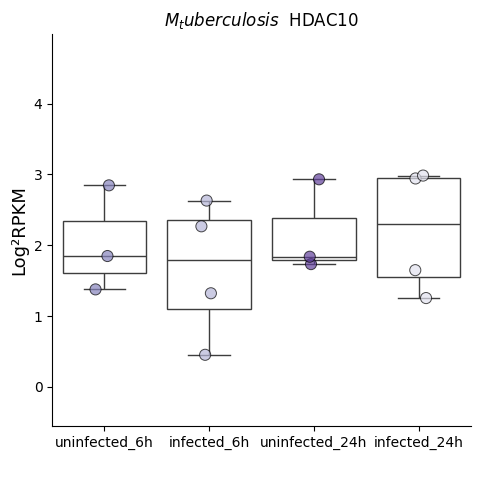

carregando


<Figure size 800x800 with 0 Axes>

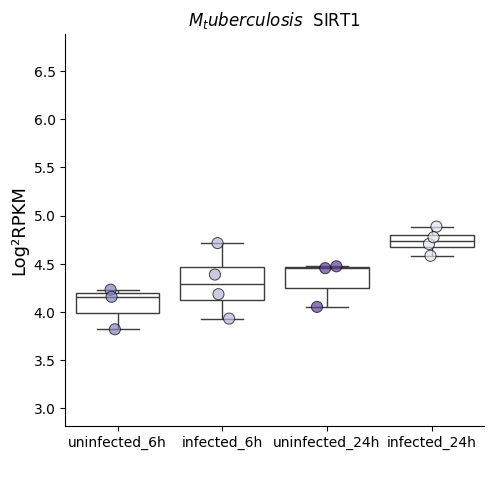

carregando


<Figure size 800x800 with 0 Axes>

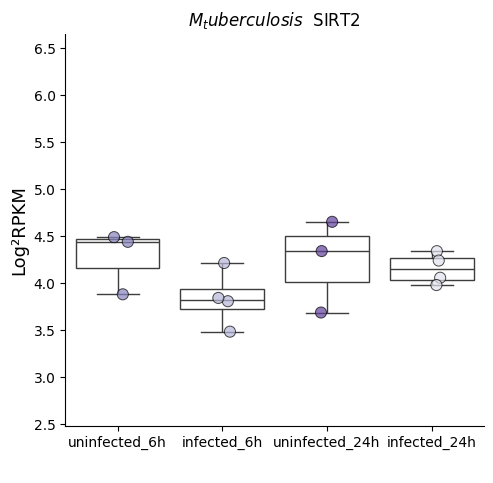

carregando


<Figure size 800x800 with 0 Axes>

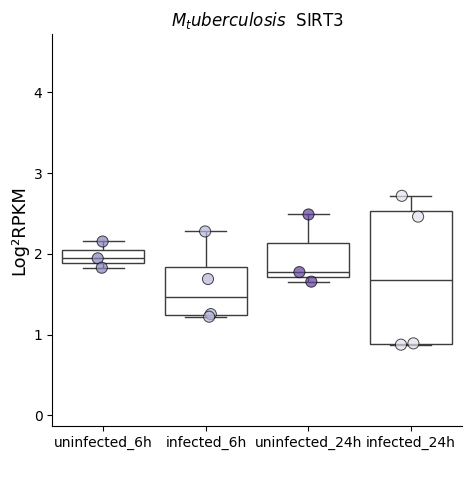

carregando


<Figure size 800x800 with 0 Axes>

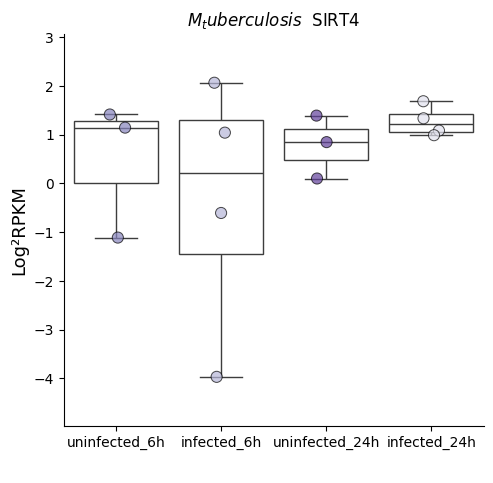

carregando


<Figure size 800x800 with 0 Axes>

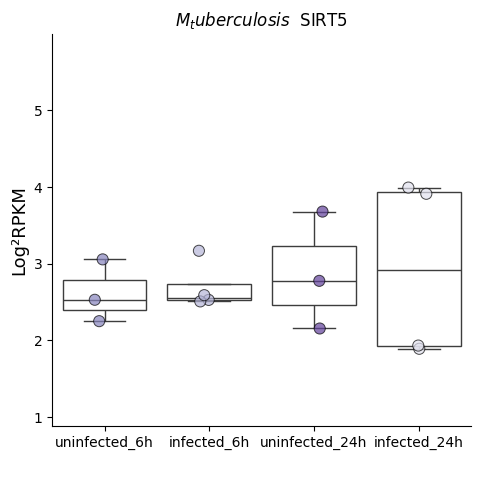

carregando


<Figure size 800x800 with 0 Axes>

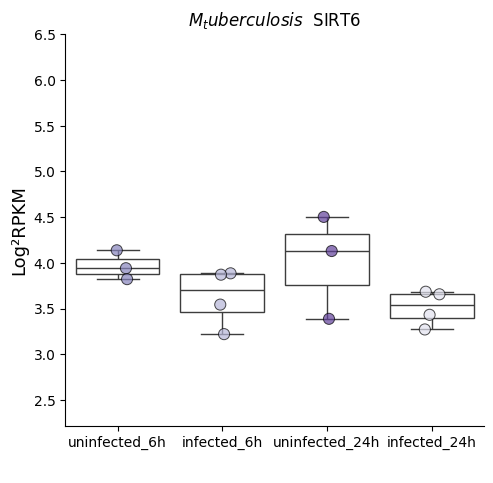

carregando


<Figure size 800x800 with 0 Axes>

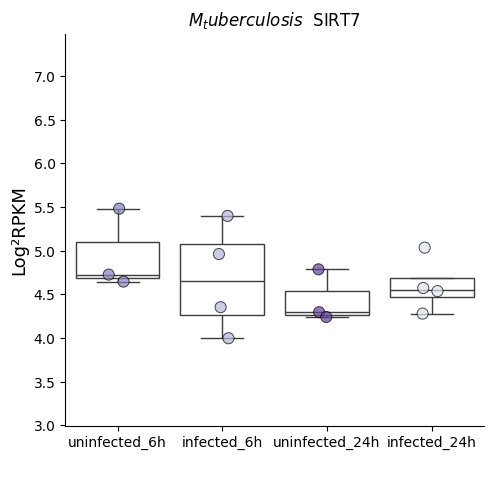

carregando


In [ ]:
graficos_boxplot(df_filtrado, "Purples", "M_tuberculosis",     ["uninfected_6h" ,'infected_6h', 'uninfected_24h', 'infected_24h']         , "M_tuberculosis_GSE100897")


##GSE141656 ✅


In [ ]:
id_gene_pasta="GSE141656"
GSE141656_tab = pd.read_excel(GSE141656 )
GSE141656_tab.head()

,Nome,6_day_media_(control)_SRR10611476,6_day_media_(control)_SRR10611480,6_day_media_(control)_SRR10611484,6_day_media_MTB_4hr_SRR10611475,6_day_media_MTB_4hr_SRR10611479,6_day_media_MTB_4hr_SRR10611483,BG_24hr_5_day_media_MTB_4hr_SRR10611473,BG_24hr_5_day_media_MTB_4hr_SRR10611477,BG_24hr_5_day_media_MTB_4hr_SRR10611481,BG_24hr_5_day_media_SRR10611474,BG_24hr_5_day_media_SRR10611478,BG_24hr_5_day_media_SRR10611482
0,YTHDF 1,5.058200,5.089406,5.017860,5.244532,5.327253,5.455495,4.948445,4.908411,4.934420,4.839868,4.728406,4.772378
1,YTHDF 2,5.302324,5.388933,5.263626,5.563652,5.421657,5.375564,5.343346,5.372597,5.192546,5.129055,5.058657,5.051068
2,YTHDF 3,6.299894,6.032676,6.081763,6.373611,6.185254,6.084199,6.278428,6.116305,6.213184,6.231097,5.992584,5.972313
3,YTHDC 1,-2.671081,-1.224785,-2.547179,-0.432882,-0.091566,-2.559158,-0.137258,-2.253247,-2.710879,-0.073497,0.304507,-3.332778
4,FTO,3.008149,3.142878,3.191401,1.724187,2.312941,2.119448,2.477075,2.543441,2.518979,3.630853,3.601097,3.177865


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE141656_df_filtrado = GSE141656_tab[GSE141656_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE141656_df_filtrado.index = GSE141656_df_filtrado["Nome"]

GSE141656_df_filtrado = GSE141656_df_filtrado.T
df_filtrado = GSE141656_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
6_day_media_(control)_SRR10611476,4.786163,3.040177,3.25906,4.481746,3.600473,2.425275,4.536205,4.482512,3.187927,3.871585,...,3.459728,3.395934,4.63319,4.517898,5.972923,3.107128,-0.703502,4.00525,4.126107,5.580251
6_day_media_(control)_SRR10611480,4.601931,3.881495,3.382188,4.655408,4.143272,2.577482,4.56442,4.807185,3.026865,4.333838,...,3.363281,2.954482,4.933784,4.769282,6.136255,3.574833,-0.355,3.671371,4.425406,5.760514
6_day_media_(control)_SRR10611484,4.285898,3.533155,3.379689,4.471727,3.684716,2.5072,4.331775,4.673706,2.887302,4.010212,...,3.176815,3.037908,4.862105,4.660594,6.17169,3.382849,-0.923555,3.570616,4.40507,5.833667
6_day_media_MTB_4hr_SRR10611475,4.770058,1.870843,2.816788,4.255019,3.65242,1.68704,3.967272,3.500597,3.691507,3.978326,...,2.914118,4.636008,3.96488,4.107962,5.580282,1.078754,-1.961261,2.086923,4.209958,5.3487
6_day_media_MTB_4hr_SRR10611479,4.44039,2.392483,2.726028,4.522465,3.872212,2.116116,4.012171,4.207697,3.394445,4.334384,...,3.05562,3.777755,3.996609,4.692404,5.518924,1.927258,-1.652367,1.739529,4.060404,5.701083


In [ ]:
df_filtrado.index.to_list()

['6_day_media_(control)_SRR10611476',
 '6_day_media_(control)_SRR10611480',
 '6_day_media_(control)_SRR10611484',
 '6_day_media_MTB_4hr_SRR10611475',
 '6_day_media_MTB_4hr_SRR10611479',
 '6_day_media_MTB_4hr_SRR10611483',
 'BG_24hr_5_day_media_MTB_4hr_SRR10611473',
 'BG_24hr_5_day_media_MTB_4hr_SRR10611477',
 'BG_24hr_5_day_media_MTB_4hr_SRR10611481',
 'BG_24hr_5_day_media_SRR10611474',
 'BG_24hr_5_day_media_SRR10611478',
 'BG_24hr_5_day_media_SRR10611482']

In [ ]:
df_filtrado["Status"] =   ['6_day_(control)',
'6_day_(control)',
'6_day_(control)',

'6_day_MTB_4hr',
'6_day_MTB_4hr',
'6_day_MTB_4hr',

'BG_24hr_5_day_MTB_4hr',
'BG_24hr_5_day_MTB_4hr',
'BG_24hr_5_day_MTB_4hr',

'BG_24hr_5_day',
'BG_24hr_5_day',
'BG_24hr_5_day']   # BG_24hr_5_day vs  BG_24hr_5_day_MTB_4hr
#6_day_(control) vs 6_day_MTB_4hr

<ipython-input-8-79b7c8dfb25b>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =   ['6_day_(control)',


In [ ]:
list(set(df_filtrado["Status"]))


['BG_24hr_5_day', 'BG_24hr_5_day_MTB_4hr', '6_day_MTB_4hr', '6_day_(control)']

In [31]:
# BG_24hr_5_day vs  BG_24hr_5_day_MTB_4hr
#6_day_(control) vs 6_day_MTB_4hr
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'BG_24hr_5_day_MTB_4hr']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'BG_24hr_5_day']
#############################################################


UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [32]:
# BG_24hr_5_day vs  BG_24hr_5_day_MTB_4hr
#6_day_(control) vs 6_day_MTB_4hr
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="BG_24hr_5_day vs  BG_24hr_5_day_MTB_4hr_GSE141656_M_tuberculosis"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE141656/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [33]:
# BG_24hr_5_day vs  BG_24hr_5_day_MTB_4hr
#6_day_(control) vs 6_day_MTB_4hr
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == '6_day_MTB_4hr']
uninfected_data = df_filtrado[df_filtrado['Status'] == '6_day_(control)']
#############################################################


UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [34]:
gen_reg = INF_df-UNF_df
regulated_genes2 = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes2[i].valores >= 0.6:
        regulated_genes2[i] = "UP"
        continue

    if regulated_genes2[i].valores <= -0.6:
        regulated_genes2[i] = "Down"

    else:
        regulated_genes2[i] = "Normal"
    # print(regulated_genes2[i])

#############################################################
nome="6_day_(control) vs 6_day_MTB_4hr_GSE141656_M_tuberculosis"
regulated_genes2.to_excel(nome+".xlsx")
regulated_genes2.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE141656/"+ nome+".xlsx")
regulated_genes2
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == '6_day_MTB_4hr']
uninfected_data = df_filtrado[df_filtrado['Status'] == '6_day_(control)']
#############################################################


UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,-0.161541,-1.307398,-0.65366,-0.056628,-0.032296,-0.809462,-0.568933,-0.876259,0.606257,0.324173,...,-0.449149,0.805402,-0.865496,-0.095621,-0.555973,-2.090141,-0.948864,-1.931843,-0.195112,-0.208249


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes3 = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes3[i].valores >= 0.6:
        regulated_genes3[i] = "UP"
        continue

    if regulated_genes3[i].valores <= -0.6:
        regulated_genes3[i] = "Down"

    else:
        regulated_genes3[i] = "Normal"
    # print(regulated_genes3[i])

#############################################################
nome="control_6_day_vscontrol_6_day_MTB_4hr_GSE141656_M_tuberculosis"
regulated_genes3.to_excel(nome+".xlsx")
regulated_genes3.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE141656/"+ nome+".xlsx")
regulated_genes3
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Down,Down,Normal,Normal,Down,Normal,Down,UP,Normal,...,Normal,UP,Down,Normal,Normal,Down,Down,Down,Normal,Normal


In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'BG_24hr_5_day_MTB_4hr']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'BG_24hr_5_day']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,-0.015164,-1.216392,-0.322461,-0.123159,0.206858,-0.773548,-0.339773,-0.748121,0.465261,-0.004075,...,-0.285502,0.592113,-0.464601,-0.694847,-0.515175,-1.821579,-1.869954,-1.316169,-0.163802,-0.072686



```
 res_control_vs_BG_24hr_5_day <- results(dds, contrast = c("condition", "control_6_day", "BG_24hr_5_day"))
```


```
res_control_MTB_4hr_vs_BG_MTB_4hr <- results(dds, contrast = c("condition", "control_6_day_MTB_4hr", "BG_24hr_5_day_MTB_4hr"))
```


```
res_control_6_day_vs_control_MTB_4hr <- results(dds, contrast = c("condition", "control_6_day", "control_6_day_MTB_4hr"))
```

```
res_BG_5_day_vs_BG_MTB_4hr <- results(dds, contrast = c("condition", "BG_24hr_5_day", "BG_24hr_5_day_MTB_4hr"))
```


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes4 = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes4[i].valores >= 0.6:
        regulated_genes4[i] = "UP"
        continue

    if regulated_genes4[i].valores <= -0.6:
        regulated_genes4[i] = "Down"

    else:
        regulated_genes4[i] = "Normal"
    # print(regulated_genes4[i])

#############################################################
nome="BG_24hr_5_day_vs_BG_24hr_5_day_MTB_4hr_GSE141656_M_tuberculosis"
regulated_genes4.to_excel(nome+".xlsx")
regulated_genes4.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE141656/"+ nome+".xlsx")
regulated_genes4
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Down,Normal,Normal,Normal,Down,Normal,Down,Normal,Normal,...,Normal,Normal,Normal,Down,Normal,Down,Down,Down,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.8,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        ax.fig.subplots_adjust(bottom=0.35)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



<Figure size 800x800 with 0 Axes>

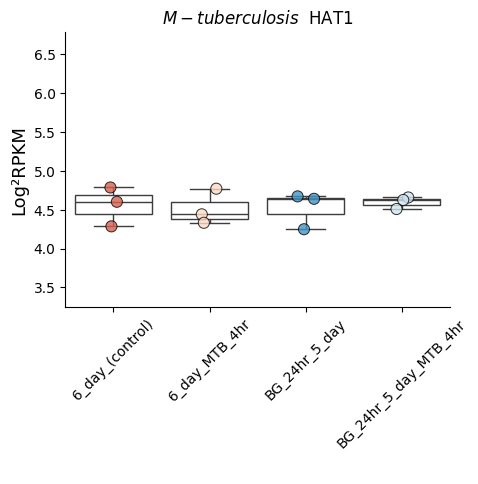

carregando


<Figure size 800x800 with 0 Axes>

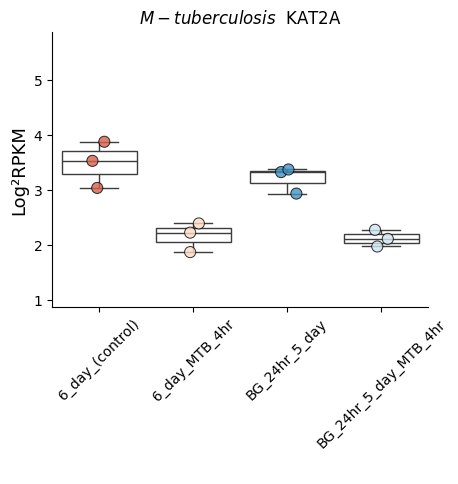

carregando


<Figure size 800x800 with 0 Axes>

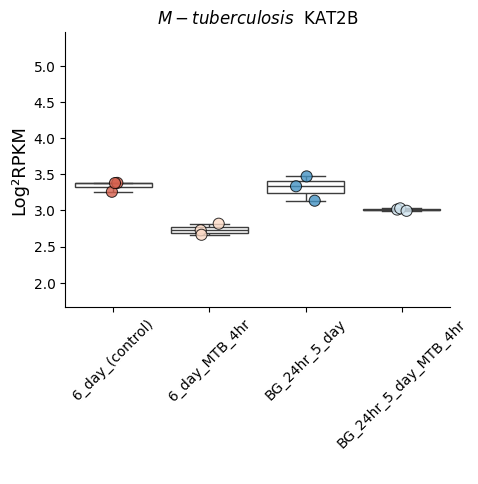

carregando


<Figure size 800x800 with 0 Axes>

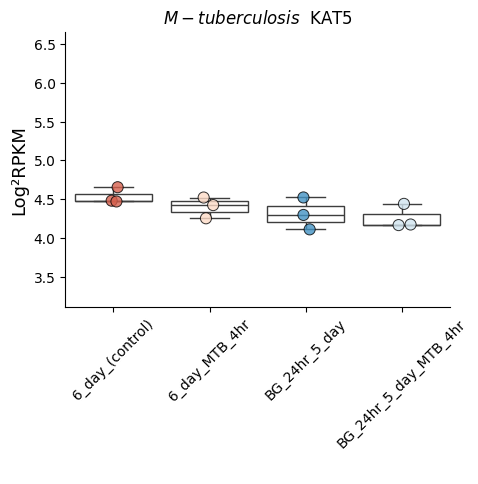

carregando


<Figure size 800x800 with 0 Axes>

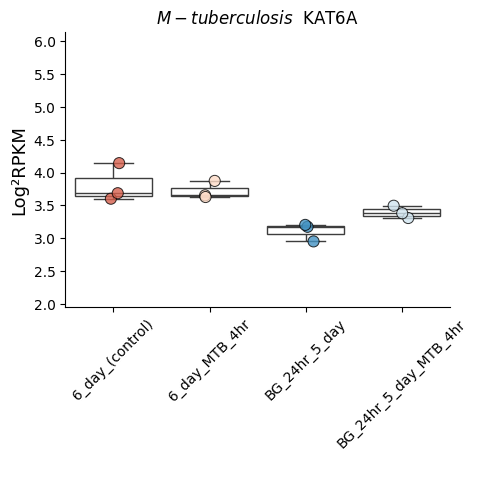

carregando


<Figure size 800x800 with 0 Axes>

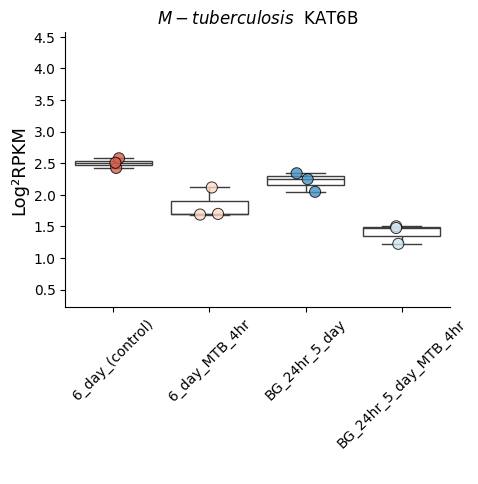

carregando


<Figure size 800x800 with 0 Axes>

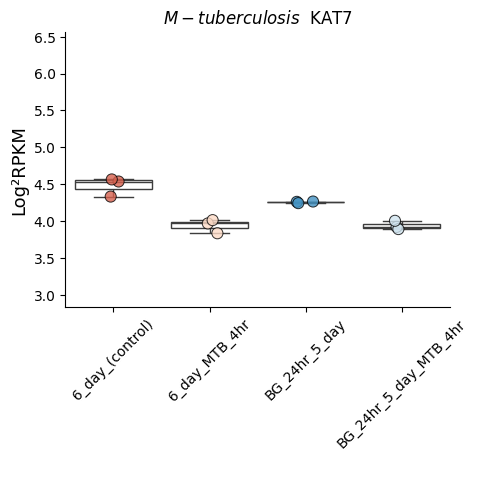

carregando


<Figure size 800x800 with 0 Axes>

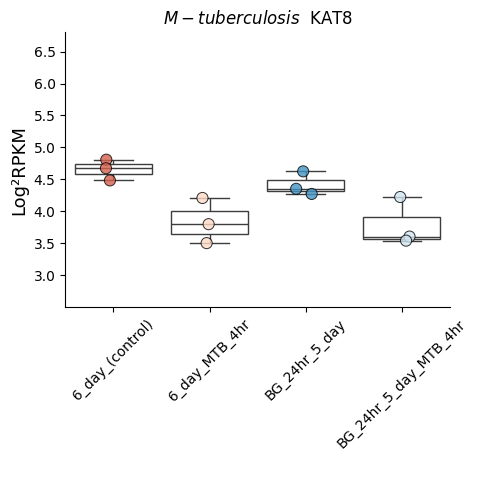

carregando


<Figure size 800x800 with 0 Axes>

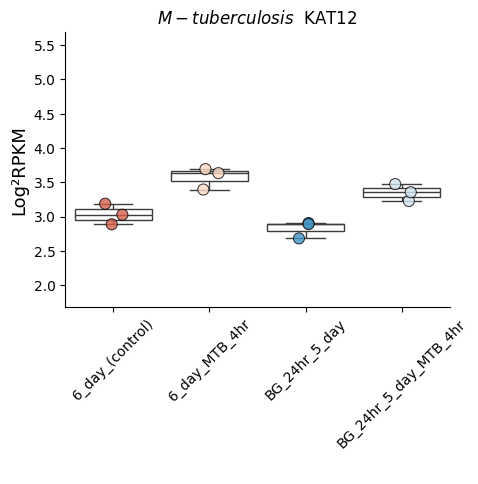

carregando


<Figure size 800x800 with 0 Axes>

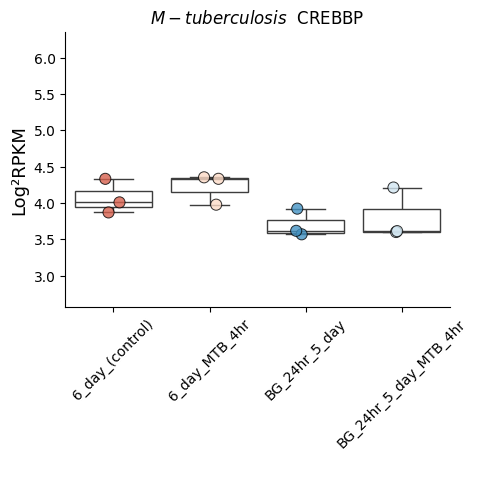

carregando


<Figure size 800x800 with 0 Axes>

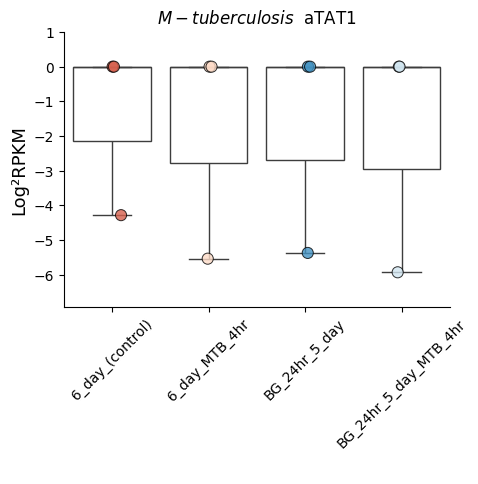

carregando


<Figure size 800x800 with 0 Axes>

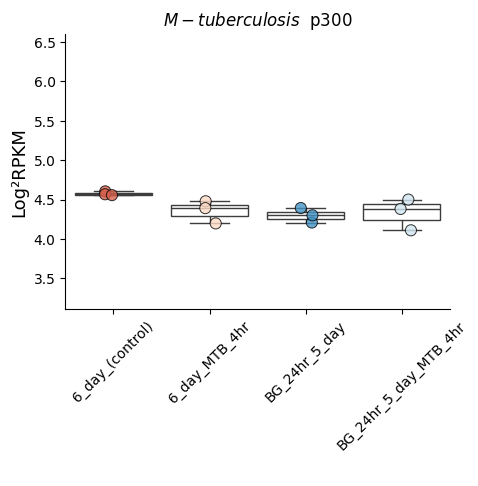

carregando


<Figure size 800x800 with 0 Axes>

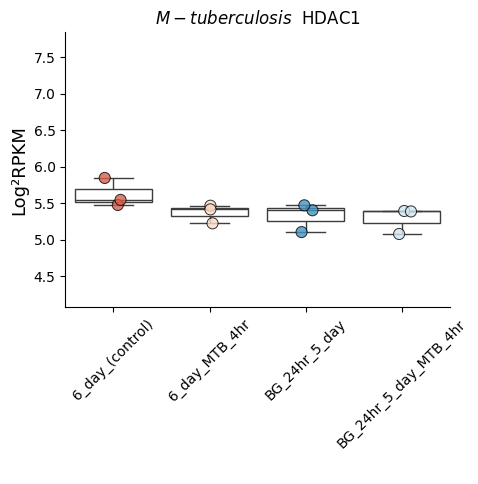

carregando


<Figure size 800x800 with 0 Axes>

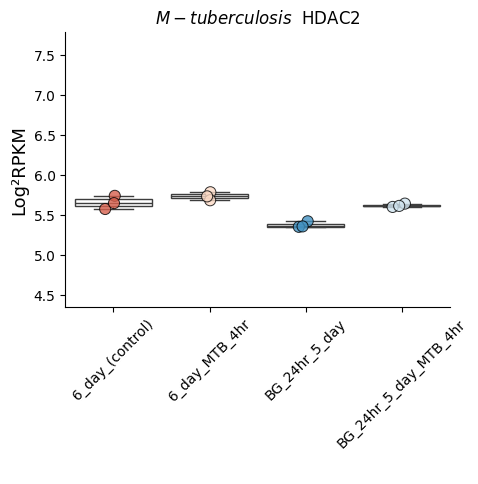

carregando


<Figure size 800x800 with 0 Axes>

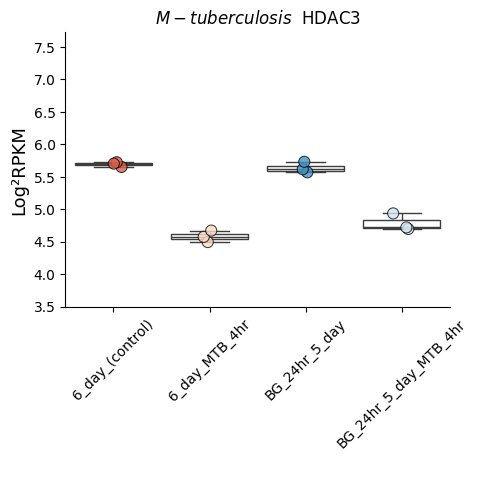

carregando


<Figure size 800x800 with 0 Axes>

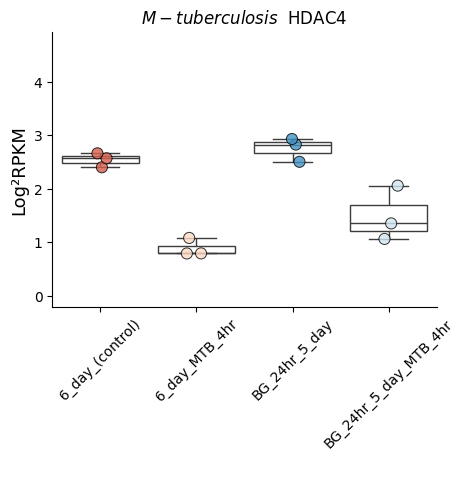

carregando


<Figure size 800x800 with 0 Axes>

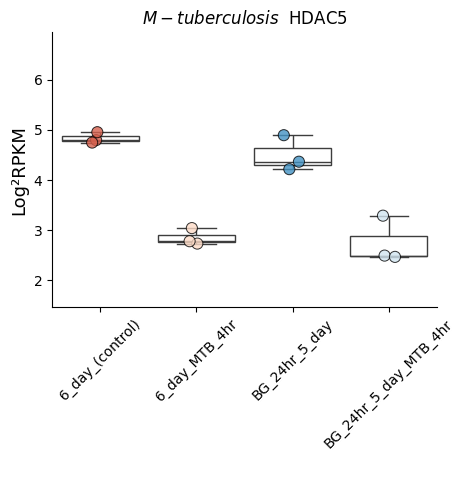

carregando


<Figure size 800x800 with 0 Axes>

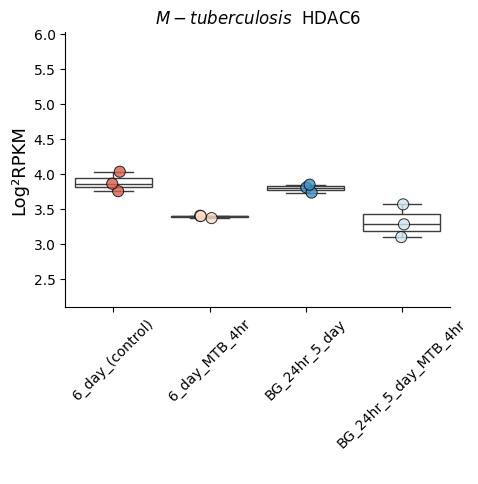

carregando


<Figure size 800x800 with 0 Axes>

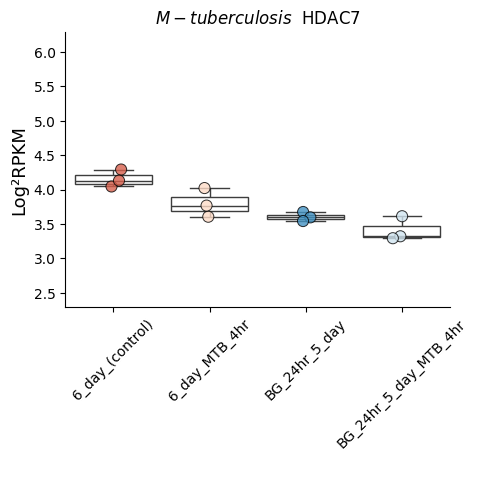

carregando


<Figure size 800x800 with 0 Axes>

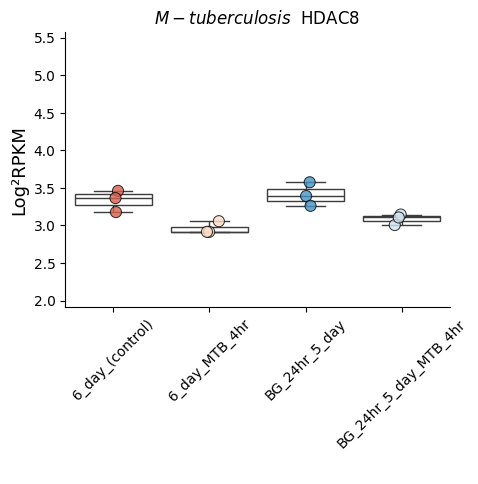

carregando


<Figure size 800x800 with 0 Axes>

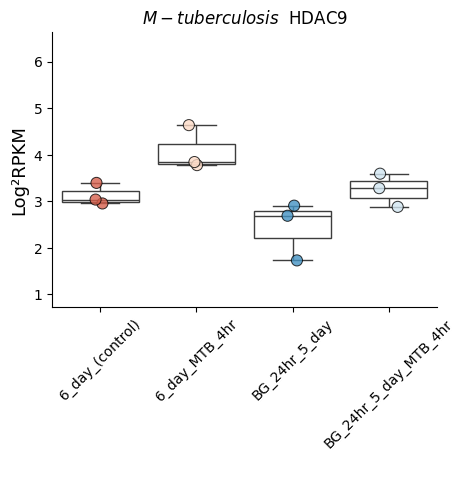

carregando


<Figure size 800x800 with 0 Axes>

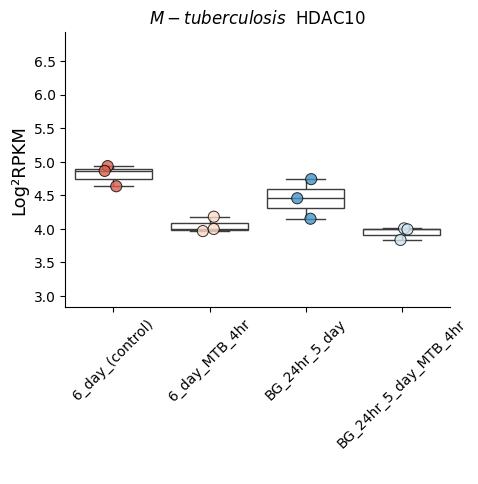

carregando


<Figure size 800x800 with 0 Axes>

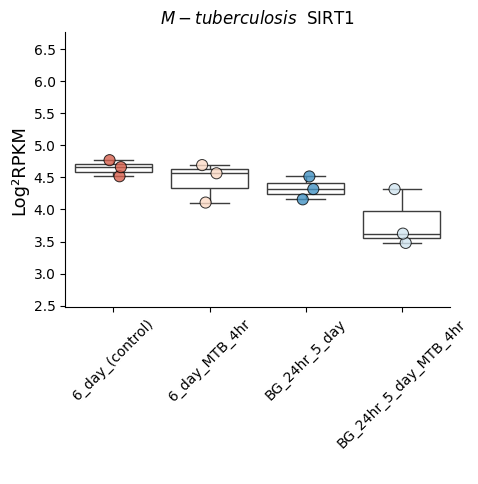

carregando


<Figure size 800x800 with 0 Axes>

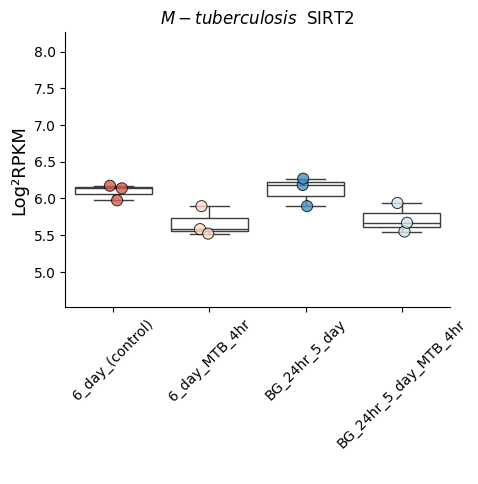

carregando


<Figure size 800x800 with 0 Axes>

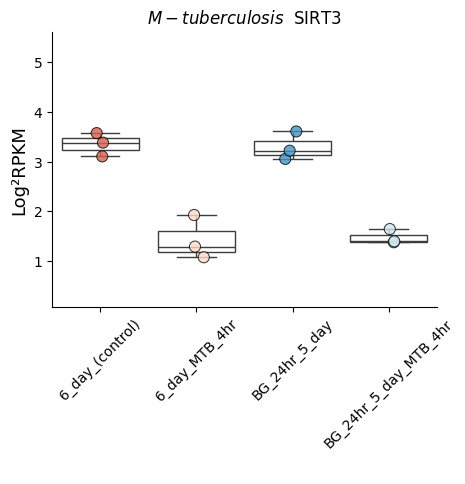

carregando


<Figure size 800x800 with 0 Axes>

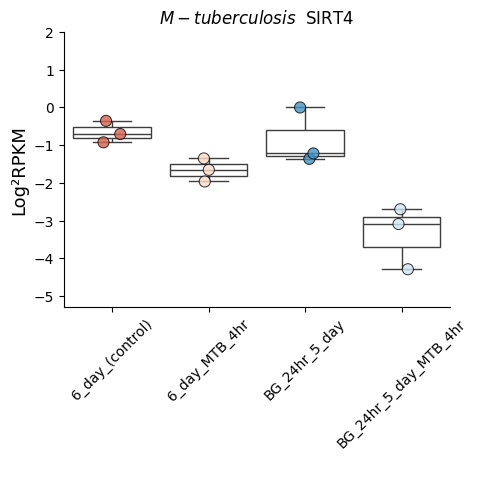

carregando


<Figure size 800x800 with 0 Axes>

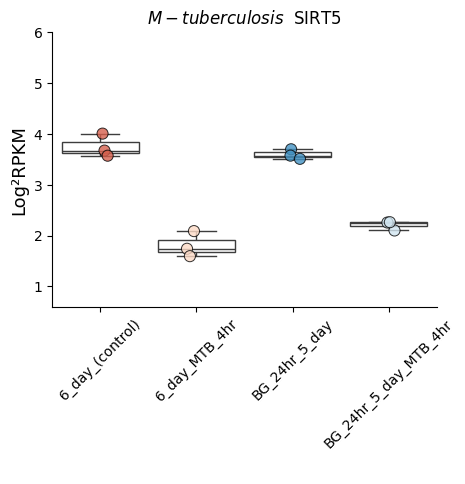

carregando


<Figure size 800x800 with 0 Axes>

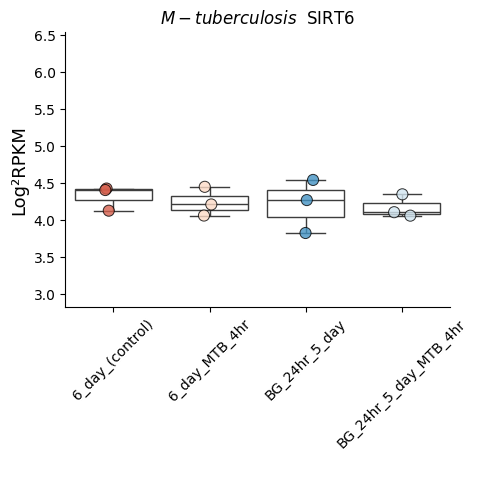

carregando


<Figure size 800x800 with 0 Axes>

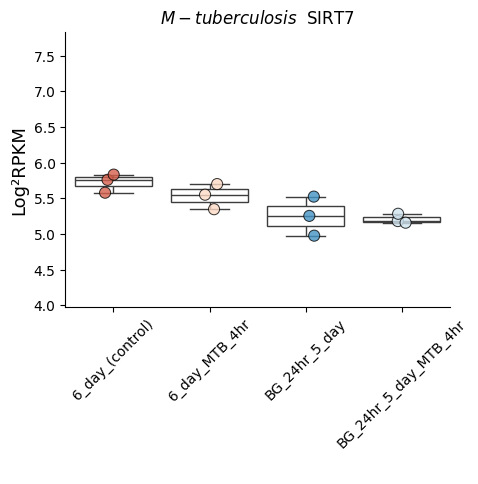

carregando


In [ ]:
graficos_boxplot(df_filtrado, "RdBu", "M-tuberculosis",     ['6_day_(control)', '6_day_MTB_4hr', 'BG_24hr_5_day', 'BG_24hr_5_day_MTB_4hr', ]         , "M_tuberculosis")


##PRJNA707548 ✅


In [ ]:
id_gene_pasta="PRJNA707548"
PRJNA707548_tab = pd.read_excel(PRJNA707548 )
PRJNA707548_tab.head()

,Nome,Lung_Infected_2w_1_SRR13893165,Lung_Infected_2w_2_SRR13893166,Lung_Infected_2w_3_SRR13893167,Lung_Infected_2w_4_SRR13893168,Lung_Infected_2w_5_SRR13893169,Lung_Infected_8w_1_SRR13893176,Lung_Infected_8w_2_SRR13893177,Lung_Infected_8w_3_SRR13893178,Lung_Infected_8w_4_SRR13893179,Lung_Uninfected_1_SRR13893155,Lung_Uninfected_2_SRR13893156,Lung_Uninfected_3_SRR13893157,Lung_Uninfected_4_SRR13893158,Lung_Uninfected_5_SRR13893159
0,YTHDF 1,4.973674,5.026631,5.174656,4.909450,5.283744,4.705636,4.860369,5.022568,5.227535,4.972217,5.044313,5.038879,4.907515,4.867299
1,YTHDF 2,4.566904,4.822531,4.953122,4.891614,4.883927,4.742473,4.884016,4.987652,5.275153,4.930959,5.001861,4.946024,4.993001,4.899135
2,YTHDF 3,5.971873,5.953089,6.038911,5.809583,6.004019,5.937599,6.012363,6.108000,6.076353,5.943574,5.789005,6.022226,5.813203,5.952988
3,YTHDC 1,5.205404,5.490177,5.564337,5.544940,5.627124,5.231098,5.164870,5.434091,5.652222,5.336384,5.340848,5.437570,5.230215,5.135373
4,FTO,5.996439,6.032924,5.997241,6.121220,5.949696,5.895151,5.798279,5.776372,5.814286,6.064663,6.025152,6.058092,6.039258,6.029222


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
PRJNA707548_df_filtrado = PRJNA707548_tab[PRJNA707548_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
PRJNA707548_df_filtrado.index = PRJNA707548_df_filtrado["Nome"]

PRJNA707548_df_filtrado = PRJNA707548_df_filtrado.T
df_filtrado = PRJNA707548_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
Lung_Infected_2w_1_SRR13893165,3.434678,3.66149,5.467495,5.196067,4.986039,3.135946,6.186041,3.706863,4.658788,2.96181,...,3.284876,1.574884,3.500258,3.968505,6.220823,4.442227,2.754877,3.477538,3.093452,5.316218
Lung_Infected_2w_2_SRR13893166,3.638023,3.454528,5.321235,5.160472,4.902879,2.925023,6.219802,3.604273,4.748484,2.636383,...,3.123168,1.801442,3.165853,4.128406,6.009218,4.435396,2.776615,3.40464,3.345488,5.108133
Lung_Infected_2w_3_SRR13893167,3.603961,3.618717,5.475168,5.231762,5.157711,2.976948,6.305256,3.896149,4.730019,3.034281,...,3.488847,1.962301,3.323711,4.096706,6.193781,3.605966,3.128519,3.284892,3.483749,5.222424
Lung_Infected_2w_4_SRR13893168,3.66007,3.585322,5.404662,5.35137,4.895079,2.914442,6.23436,3.382795,4.387534,2.861578,...,3.355475,1.810782,3.257533,4.140994,6.197912,4.139151,2.855941,3.854177,3.582811,5.303097
Lung_Infected_2w_5_SRR13893169,3.523431,3.530367,5.514179,5.272932,5.214397,3.220307,6.124552,3.477102,4.606547,3.22058,...,3.479226,1.916154,3.34566,4.32024,6.12623,3.795775,3.290032,2.831087,3.521347,5.274357


In [ ]:
df_filtrado.index.to_list()

['Lung_Infected_2w_1_SRR13893165',
 'Lung_Infected_2w_2_SRR13893166',
 'Lung_Infected_2w_3_SRR13893167',
 'Lung_Infected_2w_4_SRR13893168',
 'Lung_Infected_2w_5_SRR13893169',
 'Lung_Infected_8w_1_SRR13893176',
 'Lung_Infected_8w_2_SRR13893177',
 'Lung_Infected_8w_3_SRR13893178',
 'Lung_Infected_8w_4_SRR13893179',
 'Lung_Uninfected_1_SRR13893155',
 'Lung_Uninfected_2_SRR13893156',
 'Lung_Uninfected_3_SRR13893157',
 'Lung_Uninfected_4_SRR13893158',
 'Lung_Uninfected_5_SRR13893159']

In [ ]:
df_filtrado["Status"] =  ['Infected_2w',
'Infected_2w',
'Infected_2w',
'Infected_2w',
'Infected_2w',
'Infected_8w',
'Infected_8w',
'Infected_8w',
'Infected_8w',
'Uninfected',
'Uninfected',
'Uninfected',
'Uninfected',
'Uninfected']

<ipython-input-75-56291704b816>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =  ['Infected_2w',


In [ ]:
list(set(df_filtrado["Status"]))


['Infected_2w', 'Uninfected', 'Infected_8w']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'Infected_8w']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Uninfected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.554061,-0.015626,0.172461,0.035798,-0.156123,-0.407837,0.027936,0.168521,0.121481,-0.190303,...,-0.043394,0.127177,-0.155453,-0.121925,0.022088,-0.235259,-0.317247,-0.178986,0.083546,0.249927


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="M-tuberculosis_PRJNA707548-8w"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA707548/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'Infected_2w']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Uninfected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,-0.203965,-0.117644,0.160864,-0.013199,0.08067,-0.126801,0.04873,0.12822,0.274028,0.189092,...,-0.031131,0.28889,-0.052197,0.072743,0.113084,-0.311617,-0.111926,0.092831,0.002347,0.050248


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes1 = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes1[i].valores >= 0.6:
        regulated_genes1[i] = "UP"
        continue

    if regulated_genes1[i].valores <= -0.6:
        regulated_genes1[i] = "Down"

    else:
        regulated_genes1[i] = "Normal"
    # print(regulated_genes1[i])

#############################################################
nome="M-tuberculosis_PRJNA707548-2w"
regulated_genes1.to_excel(nome+".xlsx")
regulated_genes1.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/PRJNA707548/"+ nome+".xlsx")
regulated_genes1
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.9,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



<Figure size 800x800 with 0 Axes>

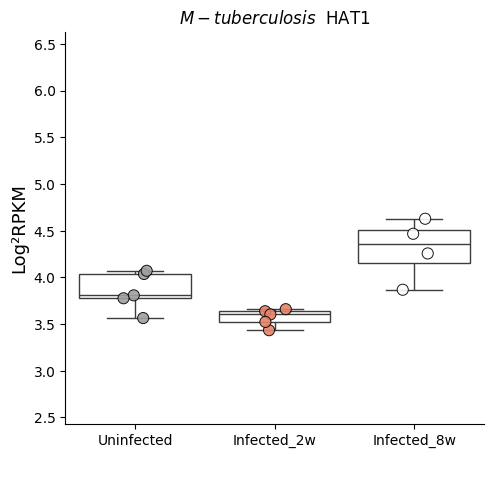

carregando


<Figure size 800x800 with 0 Axes>

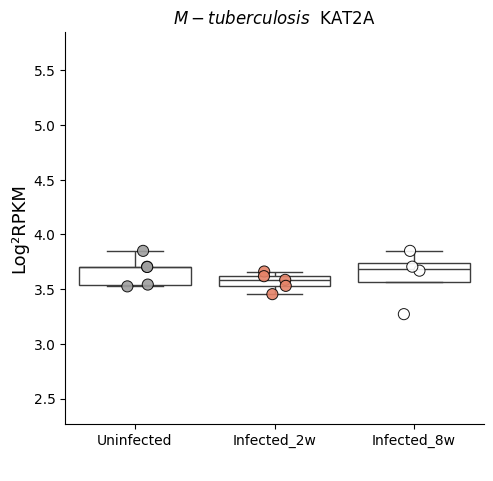

carregando


<Figure size 800x800 with 0 Axes>

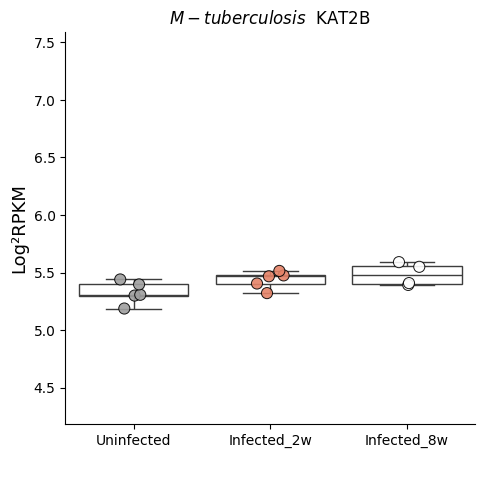

carregando


<Figure size 800x800 with 0 Axes>

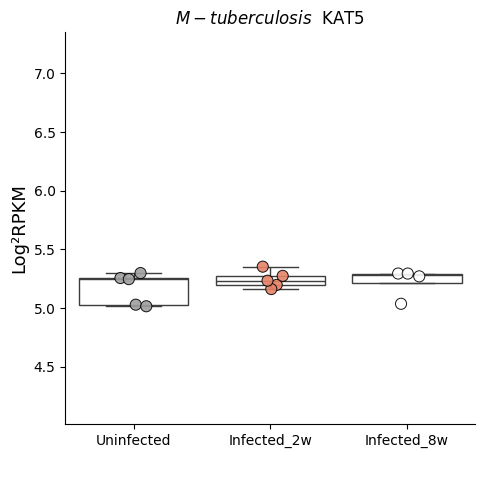

carregando


<Figure size 800x800 with 0 Axes>

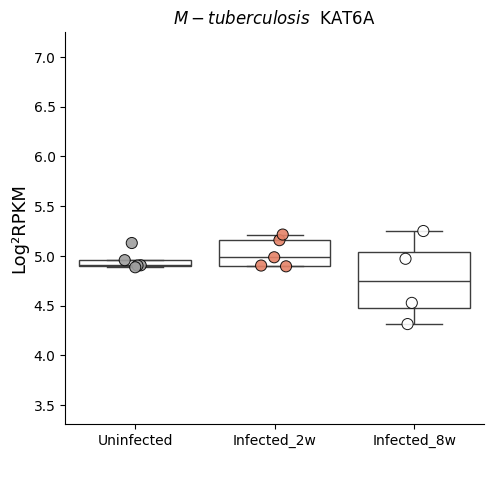

carregando


<Figure size 800x800 with 0 Axes>

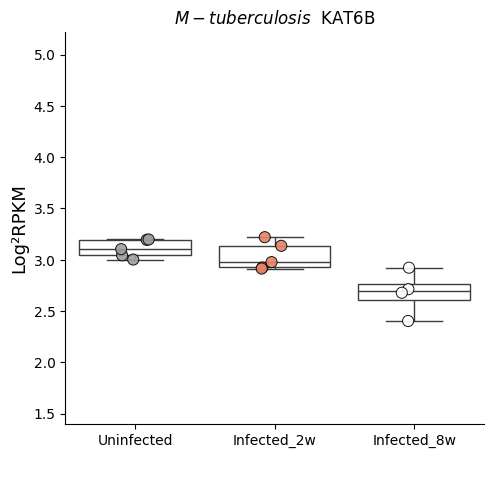

carregando


<Figure size 800x800 with 0 Axes>

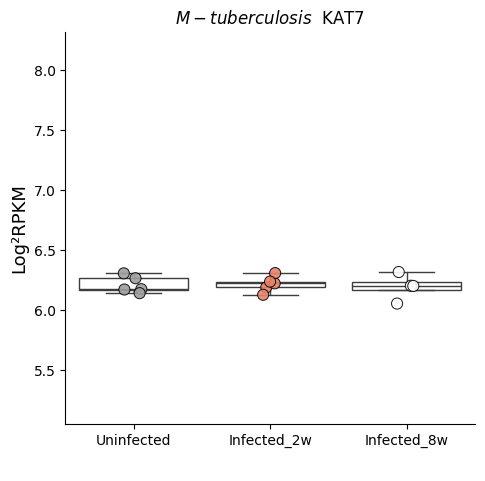

carregando


<Figure size 800x800 with 0 Axes>

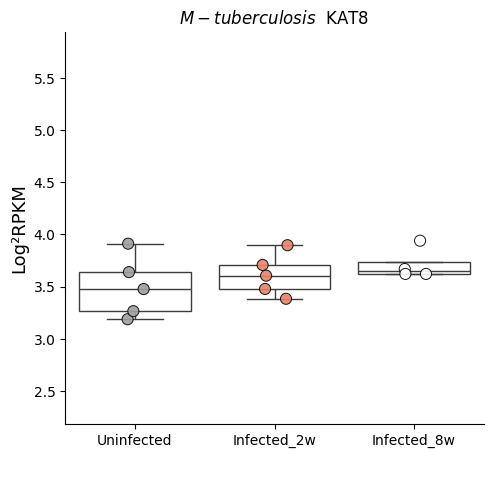

carregando


<Figure size 800x800 with 0 Axes>

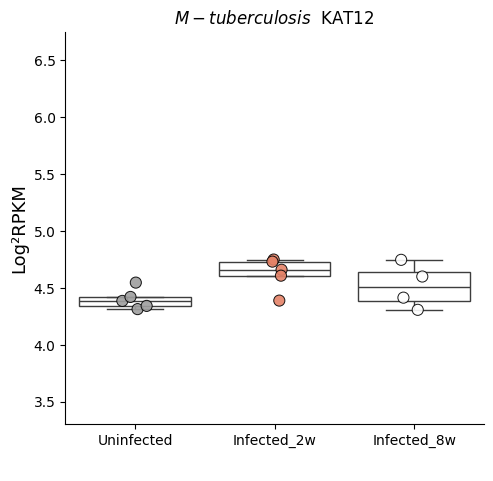

carregando


<Figure size 800x800 with 0 Axes>

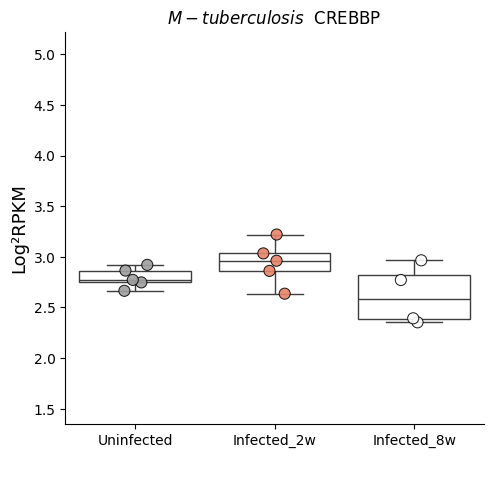

carregando


<Figure size 800x800 with 0 Axes>

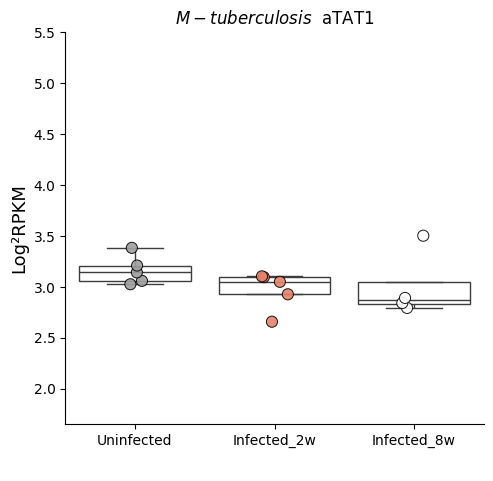

carregando


<Figure size 800x800 with 0 Axes>

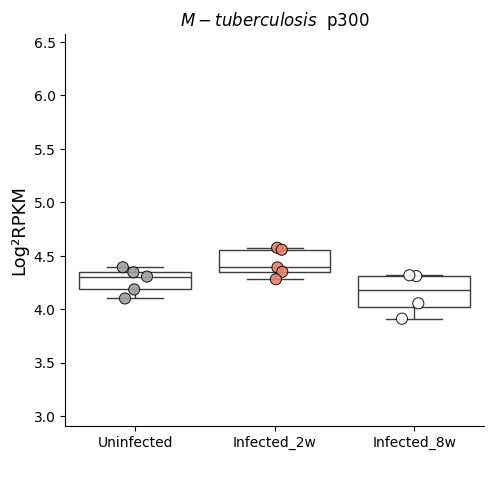

carregando


<Figure size 800x800 with 0 Axes>

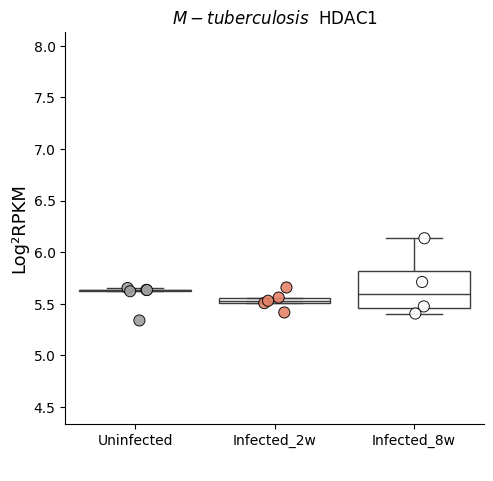

carregando


<Figure size 800x800 with 0 Axes>

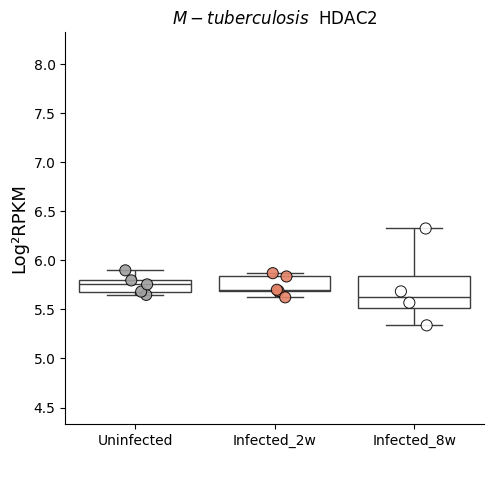

carregando


<Figure size 800x800 with 0 Axes>

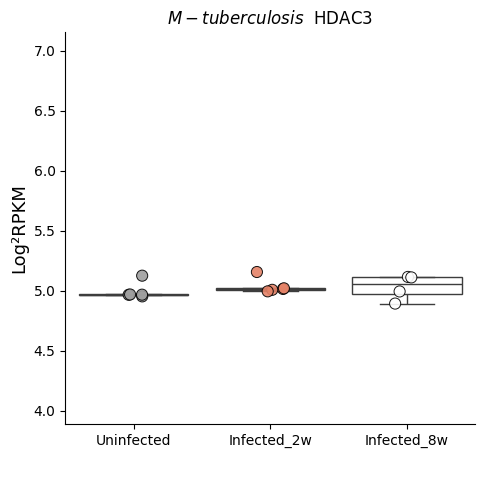

carregando


<Figure size 800x800 with 0 Axes>

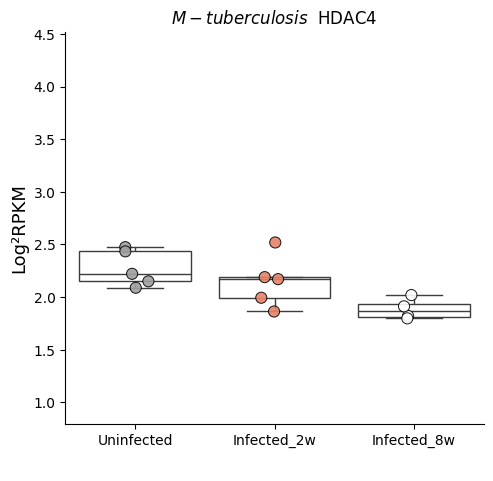

carregando


<Figure size 800x800 with 0 Axes>

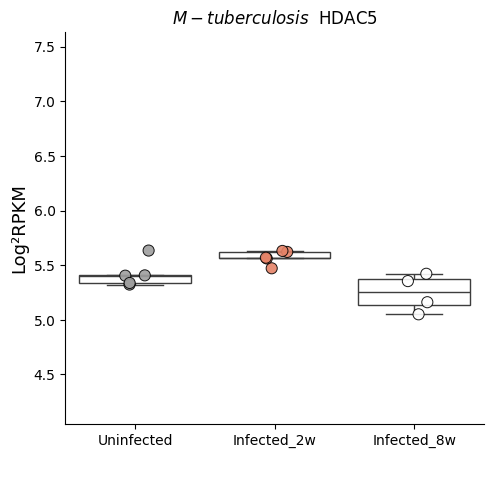

carregando


<Figure size 800x800 with 0 Axes>

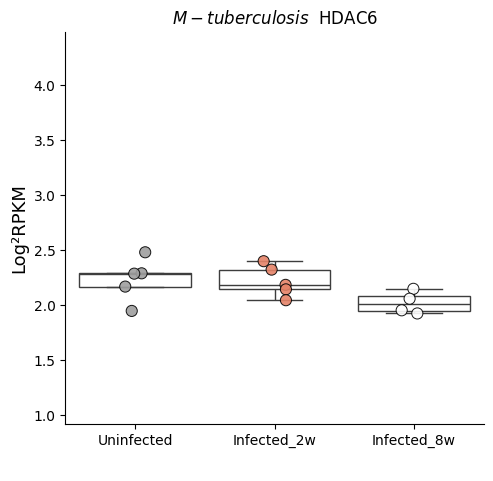

carregando


<Figure size 800x800 with 0 Axes>

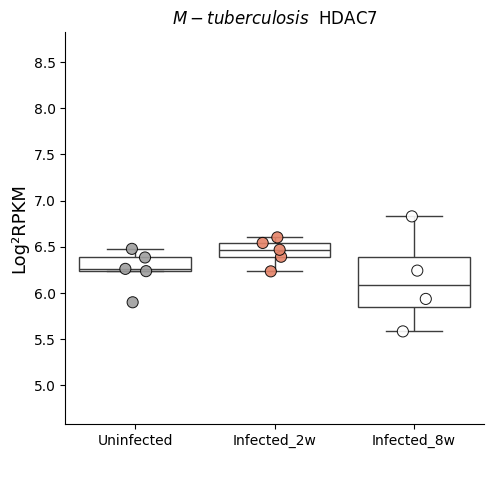

carregando


<Figure size 800x800 with 0 Axes>

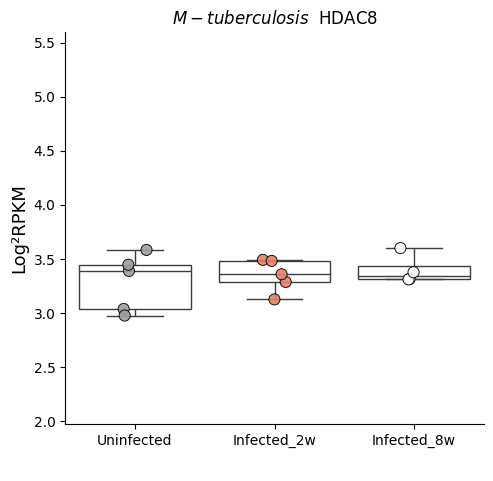

carregando


<Figure size 800x800 with 0 Axes>

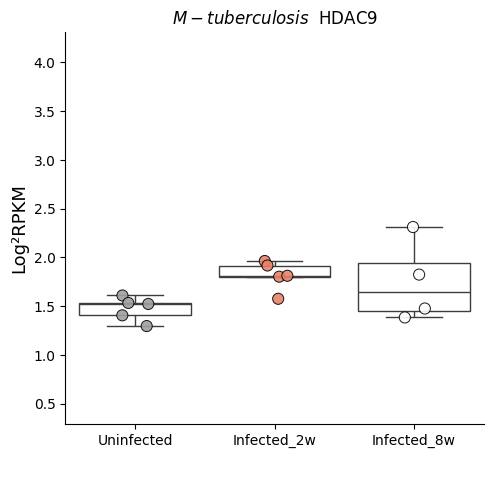

carregando


<Figure size 800x800 with 0 Axes>

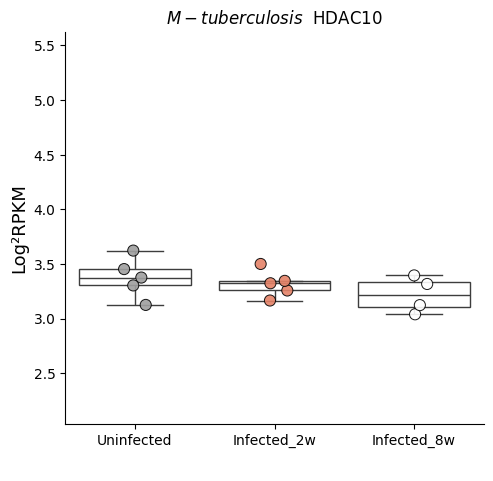

carregando


<Figure size 800x800 with 0 Axes>

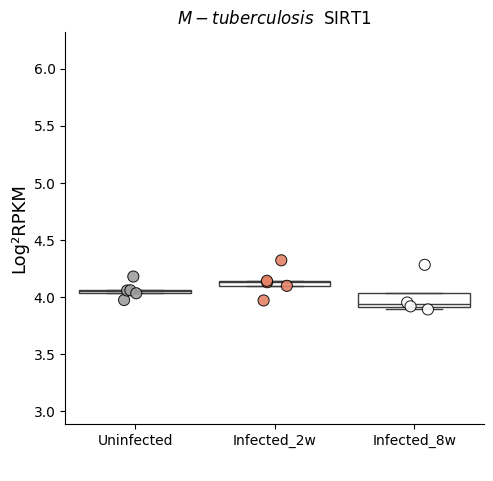

carregando


<Figure size 800x800 with 0 Axes>

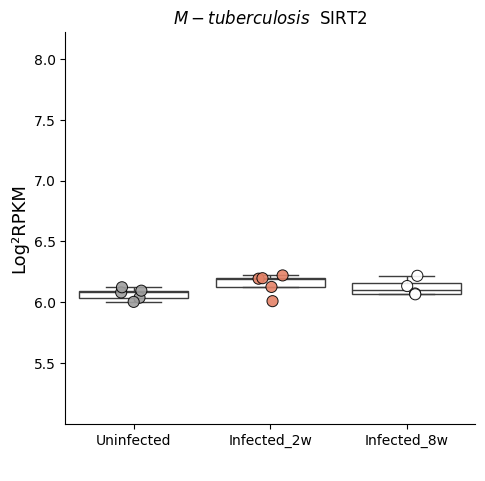

carregando


<Figure size 800x800 with 0 Axes>

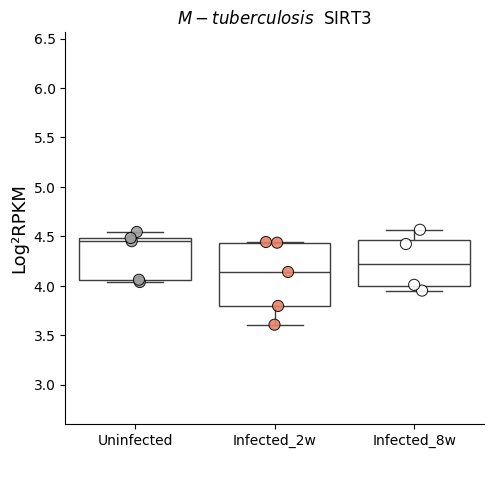

carregando


<Figure size 800x800 with 0 Axes>

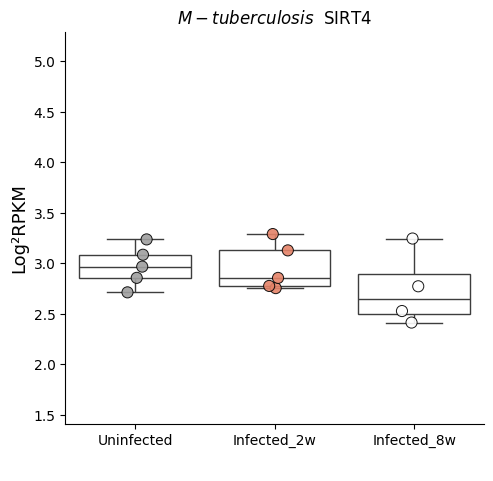

carregando


<Figure size 800x800 with 0 Axes>

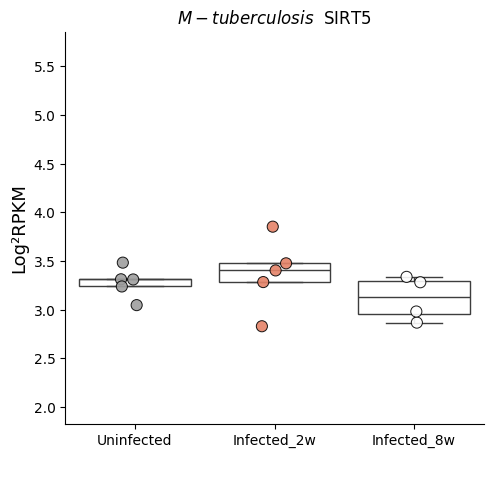

carregando


<Figure size 800x800 with 0 Axes>

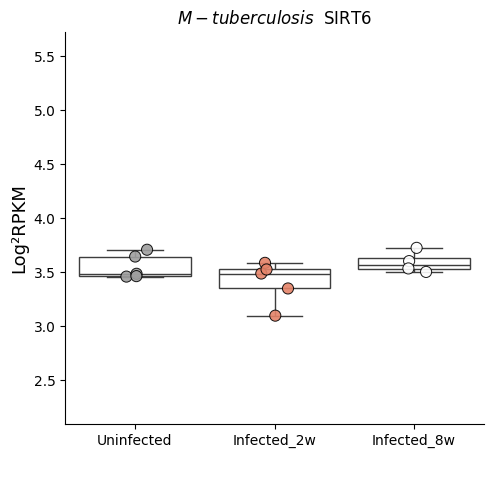

carregando


<Figure size 800x800 with 0 Axes>

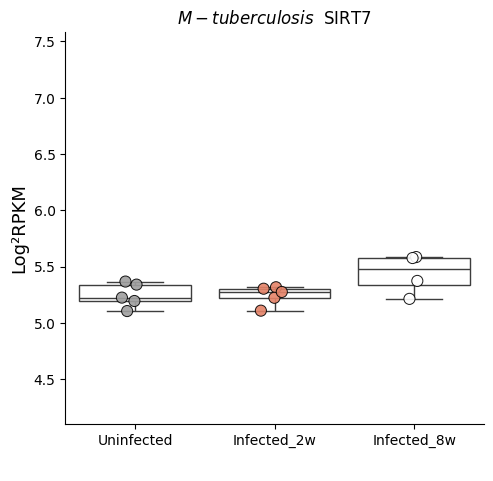

carregando


In [ ]:
graficos_boxplot(df_filtrado, "RdGy", "M-tuberculosis",      ['Uninfected', 'Infected_2w', 'Infected_8w']         , "M-tuberculosis")


##SRP185421 ✅


In [ ]:
id_gene_pasta="SRP185421"
SRP185421_tab = pd.read_excel(SRP185421 )
SRP185421_tab.head()

,Nome,Mo_Alveolar_Infected_1_SRR8556403,Mo_Alveolar_Infected_2_SRR8556404,Mo_Alveolar_Infected_3_SRR8556405,Mo_Alveolar_Infected_4_SRR8556406,Mo_Alveolar_Infected_5_SRR8556407,Mo_Alveolar_Infected_6_SRR8556408,Mo_Alveolar_Uninfected_1_SRR8556397,Mo_Alveolar_Uninfected_2_SRR8556398,Mo_Alveolar_Uninfected_3_SRR8556399,Mo_Alveolar_Uninfected_4_SRR8556400,Mo_Alveolar_Uninfected_5_SRR8556401,Mo_Alveolar_Uninfected_6_SRR8556402
0,YTHDF 1,3.261130,5.111286,5.104322,5.056472,5.118850,5.036741,5.132645,5.103061,4.984566,5.235855,5.270335,5.209164
1,YTHDF 2,5.687368,6.211556,5.864810,6.084114,6.134215,5.840756,5.684027,5.720547,5.534799,5.835042,5.733752,5.701218
2,YTHDF 3,4.355895,6.005562,5.688067,5.873554,5.929676,6.127916,5.665462,5.690040,5.818186,5.543708,5.801842,5.763488
3,YTHDC 1,2.547028,4.376343,4.280942,4.523190,4.650608,4.600771,4.007301,4.185478,4.063113,4.494943,4.284437,4.260886
4,FTO,5.460901,6.128543,5.798674,5.903565,5.695657,5.672839,5.410704,5.394094,5.874755,5.623551,6.056509,6.119527


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
SRP185421_df_filtrado = SRP185421_tab[SRP185421_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
SRP185421_df_filtrado.index = SRP185421_df_filtrado["Nome"]

SRP185421_df_filtrado = SRP185421_df_filtrado.T
df_filtrado = SRP185421_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
Mo_Alveolar_Infected_1_SRR8556403,6.042015,2.958925,0.995703,6.61349,-0.442276,-1.17663,4.825846,3.912961,1.775456,0.054597,...,3.269185,-1.193902,0.023228,-0.315075,7.678887,5.843186,3.456961,3.522582,1.833519,7.260615
Mo_Alveolar_Infected_2_SRR8556404,5.570299,4.485743,1.136887,5.397437,1.408374,0.252679,6.866865,3.664311,3.443078,1.484671,...,2.538337,1.990204,1.115793,3.154771,6.965179,4.637341,2.791113,3.380765,2.197308,6.911637
Mo_Alveolar_Infected_3_SRR8556405,5.704972,4.039856,0.858485,5.257084,0.472288,-0.191677,6.740639,3.75261,3.770896,0.877925,...,2.800958,1.934158,1.254963,3.390049,7.015621,4.026516,2.531182,3.702977,1.970476,6.775985
Mo_Alveolar_Infected_4_SRR8556406,5.788226,4.239809,1.658749,5.388993,0.887292,0.510116,6.575636,3.591037,3.107583,1.343578,...,2.75724,1.934588,1.226239,3.025195,6.96137,4.647248,2.890107,3.511826,1.951757,6.888042
Mo_Alveolar_Infected_5_SRR8556407,5.812197,4.064553,1.140745,5.196758,0.513668,-0.394812,6.676543,3.735333,2.905753,0.992968,...,2.471819,1.632486,0.881875,3.329803,7.0762,4.532508,2.812108,3.3011,1.717597,6.836354


In [ ]:
df_filtrado.index.to_list()

['Mo_Alveolar_Infected_1_SRR8556403',
 'Mo_Alveolar_Infected_2_SRR8556404',
 'Mo_Alveolar_Infected_3_SRR8556405',
 'Mo_Alveolar_Infected_4_SRR8556406',
 'Mo_Alveolar_Infected_5_SRR8556407',
 'Mo_Alveolar_Infected_6_SRR8556408',
 'Mo_Alveolar_Uninfected_1_SRR8556397',
 'Mo_Alveolar_Uninfected_2_SRR8556398',
 'Mo_Alveolar_Uninfected_3_SRR8556399',
 'Mo_Alveolar_Uninfected_4_SRR8556400',
 'Mo_Alveolar_Uninfected_5_SRR8556401',
 'Mo_Alveolar_Uninfected_6_SRR8556402']

In [ ]:
df_filtrado["Status"] =   ['Infected',
'Infected',
'Infected',
'Infected',
'Infected',
'Infected',
'Uninfected',
'Uninfected',
'Uninfected',
'Uninfected',
'Uninfected',
'Uninfected']

<ipython-input-94-ca1bbd8b0be4>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =   ['Infected',


In [ ]:
list(set(df_filtrado["Status"]))


['Infected', 'Uninfected']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'Infected']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Uninfected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.218319,-0.347304,-0.381356,0.204493,-0.490736,-1.024971,0.029138,-0.086488,-0.330097,-0.884196,...,0.135225,0.642311,-0.904176,0.04516,0.129677,-0.20545,0.100232,0.755075,-0.66012,-0.103268


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="M-tuberculosis_SRP185421"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/SRP185421/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Down,Normal,Normal,Normal,Down,...,Normal,UP,Down,Normal,Normal,Normal,Normal,UP,Down,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.8,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Down,Normal,Normal,Normal,Down,...,Normal,UP,Down,Normal,Normal,Normal,Normal,UP,Down,Normal


<Figure size 800x800 with 0 Axes>

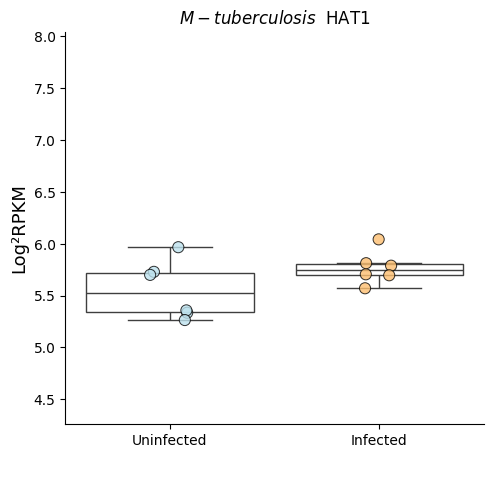

carregando


<Figure size 800x800 with 0 Axes>

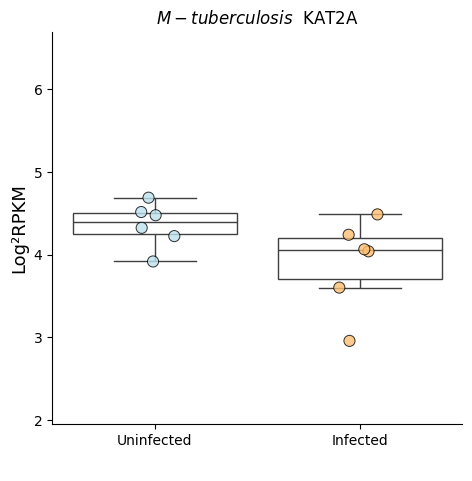

carregando


<Figure size 800x800 with 0 Axes>

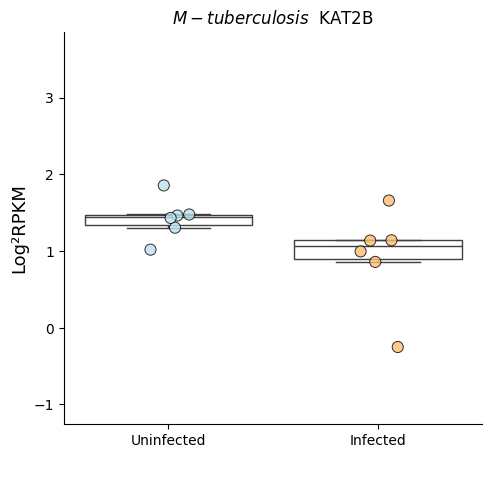

carregando


<Figure size 800x800 with 0 Axes>

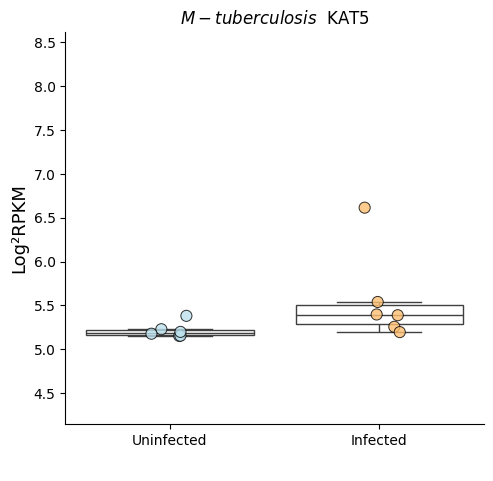

carregando


<Figure size 800x800 with 0 Axes>

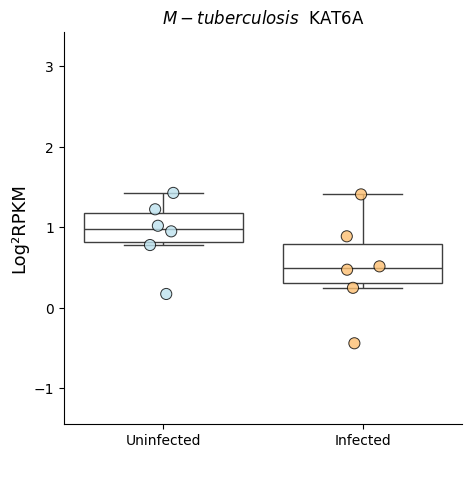

carregando


<Figure size 800x800 with 0 Axes>

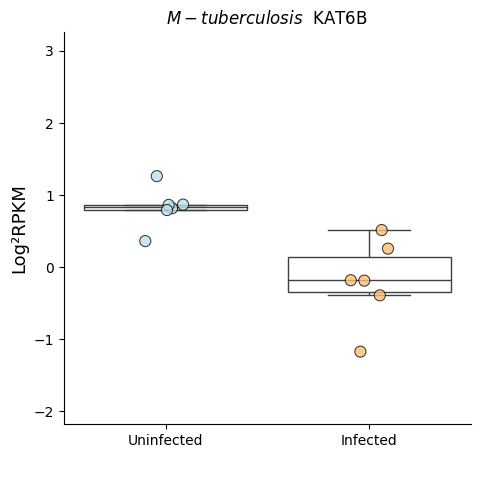

carregando


<Figure size 800x800 with 0 Axes>

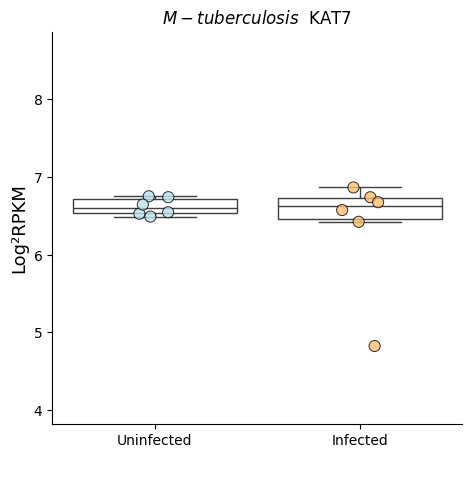

carregando


<Figure size 800x800 with 0 Axes>

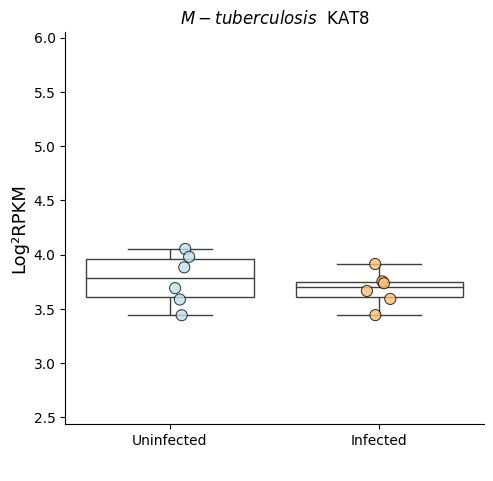

carregando


<Figure size 800x800 with 0 Axes>

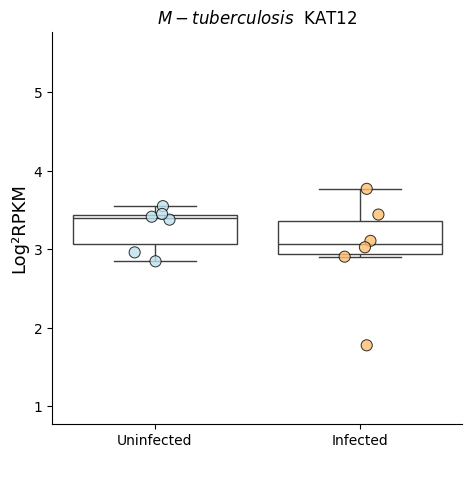

carregando


<Figure size 800x800 with 0 Axes>

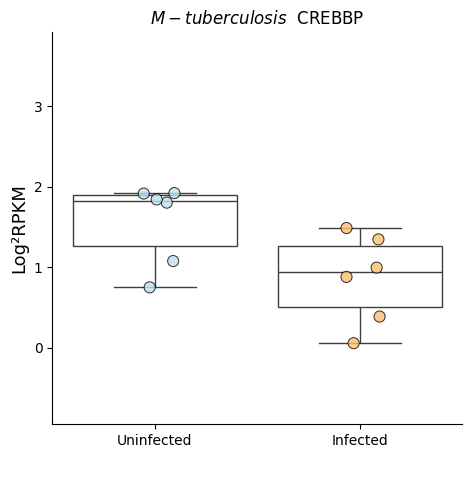

carregando


<Figure size 800x800 with 0 Axes>

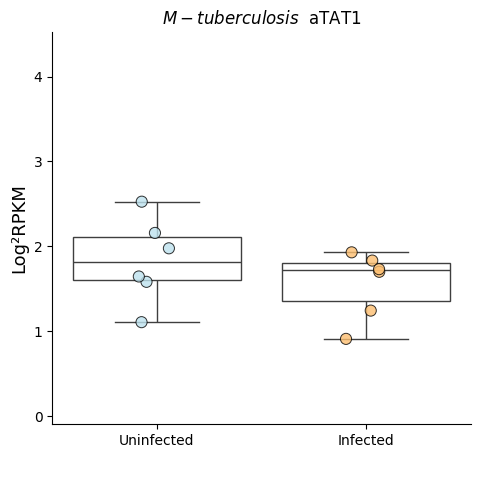

carregando


<Figure size 800x800 with 0 Axes>

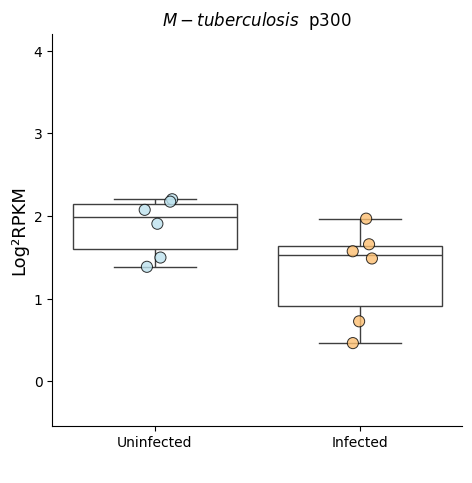

carregando


<Figure size 800x800 with 0 Axes>

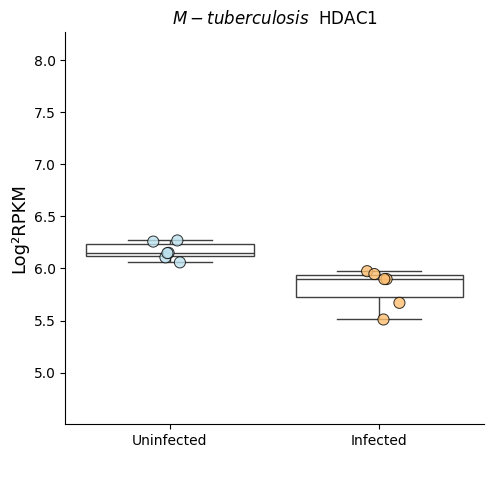

carregando


<Figure size 800x800 with 0 Axes>

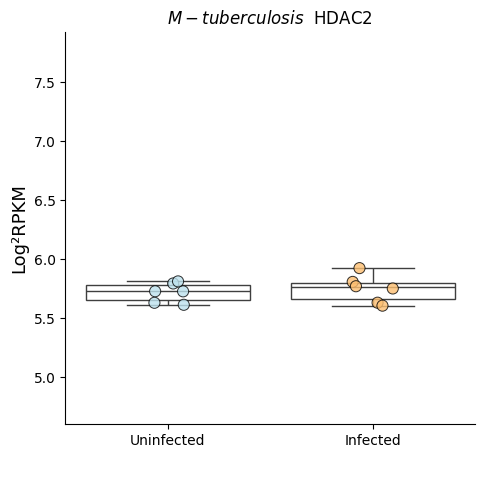

carregando


<Figure size 800x800 with 0 Axes>

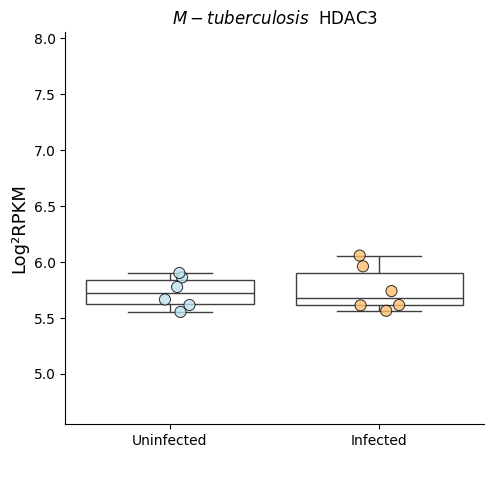

carregando


<Figure size 800x800 with 0 Axes>

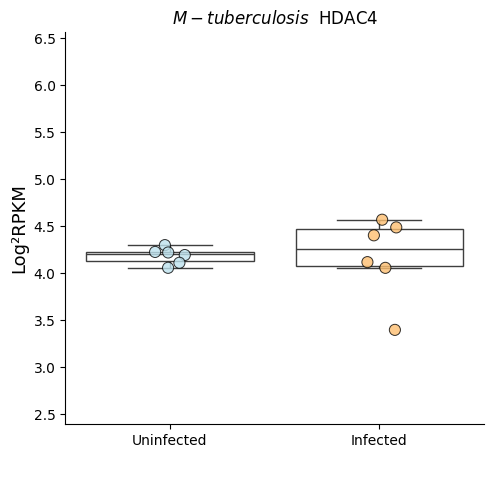

carregando


<Figure size 800x800 with 0 Axes>

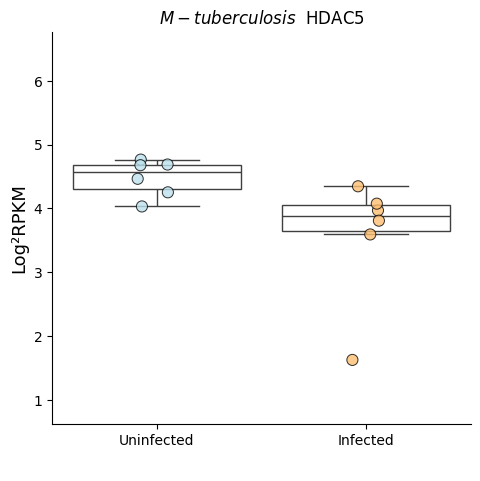

carregando


<Figure size 800x800 with 0 Axes>

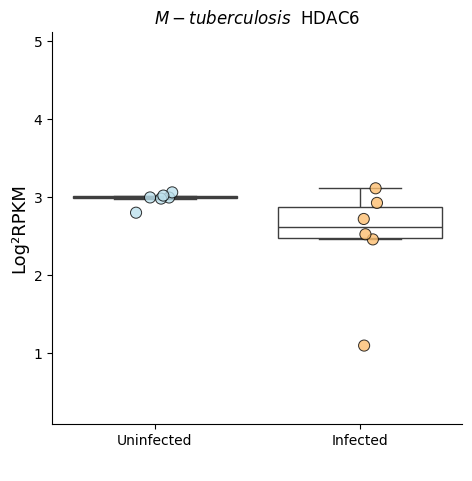

carregando


<Figure size 800x800 with 0 Axes>

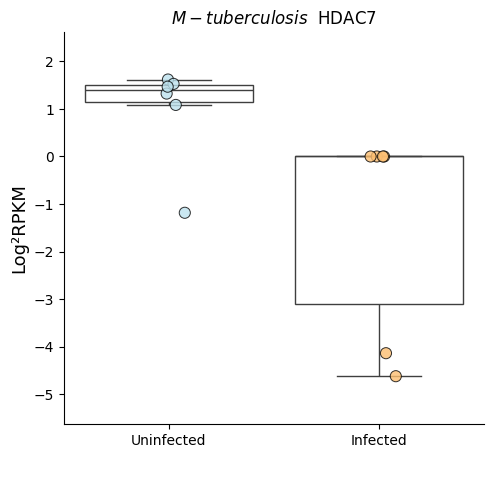

carregando


<Figure size 800x800 with 0 Axes>

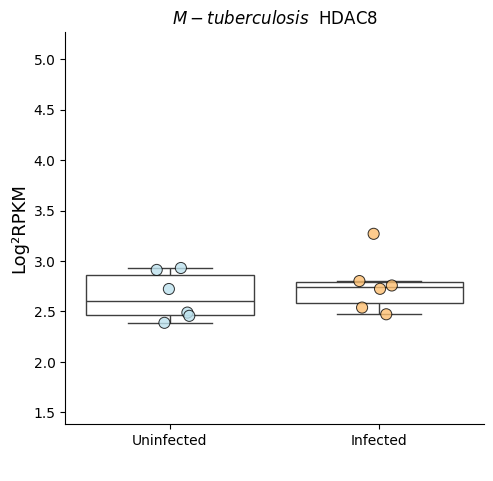

carregando


<Figure size 800x800 with 0 Axes>

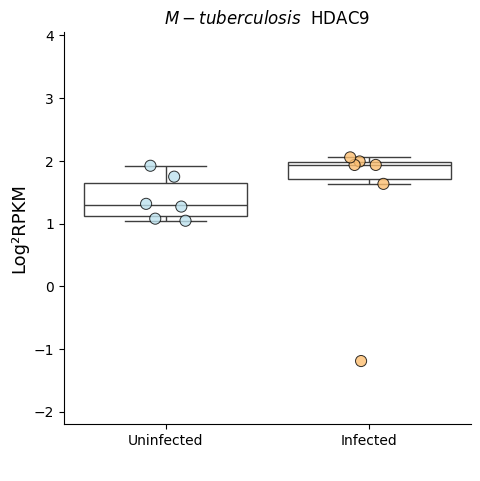

carregando


<Figure size 800x800 with 0 Axes>

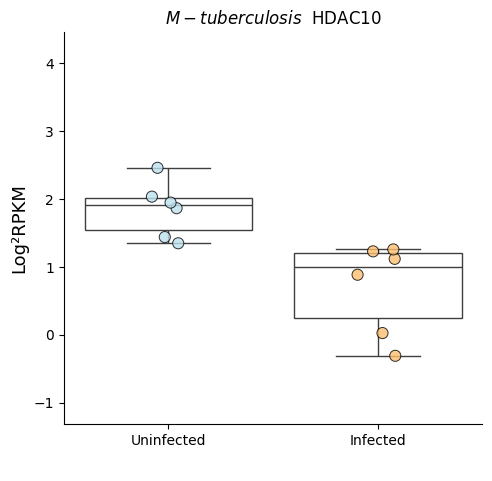

carregando


<Figure size 800x800 with 0 Axes>

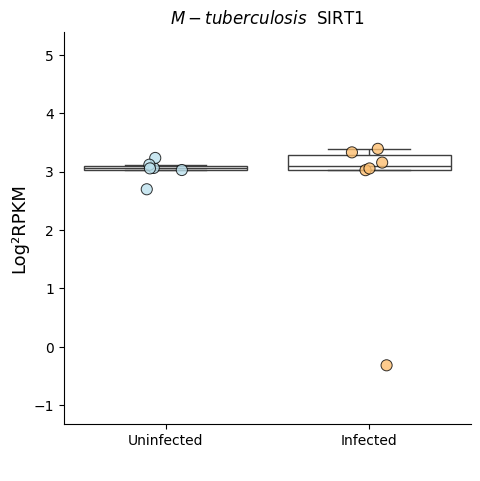

carregando


<Figure size 800x800 with 0 Axes>

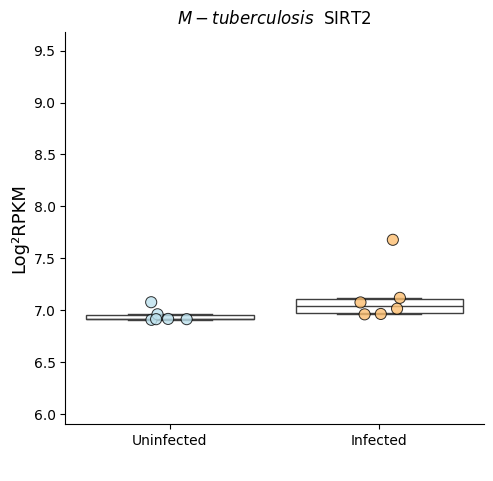

carregando


<Figure size 800x800 with 0 Axes>

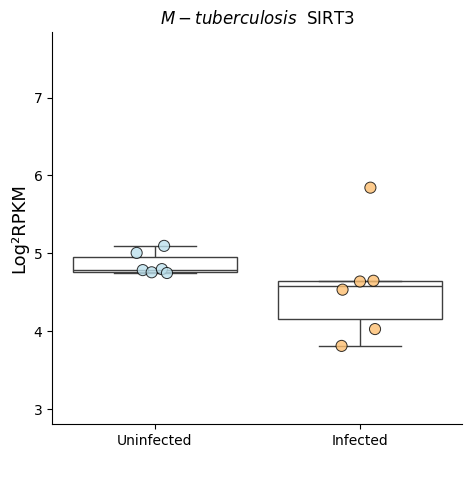

carregando


<Figure size 800x800 with 0 Axes>

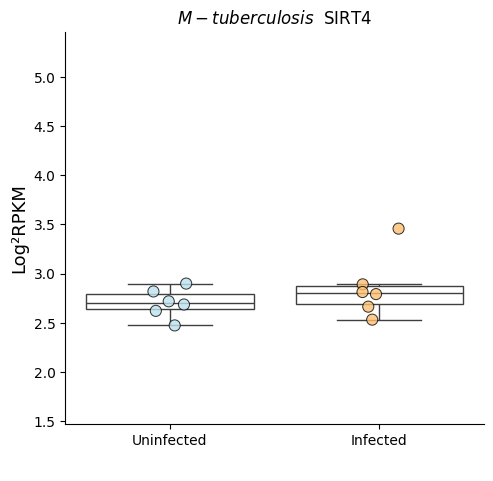

carregando


<Figure size 800x800 with 0 Axes>

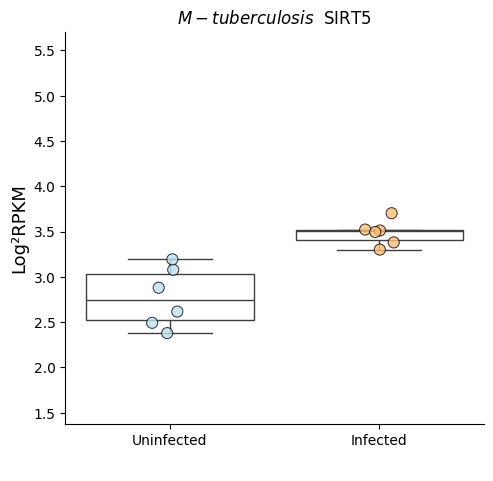

carregando


<Figure size 800x800 with 0 Axes>

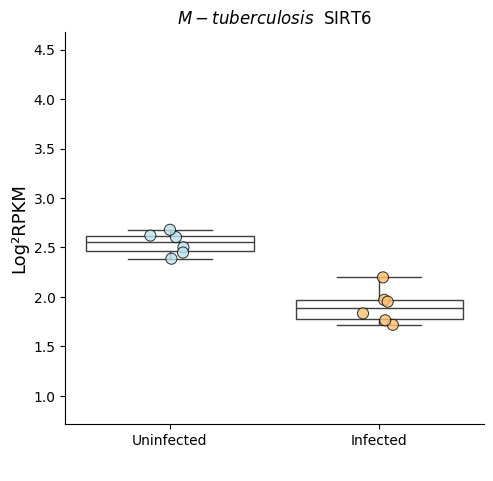

carregando


<Figure size 800x800 with 0 Axes>

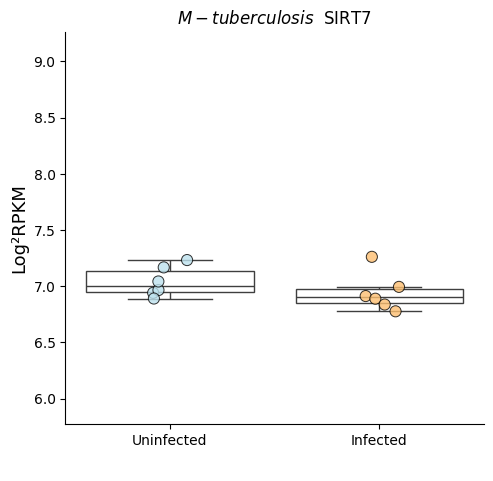

carregando


In [ ]:
graficos_boxplot(df_filtrado, "RdYlBu", "M-tuberculosis",      ["Uninfected",'Infected']         , "M-tuberculosis")


#SARS-CoV-2

## GSE163668 ✅


In [ ]:
id_gene_pasta="GSE163668"
GSE163668_tab = pd.read_excel(GSE163668 )
GSE163668_tab.head()

,Nome,control_SRR13329156,control_SRR13329157,phenotype_mild_moderate_SRR13329120,phenotype_mild_moderate_SRR13329121,phenotype_mild_moderate_SRR13329122,phenotype_mild_moderate_SRR13329123,phenotype_mild_moderate_SRR13329124,phenotype_mild_moderate_SRR13329125,phenotype_mild_moderate_SRR13329126,phenotype_mild_moderate_SRR13329127,phenotype_mild_moderate_SRR13329128,phenotype_mild_moderate_SRR13329129,phenotype_mild_moderate_SRR13329130,phenotype_mild_moderate_SRR13329131,phenotype_severe_SRR13329132,phenotype_severe_SRR13329133,phenotype_severe_SRR13329134,phenotype_severe_SRR13329135
0,YTHDF 1,2.756373,2.576449,3.256621,3.298615,2.339697,2.324025,1.968465,1.928589,2.712157,2.701198,2.035015,1.765685,2.028486,1.995330,2.234471,2.172828,2.197824,2.125136
1,YTHDF 2,5.124006,5.196905,5.155612,5.154483,5.421139,5.449589,4.434466,4.438450,5.292713,5.264256,5.382916,5.357308,5.282779,5.268858,4.678870,4.654941,4.809305,4.788346
2,YTHDF 3,3.468132,3.568144,4.859587,4.873262,3.246064,3.248671,4.648677,4.623964,3.863495,3.902791,3.749922,3.694795,3.651444,3.635855,3.460953,3.373444,3.406212,3.477565
3,YTHDC 1,-4.628886,-3.494916,-2.259098,-2.395883,-3.533953,-3.451091,-4.436636,-5.080400,-1.908975,-4.521010,-5.480487,-1.251286,-3.812187,-3.940559,-2.119973,-3.115400,-3.911327,-6.227790
4,FTO,3.541213,3.524650,3.810645,3.861306,3.189766,3.216328,1.362960,1.373318,3.217468,3.217416,3.699844,3.713581,3.489595,3.570860,2.685871,2.811786,3.111725,3.006095


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE163668_df_filtrado = GSE163668_tab[GSE163668_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE163668_df_filtrado.index = GSE163668_df_filtrado["Nome"]

GSE163668_df_filtrado = GSE163668_df_filtrado.T
df_filtrado = GSE163668_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
control_SRR13329156,4.564689,2.811959,2.56044,3.99199,3.33872,2.949762,4.313613,5.368819,0.419127,2.625034,...,3.953291,1.588983,3.834299,1.731185,5.443506,4.091789,4.129678,3.894595,4.300416,4.976957
control_SRR13329157,4.559446,2.862231,2.630994,3.953905,3.292282,2.908112,4.301684,5.323505,0.569138,2.651052,...,3.853842,1.441337,3.90014,1.804214,5.419823,4.099416,4.162632,3.855759,4.268773,4.961271
phenotype_mild_moderate_SRR13329120,4.600022,1.837926,3.761136,3.703815,4.301344,3.262327,4.960288,5.379482,0.682764,4.270383,...,4.385557,2.970764,4.064956,2.204814,5.12178,4.39722,1.214694,3.839034,4.482068,5.42771
phenotype_mild_moderate_SRR13329121,4.548526,1.834247,3.69742,3.684282,4.295261,3.258412,4.976589,5.340509,0.758939,4.264246,...,4.397048,2.94516,4.073228,2.304451,5.141106,4.42766,0.949308,3.798031,4.557489,5.434657
phenotype_mild_moderate_SRR13329122,4.682847,3.111097,2.463013,3.813421,3.046746,2.26573,3.939837,5.206388,-0.851651,2.454461,...,3.795525,1.727677,4.37289,0.709501,5.159093,3.00531,2.087936,4.088468,4.822808,5.052907


In [ ]:
df_filtrado.index.to_list()

['control_SRR13329156',
 'control_SRR13329157',
 'phenotype_mild_moderate_SRR13329120',
 'phenotype_mild_moderate_SRR13329121',
 'phenotype_mild_moderate_SRR13329122',
 'phenotype_mild_moderate_SRR13329123',
 'phenotype_mild_moderate_SRR13329124',
 'phenotype_mild_moderate_SRR13329125',
 'phenotype_mild_moderate_SRR13329126',
 'phenotype_mild_moderate_SRR13329127',
 'phenotype_mild_moderate_SRR13329128',
 'phenotype_mild_moderate_SRR13329129',
 'phenotype_mild_moderate_SRR13329130',
 'phenotype_mild_moderate_SRR13329131',
 'phenotype_severe_SRR13329132',
 'phenotype_severe_SRR13329133',
 'phenotype_severe_SRR13329134',
 'phenotype_severe_SRR13329135']

In [ ]:
df_filtrado["Status"] =   ['control',
'control',
'mild_moderate',
'mild_moderate',
'mild_moderate',
'mild_moderate',
'mild_moderate',
'mild_moderate',
'mild_moderate',
'mild_moderate',
'mild_moderate',
'mild_moderate',
'mild_moderate',
'mild_moderate',
'severe',
'severe',
'severe',
'severe']

<ipython-input-7-37c49ba46897>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =   ['control',


In [ ]:
ordem = ['control', 'mild_moderate', 'severe']
list(set(df_filtrado["Status"]))

['mild_moderate', 'severe', 'control']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'severe']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'control']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.103978,-0.666703,-0.167893,-0.864838,-0.169748,-1.156269,-0.489171,-0.181005,-0.652888,0.302206,...,-0.233511,-0.103152,0.05618,-0.623042,-0.420553,-1.037948,-2.951761,-0.926597,0.160908,0.28146


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="SARS-CoV-2_GSE163668"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE163668/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Down,Normal,Down,Normal,Down,Normal,Normal,Down,Normal,...,Normal,Normal,Normal,Down,Normal,Down,Down,Down,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.8,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Down,Normal,Down,Normal,Down,Normal,Normal,Down,Normal,...,Normal,Normal,Normal,Down,Normal,Down,Down,Down,Normal,Normal


<Figure size 800x800 with 0 Axes>

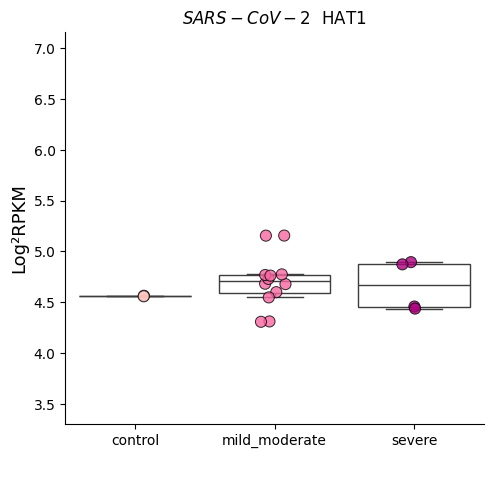

carregando


<Figure size 800x800 with 0 Axes>

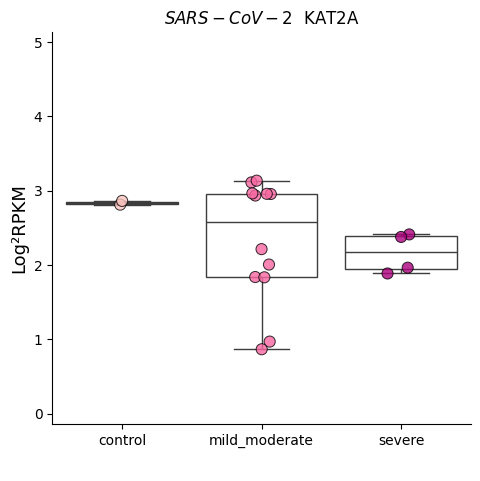

carregando


<Figure size 800x800 with 0 Axes>

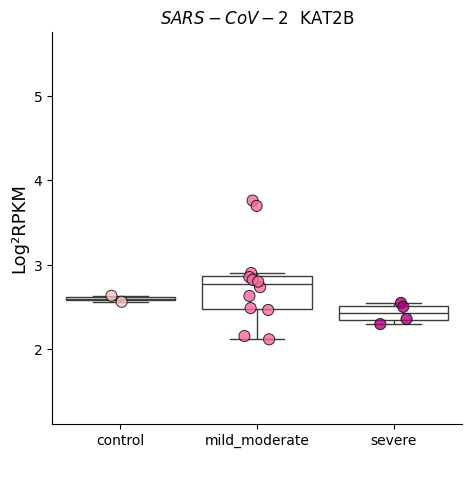

carregando


<Figure size 800x800 with 0 Axes>

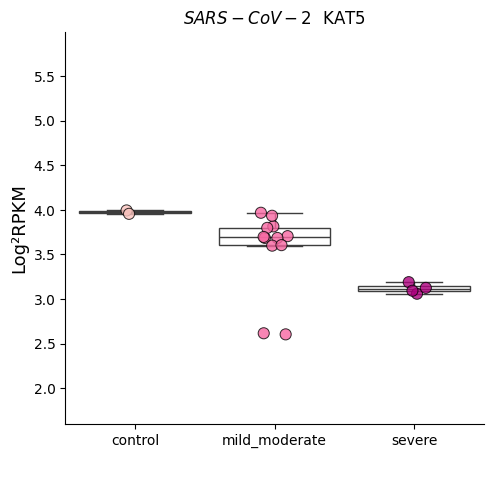

carregando


<Figure size 800x800 with 0 Axes>

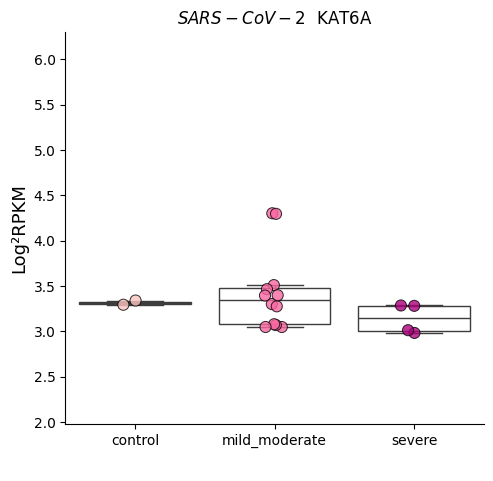

carregando


<Figure size 800x800 with 0 Axes>

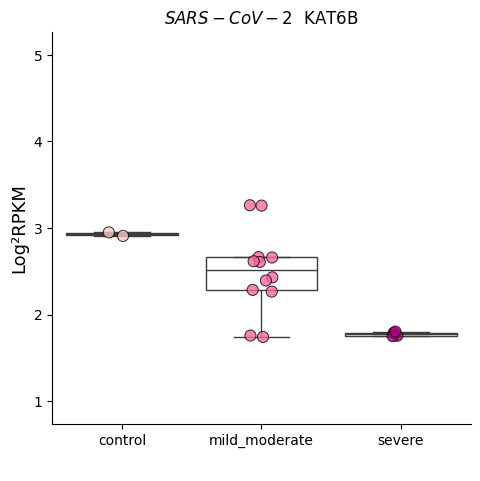

carregando


<Figure size 800x800 with 0 Axes>

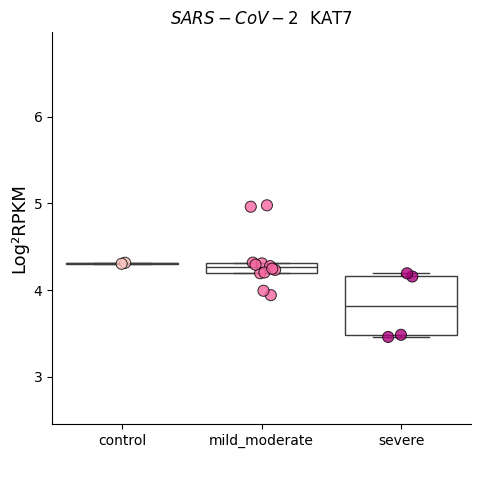

carregando


<Figure size 800x800 with 0 Axes>

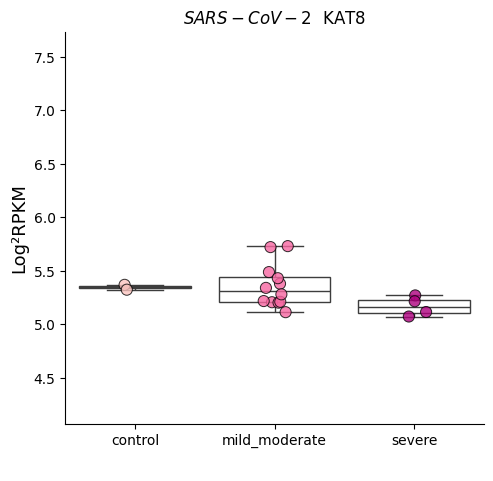

carregando


<Figure size 800x800 with 0 Axes>

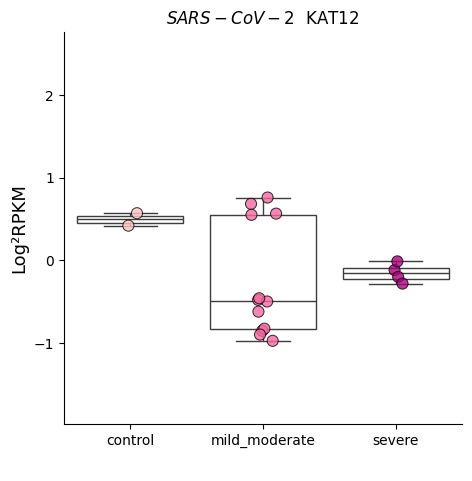

carregando


<Figure size 800x800 with 0 Axes>

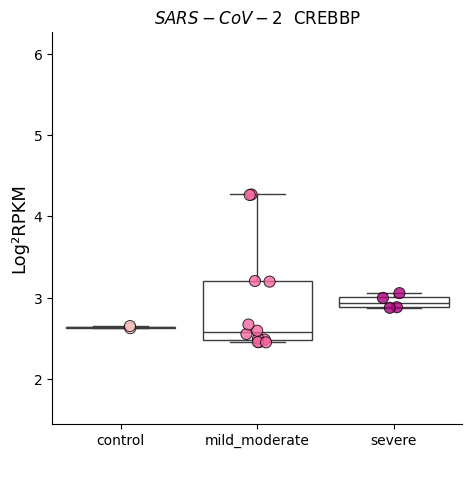

carregando


<Figure size 800x800 with 0 Axes>

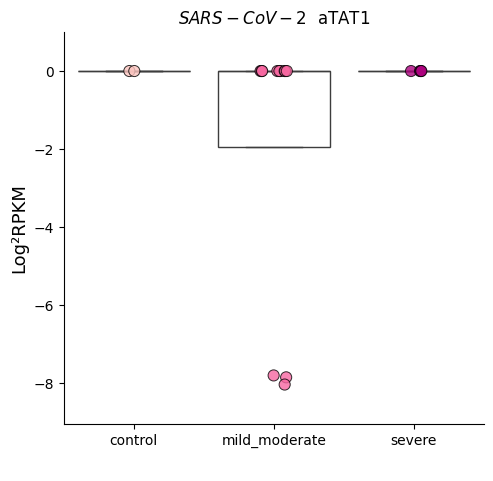

carregando


<Figure size 800x800 with 0 Axes>

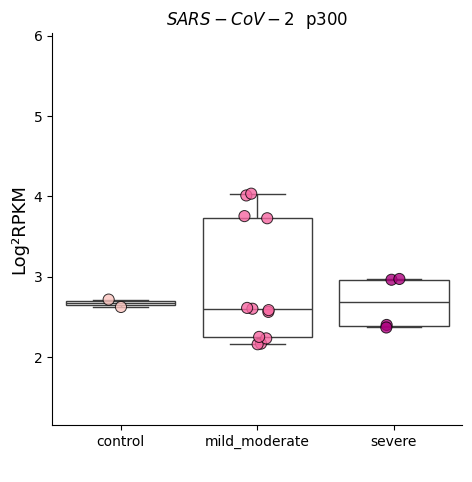

carregando


<Figure size 800x800 with 0 Axes>

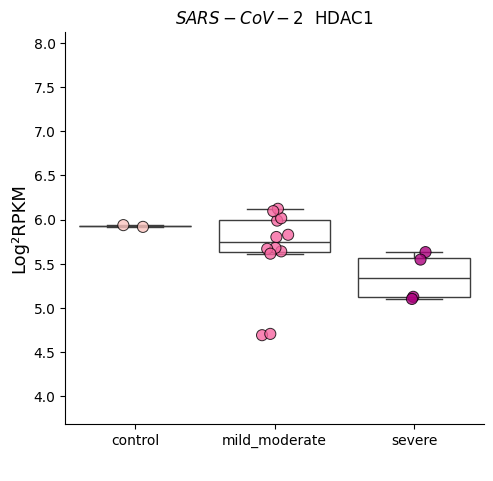

carregando


<Figure size 800x800 with 0 Axes>

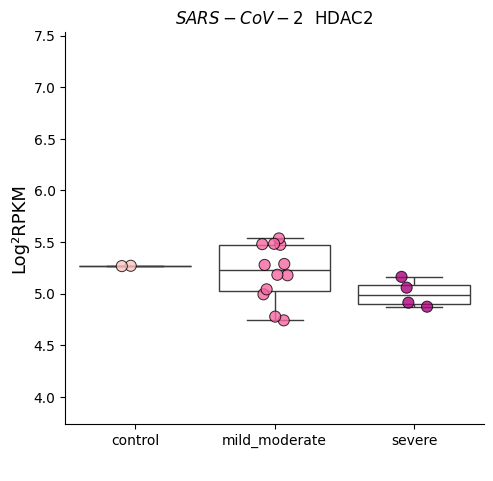

carregando


<Figure size 800x800 with 0 Axes>

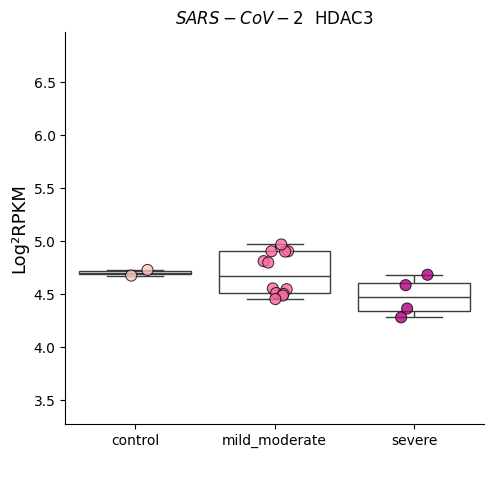

carregando


<Figure size 800x800 with 0 Axes>

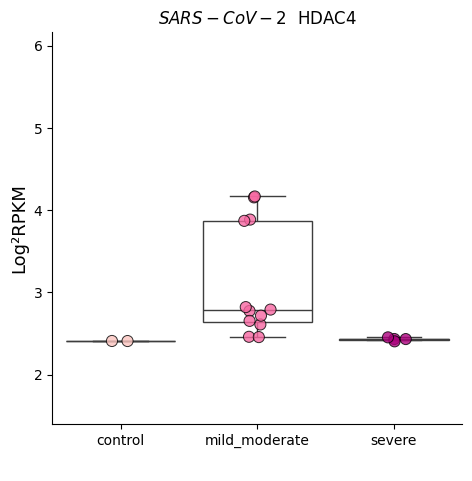

carregando


<Figure size 800x800 with 0 Axes>

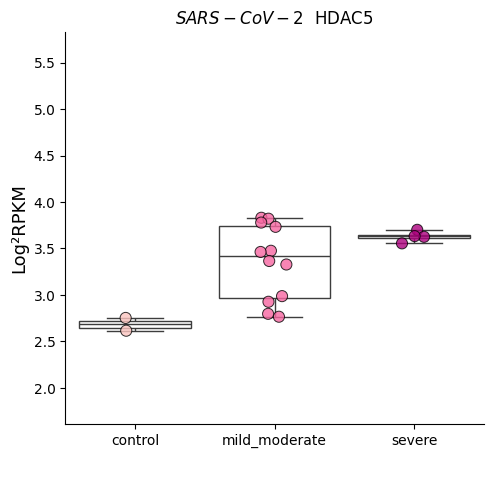

carregando


<Figure size 800x800 with 0 Axes>

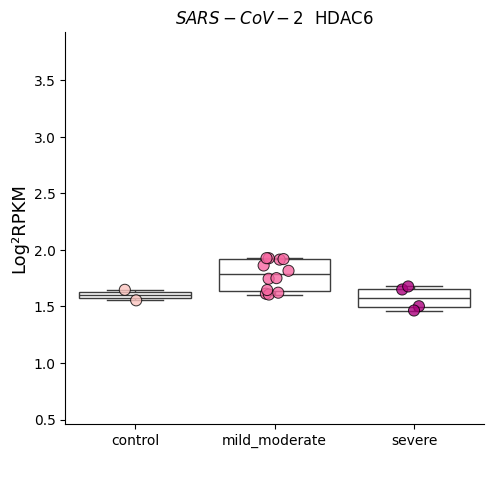

carregando


<Figure size 800x800 with 0 Axes>

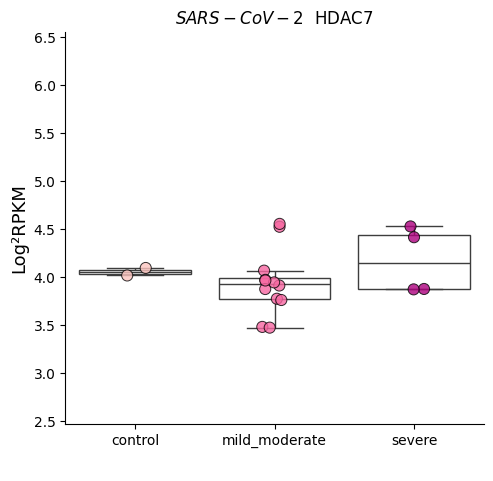

carregando


<Figure size 800x800 with 0 Axes>

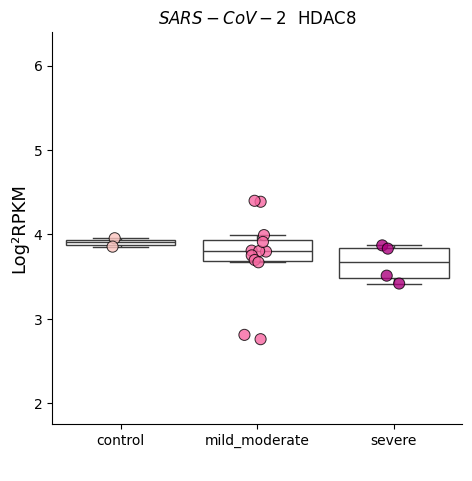

carregando


<Figure size 800x800 with 0 Axes>

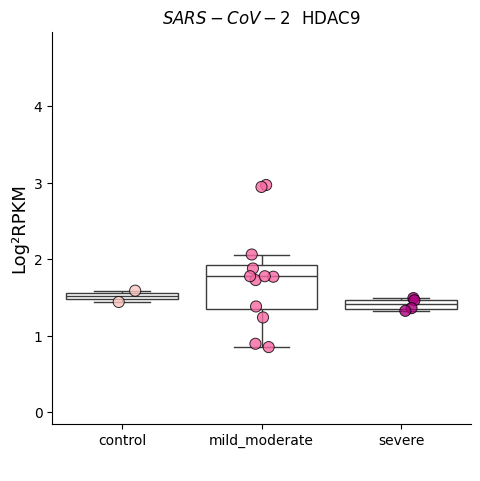

carregando


<Figure size 800x800 with 0 Axes>

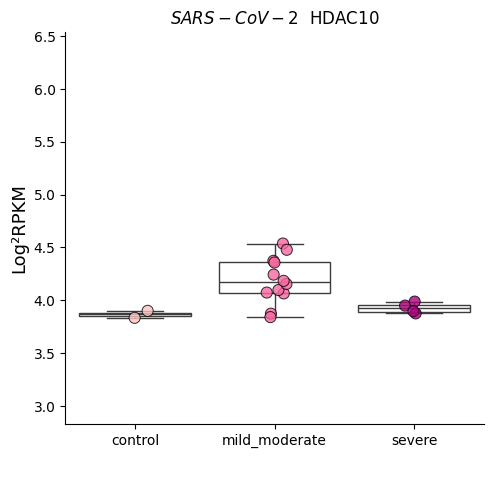

carregando


<Figure size 800x800 with 0 Axes>

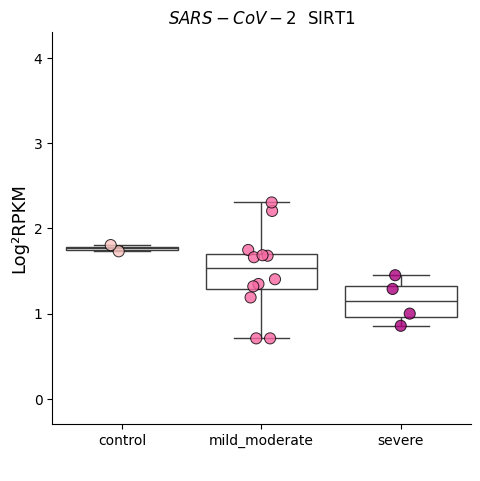

carregando


<Figure size 800x800 with 0 Axes>

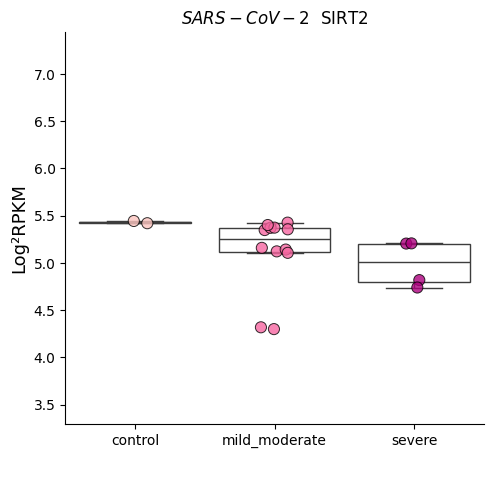

carregando


<Figure size 800x800 with 0 Axes>

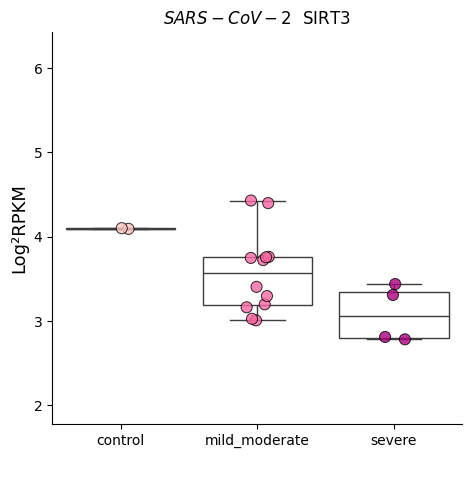

carregando


<Figure size 800x800 with 0 Axes>

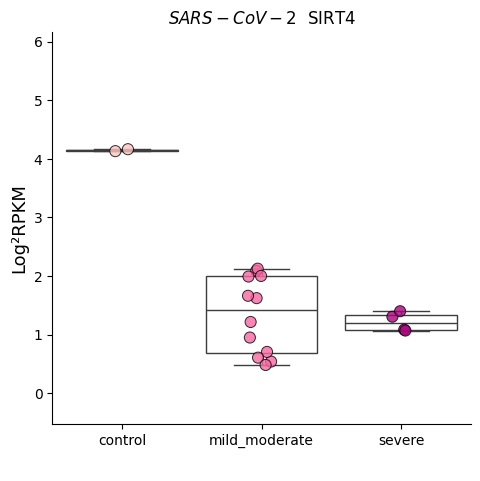

carregando


<Figure size 800x800 with 0 Axes>

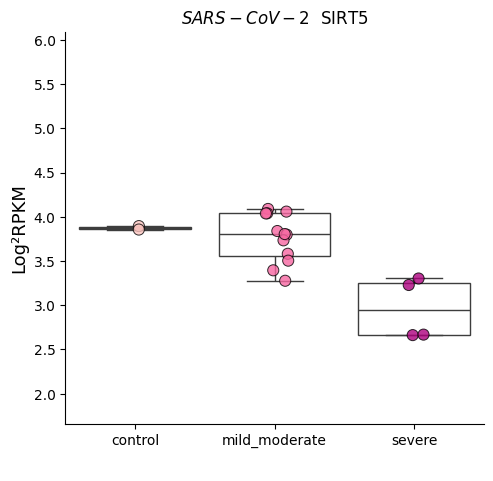

carregando


<Figure size 800x800 with 0 Axes>

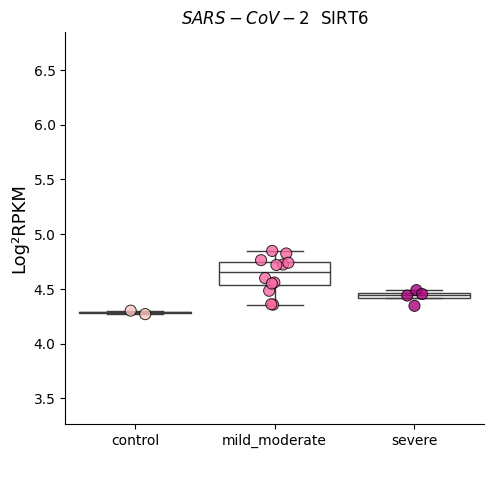

carregando


<Figure size 800x800 with 0 Axes>

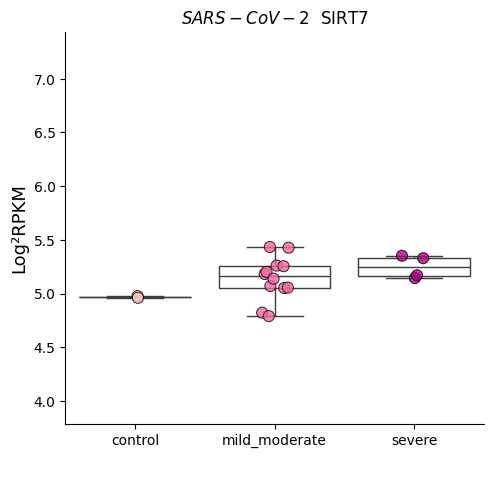

carregando


In [ ]:
graficos_boxplot(df_filtrado, "RdPu", "SARS-CoV-2",      ordem         , "SARS-CoV-2")


##GSE163959 ✅

In [ ]:
id_gene_pasta="GSE163959"
GSE163959_tab = pd.read_excel(GSE163959 )
GSE163959_tab.head()

,Nome,SARS-CoV-2_SRR13319496,SARS-CoV-2_SRR13319497,SARS-CoV-2_SRR13319498,SARS-CoV-2_SRR13319499,SARS-CoV-2_SRR13319500,SARS-CoV-2_SRR13319501,SARS-CoV-2_SRR13319502,SARS-CoV-2_SRR13319503,SARS-CoV-2_SRR13319504,...,Uninfected_Lung_tissue_SRR13319476,Uninfected_SRR13319477,Uninfected_SRR13319478,Uninfected_SRR13319479,Uninfected_SRR13319480,Uninfected_SRR13319481,Uninfected_SRR13319482,Uninfected_SRR13319483,Uninfected_SRR13319484,Uninfected_SRR13319485
0,YTHDF 1,5.672972,5.681183,5.304720,5.280239,5.535383,5.648902,5.196024,5.246819,5.451613,...,5.460799,5.532399,5.273665,5.353547,5.293329,5.233473,5.280802,5.183101,5.513952,5.472752
1,YTHDF 2,5.845436,5.706676,5.624896,5.682846,5.576013,5.634185,5.343385,5.529022,5.644821,...,5.681699,5.655655,5.621003,5.662917,5.461508,5.407795,5.432940,5.362462,5.749071,5.569821
2,YTHDF 3,6.456400,5.981221,5.578362,5.575800,5.559177,5.878362,5.552089,5.768226,5.565569,...,6.054353,5.984413,5.793782,5.741179,5.512072,5.570453,5.419503,5.624268,5.679353,5.346453
3,YTHDC 1,-1.687719,-2.464188,-5.134488,0.000000,-3.670736,-2.994053,-3.780540,-4.100359,-2.805461,...,-4.437349,-2.058811,-0.436235,0.071997,-5.179260,-4.384637,-4.892125,0.449614,0.000000,0.785487
4,FTO,4.607156,4.802080,5.324004,5.279229,5.022320,5.126938,4.842293,4.684185,4.732430,...,4.694782,4.784909,5.400971,5.247563,5.058068,5.073855,4.761959,4.814080,4.741758,4.625644


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE163959_df_filtrado = GSE163959_tab[GSE163959_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE163959_df_filtrado.index = GSE163959_df_filtrado["Nome"]

GSE163959_df_filtrado = GSE163959_df_filtrado.T
df_filtrado = GSE163959_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
SARS-CoV-2_SRR13319496,5.916861,4.931271,3.480473,4.221105,4.658964,2.677515,4.510221,4.247186,4.25871,4.902304,...,3.630388,3.230097,3.52557,5.425828,4.634209,3.413259,1.298475,3.686146,4.1369,4.888824
SARS-CoV-2_SRR13319497,5.809949,4.79387,3.052928,4.350795,4.498806,2.494641,4.646685,4.338759,4.374551,4.772732,...,3.602379,2.934407,3.462944,4.748431,4.680402,3.196763,1.066326,3.924723,4.612267,4.894399
SARS-CoV-2_SRR13319498,5.827734,5.066578,4.041822,4.029454,4.391895,2.415803,4.629647,4.636865,3.868468,4.127998,...,3.88788,-0.198235,3.311719,3.533772,4.945886,3.477644,0.98099,4.163999,4.111893,4.558739
SARS-CoV-2_SRR13319499,5.493445,5.18541,4.154085,3.913153,4.456315,2.398208,4.59887,4.78886,3.861111,4.142207,...,4.155933,0.625829,3.591599,3.330907,4.929529,3.531723,0.987917,4.164784,4.080853,4.557962
SARS-CoV-2_SRR13319500,5.167208,5.017024,3.686915,4.485374,4.501273,2.767226,4.727724,4.848538,3.97036,4.553685,...,3.728773,1.546254,3.181492,4.584785,4.923216,3.369792,0.952889,3.860069,4.353792,4.395801


In [ ]:
df_filtrado.index.to_list()

['SARS-CoV-2_SRR13319496',
 'SARS-CoV-2_SRR13319497',
 'SARS-CoV-2_SRR13319498',
 'SARS-CoV-2_SRR13319499',
 'SARS-CoV-2_SRR13319500',
 'SARS-CoV-2_SRR13319501',
 'SARS-CoV-2_SRR13319502',
 'SARS-CoV-2_SRR13319503',
 'SARS-CoV-2_SRR13319504',
 'SARS-CoV-2_SRR13319505',
 'Uninfected_Lung_tissue_SRR13319476',
 'Uninfected_SRR13319477',
 'Uninfected_SRR13319478',
 'Uninfected_SRR13319479',
 'Uninfected_SRR13319480',
 'Uninfected_SRR13319481',
 'Uninfected_SRR13319482',
 'Uninfected_SRR13319483',
 'Uninfected_SRR13319484',
 'Uninfected_SRR13319485']

In [ ]:
df_filtrado["Status"] =     ['Infected',
'Infected',
'Infected',
'Infected',
'Infected',
'Infected',
'Infected',
'Infected',
'Infected',
'Infected',
'Uninfected',
'Uninfected',
'Uninfected',
'Uninfected',
'Uninfected',
'Uninfected',
'Uninfected',
'Uninfected',
'Uninfected',
'Uninfected']

<ipython-input-47-db41263e976b>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =     ['Infected',


In [ ]:
ordem = ['Uninfected', 'Infected']
list(set(df_filtrado["Status"]))

['Uninfected', 'Infected']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'Infected']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'Uninfected']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,-0.069017,0.111664,-0.265531,0.134665,0.051351,-0.16477,0.00646,-0.009831,0.139677,-0.007315,...,-0.143175,0.339689,-0.042694,0.178465,-0.113759,0.040263,0.593318,-0.030314,0.052332,-0.037429


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="SARS-CoV-2_GSE163959"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE163959/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.8,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal


<Figure size 800x800 with 0 Axes>

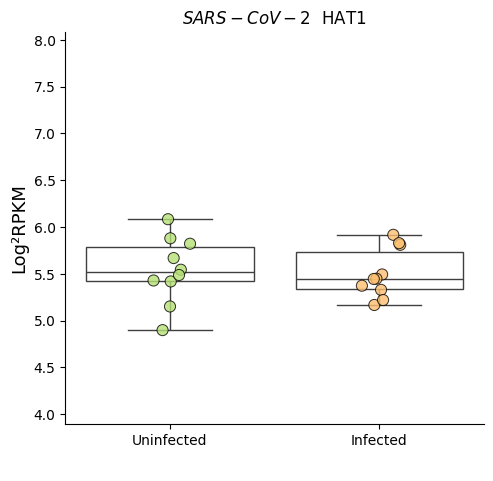

carregando


<Figure size 800x800 with 0 Axes>

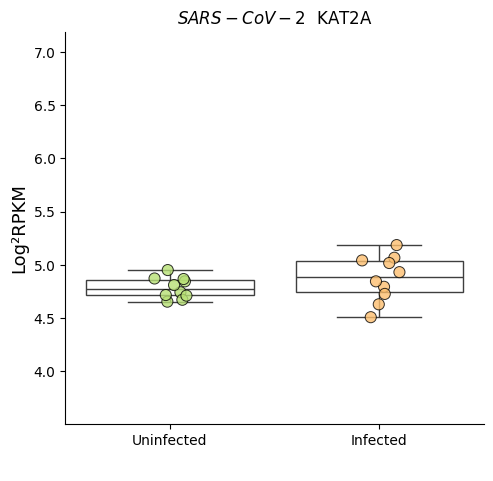

carregando


<Figure size 800x800 with 0 Axes>

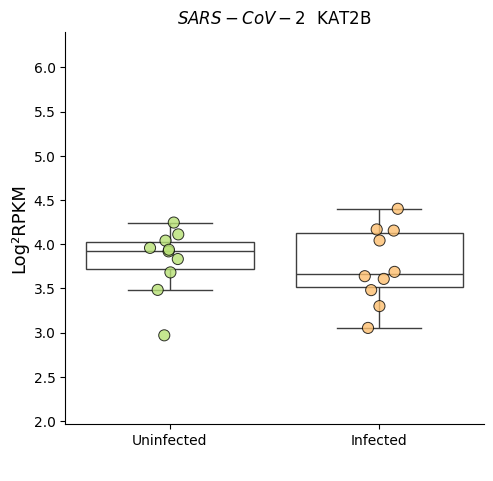

carregando


<Figure size 800x800 with 0 Axes>

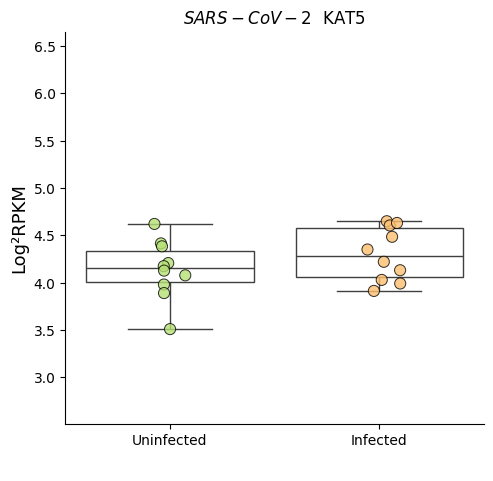

carregando


<Figure size 800x800 with 0 Axes>

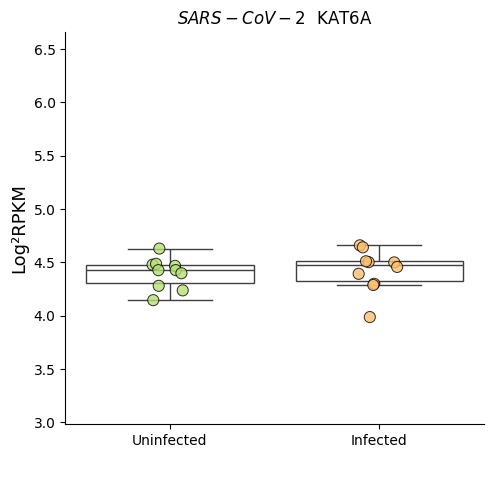

carregando


<Figure size 800x800 with 0 Axes>

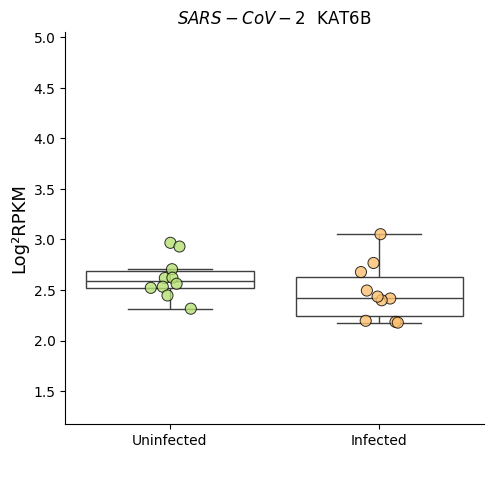

carregando


<Figure size 800x800 with 0 Axes>

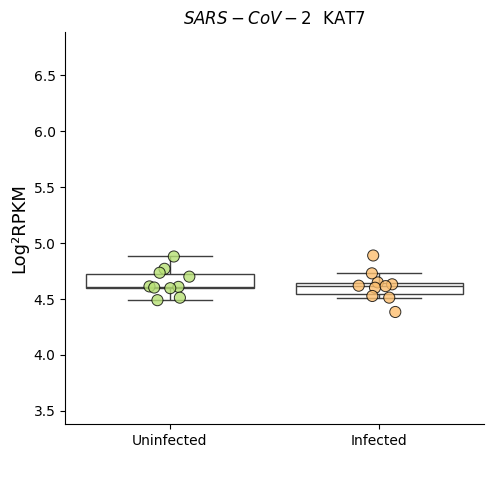

carregando


<Figure size 800x800 with 0 Axes>

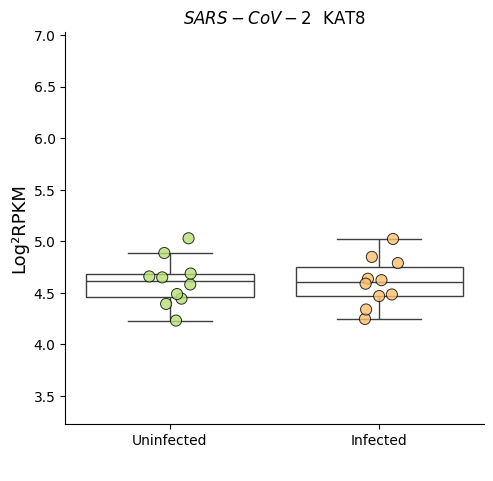

carregando


<Figure size 800x800 with 0 Axes>

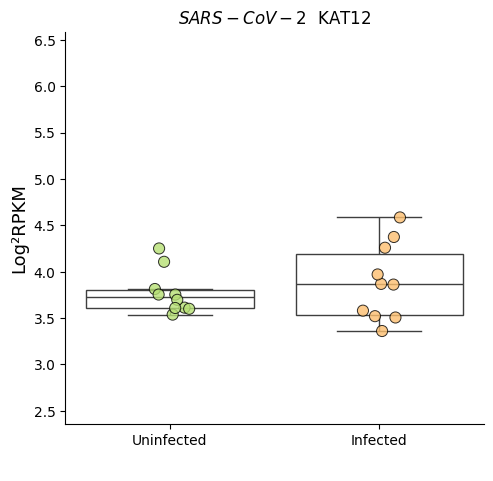

carregando


<Figure size 800x800 with 0 Axes>

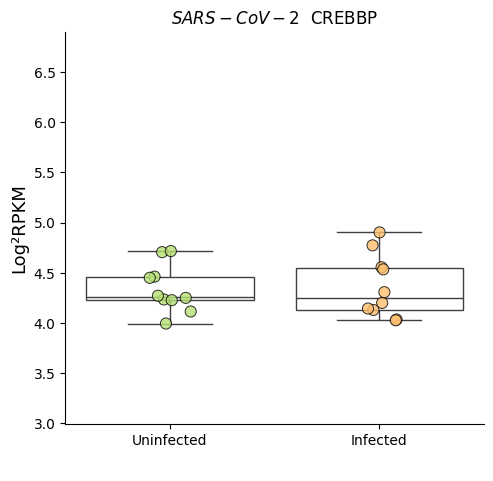

carregando


<Figure size 800x800 with 0 Axes>

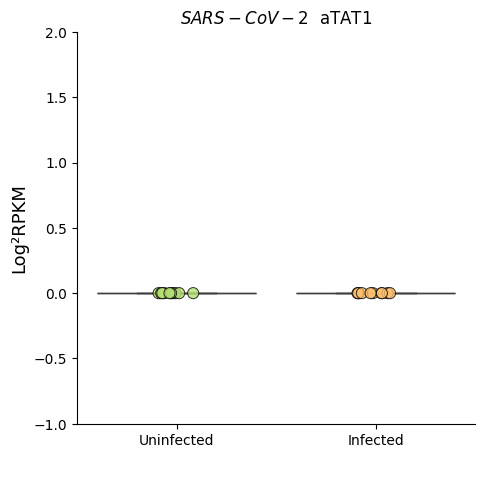

carregando


<Figure size 800x800 with 0 Axes>

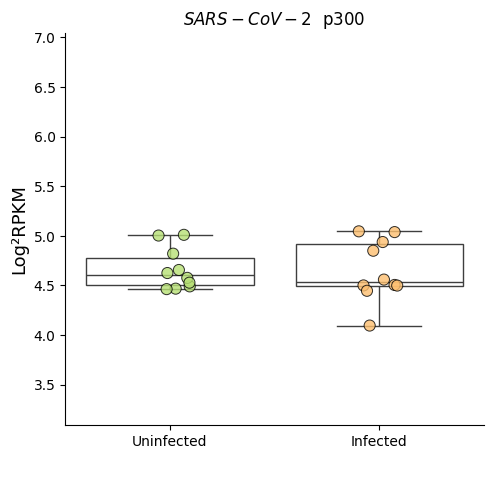

carregando


<Figure size 800x800 with 0 Axes>

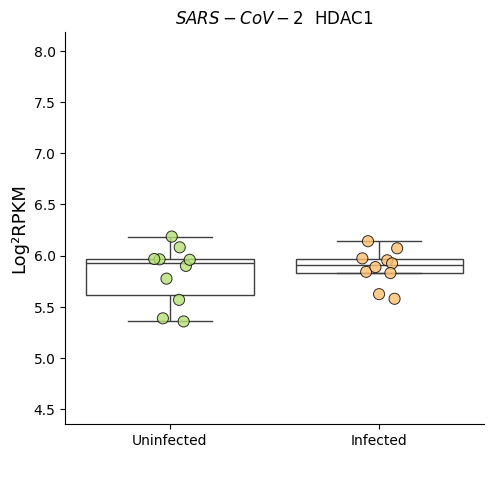

carregando


<Figure size 800x800 with 0 Axes>

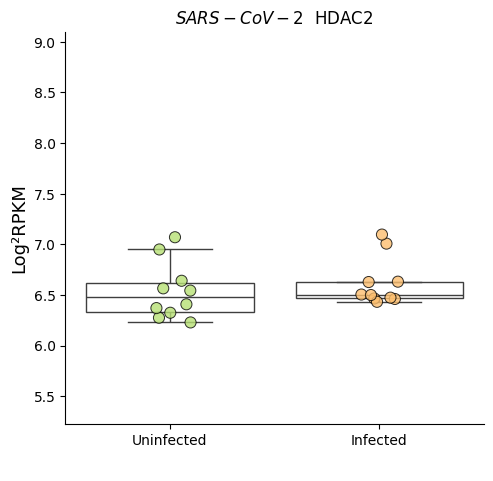

carregando


<Figure size 800x800 with 0 Axes>

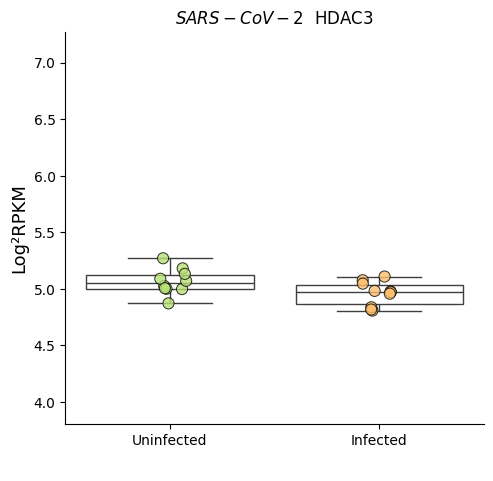

carregando


<Figure size 800x800 with 0 Axes>

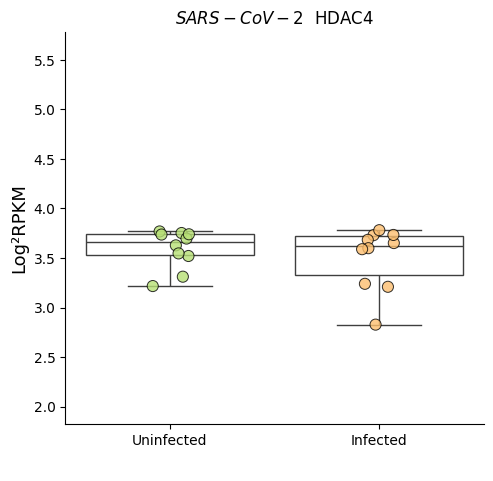

carregando


<Figure size 800x800 with 0 Axes>

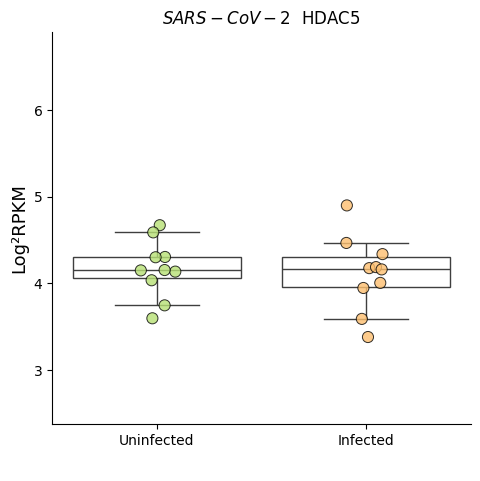

carregando


<Figure size 800x800 with 0 Axes>

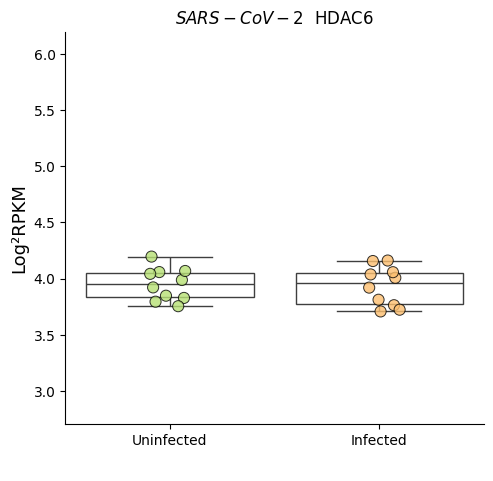

carregando


<Figure size 800x800 with 0 Axes>

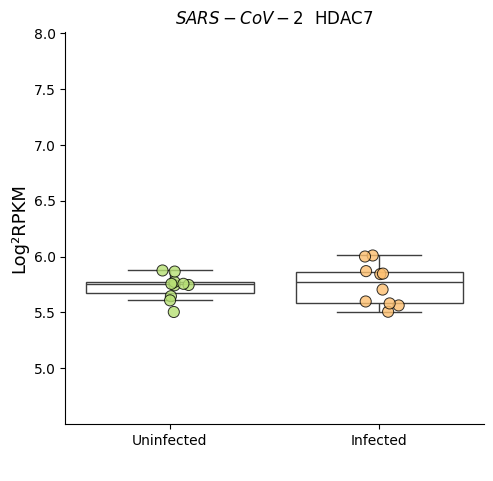

carregando


<Figure size 800x800 with 0 Axes>

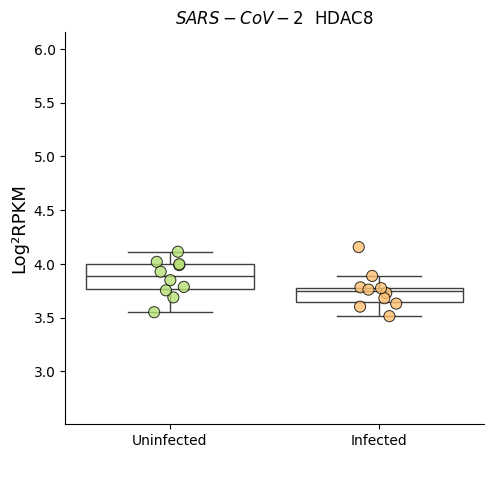

carregando


<Figure size 800x800 with 0 Axes>

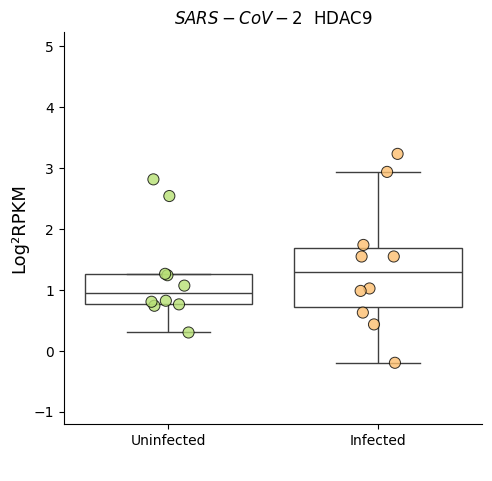

carregando


<Figure size 800x800 with 0 Axes>

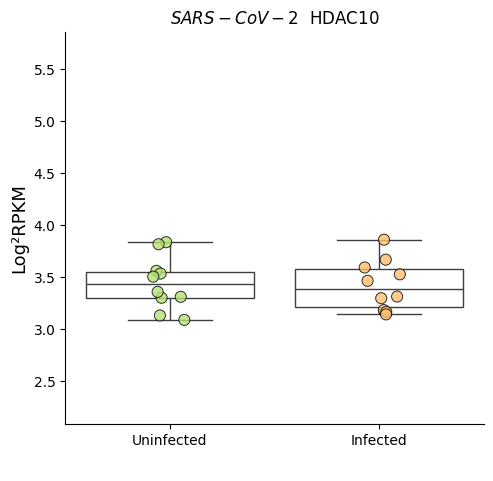

carregando


<Figure size 800x800 with 0 Axes>

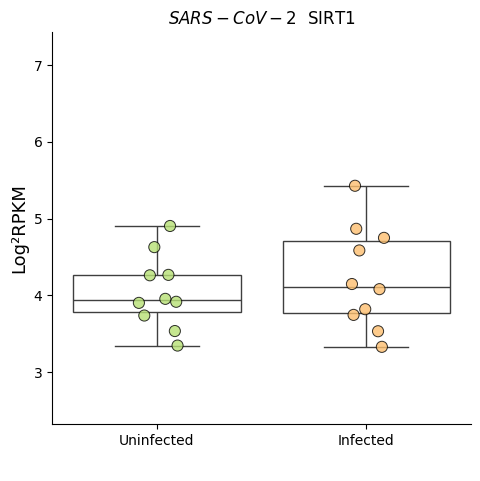

carregando


<Figure size 800x800 with 0 Axes>

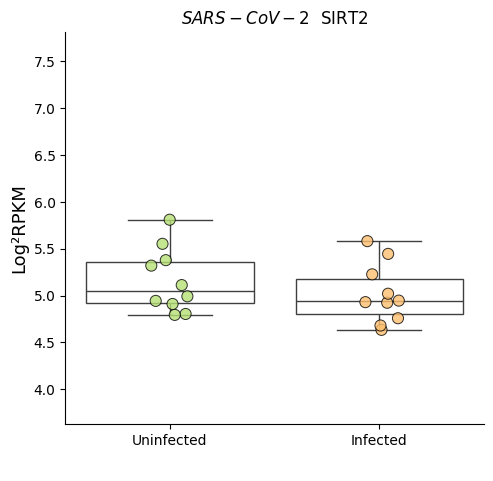

carregando


<Figure size 800x800 with 0 Axes>

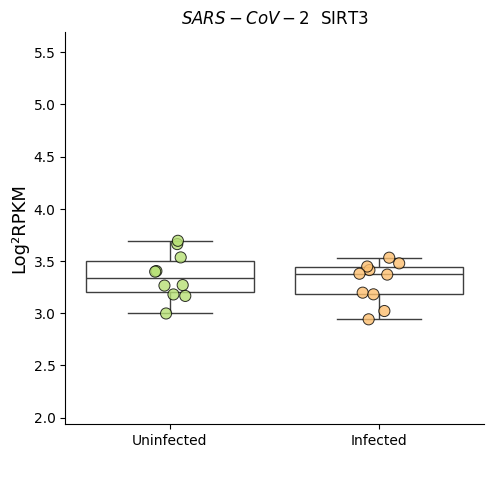

carregando


<Figure size 800x800 with 0 Axes>

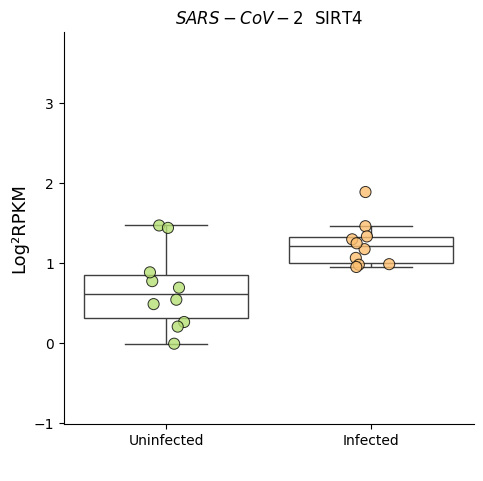

carregando


<Figure size 800x800 with 0 Axes>

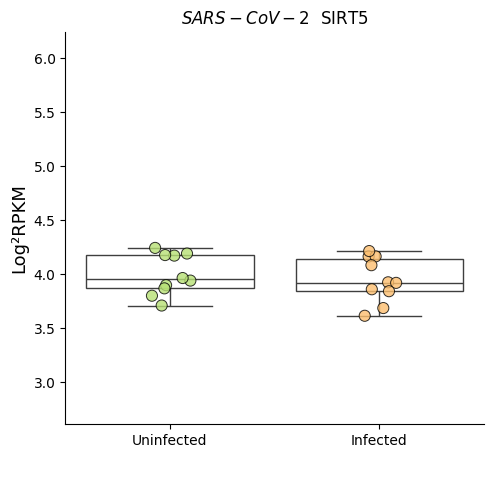

carregando


<Figure size 800x800 with 0 Axes>

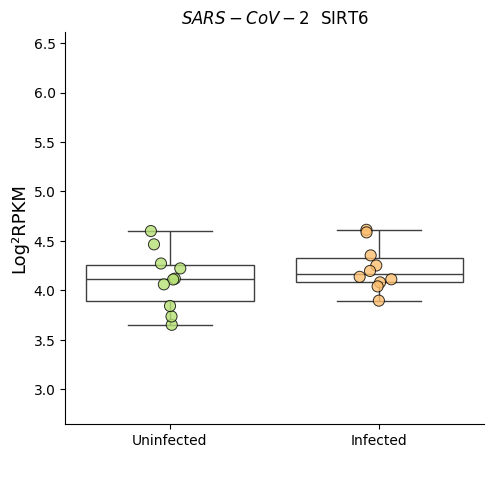

carregando


<Figure size 800x800 with 0 Axes>

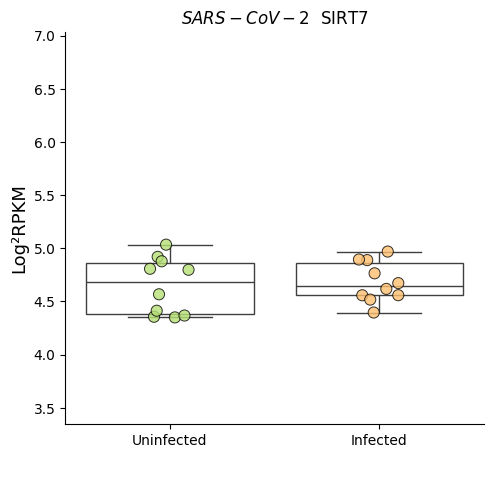

carregando


In [ ]:
graficos_boxplot(df_filtrado, "RdYlGn", "SARS-CoV-2",      ordem         , "SARS-CoV-2")


##GSE166253 ✅

In [ ]:
id_gene_pasta="GSE166253"
GSE166253_tab = pd.read_excel(GSE166253 )
GSE166253_tab.head()

,Nome,convalescent_SRR13639989,convalescent_SRR13639990,convalescent_SRR13639991,convalescent_SRR13639992,convalescent_SRR13639993,convalescent_SRR13639994,healthy_SRR13639979,healthy_SRR13639980,healthy_SRR13639981,healthy_SRR13639982,healthy_SRR13639983,healthy_SRR13639984
0,YTHDF 1,6.036995,5.222415,5.924679,5.670765,5.644066,5.392052,4.820102,5.193538,4.907664,5.255860,5.033538,5.038580
1,YTHDF 2,5.444481,4.763927,5.638657,5.358244,5.441868,4.988806,4.493908,4.951425,4.640371,4.874576,4.851299,4.880878
2,YTHDF 3,6.971294,7.037585,6.993261,6.927675,6.886116,7.114020,6.293089,6.083219,6.262060,6.280095,6.171674,6.307902
3,YTHDC 1,2.316479,1.299859,0.991099,1.534226,0.768414,1.188433,1.844094,0.192636,2.908243,2.867978,2.365627,1.415264
4,FTO,2.054454,2.475856,2.209387,2.059027,2.025154,1.426930,2.192346,3.166745,2.619056,3.479034,3.241389,3.026365


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE166253_df_filtrado = GSE166253_tab[GSE166253_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE166253_df_filtrado.index = GSE166253_df_filtrado["Nome"]

GSE166253_df_filtrado = GSE166253_df_filtrado.T
df_filtrado = GSE166253_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
convalescent_SRR13639989,4.873399,1.193886,4.594009,4.801671,5.936392,3.888121,6.221727,5.167083,3.642566,6.180414,...,2.589462,-0.07431,2.806972,5.108172,5.349636,2.935645,-3.769555,1.833845,4.488548,5.414551
convalescent_SRR13639990,4.544896,2.962487,5.023304,4.078051,5.906667,3.204189,5.677611,4.349761,3.068644,5.427795,...,1.820659,0.30645,3.329751,4.587521,5.340905,2.80261,-1.540798,2.436998,4.223888,4.853916
convalescent_SRR13639991,5.453533,1.620977,4.948372,4.824509,5.698492,3.765517,6.128345,4.70503,3.484801,5.849009,...,2.813168,-0.20695,3.400895,5.01472,5.895784,2.230077,-2.800314,2.063613,4.208035,5.080254
convalescent_SRR13639992,4.848315,0.892844,4.838713,4.420709,5.846117,3.619033,5.814223,5.285771,3.00267,6.070014,...,2.367512,-0.867829,2.790103,4.775574,5.307756,2.592737,0.0,0.995715,4.394432,5.17522
convalescent_SRR13639993,4.288225,0.319825,4.915898,4.735133,5.115073,3.091118,5.700319,4.984973,2.965138,5.912153,...,2.799213,-1.725786,2.760377,4.725388,5.40835,1.798089,0.0,0.957302,4.154657,5.323388


In [ ]:
df_filtrado.index.to_list()

['convalescent_SRR13639989',
 'convalescent_SRR13639990',
 'convalescent_SRR13639991',
 'convalescent_SRR13639992',
 'convalescent_SRR13639993',
 'convalescent_SRR13639994',
 'healthy_SRR13639979',
 'healthy_SRR13639980',
 'healthy_SRR13639981',
 'healthy_SRR13639982',
 'healthy_SRR13639983',
 'healthy_SRR13639984']

In [ ]:
df_filtrado["Status"] =     ['convalescent',
'convalescent',
'convalescent',
'convalescent',
'convalescent',
'convalescent',
'healthy',
'healthy',
'healthy',
'healthy',
'healthy',
'healthy']

<ipython-input-57-0233073bc7da>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =     ['convalescent',


In [ ]:
ordem = ['healthy', 'convalescent']
list(set(df_filtrado["Status"]))

['convalescent', 'healthy']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'convalescent']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'healthy']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.681334,-2.610781,-0.895308,0.902223,0.119356,0.320358,0.178599,-0.605965,0.927172,-0.036771,...,-0.187116,-2.849262,-1.809479,0.050341,-0.060851,-1.207682,-0.509398,-2.262443,0.010192,-0.62019


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="SARS-CoV-2_GSE166253"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE166253/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Down,Down,UP,Normal,Normal,Normal,Down,UP,Normal,...,Normal,Down,Down,Normal,Normal,Down,Normal,Down,Normal,Down


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.8,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Down,Down,UP,Normal,Normal,Normal,Down,UP,Normal,...,Normal,Down,Down,Normal,Normal,Down,Normal,Down,Normal,Down


<Figure size 800x800 with 0 Axes>

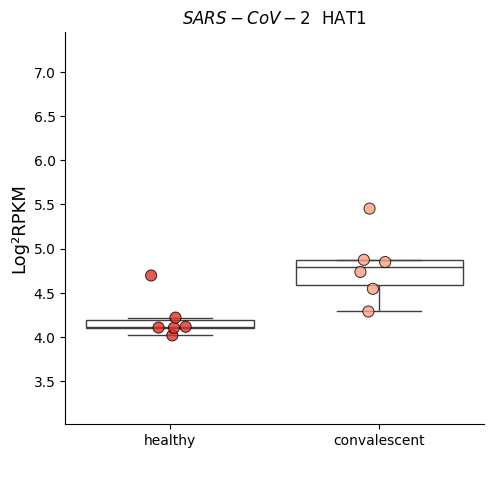

carregando


<Figure size 800x800 with 0 Axes>

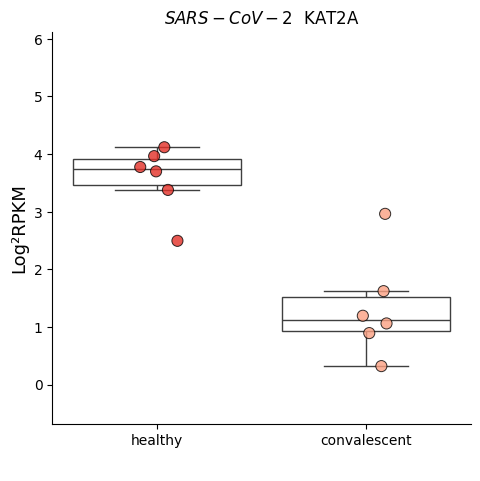

carregando


<Figure size 800x800 with 0 Axes>

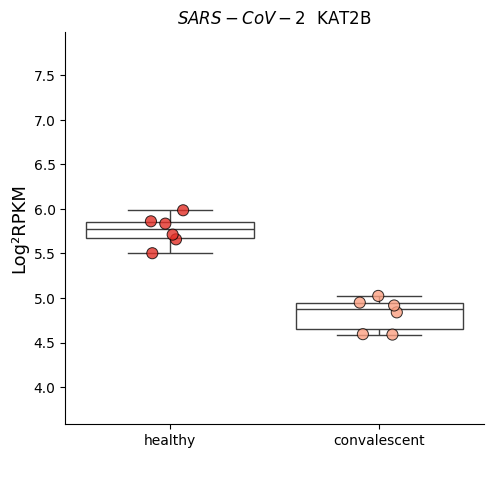

carregando


<Figure size 800x800 with 0 Axes>

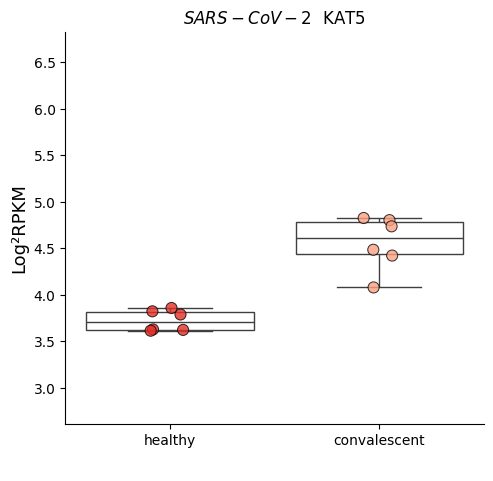

carregando


<Figure size 800x800 with 0 Axes>

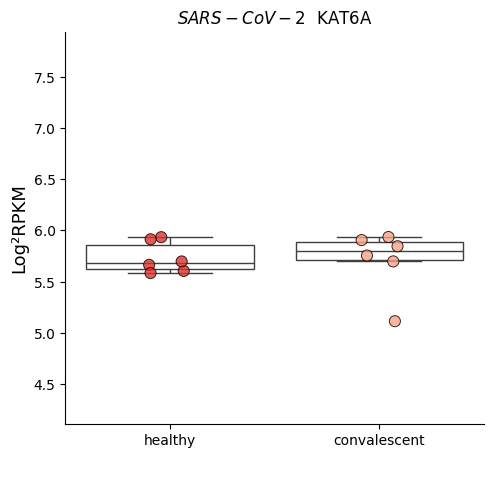

carregando


<Figure size 800x800 with 0 Axes>

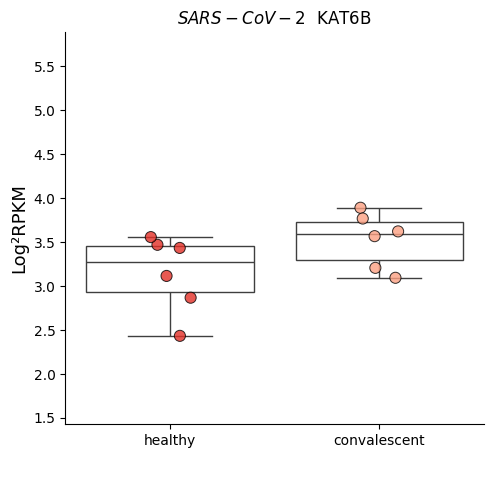

carregando


<Figure size 800x800 with 0 Axes>

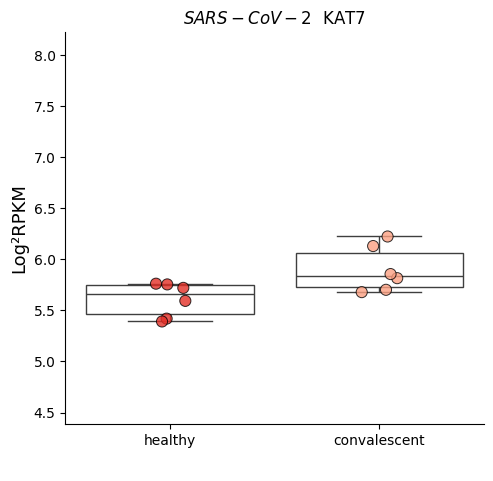

carregando


<Figure size 800x800 with 0 Axes>

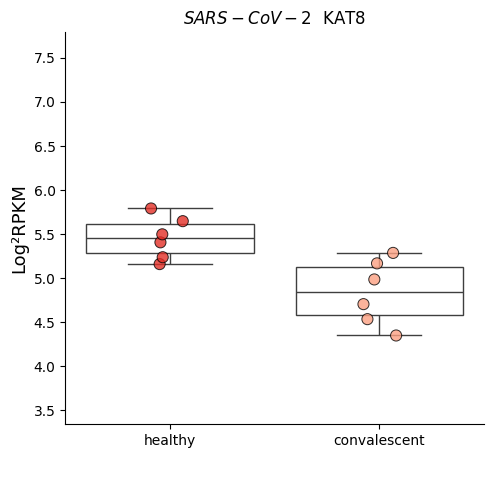

carregando


<Figure size 800x800 with 0 Axes>

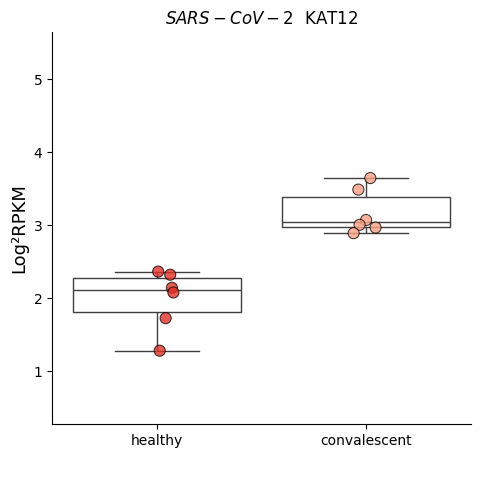

carregando


<Figure size 800x800 with 0 Axes>

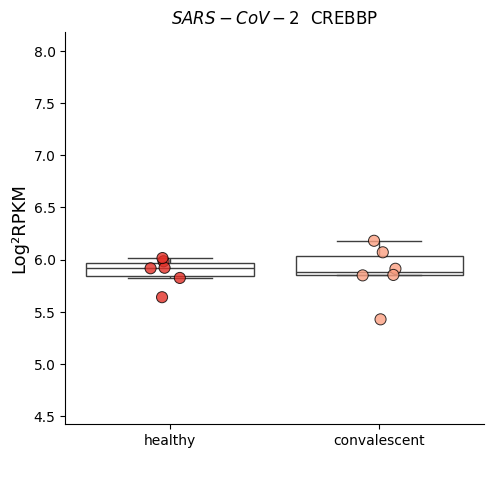

carregando


<Figure size 800x800 with 0 Axes>

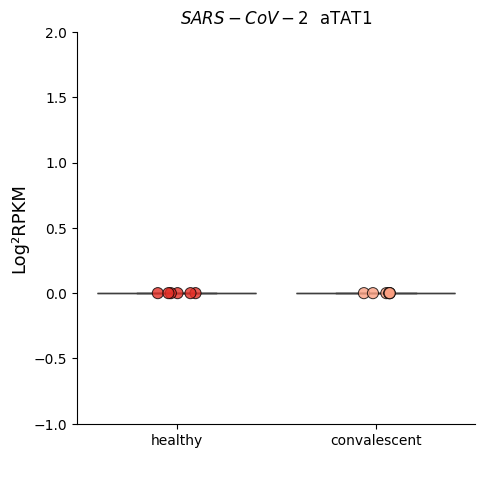

carregando


<Figure size 800x800 with 0 Axes>

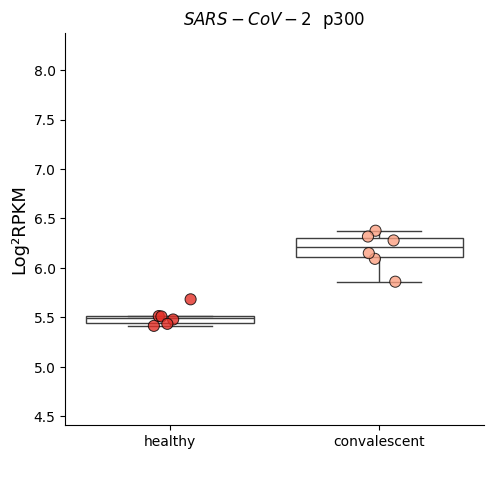

carregando


<Figure size 800x800 with 0 Axes>

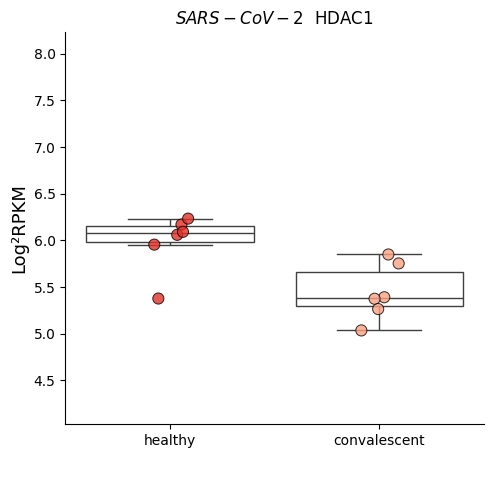

carregando


<Figure size 800x800 with 0 Axes>

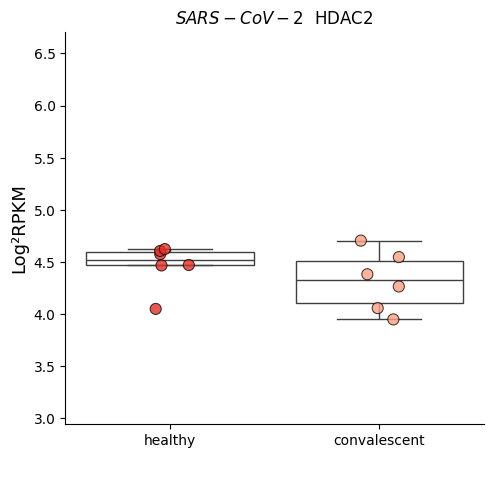

carregando


<Figure size 800x800 with 0 Axes>

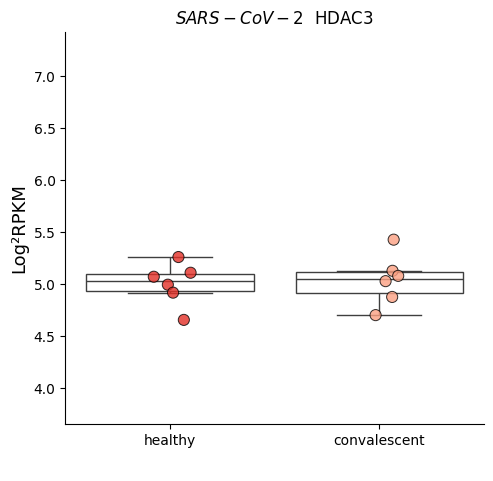

carregando


<Figure size 800x800 with 0 Axes>

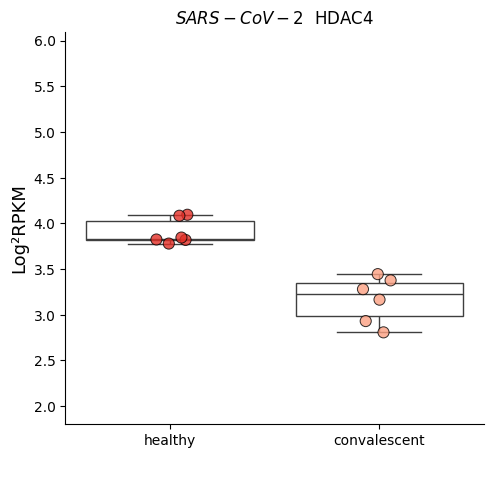

carregando


<Figure size 800x800 with 0 Axes>

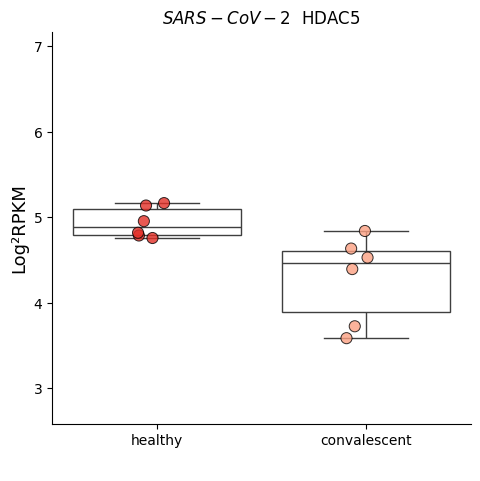

carregando


<Figure size 800x800 with 0 Axes>

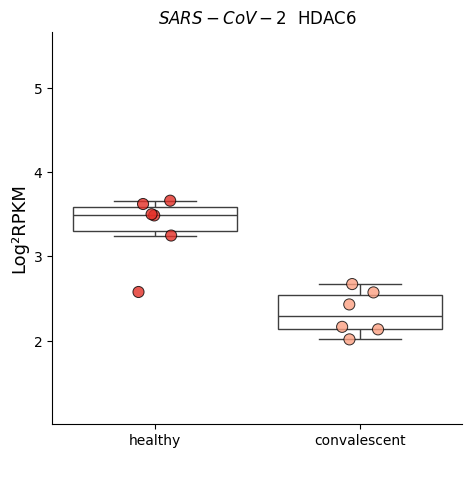

carregando


<Figure size 800x800 with 0 Axes>

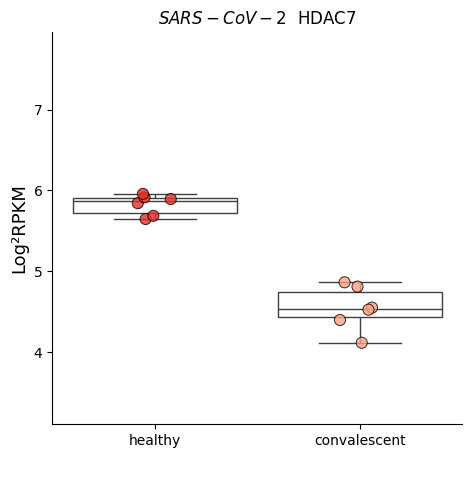

carregando


<Figure size 800x800 with 0 Axes>

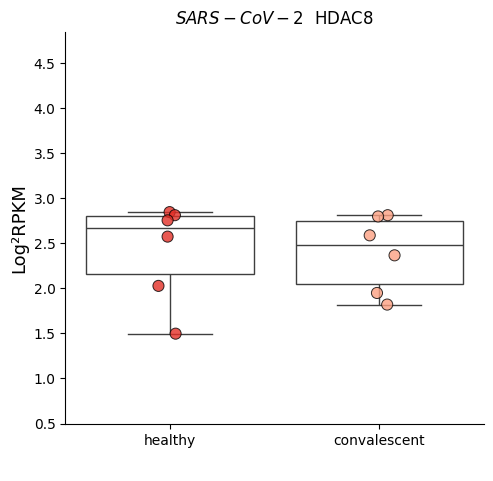

carregando


<Figure size 800x800 with 0 Axes>

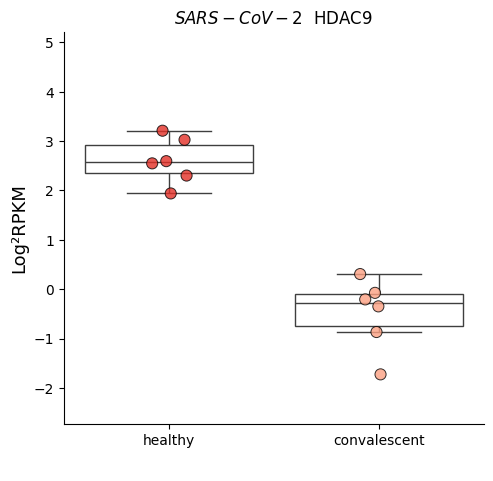

carregando


<Figure size 800x800 with 0 Axes>

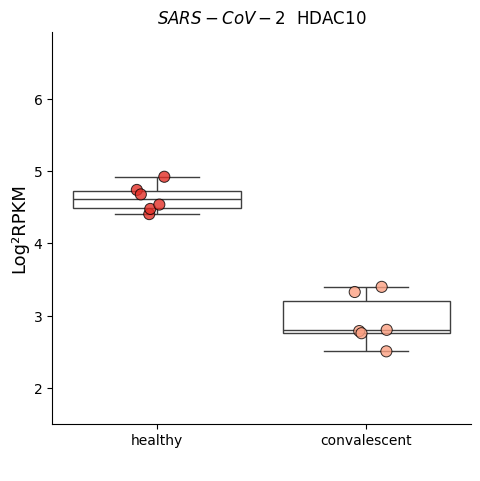

carregando


<Figure size 800x800 with 0 Axes>

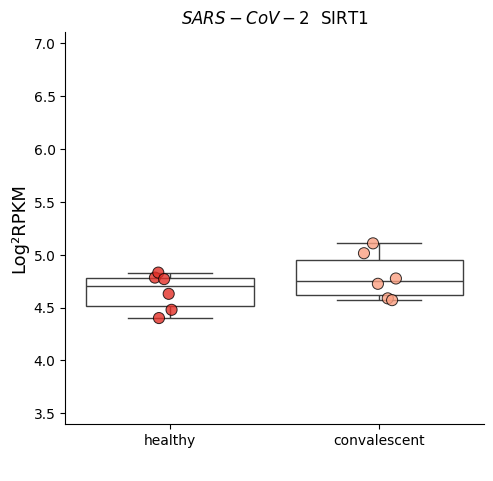

carregando


<Figure size 800x800 with 0 Axes>

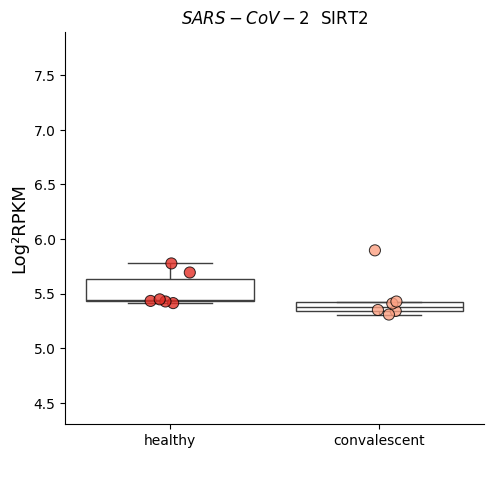

carregando


<Figure size 800x800 with 0 Axes>

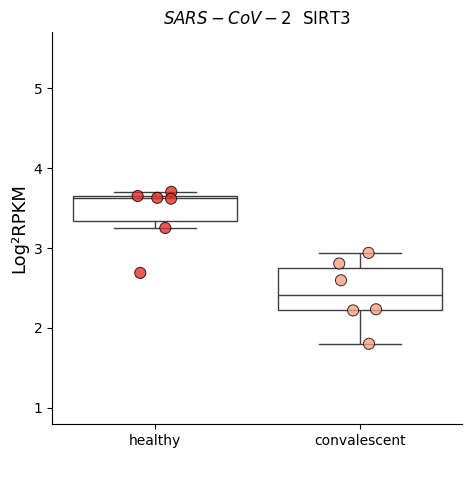

carregando


<Figure size 800x800 with 0 Axes>

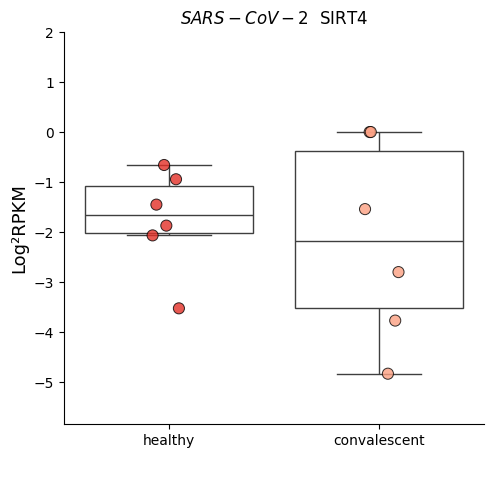

carregando


<Figure size 800x800 with 0 Axes>

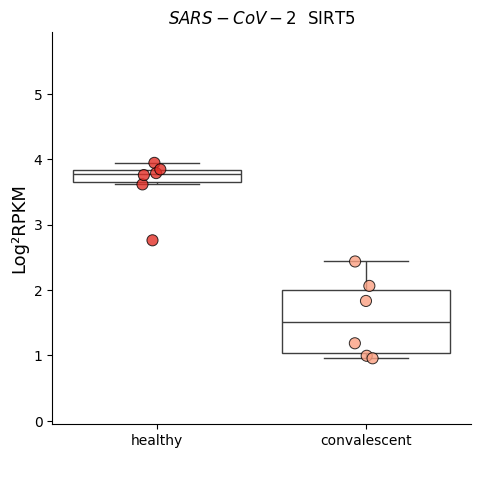

carregando


<Figure size 800x800 with 0 Axes>

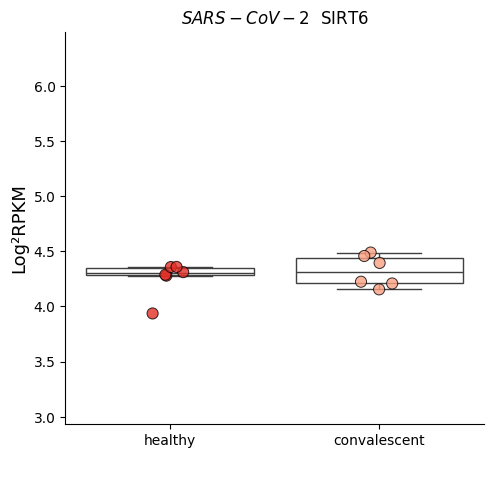

carregando


<Figure size 800x800 with 0 Axes>

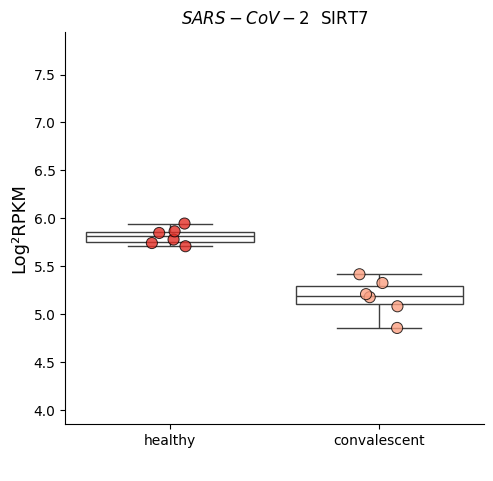

carregando


In [ ]:
graficos_boxplot(df_filtrado, "Reds", "SARS-CoV-2",      ordem         , "SARS-CoV-2")


##GSE167749 ✅

In [ ]:
id_gene_pasta="GSE167749"
GSE167749_tab = pd.read_excel(GSE167749 )
GSE167749_tab.head()

,Nome,MCoV_infected_SRR13795621,MCoV_infected_SRR13795622,MCoV_infected_SRR13795623,MCoV_infected_SRR13795624,MCoV_infected_SRR13795625,healthy_SRR13795616,healthy_SRR13795617,healthy_SRR13795618,healthy_SRR13795619,healthy_SRR13795620
0,YTHDF 1,5.579679,5.493639,5.434028,5.436260,5.502191,5.410639,5.490372,5.494729,5.522851,5.446190
1,YTHDF 2,4.935697,5.017181,4.856756,4.979245,4.868810,4.684913,4.692991,4.713763,4.866943,4.857349
2,YTHDF 3,6.063052,6.108710,6.060373,6.137630,6.139426,5.910912,5.984330,5.743724,6.005502,6.028942
3,YTHDC 1,5.475839,5.505371,5.455245,5.557383,5.509159,5.852763,5.859643,5.674066,5.804490,5.812662
4,FTO,5.426675,5.540883,5.658140,5.510861,5.693061,5.804798,5.787945,5.795493,5.715338,5.826796


In [ ]:
# Lista de genes desejados
genes_desejados = ['HAT1','KAT2A','KAT2B','KAT5','KAT6A','KAT6B','KAT7','KAT8','KAT12',
'CREBBP','aTAT1','p300','HDAC1','HDAC2','HDAC3','HDAC4','HDAC5','HDAC6','HDAC7',
'HDAC8','HDAC9','HDAC10','SIRT1','SIRT2','SIRT3','SIRT4','SIRT5','SIRT6','SIRT7'
]

# Filtrando o DataFrame para manter apenas as linhas com genes desejados na coluna "nome"
GSE167749_df_filtrado = GSE167749_tab[GSE167749_tab['Nome'].isin(genes_desejados)]
# # Visualizando o DataFrame filtrado
GSE167749_df_filtrado.index = GSE167749_df_filtrado["Nome"]

GSE167749_df_filtrado = GSE167749_df_filtrado.T
df_filtrado = GSE167749_df_filtrado.iloc[1:]
df_filtrado.head()

Nome,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
MCoV_infected_SRR13795621,5.260401,4.274332,5.298046,4.642126,4.759521,2.030196,6.188842,3.592023,4.378381,2.871198,...,3.083635,1.07341,3.591242,3.852775,5.979426,4.204966,3.143779,2.613495,3.891538,5.686966
MCoV_infected_SRR13795622,5.587553,4.281594,5.358376,4.759604,4.867566,2.162978,6.178011,3.680378,4.370761,2.973874,...,2.83675,1.320931,3.843296,3.922674,5.92156,4.228567,3.225324,2.559927,4.183291,5.990016
MCoV_infected_SRR13795623,5.092068,4.105131,5.408759,4.846878,4.929499,2.37958,6.110101,3.574291,4.304346,2.791451,...,2.859713,1.211489,3.585103,3.904935,5.95237,4.334493,3.272716,3.053722,3.75383,5.586747
MCoV_infected_SRR13795624,5.228352,4.170679,5.502217,4.726187,4.812463,2.334991,6.21693,3.64053,4.216936,2.818781,...,2.731413,1.204867,3.654991,3.934539,6.026715,4.150923,3.274948,2.788669,3.948707,5.765802
MCoV_infected_SRR13795625,5.273599,4.209276,5.41255,4.890265,4.924276,2.347649,6.218265,3.676589,4.192673,2.897052,...,2.96622,1.4012,3.668649,4.057799,6.052583,4.22931,3.645024,3.228583,3.985275,5.809534


In [ ]:
df_filtrado.index.to_list()

['MCoV_infected_SRR13795621',
 'MCoV_infected_SRR13795622',
 'MCoV_infected_SRR13795623',
 'MCoV_infected_SRR13795624',
 'MCoV_infected_SRR13795625',
 'healthy_SRR13795616',
 'healthy_SRR13795617',
 'healthy_SRR13795618',
 'healthy_SRR13795619',
 'healthy_SRR13795620']

In [ ]:
df_filtrado["Status"] =     ['infected',
'infected',
'infected',
'infected',
'infected',
'healthy',
'healthy',
'healthy',
'healthy',
'healthy']

<ipython-input-93-f60356af2168>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado["Status"] =     ['infected',


In [ ]:
ordem = ['healthy', 'infected']
list(set(df_filtrado["Status"]))

['infected', 'healthy']

In [ ]:
#############################################################
infected_data = df_filtrado[df_filtrado['Status'] == 'infected']
uninfected_data = df_filtrado[df_filtrado['Status'] == 'healthy']
#############################################################

UNF = uninfected_data.iloc[:, 0:-1].median()
UNf_dict={"Nomes":UNF.index.to_list(),"valores":UNF.to_list()}
UNF_df = pd.DataFrame(UNf_dict).set_index("Nomes").T

INF = infected_data.iloc[:, 0:-1].median()
INF_dict={"Nomes":INF.index.to_list(),"valores":INF.to_list()}
INF_df = pd.DataFrame(INF_dict).set_index("Nomes").T

INF_df-UNF_df

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,0.876927,0.37877,0.18635,-0.106129,0.342274,-0.238236,0.186542,-0.124859,-0.107508,0.164519,...,-0.690379,-0.233884,-0.568971,-0.33422,-0.058198,-0.308427,-0.45544,-0.698678,0.008761,-0.054378


In [ ]:
gen_reg = INF_df-UNF_df
regulated_genes = gen_reg.copy()
gen_reg
for i in gen_reg:
    if regulated_genes[i].valores >= 0.6:
        regulated_genes[i] = "UP"
        continue

    if regulated_genes[i].valores <= -0.6:
        regulated_genes[i] = "Down"

    else:
        regulated_genes[i] = "Normal"
    # print(regulated_genes[i])

#############################################################
nome="SARS-CoV-2_GSE167749"
regulated_genes.to_excel(nome+".xlsx")
regulated_genes.to_excel("/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/GSE167749/"+ nome+".xlsx")
regulated_genes
#############################################################

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Down,Normal,Normal,Normal,Normal,Normal,Normal,Down,Normal,Normal


In [ ]:
def graficos_boxplot(tabela, paleta, especie, ordem, nome):
    for i in tabela:
        if "Status" in i or "Patient" in i or "tret" in i:
            continue

        plt.figure(figsize=(8, 8))  # Aumentando o tamanho da figura
        # ax = sns.lineplot(data=tabela, x="Status", y=i, markers=True , hue= "Patient", style= "Patient")
        ax = sns.catplot(data=tabela, x="Status", y=i, kind="strip", size=8, palette=paleta,edgecolor='black',linewidth=0.71,  hue="Status", alpha=.8,  order=ordem)

        sns.boxplot(data=tabela, x="Status", y=i, showcaps=True, boxprops={'facecolor': 'None'},
                    showfliers=True, whiskerprops={'linewidth': 1}, hue="Status", fliersize=0)

        # plt.xticks(rotation=45)

        plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 1)

        if max(tabela[i]) - min(tabela[i]) < 5:
            plt.ylim(min(tabela[i]) - 1, max(tabela[i]) + 2)

        # Ajustando o título para evitar cortes
        ax.set(title=f'${especie}$  ' + i)
        ax.fig.subplots_adjust(top=0.9)  # Ajustando a posição vertical do título
        # ax.fig.subplots_adjust(bottom=0.25)

        plt.xlabel(' ', fontdict={'size': 13})
        plt.ylabel('Log²RPKM', fontdict={'size': 13})

        plt.savefig(f"/content/drive/MyDrive/Laboratory/Alunos/Cadu/img/{id_gene_pasta}/{nome}_{i}.png",dpi=200, format='png')

        plt.show()

        print("carregando")
        # break



In [ ]:
regulated_genes

Nomes,HAT1,KAT2A,KAT2B,KAT5,KAT6A,KAT6B,KAT7,KAT8,KAT12,CREBBP,...,HDAC8,HDAC9,HDAC10,SIRT1,SIRT2,SIRT3,SIRT4,SIRT5,SIRT6,SIRT7
valores,UP,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,Normal,...,Down,Normal,Normal,Normal,Normal,Normal,Normal,Down,Normal,Normal


<Figure size 800x800 with 0 Axes>

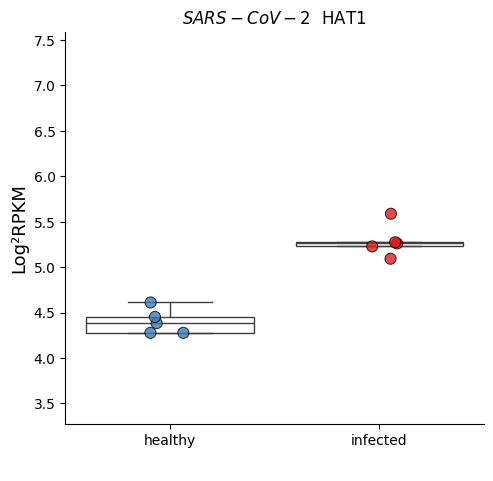

carregando


<Figure size 800x800 with 0 Axes>

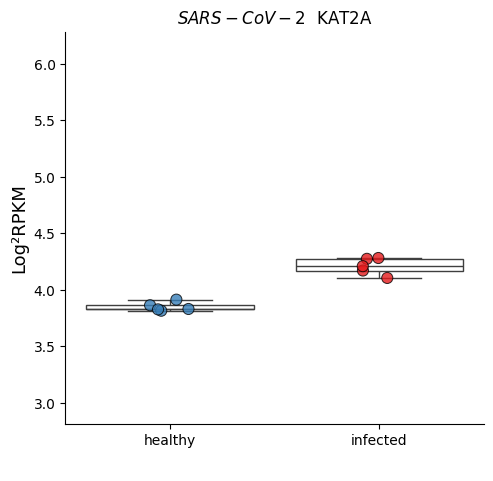

carregando


<Figure size 800x800 with 0 Axes>

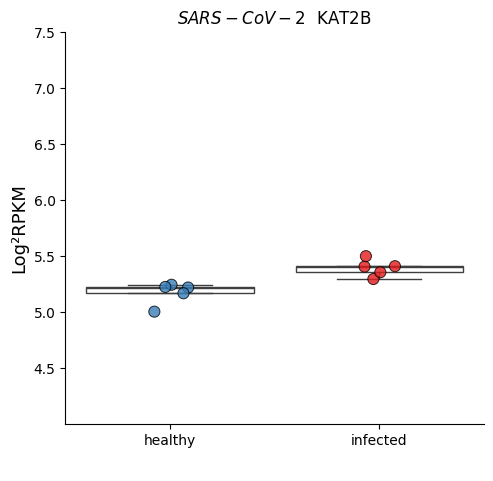

carregando


<Figure size 800x800 with 0 Axes>

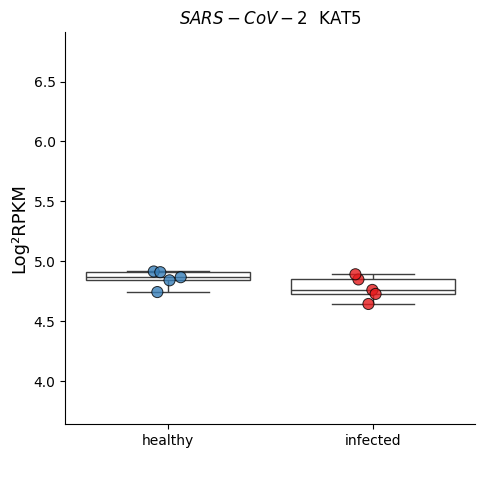

carregando


<Figure size 800x800 with 0 Axes>

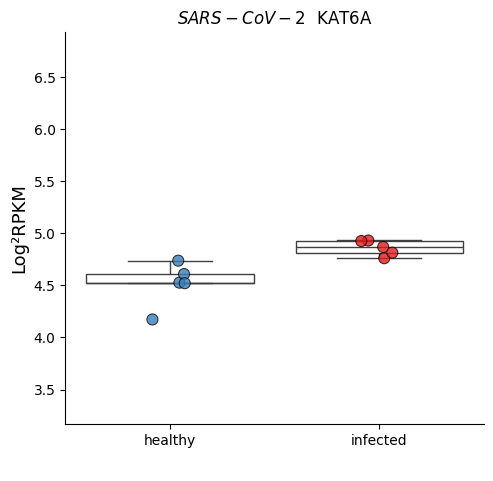

carregando


<Figure size 800x800 with 0 Axes>

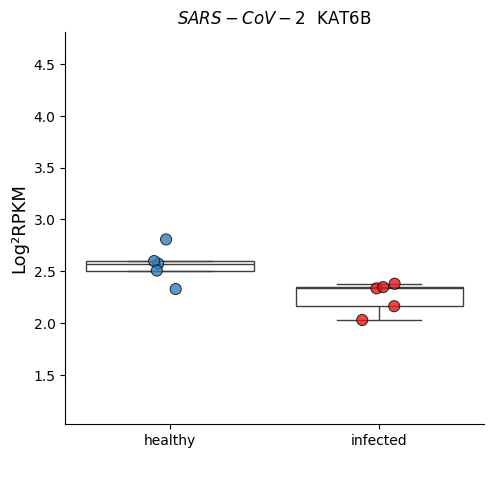

carregando


<Figure size 800x800 with 0 Axes>

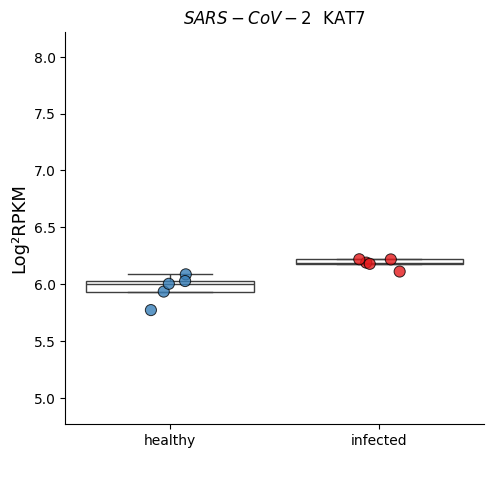

carregando


<Figure size 800x800 with 0 Axes>

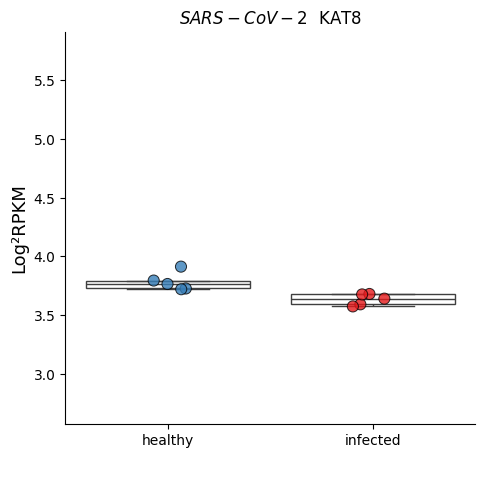

carregando


<Figure size 800x800 with 0 Axes>

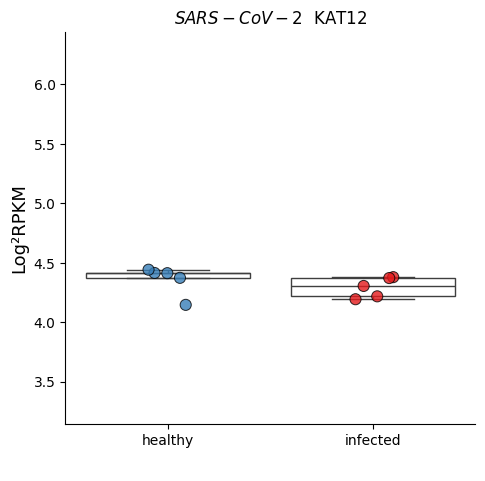

carregando


<Figure size 800x800 with 0 Axes>

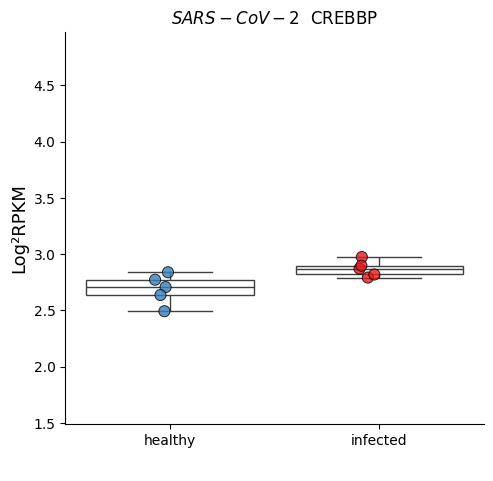

carregando


<Figure size 800x800 with 0 Axes>

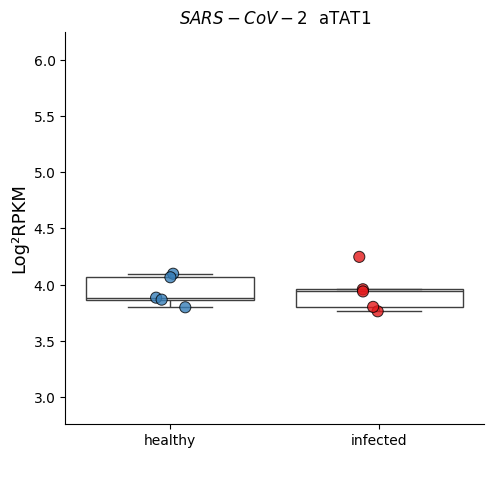

carregando


<Figure size 800x800 with 0 Axes>

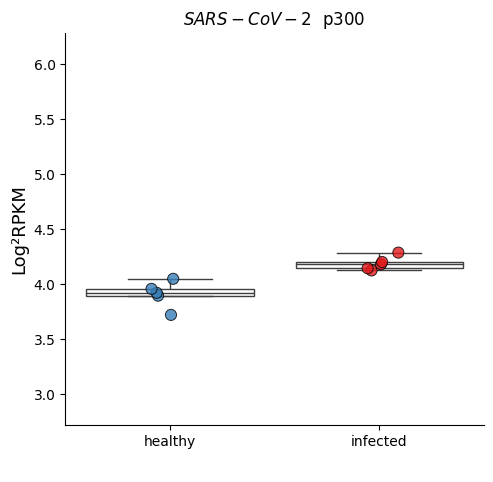

carregando


<Figure size 800x800 with 0 Axes>

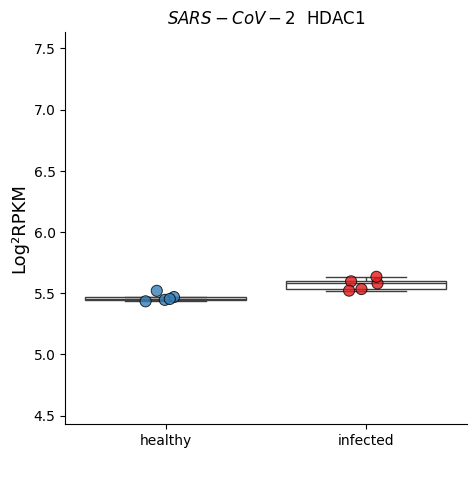

carregando


<Figure size 800x800 with 0 Axes>

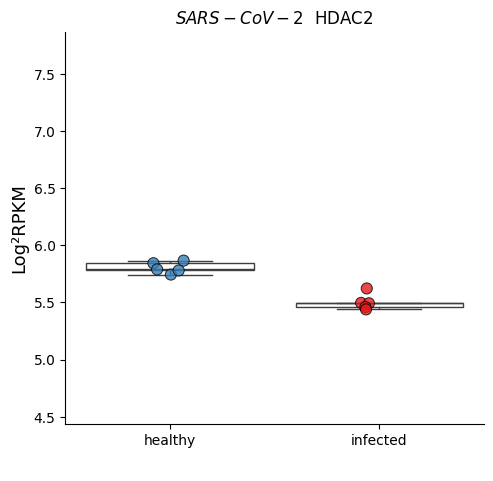

carregando


<Figure size 800x800 with 0 Axes>

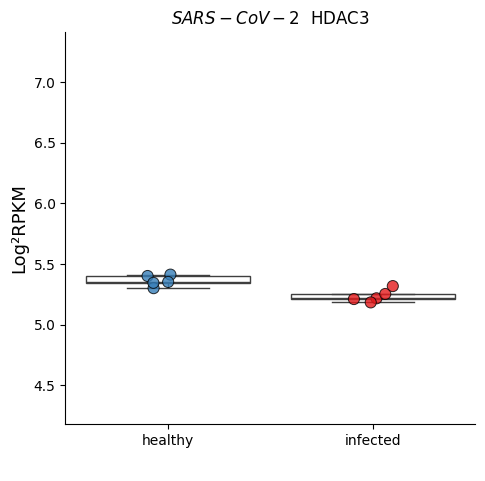

carregando


<Figure size 800x800 with 0 Axes>

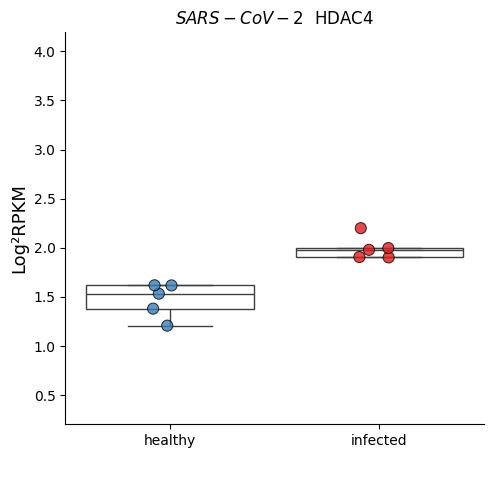

carregando


<Figure size 800x800 with 0 Axes>

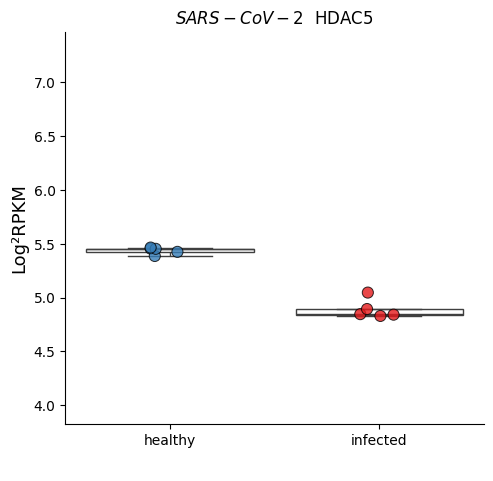

carregando


<Figure size 800x800 with 0 Axes>

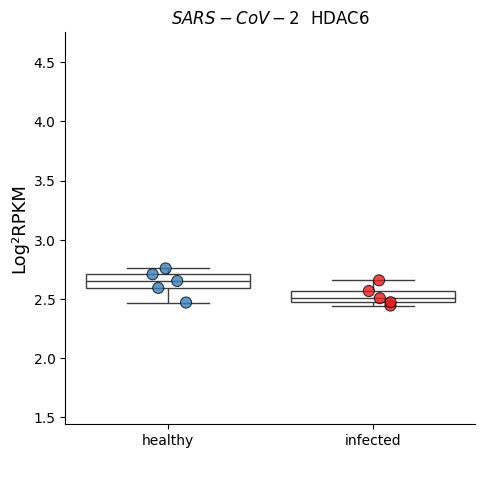

carregando


<Figure size 800x800 with 0 Axes>

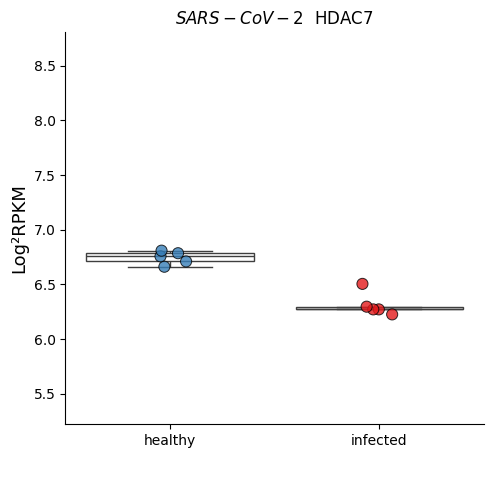

carregando


<Figure size 800x800 with 0 Axes>

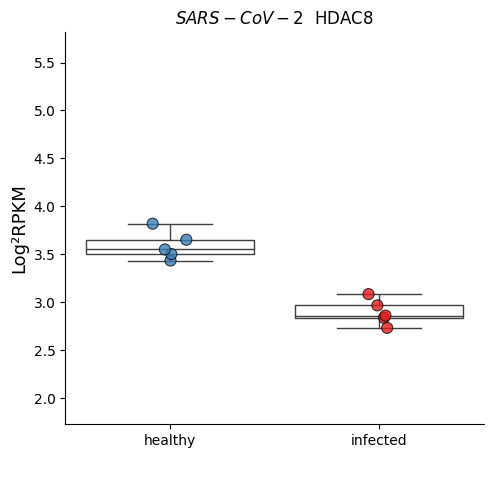

carregando


<Figure size 800x800 with 0 Axes>

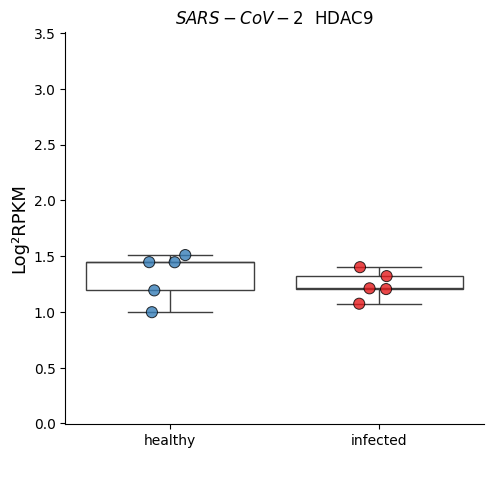

carregando


<Figure size 800x800 with 0 Axes>

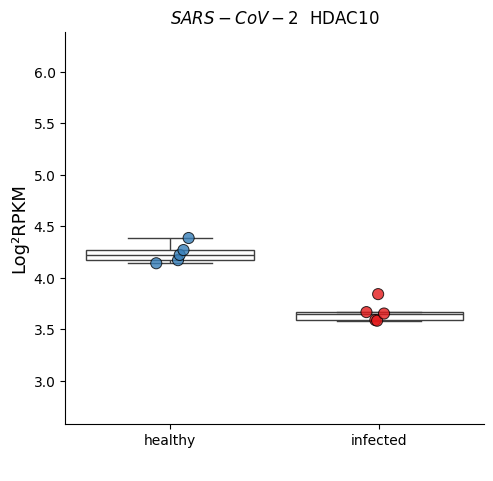

carregando


<Figure size 800x800 with 0 Axes>

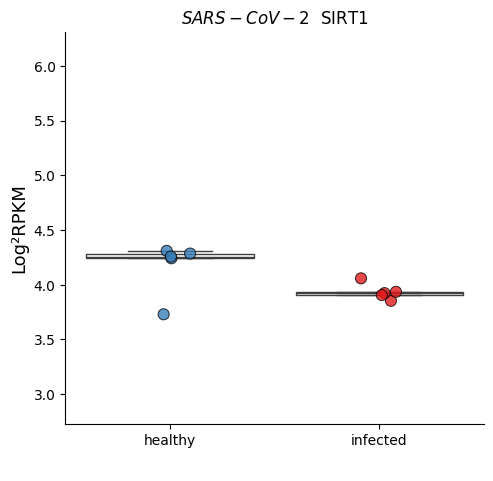

carregando


<Figure size 800x800 with 0 Axes>

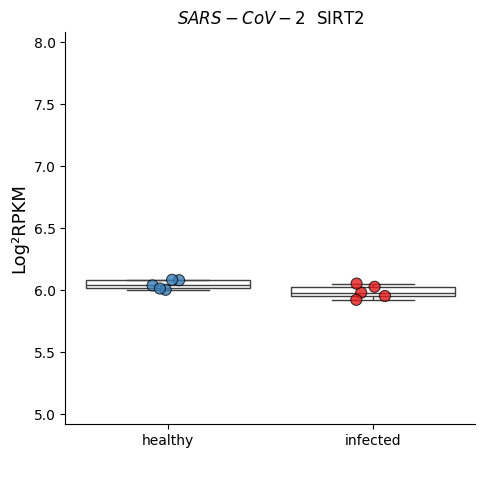

carregando


<Figure size 800x800 with 0 Axes>

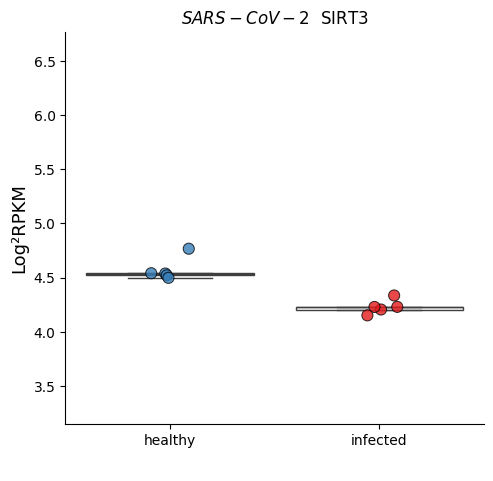

carregando


<Figure size 800x800 with 0 Axes>

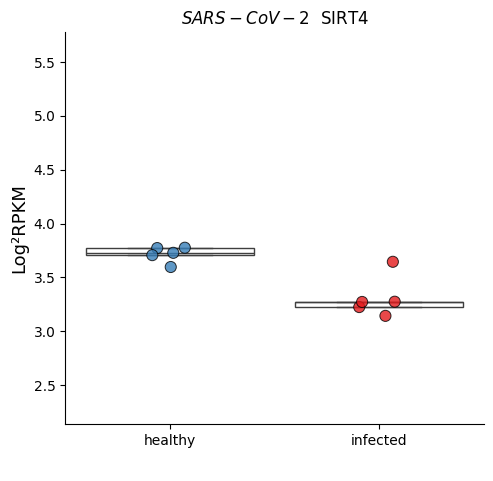

carregando


<Figure size 800x800 with 0 Axes>

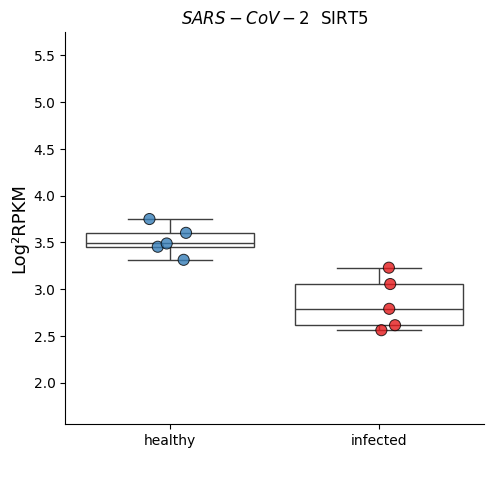

carregando


<Figure size 800x800 with 0 Axes>

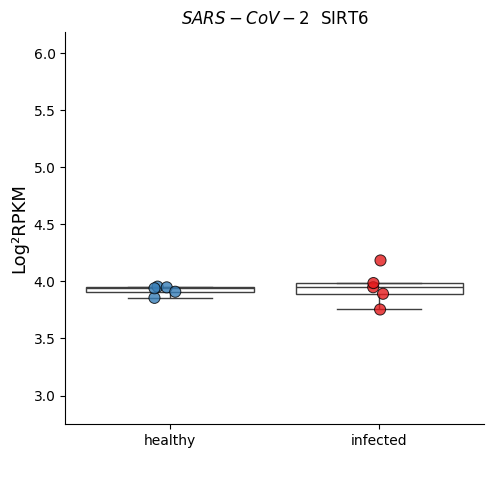

carregando


<Figure size 800x800 with 0 Axes>

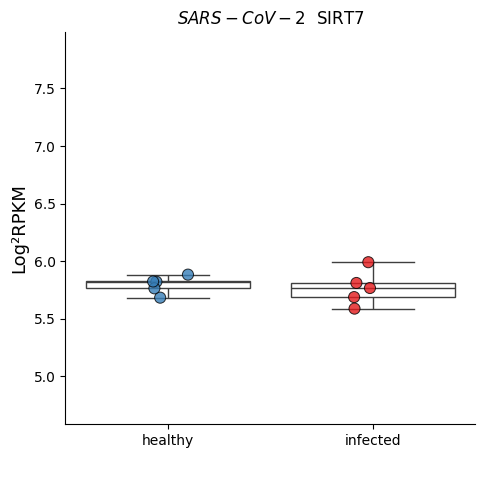

carregando


In [ ]:
graficos_boxplot(df_filtrado, "Set1", "SARS-CoV-2",      ordem         , "SARS-CoV-2")
